<a href="https://colab.research.google.com/github/lco21/Black-Scholes-and-Beyond---Masters-Project/blob/main/MSciProject.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Testing**

In [ ]:
#Our little testing section
name="Jehan"
stock="ABNB"
string=stock+"_"+name
Sector="Finanical"
NewString='/content/drive/My Drive/MSci Project/'+Sector
print(NewString)
print(1j+2j)
P, umax, N = 0, 100, 100
dphi=umax/N #dphi is width
phi_list=[]
for i in range(1,N):
  phi = dphi * (2*i + 1)/2
  phi_list.append(phi)
print(phi_list)
print(len(phi_list))
print(name[-1:])
N=10


/content/drive/My Drive/MSci Project/Finanical
3j
[1.5, 2.5, 3.5, 4.5, 5.5, 6.5, 7.5, 8.5, 9.5, 10.5, 11.5, 12.5, 13.5, 14.5, 15.5, 16.5, 17.5, 18.5, 19.5, 20.5, 21.5, 22.5, 23.5, 24.5, 25.5, 26.5, 27.5, 28.5, 29.5, 30.5, 31.5, 32.5, 33.5, 34.5, 35.5, 36.5, 37.5, 38.5, 39.5, 40.5, 41.5, 42.5, 43.5, 44.5, 45.5, 46.5, 47.5, 48.5, 49.5, 50.5, 51.5, 52.5, 53.5, 54.5, 55.5, 56.5, 57.5, 58.5, 59.5, 60.5, 61.5, 62.5, 63.5, 64.5, 65.5, 66.5, 67.5, 68.5, 69.5, 70.5, 71.5, 72.5, 73.5, 74.5, 75.5, 76.5, 77.5, 78.5, 79.5, 80.5, 81.5, 82.5, 83.5, 84.5, 85.5, 86.5, 87.5, 88.5, 89.5, 90.5, 91.5, 92.5, 93.5, 94.5, 95.5, 96.5, 97.5, 98.5, 99.5]
99
n


# **Import Relevant Modules**

This section imports relevant modules and connects to the Google Drive.

In [ ]:
#Relevant modules
!pip install py_vollib
!pip install arch
import numpy as np
import os
import pandas as pd
import matplotlib.pyplot as plt
import math
from scipy.stats import norm
from py_vollib.black_scholes.greeks.analytical import vega
from arch import arch_model
from scipy.optimize import brentq
from scipy.optimize import newton
from scipy.integrate import quad
from scipy.optimize import minimize
from numpy import random




  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
  Created wheel for py_vollib: filename=py_vollib-1.0.1-py3-none-any.whl size=62833 sha256=8232ad3f3eb28d3bff6e61c694653ce1c4ccdd970113785652fc8f71bab09cf2
  Stored in directory: /root/.cache/pip/wheels/c0/5c/8f/1ed590a10a2cca3cbfa7a7caa29fb5d729b3e1f819bfda4b5e
  Created wheel for py_lets_be_rational: filename=py_lets_be_rational-1.0.1-py3-none-any.whl size=24451 sha256=1e4519ce972f856ad2b23d9f0447b1e7e31cde2456e0fca7a873f07d06f50b4b
  Stored in directory: /root/.cache/pip/wheels/d9/20/b1/018f644bacb669d5cd6af600fe09ee0729ae5d75875a9f3043
Successfully built py_vollib py_lets_be_rational
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 985.3/985.3 kB 13.4 MB/s eta 0:00:00


# **Mount Google Drive**

In [ ]:
# Mount the Google Drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# **Main Operational Functions**

Contains the main function required for th operation of the option pricing models including functions for data imports from Excel file, calculation of implied volatilities for comparisons and plotting.

In [ ]:
start_date='2024-08-23'
end_date='2024-11-15'

sector_list=["Communication Services","Consumer Discretionary","Consumer Staples","Energy","Financial","Healthcare","Industrials","Materials","Real Estate","Technology","Utilities"]

#Function gets all files within a particular sector folder
def list_files_in_folder(Sector):

    # Get the list of files in the specified folder
    folder_path = '/content/drive/My Drive/MSci Project/' + Sector + '/'
    # List the files in the folder and print them
    file_names = os.listdir(folder_path)
    #Returns file names as array
    return file_names

#Function which sorts data in excel into dataframes.
def excel_to_df(Sector):
  tickers=[]
  strikes=[]
  betas=[]
  expirations=[]

  #Gets all the file names for a particular sector
  files=list_files_in_folder(Sector)

  #Make a data frame to store all data
  main_sector_data = pd.DataFrame(columns=['Date'])

  #Get VIX and Rates
  df_VIX = pd.read_excel('/content/drive/My Drive/MSci Project/Vix_Rates.xlsx','VIX').dropna(how='all').reset_index(drop=True)
  df_VIX=df_VIX[['Date','VIX']]

  df_rates = pd.read_excel('/content/drive/My Drive/MSci Project/Vix_Rates.xlsx','Rates').dropna(how='all').reset_index(drop=True)
  df_rates=df_rates[['Date','Rates']]

  df_VIX['Date'] = pd.to_datetime(df_VIX['Date'],dayfirst=True)
  df_rates['Date'] = pd.to_datetime(df_rates['Date'],dayfirst=True)

  #Add VIX and Rates to main data frame
  df_VIX_rates=pd.merge(df_VIX,df_rates,on='Date', how='inner')
  main_sector_data=pd.merge(main_sector_data,df_VIX_rates,on='Date', how='outer')

  #Loops through each file name
  for file in files:
    #Constructs directory to that file
    file_path='/content/drive/My Drive/MSci Project/'+Sector+'/'+file
    #Gathers all data from the excel in "Price" sheet and deletes blank rows
    #Gathers data from columns given

    df_optiondata = pd.read_excel(file_path,'Option').dropna(how='all').reset_index(drop=True)
    df_optiondata = df_optiondata[['Date','Option']]
    #df_optiondata['Date'] = pd.to_datetime(df_optiondata['Date'], format='%m/%d/%Y', errors='coerce')-->Not needed but kept in case

    df_stockdata = pd.read_excel(file_path,'Stock').dropna(how='all').reset_index(drop=True)
    df_stockdata = df_stockdata[['Date','Stock']]
    #df_stockdata['Date'] = pd.to_datetime(df_optiondata['Date'], format='%m/%d/%Y', errors='coerce')

    df_optiondata['Date'] = pd.to_datetime(df_optiondata['Date'],dayfirst=True)
    df_stockdata['Date'] = pd.to_datetime(df_stockdata['Date'],dayfirst=True)
    #Relabels columns according to a more descriptive name including company ticker
    df_optiondata.columns=['Date',file[:-5]+'_option']
    df_stockdata.columns=['Date',file[:-5]+'_stock']

    #Combine option price and stock price into a single data frame
    df_pricedata = pd.merge(df_optiondata,df_stockdata,on='Date', how='outer')
    #df_pricedata.dropna(inplace=True)

    #Combine this particular company's data into main data frame
    main_sector_data=pd.merge(main_sector_data,df_pricedata,on='Date', how='outer')

    #Gathers all data from the excel in "Other" sheet
    df_otherdata = pd.read_excel(file_path,'Other')

    #Extracts strike price from cell A2
    strike=df_otherdata.iloc[0,0]
    #Extracts beta from cell B2
    beta=df_otherdata.iloc[0,1]
    #Extracts beta from cell B2
    expiration=df_otherdata.iloc[0,2]

    #Appends these to a list of ticker names, strikes and betas-->Time to make that a dataframe soon.
    tickers.append(file[:-5])
    strikes.append(strike)
    betas.append(beta)
    expirations.append(expiration)
  #main_sector_data=pd.merge(main_sector_data,df_VIX_rates,on='Date', how='inner')
  main_sector_data.dropna(subset=['VIX', 'Rates'], inplace=True)
  other_data=pd.DataFrame({'Ticker':tickers,'Strike':strikes,'Beta':betas,'Expirations':expirations})
  print(main_sector_data)
  return main_sector_data,other_data

#Function which returns all the comapny tickers within a sector
def return_tickers(Sector):
  files=list_files_in_folder(Sector)
  tickers=[]
  for file in files:
    tickers.append(file[:-5])
  return tickers

width=20
def plot_actual_vs_predicted(Sector, main_data, other_data, option_prices, method):
    ticker_list = return_tickers(Sector)
    filtered_dates = main_data[(main_data['Date'] >= start_date) & (main_data['Date'] <= end_date)]['Date'].tolist()

    # Create a subplot grid
    num_tickers = len(ticker_list)
    cols = 4  # Number of columns in the subplot grid
    rows = (num_tickers + cols - 1) // cols  # Calculate rows needed
    fig, axes = plt.subplots(rows, cols, figsize=(width, rows * 5))
    axes = axes.flatten()  # Flatten the axes array for easy indexing

    for i, ticker in enumerate(ticker_list):
        days_to_maturity = []
        actual_prices = []
        predicted_prices = []
        expiry = other_data.loc[other_data['Ticker'] == ticker, 'Expirations'].values[0]

        for date in filtered_dates:
            tau = np.busday_count(date.date(), pd.Timestamp(expiry).date())
            if pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_stock']).any() or \
               pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_option']).any() or \
               pd.isna(option_prices.loc[option_prices['Date'] == date, ticker + '_' + method + '_option']).any() or tau <= 0:
                continue
            days_to_maturity.append(tau)
            actual_prices.append(main_data.loc[main_data['Date'] == date, ticker + '_option'].values[0])
            predicted_prices.append(option_prices.loc[option_prices['Date'] == date, ticker + '_' + method + '_option'].values[0])

        ax = axes[i]  # Get the subplot axis for this ticker
        ax.plot(days_to_maturity, actual_prices, label='Actual Prices')
        ax.plot(days_to_maturity, predicted_prices, label='Predicted Prices')
        ax.set_xlabel('Time to Maturity')
        ax.set_ylabel('Option Price')

        # Determine the method description
        if method[0] == 'B':
            newmethod = 'Binomial with VIX' if method[-1:] == 'X' else 'Binomial with ARCH/GARCH'
        elif method[0] == 'M':
            newmethod = 'Monte Carlo with VIX' if method[-1:] == 'X' else 'Monte Carlo with ARCH/GARCH'
        else:
            newmethod = 'Black-Scholes with VIX' if method[-1:] == 'X' else 'Black-Scholes with ARCH/GARCH'

        ax.set_title(f'{ticker}')
        ax.legend()
        ax.set_xlim(70, 0)  # Flip x-axis

    # Remove any unused subplots
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])

    # Add a common title for the sector
    fig.suptitle(f'Actual vs Predicted Option Prices for {Sector} Sector using {newmethod} ', fontsize=16)

    # Adjust layout
    plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leave space for suptitle
    plt.show()



def implied_volatility(Sector, main_data, other_data,tol=1e-3,max_iter=1000,sd=start_date,ed=end_date):

  #Initialise data frame
  Sector_volatilities=pd.DataFrame({})
  ticker_list=return_tickers(Sector)
  filtered_dates = main_data[(main_data['Date'] >= sd) & (main_data['Date'] <= ed)]['Date'].tolist()
  #Add these dates to our data frame
  Sector_volatilities['Date']=filtered_dates

  for ticker in ticker_list:

    #print(ticker)
    valid_dates=[]
    implied_vols=[]
    #Get strike price of option
    K=other_data.loc[other_data['Ticker'] == ticker, 'Strike'].values[0]
    #Get expiration date of option
    expiry=other_data.loc[other_data['Ticker'] == ticker, 'Expirations'].values[0]

    for date in filtered_dates:
      #Get time to expiry and convert to years. Note the use of trading days
      tau= np.busday_count(date.date(), pd.Timestamp(expiry).date())/252
      if pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_stock']).any() or pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_option']).any() or tau<=0:
        continue
      valid_dates.append(date)
      #Initialise volatility guess
      vol_old=0.2
      #Get stock price on particular date
      S=main_data.loc[main_data['Date'] == date, ticker+'_stock'].values[0]
      #Get predicted value of
      V=main_data.loc[main_data['Date'] == date, ticker+'_option'].values[0]
      #Get risk free
      rpercent=main_data.loc[main_data['Date'] == date, 'Rates'].values[0]
      #Change to decimal
      r= rpercent/100

      def price_difference(vol):
        return Black_Scholes(S, K, tau, r, vol) - V

      try:
        # Use brentq to find the implied volatility
        implied_vol = brentq(price_difference, 0.0001, 5, xtol=tol, maxiter=max_iter)
      except ValueError:
        # If no solution found in the interval, assign NaN or a fallback value
        implied_vol = np.nan
        #print(f"Failed to converge for {ticker} on {date}.")
      implied_vols.append(implied_vol)
    df_temp=pd.DataFrame({})
    df_temp['Date']=valid_dates
    df_temp[ticker+'_implied_vol']=implied_vols

    #Add data to main data frame
    Sector_volatilities=pd.merge(Sector_volatilities,df_temp,on='Date', how='outer')
  return Sector_volatilities


# #Used a more robust approach instead

#       for i in range (max_iter):
#         #Get Black-Scholes for the current volatilty
#         BS_current=Black_Scholes(S,K,tau,r,vol_old)
#         Cprime=vega('c',S,K,tau,r,vol_old)*100
#         C = BS_current - V
#         vol_new = vol_old - C/Cprime

#         BS_updated=Black_Scholes(S,K,tau,r,vol_new)
#         print(vol_old,Cprime,C,S,K,tau,r,V, BS_updated)
#         if (abs(vol_old - vol_new) < tol or abs(BS_updated - V) < tol):
#             break
#         vol_old = vol_new
#       implied_vols.append(vol_old)

#     df_temp=pd.DataFrame({})
#     df_temp['Date']=valid_dates
#     df_temp[ticker+'_implied_vol']=implied_vols

#     #Add data to main data frame
#     Sector_volatilities=pd.merge(Sector_volatilities,df_temp,on='Date', how='outer')
#   return Sector_volatilities


def plot_implied_vs_predicted_volatilty(Sector, main_data, other_data, option_prices, implied_volatility_data, method,sd=start_date,ed=end_date):
    ticker_list = return_tickers(Sector)
    filtered_dates = main_data[(main_data['Date'] >= sd) & (main_data['Date'] <= ed)]['Date'].tolist()

    # Create subplot grid
    num_tickers = len(ticker_list)
    cols = 4  # Number of columns in the subplot grid
    rows = (num_tickers + cols - 1) // cols  # Calculate number of rows
    fig, axes = plt.subplots(rows, cols, figsize=(20, rows * 5))
    axes = axes.flatten()  # Flatten axes for easy indexing

    for i, ticker in enumerate(ticker_list):
        #print(ticker)
        days_to_maturity = []
        implied_volatilities = []
        predicted_volatilities = []
        expiry = other_data.loc[other_data['Ticker'] == ticker, 'Expirations'].values[0]

        for date in filtered_dates:
            tau_days = np.busday_count(date.date(), pd.Timestamp(expiry).date())
            if pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_stock']).any() or \
               pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_option']).any() or \
               pd.isna(option_prices.loc[option_prices['Date'] == date, ticker + '_' + method + '_option']).any() or tau_days <= 0:
                continue
            days_to_maturity.append(tau_days)
            implied_volatilities.append(implied_volatility_data.loc[implied_volatility_data['Date'] == date, ticker + '_implied_vol'].values[0])
            predicted_volatilities.append(option_prices.loc[option_prices['Date'] == date, ticker + '_' + method].values[0])

        # Plot data in the current subplot
        ax = axes[i]
        ax.plot(days_to_maturity, implied_volatilities, label='Implied Volatility')
        ax.plot(days_to_maturity, predicted_volatilities, label=f'Predicted Volatility ({method})')
        ax.set_xlabel('Time to Maturity')
        ax.set_ylabel('Volatility')
        ax.set_title(f'{ticker}')
        ax.legend()
        ax.set_xlim(70, 0)  # Flip x-axis for time-to-maturity

    # Remove unused subplots if any
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])

    # Add a common title for the sector
    fig.suptitle(f'Implied vs Predicted Volatility for {Sector} Sector using {method}', fontsize=16)

    # Adjust layout
    plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leave space for the suptitle
    plt.show()













In [ ]:
"""
def RMSE(Sector,main_data,option_data,method,sd=start_date,ed=end_date):
  #Initialise data frame
  print(Sector)
  ticker_list=return_tickers(Sector)
  filtered_dates =main_data[(main_data['Date'] >= sd) & (main_data['Date'] <= ed)]['Date'].tolist()
  nrmse_list=[]
  for ticker in ticker_list:
    N=0
    rmse=0
    price_list=[]
    for date in filtered_dates:
      #Check if either stock or option price is not not available for that day. We will go to next date if this is true.
      if pd.isna(option_data.loc[option_data['Date'] == date, ticker + '_'+method+'_option']).any() or pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_option']).any():
        continue
      actual_price=main_data.loc[main_data['Date'] == date, ticker + '_option'].values[0]
      price_list.append(actual_price)
      predicted_price=option_data.loc[option_data['Date'] == date, ticker + '_'+method+'_option'].values[0]
      N+=1
      rmse+=(actual_price-predicted_price)**2
      #print(rmse)
    nrmse=np.sqrt(rmse/N)/(max(price_list)-min(price_list))
    print(ticker,nrmse)
    nrmse_list.append(nrmse)
  return nrmse_list
"""
def RMSE(Sector,main_data,other_data,option_data,method,sd=start_date,ed=end_date):
  #Initialise data frame
  print(Sector)
  ticker_list=return_tickers(Sector)
  filtered_dates =main_data[(main_data['Date'] >= sd) & (main_data['Date'] <= ed)]['Date'].tolist()
  nrmse_list=[]
  for ticker in ticker_list:
    #print(ticker)
    N=0
    rmse=0
    price_list=[]
    expiry=other_data.loc[other_data['Ticker'] == ticker, 'Expirations'].values[0]
    for date in filtered_dates:
      tau=np.busday_count(date.date(),pd.Timestamp(expiry).date())
      #Check if either stock or option price is not not available for that day. We will go to next date if this is true.
      if pd.isna(option_data.loc[option_data['Date'] == date, ticker + '_'+method+'_option']).any() or pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_option']).any() or tau==0:
        continue
      actual_price=main_data.loc[main_data['Date'] == date, ticker + '_option'].values[0]
      price_list.append(actual_price)
      predicted_price=option_data.loc[option_data['Date'] == date, ticker + '_'+method+'_option'].values[0]
      N+=1
      rmse+=(actual_price-predicted_price)**2
      #print("Diff:",actual_price-predicted_price)
      #print("RMSE",rmse)
    nrmse=np.sqrt(rmse/N)/(max(price_list)-min(price_list))
    print(ticker,nrmse)
    nrmse_list.append(nrmse)
  return nrmse_list

"""
def plot_rmses_for_method(list_of_error_arrays,sector_list,method):
  mean_error=[]
  std_error=[]
  for i in range(len(list_of_error_arrays)):
    mean_error.append(np.mean(list_of_error_arrays[i]))
    std_error.append(np.std(list_of_error_arrays[i]))
  plt.figure(figsize=(10, 6))
  plt.bar(sector_list, mean_error, yerr=std_error, capsize=5)
  plt.xlabel('Sector')
  plt.ylabel('Mean Error')
  plt.title('Mean Error for Different Sectors using'+method)
  plt.xticks(rotation=45)
  plt.show()
  for i in range(len(mean_error)):
    print("Mean error using",method,"for sector",sector_list[i],"is:",mean_error[i],"±",std_error[i])

"""


def plot_rmses_for_method(list_of_error_arrays, sector_list, method):
    mean_error = []
    std_error = []

    for errors in list_of_error_arrays:
        mean_error.append(np.mean(errors))
        std_error.append(np.std(errors, ddof=1) / np.sqrt(len(errors)))  # SE instead of SD

    plt.figure(figsize=(10, 6))
    plt.bar(sector_list, mean_error, yerr=std_error, capsize=5, color='skyblue', edgecolor='black')
    plt.xlabel('Sector')
    plt.ylabel('Mean Error')
    plt.title(f'Mean Error for Different Sectors using {method}')
    plt.xticks(rotation=45)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.show()

    for i in range(len(mean_error)):
        print(f"Mean error using {method} for sector {sector_list[i]} is: {mean_error[i]:.6f} ± {std_error[i]:.6f}")




# **Black-Scholes with VIX**

Contains functions for modelling the Black-Scholes with VIX predicted volatility. The returned data frame from Black_Scholes_VIX will give the volatility values which can be used in Binomial and Monte Carlo as well.


In [ ]:
#Black-Scholes
def Black_Scholes(S,K,tau,r,sigma):
  d1=(np.log(S/K)+(r+(sigma**2)/2)*tau)/(sigma*np.sqrt(tau))
  d2=d1-sigma*np.sqrt(tau)
  V=S*norm.cdf(d1)-K*np.exp(-r*tau)*norm.cdf(d2)
  return V


#Function which returns a data frame with predicted option prices for a particular sector
def Black_Scholes_VIX(Sector,main_data,other_data):

  #Initialise data frame
  Sector_option_prices=pd.DataFrame({})
  #Get all tickers for the sector
  ticker_list=return_tickers(Sector)
  #print(ticker_list)
  #Get a list of dates between 2 globally defined dates for which we are looking at
  filtered_dates = main_data[(main_data['Date'] >= start_date) & (main_data['Date'] <= end_date)]['Date'].tolist()
  #Add these dates to our data frame
  Sector_option_prices['Date']=filtered_dates

  #Loop through all the tickers
  for ticker in ticker_list:
    #Initialise some lists where we temporarily store data for a particular company before adding to date frame
    option_prices=[]
    valid_dates=[]
    volatilities=[]
    #Get all the VIX prices
    VIX=main_data['VIX'].tolist()
    #Get strike price of option
    K=other_data.loc[other_data['Ticker'] == ticker, 'Strike'].values[0]
    #Get expiration date of option
    expiry=other_data.loc[other_data['Ticker'] == ticker, 'Expirations'].values[0]
    #Get beta value for the company
    beta=other_data.loc[other_data['Ticker'] == ticker, 'Beta'].values[0]

    #Loop through dates from list of dates obtained earlier
    for date in filtered_dates:

      #Get time to expiry and convert to years. Note the use of trading days
      tau= np.busday_count(date.date(), pd.Timestamp(expiry).date())/252

      #Check if either stock or option price is not not available for that day. We will go to next date if this is true.
      if pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_stock']).any() or pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_option']).any() or tau<=0:
        continue

      #Add date to temporary list
      valid_dates.append(date)
      #Obtain stock price for that day
      S=main_data.loc[main_data['Date'] == date, ticker+'_stock'].values[0]
      #Obtain risk-free rate for that day
      rpercent=main_data.loc[main_data['Date'] == date, 'Rates'].values[0]
      #Change to decimal
      r= rpercent/100
      #Get VIX price on date
      VIX_on_date=main_data.loc[main_data['Date'] == date, 'VIX'].values[0]
      #Get volatility for date
      sigma=vol_VIX(VIX_on_date,beta)
      volatilities.append(sigma)
      #Black-Scholes

      d1=(np.log(S/K)+(r+(sigma**2)/2)*tau)/(sigma*np.sqrt(tau))
      d2=d1-sigma*np.sqrt(tau)
      V=S*norm.cdf(d1)-K*np.exp(-r*tau)*norm.cdf(d2)
      #print(V)
      #Add option price to temporary list
      option_prices.append(V)
    #Create temporary data frame with valid dates and evaluated option prices
    df_temp=pd.DataFrame({})
    df_temp['Date']=valid_dates
    df_temp[ticker+'_VIX_option']=option_prices
    df_temp[ticker+'_VIX']=volatilities

    #Add data to main data frame
    Sector_option_prices=pd.merge(Sector_option_prices,df_temp,on='Date', how='outer')

  return Sector_option_prices

def vol_VIX(VIX,beta):
  return beta*VIX/100

# **Black-Scholes with ARCH/GARCH**

Contains functions for modelling the Black-Scholes with ARCH/GARCH predicted as volatility. The returned data frame from Black_Scholes_ARCH_GARCH will give the volatility values which can be used in Binomial and Monte Carlo as well.


*Note: Still need to add functionality to actually output p and q values for lags in the case GARCH(1,1) is not used.*

In [ ]:
def returns(Sector, main_data):
  ticker_list=return_tickers(Sector)
  filtered_dates = main_data['Date'].tolist()
  df_return=pd.DataFrame({})
  df_return['Date']=filtered_dates
  for ticker in ticker_list:
    returns=[]
    for i in range (len(filtered_dates)):
      date=filtered_dates[i]
      previous_date=filtered_dates[i-1]
      if i==0:
          return_val=np.nan
          returns.append(return_val)
          continue
      try:
        current_price=main_data.loc[main_data['Date'] == date, ticker+'_stock'].values[0]
        previous_price=main_data.loc[main_data['Date'] == previous_date, ticker+'_stock'].values[0]
        return_val=((current_price)-(previous_price))/previous_price
      except IndexError:
        return_val=np.nan
      returns.append(return_val)
    df_temp=pd.DataFrame({})
    df_temp['Date']=filtered_dates
    df_temp[ticker+'_returns']=returns
    df_return=pd.merge(df_return,df_temp,on='Date', how='outer')
    df_return=df_return.dropna()
  return df_return


def ARCH_GARCH(ticker,main_data,returns_data,counter,pmax=10,qmax=10,training_days=30,sd='2024-08-23',ed='2024-11-15'):
  pq_count=counter
  #Get a list of dates between 2 globally defined dates for which we are looking at
  filtered_dates = main_data[(main_data['Date'] >= sd) & (main_data['Date'] <= ed)]['Date'].tolist()
  arch=True
  optimal_p=0
  optimal_pq=[0,0]
  arch_bic=np.inf
  garch_bic=np.inf
  returns=returns_data[ticker+'_returns']
  cleared_returns=returns.dropna()
  dates=[]
  volatilities=[]
  for p in range(1,pmax+1):
    am = arch_model(cleared_returns, mean='Zero', p=p, rescale=False)
    res = am.fit(disp='off')
    bic=res.bic
    if bic<arch_bic:
      arch_bic=bic
      optimal_p=p

    for q in range(1,qmax+1):
      am = arch_model(cleared_returns, mean='Zero', p=p, q=q, rescale=False)
      res=am.fit(disp='off')
      bic=res.bic
      if bic<garch_bic:
        garch_bic=bic
        optimal_pq=[p,q]

  if arch_bic<garch_bic:
    arch=True
    for date in filtered_dates:
      dates.append(date)
      start=date - pd.tseries.offsets.BDay(training_days)
      returns_list=returns_data.loc[(returns_data['Date'] >= start) & (returns_data['Date'] <= date), ticker+'_returns'].tolist()
      print(returns_list)
      am = arch_model(returns_list, mean='Zero', p=optimal_p, rescale=False)
      arch_fit = am.fit(disp='off')
      arch_pred = arch_fit.forecast(horizon=1)
      volatilities.append(np.sqrt(arch_pred.variance.values[0,0])*np.sqrt(252))

  else:
    arch=False
    for date in filtered_dates:
      dates.append(date)
      start=date - pd.tseries.offsets.BDay(training_days)
      returns_list=returns_data.loc[(returns_data['Date'] >= start) & (returns_data['Date'] <= date), ticker+'_returns'].tolist()
      gm = arch_model(returns_list, mean='Zero', p=optimal_pq[0],q=optimal_pq[1], rescale=False)
      arch_fit = gm.fit(disp='off')
      arch_pred = arch_fit.forecast(horizon=1)
      volatilities.append(np.sqrt(arch_pred.variance.values[0,0])*np.sqrt(252))
  if arch==False:
    if optimal_pq[0]!=1 and optimal_pq[1]!=1:
      print("For",ticker,"GARCH(",optimal_pq[0],",",optimal_pq[1],") is used")
    else:
      pq_count+=1
  else:
    print("For",ticker,"ARCH(",optimal_p,") is used")
  return dates, volatilities, pq_count

def Black_Scholes_ARCH_GARCH(Sector,main_data,other_data,returns_data,training_days=30,sd='2024-08-23',ed='2024-11-15'):
  pq_count=0
  #Initialise data frame
  Sector_option_prices=pd.DataFrame({})
  #Get all tickers for the sector
  ticker_list=return_tickers(Sector)
  #Get a list of dates between 2 globally defined dates for which we are looking at
  filtered_dates = main_data[(main_data['Date'] >= sd) & (main_data['Date'] <= ed)]['Date'].tolist()
  #Add these dates to our data frame
  Sector_option_prices['Date']=filtered_dates


  #Loop through all the tickers
  for ticker in ticker_list:
    #Initialise some lists where we temporarily store data for a particular company before adding to date frame
    option_prices=[]
    new_dates=[]
    new_volatilities=[]
    valid_dates,volatilities,pq_count=ARCH_GARCH(ticker,main_data,returns_data,pq_count,training_days=60,sd=sd,ed=ed)
    #print("Here:",valid_dates)
    #Get strike price of option
    K=other_data.loc[other_data['Ticker'] == ticker, 'Strike'].values[0]
    #Get expiration date of option
    expiry=other_data.loc[other_data['Ticker'] == ticker, 'Expirations'].values[0]
    #Get beta value for the company
    beta=other_data.loc[other_data['Ticker'] == ticker, 'Beta'].values[0]

    #Loop through dates from list of dates obtained earlier

    for i in range(len(valid_dates)):
      date=valid_dates[i]
      #Get time to expiry and convert to years. Note the use of trading days
      tau= np.busday_count(date.date(), pd.Timestamp(expiry).date())/252

      #Check if either stock or option price is not not available for that day. We will go to next date if this is true.
      if pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_stock']).any() or pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_option']).any() or tau<=0:
        continue
      new_dates.append(date)
      new_volatilities.append(volatilities[i])
      #Obtain stock price for that day
      S=main_data.loc[main_data['Date'] == date, ticker+'_stock'].values[0]
      #Obtain risk-free rate for that day
      rpercent=main_data.loc[main_data['Date'] == date, 'Rates'].values[0]
      #Change to decimal
      r= rpercent/100
      #Get volatility for date
      sigma=volatilities[i]

      #Black-Scholes

      d1=(np.log(S/K)+(r+(sigma**2)/2)*tau)/(sigma*np.sqrt(tau))
      d2=d1-sigma*np.sqrt(tau)
      V=S*norm.cdf(d1)-K*np.exp(-r*tau)*norm.cdf(d2)
      #Add option price to temporary list
      option_prices.append(V)
    #Create temporary data frame with valid dates and evaluated option prices
    df_temp=pd.DataFrame({})
    df_temp['Date']=new_dates
    df_temp[ticker+'_ARCH/GARCH_option']=option_prices
    df_temp[ticker+'_ARCH/GARCH']=new_volatilities

    #Add data to main data frame
    Sector_option_prices=pd.merge(Sector_option_prices,df_temp,on='Date', how='outer')
  print("For",Sector,"GARCH(1,1) is used",pq_count,"times.")
  return Sector_option_prices

# **Collect the Data from the Excel Sheets**

In [ ]:
df_main_CommunicationServices,df_other_CommunicationServices=excel_to_df('Communication Services')
returns_CommunicationServices=returns('Communication Services',df_main_CommunicationServices)

df_main_ConsumerDiscretionary,df_other_ConsumerDiscretionary=excel_to_df('Consumer Discretionary')
returns_ConsumerDiscretionary=returns('Consumer Discretionary',df_main_ConsumerDiscretionary)

df_main_ConsumerStaples,df_other_ConsumerStaples=excel_to_df('Consumer Staples')
returns_ConsumerStaples=returns('Consumer Staples',df_main_ConsumerStaples)

df_main_Energy,df_other_Energy=excel_to_df('Energy')
returns_Energy=returns('Energy',df_main_Energy)

df_main_Financial,df_other_Financial=excel_to_df('Financial')
returns_Financial=returns('Financial',df_main_Financial)

df_main_Healthcare,df_other_Healthcare=excel_to_df('Healthcare')
returns_Healthcare=returns('Healthcare',df_main_Healthcare)

df_main_Industrials,df_other_Industrials=excel_to_df('Industrials')
returns_Industrials=returns('Industrials',df_main_Industrials)

df_main_Materials,df_other_Materials=excel_to_df('Materials')
returns_Materials=returns('Materials',df_main_Materials)

df_main_RealEstate,df_other_RealEstate=excel_to_df('Real Estate')
returns_RealEstate=returns('Real Estate',df_main_RealEstate)

df_main_Technology,df_other_Technology=excel_to_df('Technology')
returns_Technology=returns('Technology',df_main_Technology)

df_main_Utilities,df_other_Utilities=excel_to_df('Utilities')
returns_Utilities=returns('Utilities',df_main_Utilities)



KeyboardInterrupt: 

Saved dataframes to prevent needing to rerun


In [ ]:
df_main_CommunicationServices.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/main_CommunicationServices.xlsx", index=False)
df_other_CommunicationServices.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/other_CommunicationServices.xlsx", index=False)
returns_CommunicationServices.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/returns_CommunicationServices.xlsx", index=False)

df_main_ConsumerDiscretionary.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/main_ConsumerDiscretionary.xlsx", index=False)
df_other_ConsumerDiscretionary.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/other_ConsumerDiscretionary.xlsx", index=False)
returns_ConsumerDiscretionary.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/returns_ConsumerDiscretionary.xlsx", index=False)

df_main_ConsumerStaples.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/main_ConsumerStaples.xlsx", index=False)
df_other_ConsumerStaples.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/other_ConsumerStaples.xlsx", index=False)
returns_ConsumerStaples.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/returns_ConsumerStaples.xlsx", index=False)

df_main_Energy.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/main_Energy.xlsx", index=False)
df_other_Energy.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/other_Energy.xlsx", index=False)
returns_Energy.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/returns_Energy.xlsx", index=False)

df_main_Financial.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/main_Financial.xlsx", index=False)
df_other_Financial.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/other_Financial.xlsx", index=False)
returns_Financial.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/returns_Financial.xlsx", index=False)

df_main_Healthcare.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/main_Healthcare.xlsx", index=False)
df_other_Healthcare.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/other_Healthcare.xlsx", index=False)
returns_Healthcare.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/returns_Healthcare.xlsx", index=False)

df_main_Industrials.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/main_Industrials.xlsx", index=False)
df_other_Industrials.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/other_Industrials.xlsx", index=False)
returns_Industrials.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/returns_Industrials.xlsx", index=False)

df_main_Materials.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/main_Materials.xlsx", index=False)
df_other_Materials.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/other_Materials.xlsx", index=False)
returns_Materials.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/returns_Materials.xlsx", index=False)

df_main_RealEstate.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/main_RealEstate.xlsx", index=False)
df_other_RealEstate.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/other_RealEstate.xlsx", index=False)
returns_RealEstate.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/returns_RealEstate.xlsx", index=False)

df_main_Technology.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/main_Technology.xlsx", index=False)
df_other_Technology.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/other_Technology.xlsx", index=False)
returns_Technology.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/returns_Technology.xlsx", index=False)

df_main_Utilities.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/main_Utilities.xlsx", index=False)
df_other_Utilities.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/other_Utilities.xlsx", index=False)
returns_Utilities.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/returns_Utilities.xlsx", index=False)


In [ ]:
df_main_CommunicationServices=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/main_CommunicationServices.xlsx")
df_other_CommunicationServices=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/other_CommunicationServices.xlsx")
returns_CommunicationServices=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/returns_CommunicationServices.xlsx")

df_main_ConsumerDiscretionary=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/main_ConsumerDiscretionary.xlsx")
df_other_ConsumerDiscretionary=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/other_ConsumerDiscretionary.xlsx")
returns_ConsumerDiscretionary=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/returns_ConsumerDiscretionary.xlsx")

df_main_ConsumerStaples=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/main_ConsumerStaples.xlsx")
df_other_ConsumerStaples=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/other_ConsumerStaples.xlsx")
returns_ConsumerStaples=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/returns_ConsumerStaples.xlsx")

df_main_Energy=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/main_Energy.xlsx")
df_other_Energy=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/other_Energy.xlsx")
returns_Energy=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/returns_Energy.xlsx")

df_main_Financial=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/main_Financial.xlsx")
df_other_Financial=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/other_Financial.xlsx")
returns_Financial=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/returns_Financial.xlsx")

df_main_Healthcare=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/main_Healthcare.xlsx")
df_other_Healthcare=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/other_Healthcare.xlsx")
returns_Healthcare=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/returns_Healthcare.xlsx")

df_main_Industrials=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/main_Industrials.xlsx")
df_other_Industrials=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/other_Industrials.xlsx")
returns_Industrials=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/returns_Industrials.xlsx")

df_main_Materials=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/main_Materials.xlsx")
df_other_Materials=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/other_Materials.xlsx")
returns_Materials=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/returns_Materials.xlsx")

df_main_RealEstate=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/main_RealEstate.xlsx")
df_other_RealEstate=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/other_RealEstate.xlsx")
returns_RealEstate=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/returns_RealEstate.xlsx")

df_main_Technology=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/main_Technology.xlsx")
df_other_Technology=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/other_Technology.xlsx")
returns_Technology=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/returns_Technology.xlsx")

df_main_Utilities=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/main_Utilities.xlsx")
df_other_Utilities=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/other_Utilities.xlsx")
returns_Utilities=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/returns_Utilities.xlsx")


# **Investigating Black-Scholes with VIX**

> Add blockquote



Contains plots for option pricing with Black-Scholes using VIX as well as comparisons for all sectors using this method.

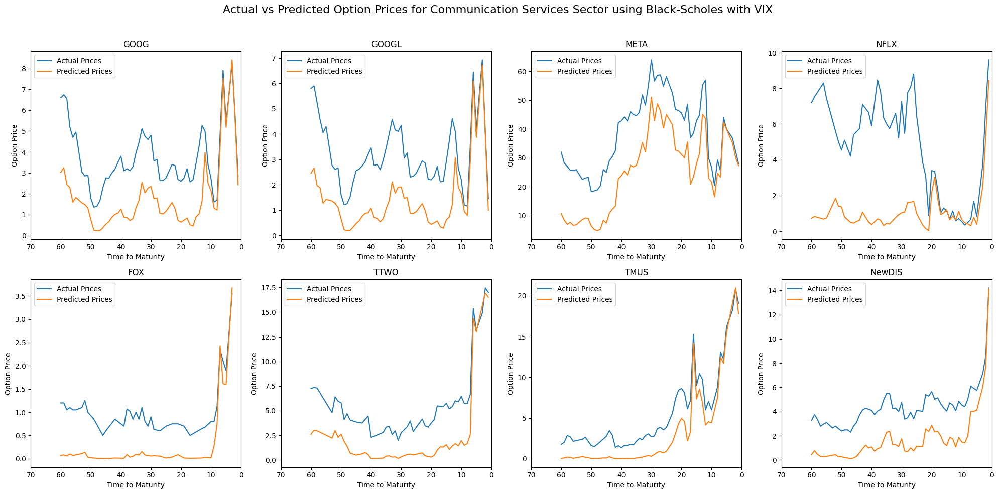

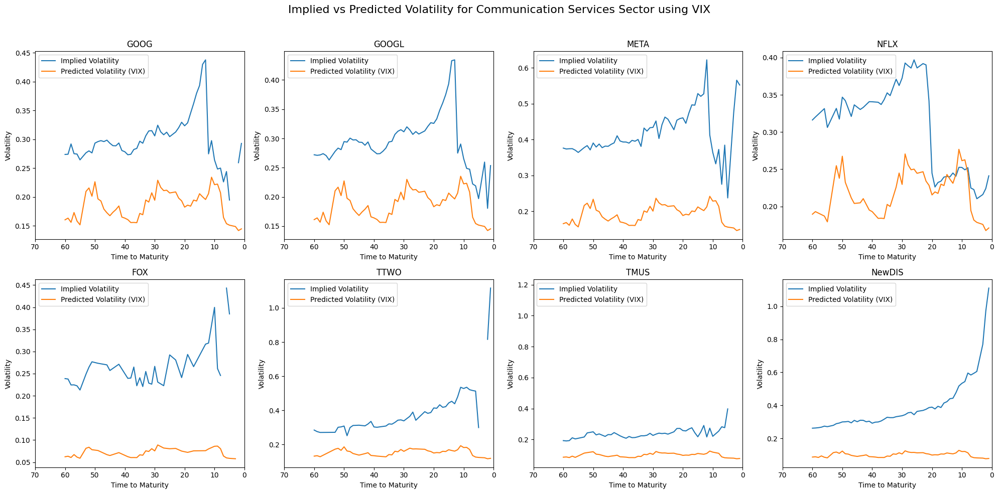

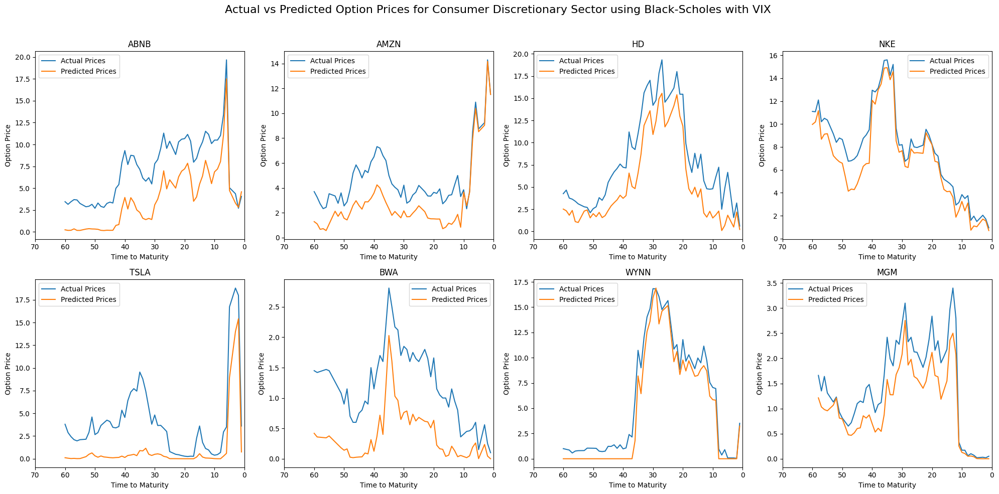

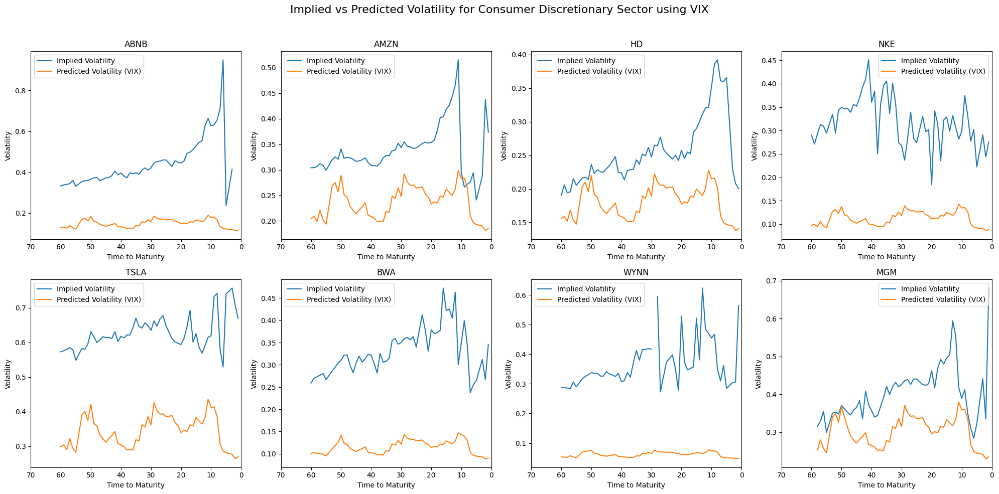

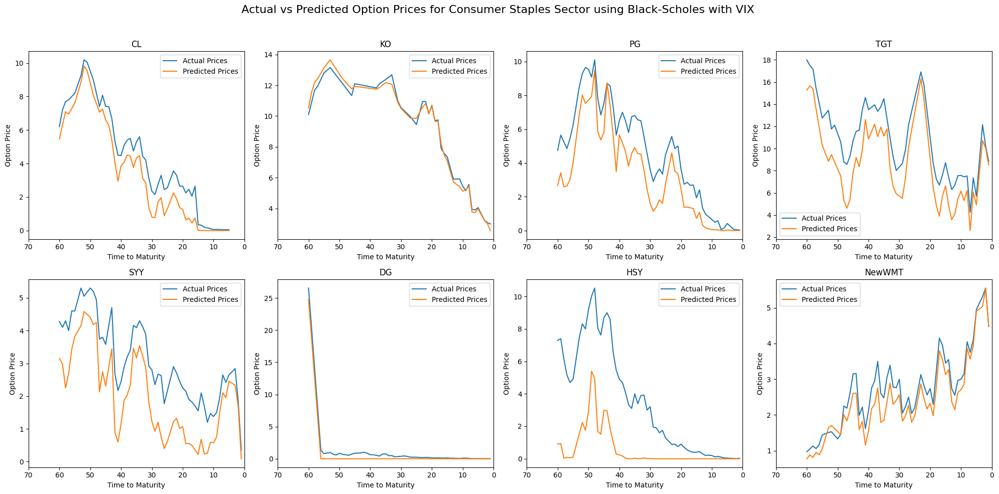

...

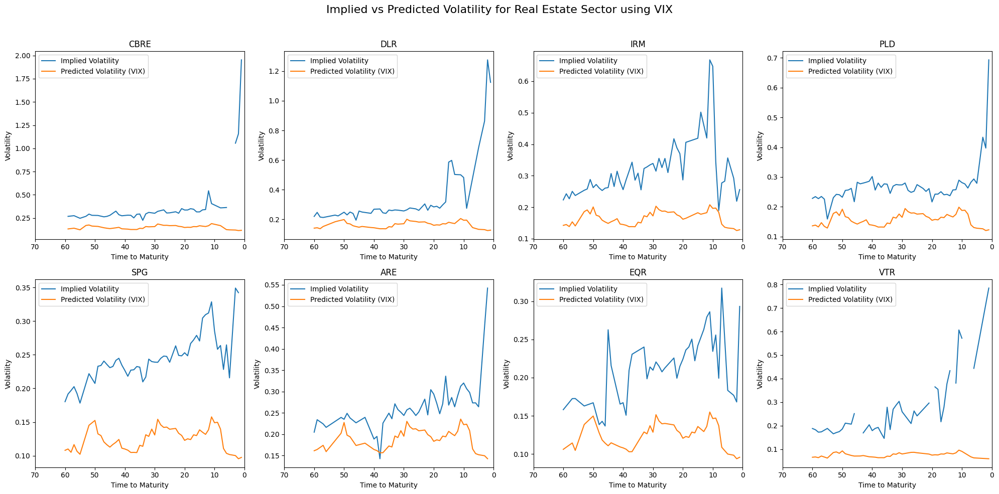

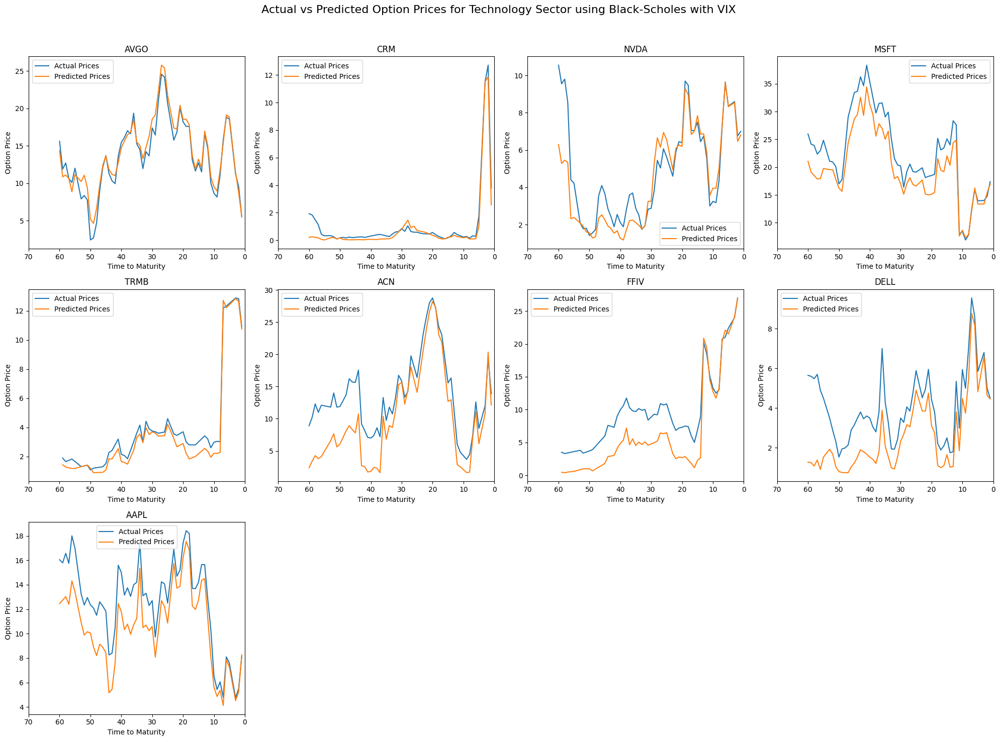

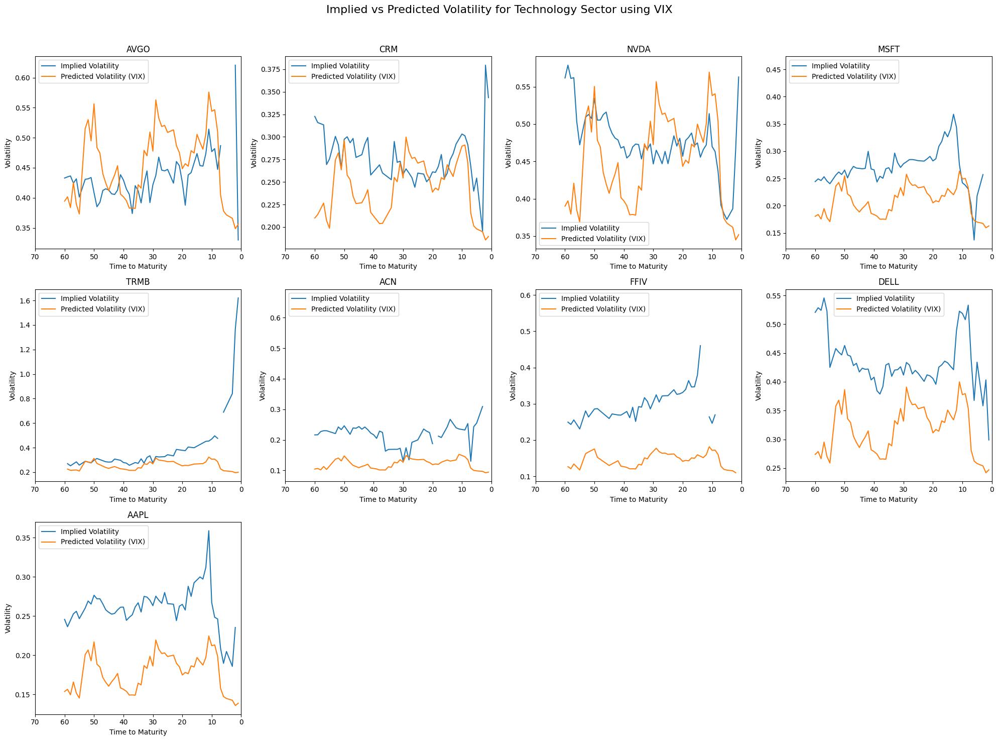

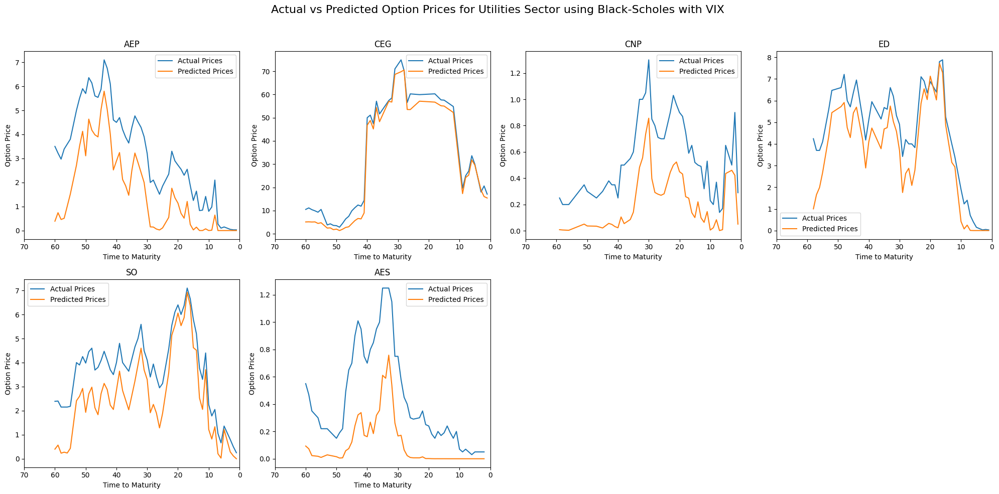

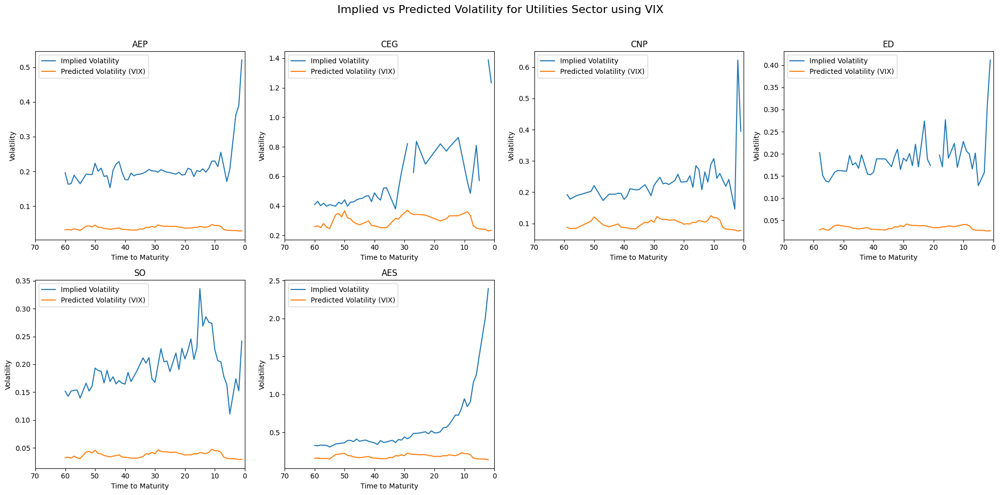

In [ ]:
# Communication Services
BS_VIX_CommunicationServices = Black_Scholes_VIX('Communication Services', df_main_CommunicationServices, df_other_CommunicationServices)
plot_actual_vs_predicted('Communication Services', df_main_CommunicationServices, df_other_CommunicationServices, BS_VIX_CommunicationServices, 'VIX')
implied_volatility_CommunicationServices = implied_volatility('Communication Services', df_main_CommunicationServices, df_other_CommunicationServices)
plot_implied_vs_predicted_volatilty('Communication Services', df_main_CommunicationServices, df_other_CommunicationServices, BS_VIX_CommunicationServices, implied_volatility_CommunicationServices, 'VIX')

# Consumer Discretionary
BS_VIX_ConsumerDiscretionary = Black_Scholes_VIX('Consumer Discretionary', df_main_ConsumerDiscretionary, df_other_ConsumerDiscretionary)
plot_actual_vs_predicted('Consumer Discretionary', df_main_ConsumerDiscretionary, df_other_ConsumerDiscretionary, BS_VIX_ConsumerDiscretionary, 'VIX')
implied_volatility_ConsumerDiscretionary = implied_volatility('Consumer Discretionary', df_main_ConsumerDiscretionary, df_other_ConsumerDiscretionary)
plot_implied_vs_predicted_volatilty('Consumer Discretionary', df_main_ConsumerDiscretionary, df_other_ConsumerDiscretionary, BS_VIX_ConsumerDiscretionary, implied_volatility_ConsumerDiscretionary, 'VIX')

# Consumer Staples
BS_VIX_ConsumerStaples = Black_Scholes_VIX('Consumer Staples', df_main_ConsumerStaples, df_other_ConsumerStaples)
plot_actual_vs_predicted('Consumer Staples', df_main_ConsumerStaples, df_other_ConsumerStaples, BS_VIX_ConsumerStaples, 'VIX')
implied_volatility_ConsumerStaples = implied_volatility('Consumer Staples', df_main_ConsumerStaples, df_other_ConsumerStaples)
plot_implied_vs_predicted_volatilty('Consumer Staples', df_main_ConsumerStaples, df_other_ConsumerStaples, BS_VIX_ConsumerStaples, implied_volatility_ConsumerStaples, 'VIX')

# Energy
BS_VIX_Energy = Black_Scholes_VIX('Energy', df_main_Energy, df_other_Energy)
plot_actual_vs_predicted('Energy', df_main_Energy, df_other_Energy, BS_VIX_Energy, 'VIX')
implied_volatility_Energy = implied_volatility('Energy', df_main_Energy, df_other_Energy)
plot_implied_vs_predicted_volatilty('Energy', df_main_Energy, df_other_Energy, BS_VIX_Energy, implied_volatility_Energy, 'VIX')

# Financial
BS_VIX_Financial = Black_Scholes_VIX('Financial', df_main_Financial, df_other_Financial)
plot_actual_vs_predicted('Financial', df_main_Financial, df_other_Financial, BS_VIX_Financial, 'VIX')
implied_volatility_Financial = implied_volatility('Financial', df_main_Financial, df_other_Financial)
plot_implied_vs_predicted_volatilty('Financial', df_main_Financial, df_other_Financial, BS_VIX_Financial, implied_volatility_Financial, 'VIX')

# Healthcare
BS_VIX_Healthcare = Black_Scholes_VIX('Healthcare', df_main_Healthcare, df_other_Healthcare)
plot_actual_vs_predicted('Healthcare', df_main_Healthcare, df_other_Healthcare, BS_VIX_Healthcare, 'VIX')
implied_volatility_Healthcare = implied_volatility('Healthcare', df_main_Healthcare, df_other_Healthcare)
plot_implied_vs_predicted_volatilty('Healthcare', df_main_Healthcare, df_other_Healthcare, BS_VIX_Healthcare, implied_volatility_Healthcare, 'VIX')

# Industrials
BS_VIX_Industrials = Black_Scholes_VIX('Industrials', df_main_Industrials, df_other_Industrials)
plot_actual_vs_predicted('Industrials', df_main_Industrials, df_other_Industrials, BS_VIX_Industrials, 'VIX')
implied_volatility_Industrials = implied_volatility('Industrials', df_main_Industrials, df_other_Industrials)
plot_implied_vs_predicted_volatilty('Industrials', df_main_Industrials, df_other_Industrials, BS_VIX_Industrials, implied_volatility_Industrials, 'VIX')

# Materials
BS_VIX_Materials = Black_Scholes_VIX('Materials', df_main_Materials, df_other_Materials)
plot_actual_vs_predicted('Materials', df_main_Materials, df_other_Materials, BS_VIX_Materials, 'VIX')
implied_volatility_Materials = implied_volatility('Materials', df_main_Materials, df_other_Materials)
plot_implied_vs_predicted_volatilty('Materials', df_main_Materials, df_other_Materials, BS_VIX_Materials, implied_volatility_Materials, 'VIX')

# Real Estate
BS_VIX_RealEstate = Black_Scholes_VIX('Real Estate', df_main_RealEstate, df_other_RealEstate)
plot_actual_vs_predicted('Real Estate', df_main_RealEstate, df_other_RealEstate, BS_VIX_RealEstate, 'VIX')
implied_volatility_RealEstate = implied_volatility('Real Estate', df_main_RealEstate, df_other_RealEstate)
plot_implied_vs_predicted_volatilty('Real Estate', df_main_RealEstate, df_other_RealEstate, BS_VIX_RealEstate, implied_volatility_RealEstate, 'VIX')

# Technology
BS_VIX_Technology = Black_Scholes_VIX('Technology', df_main_Technology, df_other_Technology)
plot_actual_vs_predicted('Technology', df_main_Technology, df_other_Technology, BS_VIX_Technology, 'VIX')
implied_volatility_Technology = implied_volatility('Technology', df_main_Technology, df_other_Technology)
plot_implied_vs_predicted_volatilty('Technology', df_main_Technology, df_other_Technology, BS_VIX_Technology, implied_volatility_Technology, 'VIX')

# Utilities
BS_VIX_Utilities = Black_Scholes_VIX('Utilities', df_main_Utilities, df_other_Utilities)
plot_actual_vs_predicted('Utilities', df_main_Utilities, df_other_Utilities, BS_VIX_Utilities, 'VIX')
implied_volatility_Utilities = implied_volatility('Utilities', df_main_Utilities, df_other_Utilities)
plot_implied_vs_predicted_volatilty('Utilities', df_main_Utilities, df_other_Utilities, BS_VIX_Utilities, implied_volatility_Utilities, 'VIX')


Saved dataframes to prevent needing to rerun

In [ ]:
BS_VIX_CommunicationServices.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_VIX_CommunicationServices.xlsx", index=False)
BS_VIX_ConsumerDiscretionary.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_VIX_ConsumerDiscretionary.xlsx", index=False)
BS_VIX_ConsumerStaples.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_VIX_ConsumerStaples.xlsx", index=False)
BS_VIX_Energy.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_VIX_Energy.xlsx", index=False)
BS_VIX_Financial.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_VIX_Financial.xlsx", index=False)
BS_VIX_Healthcare.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_VIX_Healthcare.xlsx", index=False)
BS_VIX_Industrials.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_VIX_Industrials.xlsx", index=False)
BS_VIX_Materials.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_VIX_Materials.xlsx", index=False)
BS_VIX_RealEstate.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_VIX_RealEstate.xlsx", index=False)
BS_VIX_Technology.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_VIX_Technology.xlsx", index=False)
BS_VIX_Utilities.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_VIX_Utilities.xlsx", index=False)


In [ ]:
BS_VIX_CommunicationServices=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_VIX_CommunicationServices.xlsx")
BS_VIX_ConsumerDiscretionary=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_VIX_ConsumerDiscretionary.xlsx")
BS_VIX_ConsumerStaples=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_VIX_ConsumerStaples.xlsx")
BS_VIX_Energy=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_VIX_Energy.xlsx")
BS_VIX_Financial=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_VIX_Financial.xlsx")
BS_VIX_Healthcare=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_VIX_Healthcare.xlsx")
BS_VIX_Industrials=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_VIX_Industrials.xlsx")
BS_VIX_Materials=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_VIX_Materials.xlsx")
BS_VIX_RealEstate=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_VIX_RealEstate.xlsx")
BS_VIX_Technology=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_VIX_Technology.xlsx")
BS_VIX_Utilities=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_VIX_Utilities.xlsx")


Communication Services
GOOG 0.3121320239747435
GOOGL 0.3397907024964978
META 0.31740411821885994
NFLX 0.46897476159216256
FOX 0.2549665882277902
TTWO 0.2148829838721136
TMUS 0.12241249292868758
NewDIS 0.22954483729773673
Consumer Discretionary
ABNB 0.22319559552733753
AMZN 0.17278469735147037
HD 0.1635562159809771
NKE 0.08983828325243289
TSLA 0.2029837663973082
BWA 0.3243808640790976
WYNN 0.08107761834304864
MGM 0.14365693971536964
Consumer Staples
CL 0.10349606392763014
KO 0.02941356305427584
PG 0.15505773107213372
TGT 0.17775651037223095
SYY 0.23728346012263662
DG 0.02109766131915579
HSY 0.3573389590099653
NewWMT 0.08245176751692677
Energy
SLB 0.28882381209265806
PSX 0.24593061391192414
WMB 0.04081137725357907
MPC 0.22004501869187146
OXY 0.14365638684704696
NewAPA 0.2002856482198475
NewEOG 0.26481055266338277
Financial
GS 0.06717320475403596
JPM 0.10571054350537808
BEN 0.41579701466234703
CFG 0.20524967727900417
NewV 0.16135843795484578
NewIVZ 0.237257462699728
NewBAC 0.1458736752109

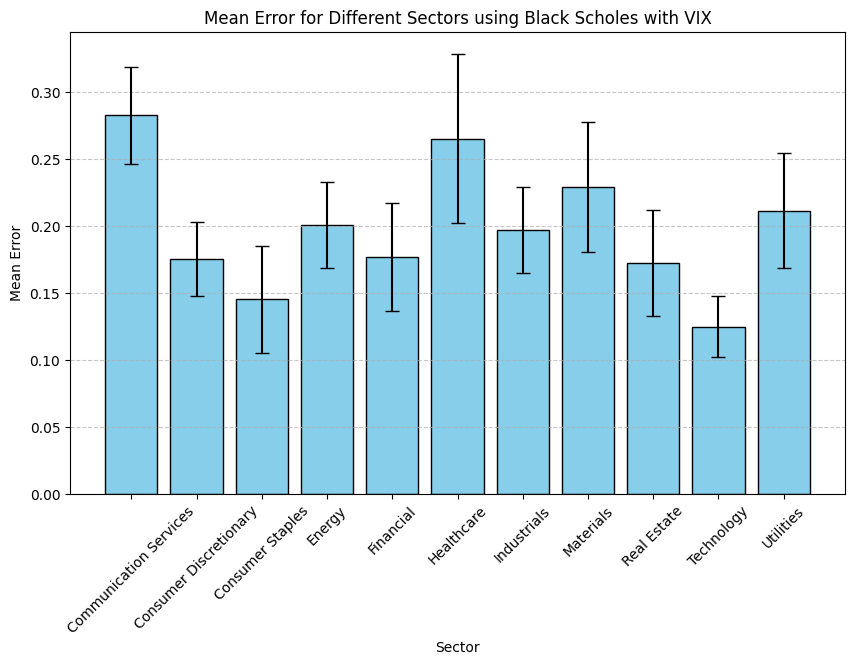

Mean error using Black Scholes with VIX for sector Communication Services is: 0.282514 ± 0.036330
Mean error using Black Scholes with VIX for sector Consumer Discretionary is: 0.175184 ± 0.027585
Mean error using Black Scholes with VIX for sector Consumer Staples is: 0.145487 ± 0.039893
Mean error using Black Scholes with VIX for sector Energy is: 0.200623 ± 0.032040
Mean error using Black Scholes with VIX for sector Financial is: 0.176782 ± 0.040099
Mean error using Black Scholes with VIX for sector Healthcare is: 0.265182 ± 0.063156
Mean error using Black Scholes with VIX for sector Industrials is: 0.197187 ± 0.032115
Mean error using Black Scholes with VIX for sector Materials is: 0.228906 ± 0.048375
Mean error using Black Scholes with VIX for sector Real Estate is: 0.172374 ± 0.039545
Mean error using Black Scholes with VIX for sector Technology is: 0.124940 ± 0.022850
Mean error using Black Scholes with VIX for sector Utilities is: 0.211424 ± 0.042980


In [ ]:
# Communication Services
BS_VIX_rmses_CommunicationServices = RMSE("Communication Services", df_main_CommunicationServices, df_other_CommunicationServices, BS_VIX_CommunicationServices, 'VIX')

# Consumer Discretionary
BS_VIX_rmses_ConsumerDiscretionary = RMSE("Consumer Discretionary", df_main_ConsumerDiscretionary, df_other_ConsumerDiscretionary, BS_VIX_ConsumerDiscretionary, 'VIX')

# Consumer Staples
BS_VIX_rmses_ConsumerStaples = RMSE("Consumer Staples", df_main_ConsumerStaples, df_other_ConsumerStaples, BS_VIX_ConsumerStaples, 'VIX')

# Energy
BS_VIX_rmses_Energy = RMSE("Energy", df_main_Energy, df_other_Energy, BS_VIX_Energy, 'VIX')

# Financial
BS_VIX_rmses_Financial = RMSE("Financial", df_main_Financial, df_other_Financial, BS_VIX_Financial, 'VIX')

# Healthcare
BS_VIX_rmses_Healthcare = RMSE("Healthcare", df_main_Healthcare, df_other_Healthcare, BS_VIX_Healthcare, 'VIX')

# Industrials
BS_VIX_rmses_Industrials = RMSE("Industrials", df_main_Industrials, df_other_Industrials, BS_VIX_Industrials, 'VIX')

# Materials
BS_VIX_rmses_Materials = RMSE("Materials", df_main_Materials, df_other_Materials, BS_VIX_Materials, 'VIX')

# Real Estate
BS_VIX_rmses_RealEstate = RMSE("Real Estate", df_main_RealEstate, df_other_RealEstate, BS_VIX_RealEstate, 'VIX')

# Technology
BS_VIX_rmses_Technology = RMSE("Technology", df_main_Technology, df_other_Technology, BS_VIX_Technology, 'VIX')

# Utilities
BS_VIX_rmses_Utilities = RMSE("Utilities", df_main_Utilities, df_other_Utilities, BS_VIX_Utilities, 'VIX')

BS_VIX_rmses_array = [
    BS_VIX_rmses_CommunicationServices,
    BS_VIX_rmses_ConsumerDiscretionary,
    BS_VIX_rmses_ConsumerStaples,
    BS_VIX_rmses_Energy,
    BS_VIX_rmses_Financial,
    BS_VIX_rmses_Healthcare,
    BS_VIX_rmses_Industrials,
    BS_VIX_rmses_Materials,
    BS_VIX_rmses_RealEstate,
    BS_VIX_rmses_Technology,
    BS_VIX_rmses_Utilities
]

plot_rmses_for_method(BS_VIX_rmses_array,sector_list,"Black Scholes with VIX")

# **Investigating Black-Scholes with ARCH/GARCH**

Contains plots for option pricing with Black-Scholes using ARCH/GARCH as well as comparisons for all sectors using this method.

/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr

For Communication Services GARCH(1,1) is used 8 times.


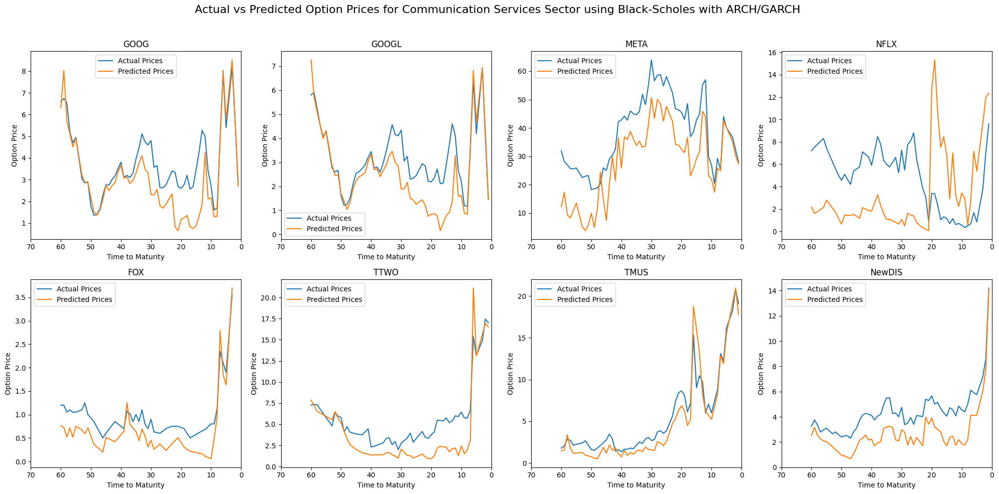

/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/

For Consumer Discretionary GARCH(1,1) is used 8 times.


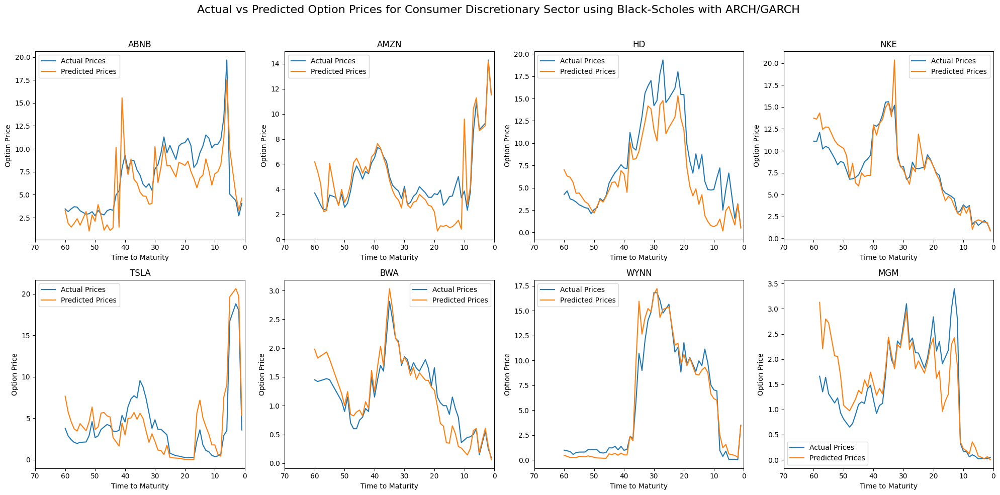

/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/uni

For CL GARCH( 10 , 3 ) is used


/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/uni

For PG GARCH( 2 , 2 ) is used


/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr

For DG GARCH( 2 , 9 ) is used


/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packag

For HSY GARCH( 8 , 4 ) is used


/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/uni

For NewWMT GARCH( 10 , 2 ) is used
For Consumer Staples GARCH(1,1) is used 3 times.


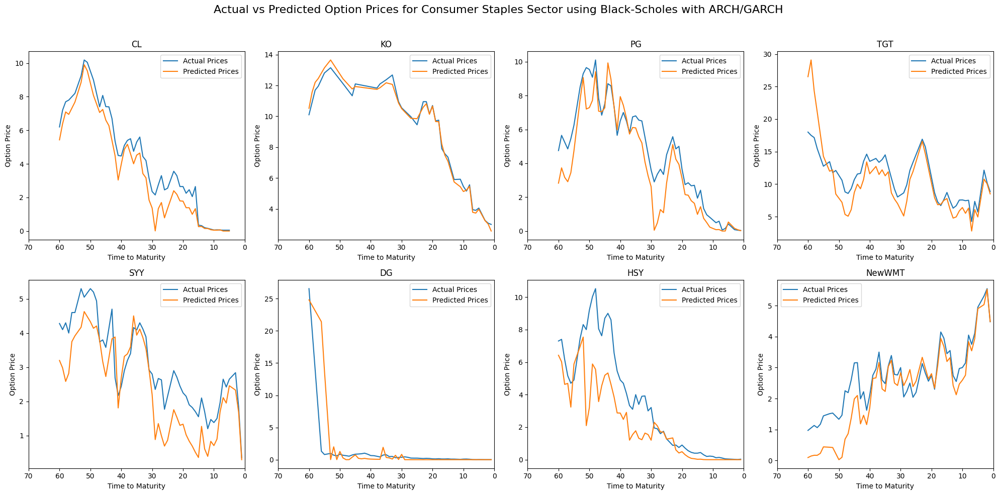

/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packag

For Energy GARCH(1,1) is used 7 times.


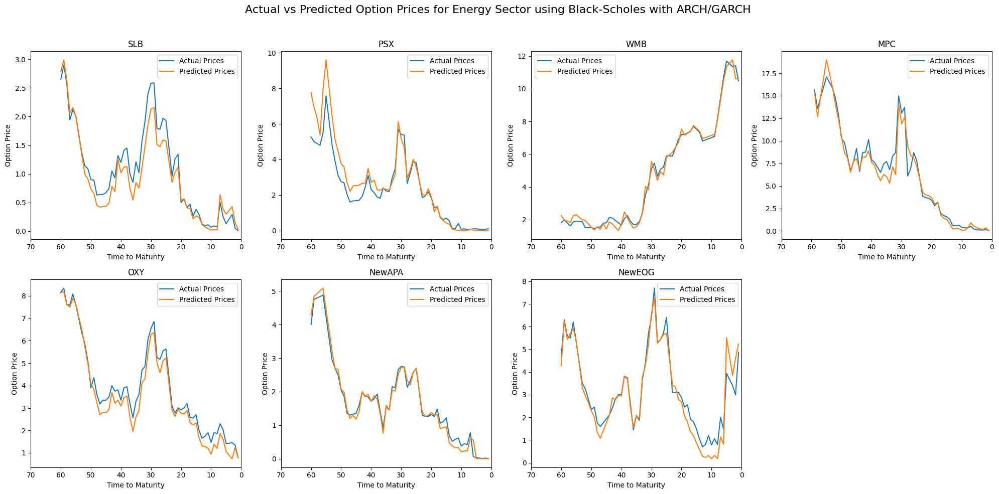

/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/

For Financial GARCH(1,1) is used 8 times.


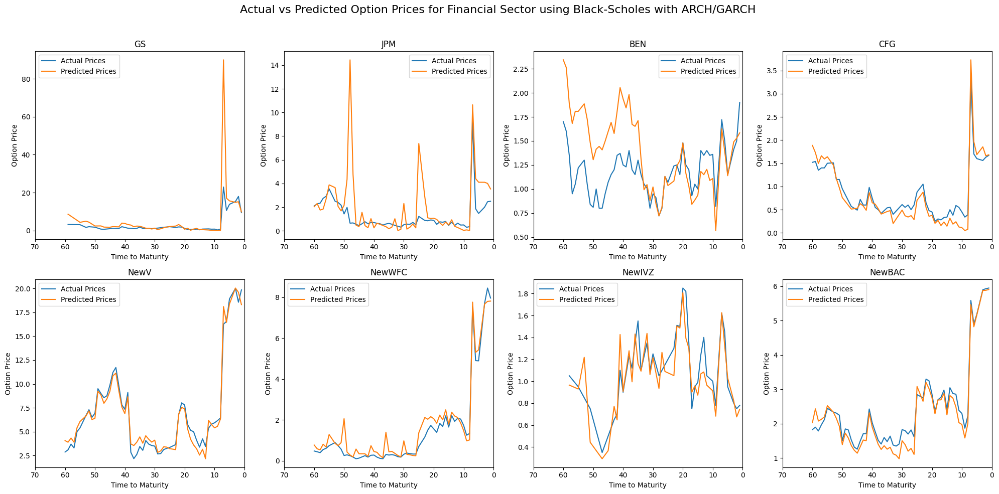

/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-package

For Healthcare GARCH(1,1) is used 9 times.


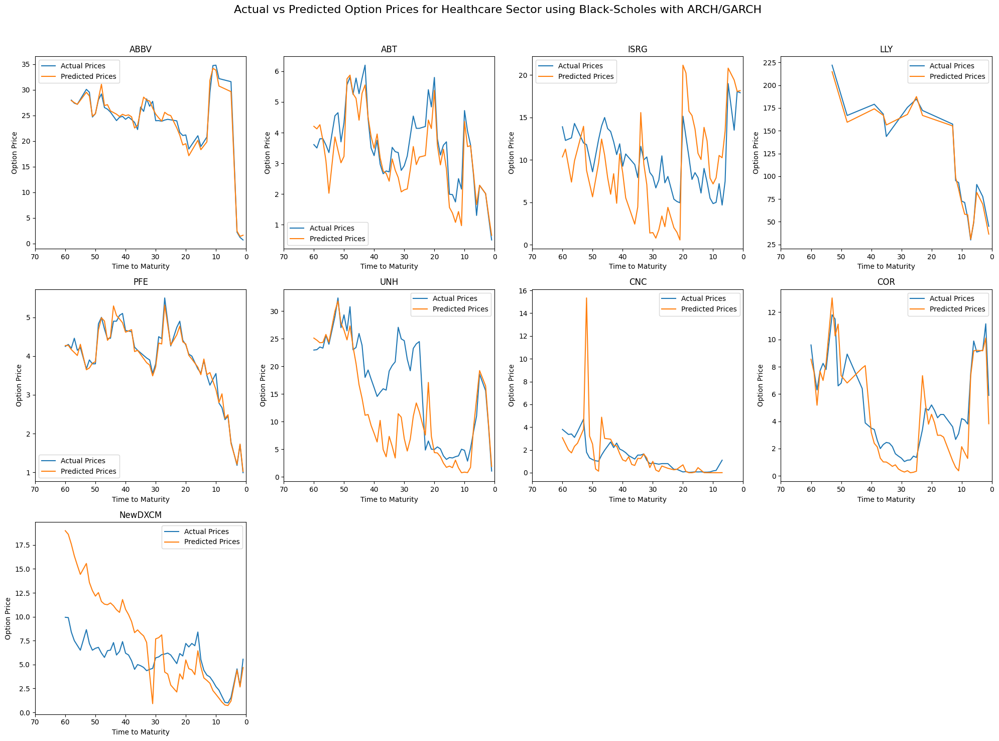

/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/

For Industrials GARCH(1,1) is used 8 times.


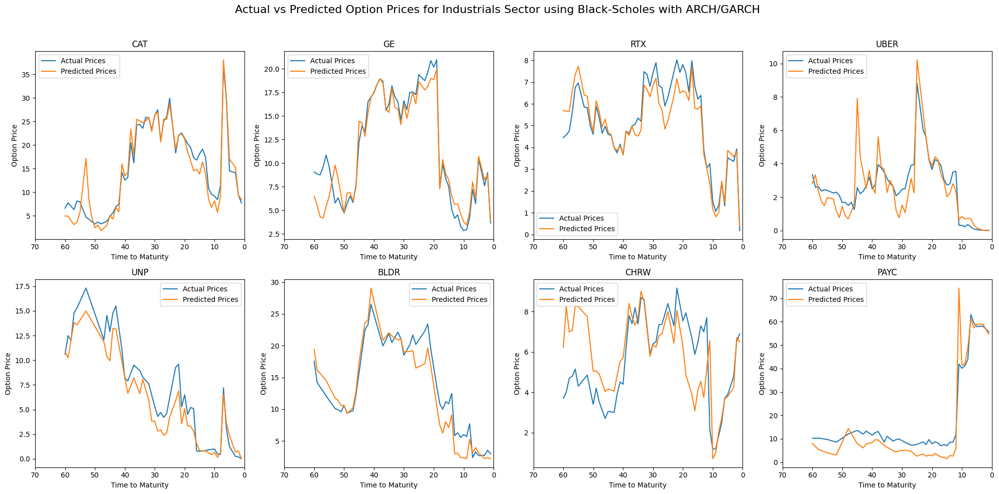

/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/uni

For Materials GARCH(1,1) is used 7 times.


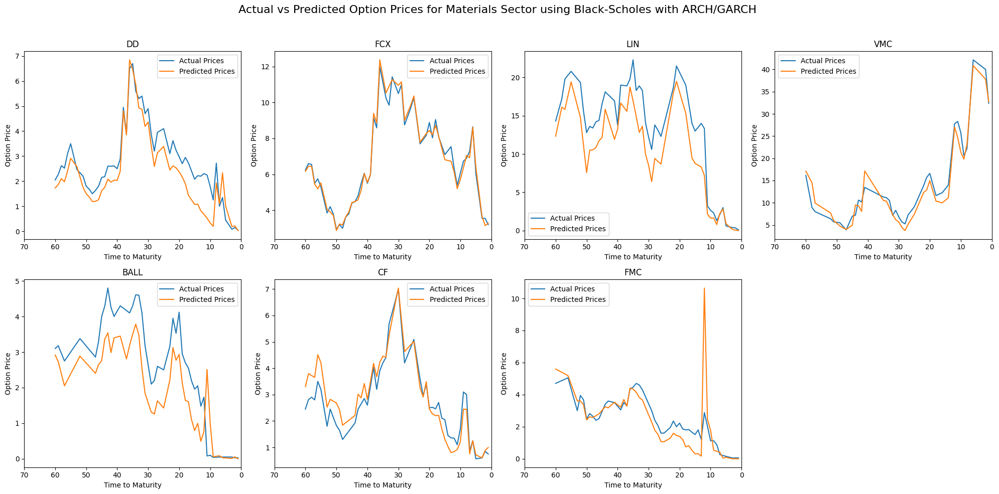

/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/uni

For Real Estate GARCH(1,1) is used 8 times.


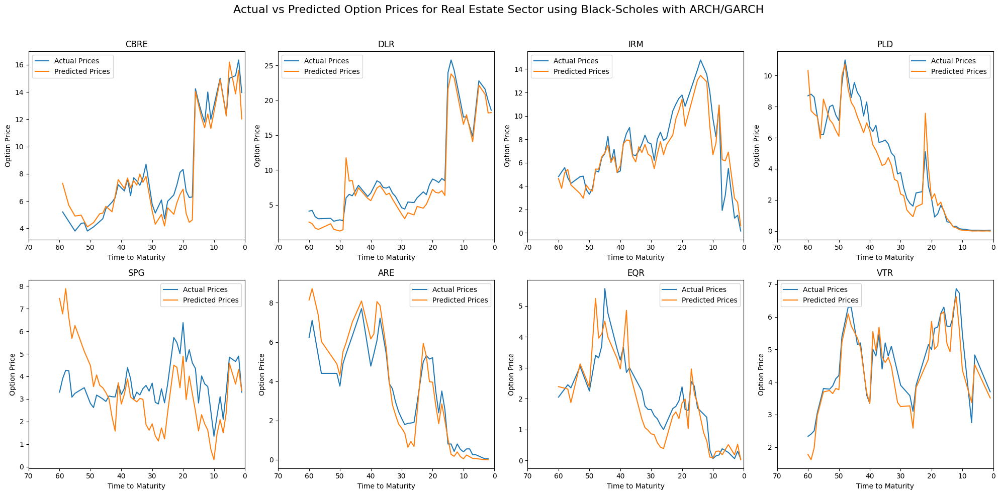

/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/

For Technology GARCH(1,1) is used 9 times.


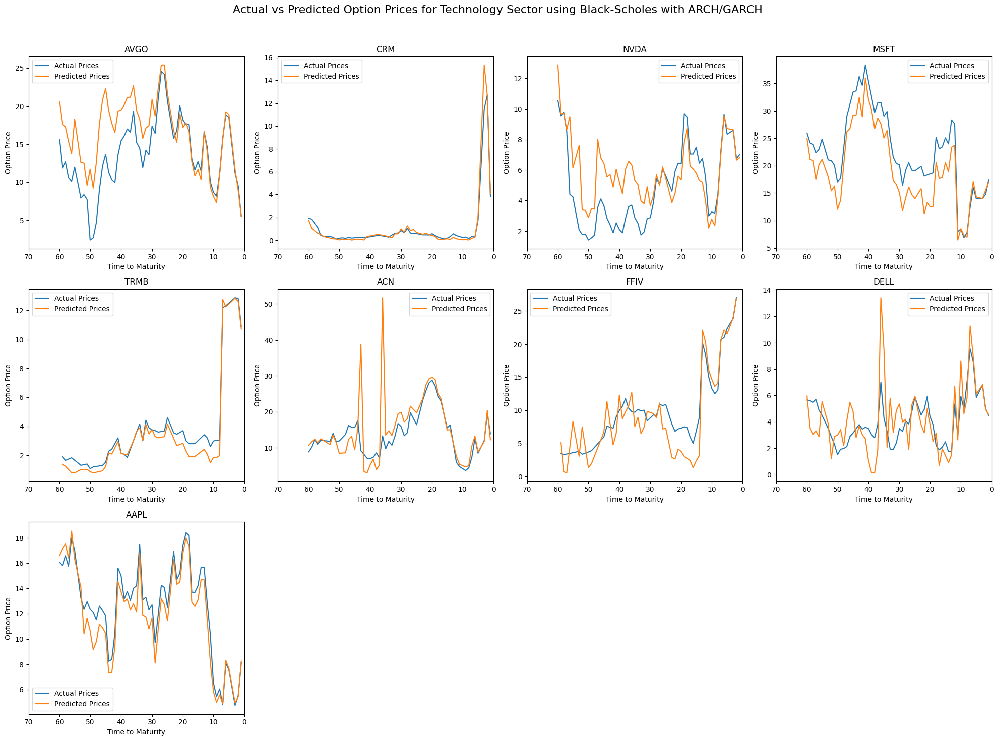

/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/

For Utilities GARCH(1,1) is used 6 times.


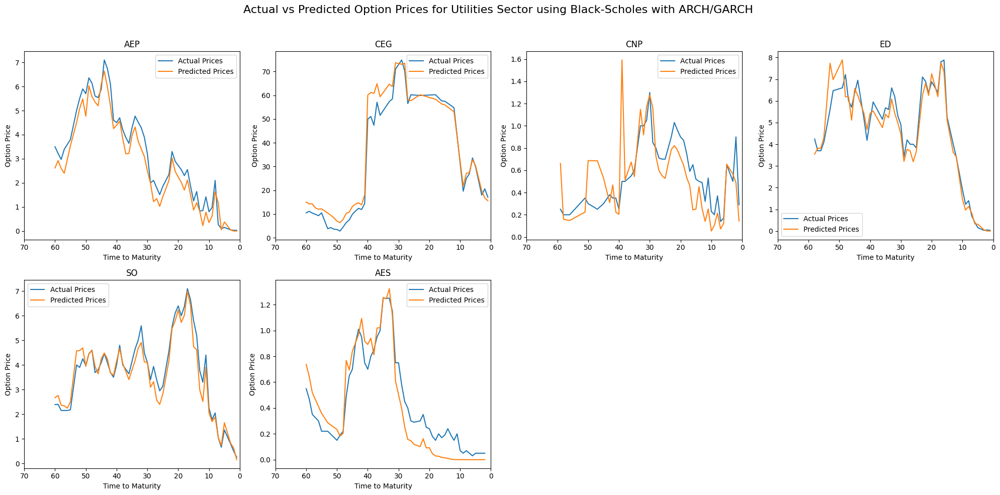

In [ ]:
# Communication Services
BS_ARCH_GARCH_CommunicationServices = Black_Scholes_ARCH_GARCH('Communication Services', df_main_CommunicationServices, df_other_CommunicationServices, returns_CommunicationServices)
plot_actual_vs_predicted('Communication Services', df_main_CommunicationServices, df_other_CommunicationServices, BS_ARCH_GARCH_CommunicationServices, 'ARCH/GARCH')

# Consumer Discretionary
BS_ARCH_GARCH_ConsumerDiscretionary = Black_Scholes_ARCH_GARCH('Consumer Discretionary', df_main_ConsumerDiscretionary, df_other_ConsumerDiscretionary, returns_ConsumerDiscretionary)
plot_actual_vs_predicted('Consumer Discretionary', df_main_ConsumerDiscretionary, df_other_ConsumerDiscretionary, BS_ARCH_GARCH_ConsumerDiscretionary, 'ARCH/GARCH')

# Consumer Staples
BS_ARCH_GARCH_ConsumerStaples = Black_Scholes_ARCH_GARCH('Consumer Staples', df_main_ConsumerStaples, df_other_ConsumerStaples, returns_ConsumerStaples)
plot_actual_vs_predicted('Consumer Staples', df_main_ConsumerStaples, df_other_ConsumerStaples, BS_ARCH_GARCH_ConsumerStaples, 'ARCH/GARCH')

# Energy
BS_ARCH_GARCH_Energy = Black_Scholes_ARCH_GARCH('Energy', df_main_Energy, df_other_Energy, returns_Energy)
plot_actual_vs_predicted('Energy', df_main_Energy, df_other_Energy, BS_ARCH_GARCH_Energy, 'ARCH/GARCH')

# Financial
BS_ARCH_GARCH_Financial = Black_Scholes_ARCH_GARCH('Financial', df_main_Financial, df_other_Financial, returns_Financial)
plot_actual_vs_predicted('Financial', df_main_Financial, df_other_Financial, BS_ARCH_GARCH_Financial, 'ARCH/GARCH')

# Healthcare
BS_ARCH_GARCH_Healthcare = Black_Scholes_ARCH_GARCH('Healthcare', df_main_Healthcare, df_other_Healthcare, returns_Healthcare)
plot_actual_vs_predicted('Healthcare', df_main_Healthcare, df_other_Healthcare, BS_ARCH_GARCH_Healthcare, 'ARCH/GARCH')

# Industrials
BS_ARCH_GARCH_Industrials = Black_Scholes_ARCH_GARCH('Industrials', df_main_Industrials, df_other_Industrials, returns_Industrials)
plot_actual_vs_predicted('Industrials', df_main_Industrials, df_other_Industrials, BS_ARCH_GARCH_Industrials, 'ARCH/GARCH')

# Materials
BS_ARCH_GARCH_Materials = Black_Scholes_ARCH_GARCH('Materials', df_main_Materials, df_other_Materials, returns_Materials)
plot_actual_vs_predicted('Materials', df_main_Materials, df_other_Materials, BS_ARCH_GARCH_Materials, 'ARCH/GARCH')

# Real Estate
BS_ARCH_GARCH_RealEstate = Black_Scholes_ARCH_GARCH('Real Estate', df_main_RealEstate, df_other_RealEstate, returns_RealEstate)
plot_actual_vs_predicted('Real Estate', df_main_RealEstate, df_other_RealEstate, BS_ARCH_GARCH_RealEstate, 'ARCH/GARCH')

# Technology
BS_ARCH_GARCH_Technology = Black_Scholes_ARCH_GARCH('Technology', df_main_Technology, df_other_Technology, returns_Technology)
plot_actual_vs_predicted('Technology', df_main_Technology, df_other_Technology, BS_ARCH_GARCH_Technology, 'ARCH/GARCH')

# Utilities
BS_ARCH_GARCH_Utilities = Black_Scholes_ARCH_GARCH('Utilities', df_main_Utilities, df_other_Utilities, returns_Utilities)
plot_actual_vs_predicted('Utilities', df_main_Utilities, df_other_Utilities, BS_ARCH_GARCH_Utilities, 'ARCH/GARCH')



Saved dataframes to prevent needing to rerun

In [ ]:
BS_ARCH_GARCH_CommunicationServices.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_ARCH_GARCH_CommunicationServices.xlsx", index=False)
BS_ARCH_GARCH_ConsumerDiscretionary.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_ARCH_GARCH_ConsumerDiscretionary.xlsx", index=False)
BS_ARCH_GARCH_ConsumerStaples.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_ARCH_GARCH_ConsumerStaples.xlsx", index=False)
BS_ARCH_GARCH_Energy.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_ARCH_GARCH_Energy.xlsx", index=False)
BS_ARCH_GARCH_Financial.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_ARCH_GARCH_Financial.xlsx", index=False)
BS_ARCH_GARCH_Healthcare.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_ARCH_GARCH_Healthcare.xlsx", index=False)
BS_ARCH_GARCH_Industrials.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_ARCH_GARCH_Industrials.xlsx", index=False)
BS_ARCH_GARCH_Materials.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_ARCH_GARCH_Materials.xlsx", index=False)
BS_ARCH_GARCH_RealEstate.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_ARCH_GARCH_RealEstate.xlsx", index=False)
BS_ARCH_GARCH_Technology.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_ARCH_GARCH_Technology.xlsx", index=False)
BS_ARCH_GARCH_Utilities.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_ARCH_GARCH_Utilities.xlsx", index=False)

In [ ]:
BS_ARCH_GARCH_CommunicationServices=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_ARCH_GARCH_CommunicationServices.xlsx")
BS_ARCH_GARCH_ConsumerDiscretionary=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_ARCH_GARCH_ConsumerDiscretionary.xlsx")
BS_ARCH_GARCH_ConsumerStaples=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_ARCH_GARCH_ConsumerStaples.xlsx")
BS_ARCH_GARCH_Energy=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_ARCH_GARCH_Energy.xlsx")
BS_ARCH_GARCH_Financial=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_ARCH_GARCH_Financial.xlsx")
BS_ARCH_GARCH_Healthcare=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_ARCH_GARCH_Healthcare.xlsx")
BS_ARCH_GARCH_Industrials=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_ARCH_GARCH_Industrials.xlsx")
BS_ARCH_GARCH_Materials=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_ARCH_GARCH_Materials.xlsx")
BS_ARCH_GARCH_RealEstate=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_ARCH_GARCH_RealEstate.xlsx")
BS_ARCH_GARCH_Technology=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_ARCH_GARCH_Technology.xlsx")
BS_ARCH_GARCH_Utilities=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/BS_ARCH_GARCH_Utilities.xlsx")


Communication Services
GOOG 0.21075153855800993
GOOGL 0.23708754142372954
META 0.29499305541692367
NFLX 0.7377483187135441
FOX 0.11742692324675534
TTWO 0.17609422498072264
TMUS 0.10827078908136581
NewDIS 0.16275028558418983
Consumer Discretionary
ABNB 0.14302009570399016
AMZN 0.18947994866628773
HD 0.19274663310797757
NKE 0.10342518546039171
TSLA 0.1691860617647557
BWA 0.14405912281020578
WYNN 0.09702372005062386
MGM 0.20356366821650765
Consumer Staples
CL 0.09168479433783777
KO 0.029305166943569116
PG 0.12728472251701722
TGT 0.17699897314708585
SYY 0.1791267518754224
DG 0.15536136654521554
HSY 0.2310480078385596
NewWMT 0.14035796469824796
Energy
SLB 0.07981115592824337
PSX 0.16259239733721353
WMB 0.030435876053309437
MPC 0.06850505358926702
OXY 0.05478347720829009
NewAPA 0.05584230749818001
NewEOG 0.08928161703585889
Financial
GS 0.44389067640433894
JPM 0.16389439877182665
BEN 0.4745804900306207
CFG 0.09196055411344102
NewV 0.0847527239045423
NewIVZ 0.11007034296422595
NewBAC 0.083229

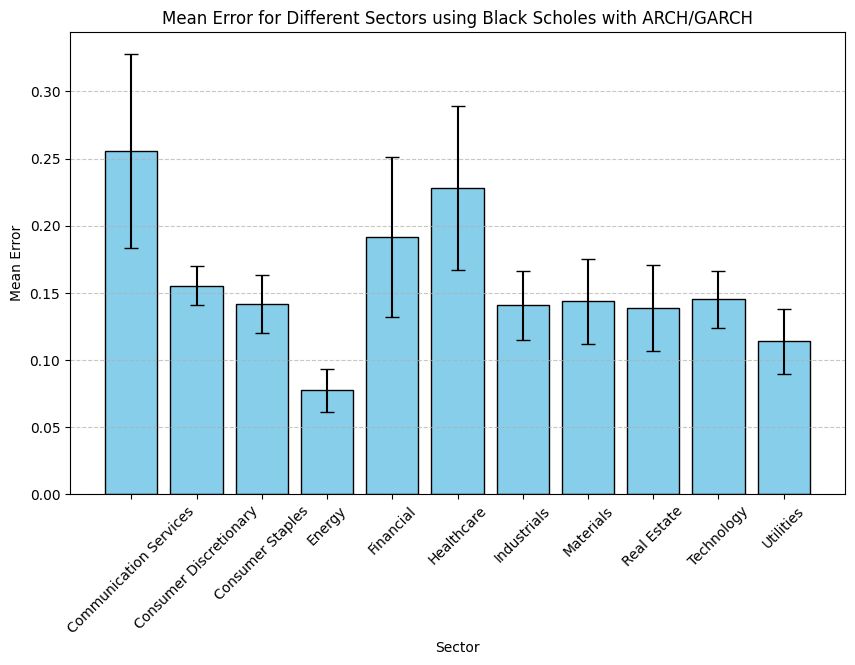

Mean error using Black Scholes with ARCH/GARCH for sector Communication Services is: 0.255640 ± 0.072224
Mean error using Black Scholes with ARCH/GARCH for sector Consumer Discretionary is: 0.155313 ± 0.014303
Mean error using Black Scholes with ARCH/GARCH for sector Consumer Staples is: 0.141396 ± 0.021613
Mean error using Black Scholes with ARCH/GARCH for sector Energy is: 0.077322 ± 0.015936
Mean error using Black Scholes with ARCH/GARCH for sector Financial is: 0.191503 ± 0.059276
Mean error using Black Scholes with ARCH/GARCH for sector Healthcare is: 0.227914 ± 0.061214
Mean error using Black Scholes with ARCH/GARCH for sector Industrials is: 0.140703 ± 0.025759
Mean error using Black Scholes with ARCH/GARCH for sector Materials is: 0.143473 ± 0.031905
Mean error using Black Scholes with ARCH/GARCH for sector Real Estate is: 0.138902 ± 0.032093
Mean error using Black Scholes with ARCH/GARCH for sector Technology is: 0.145012 ± 0.021125
Mean error using Black Scholes with ARCH/GAR

In [ ]:
# For Communication Services
BS_ARCH_GARCH_rmses_CommunicationServices = RMSE("Communication Services", df_main_CommunicationServices, df_other_CommunicationServices, BS_ARCH_GARCH_CommunicationServices, 'ARCH/GARCH')

# For Consumer Discretionary
BS_ARCH_GARCH_rmses_ConsumerDiscretionary = RMSE("Consumer Discretionary", df_main_ConsumerDiscretionary, df_other_ConsumerDiscretionary, BS_ARCH_GARCH_ConsumerDiscretionary, 'ARCH/GARCH')

# For Consumer Staples
BS_ARCH_GARCH_rmses_ConsumerStaples = RMSE("Consumer Staples", df_main_ConsumerStaples, df_other_ConsumerStaples, BS_ARCH_GARCH_ConsumerStaples, 'ARCH/GARCH')

# For Energy
BS_ARCH_GARCH_rmses_Energy = RMSE("Energy", df_main_Energy, df_other_Energy, BS_ARCH_GARCH_Energy, 'ARCH/GARCH')

# For Financial
BS_ARCH_GARCH_rmses_Financial = RMSE("Financial", df_main_Financial, df_other_Financial, BS_ARCH_GARCH_Financial, 'ARCH/GARCH')

# For Healthcare
BS_ARCH_GARCH_rmses_Healthcare = RMSE("Healthcare", df_main_Healthcare, df_other_Healthcare, BS_ARCH_GARCH_Healthcare, 'ARCH/GARCH')

# For Industrials
BS_ARCH_GARCH_rmses_Industrials = RMSE("Industrials", df_main_Industrials, df_other_Industrials, BS_ARCH_GARCH_Industrials, 'ARCH/GARCH')

# For Materials
BS_ARCH_GARCH_rmses_Materials = RMSE("Materials", df_main_Materials, df_other_Materials, BS_ARCH_GARCH_Materials, 'ARCH/GARCH')

# For Real Estate
BS_ARCH_GARCH_rmses_RealEstate = RMSE("Real Estate", df_main_RealEstate, df_other_RealEstate, BS_ARCH_GARCH_RealEstate, 'ARCH/GARCH')

# For Technology
BS_ARCH_GARCH_rmses_Technology = RMSE("Technology", df_main_Technology, df_other_Technology, BS_ARCH_GARCH_Technology, 'ARCH/GARCH')

# For Utilities
BS_ARCH_GARCH_rmses_Utilities = RMSE("Utilities", df_main_Utilities, df_other_Utilities, BS_ARCH_GARCH_Utilities, 'ARCH/GARCH')

BS_ARCH_GARCH_rmses_array = [
    BS_ARCH_GARCH_rmses_CommunicationServices,
    BS_ARCH_GARCH_rmses_ConsumerDiscretionary,
    BS_ARCH_GARCH_rmses_ConsumerStaples,
    BS_ARCH_GARCH_rmses_Energy,
    BS_ARCH_GARCH_rmses_Financial,
    BS_ARCH_GARCH_rmses_Healthcare,
    BS_ARCH_GARCH_rmses_Industrials,
    BS_ARCH_GARCH_rmses_Materials,
    BS_ARCH_GARCH_rmses_RealEstate,
    BS_ARCH_GARCH_rmses_Technology,
    BS_ARCH_GARCH_rmses_Utilities
]

plot_rmses_for_method(BS_ARCH_GARCH_rmses_array,sector_list,"Black Scholes with ARCH/GARCH")


# **Binomial Model**

Contains plots for option pricing with Black-Scholes using Binomial as well as comparisons for all sectors using this method.

In [ ]:
def Binomial(Sector,main_data,other_data,sector_volatilities,method,N=10):

  #Initialise data frame
  Sector_option_prices=pd.DataFrame({})
  #Get all tickers for the sector
  ticker_list=return_tickers(Sector)
  #print(ticker_list)
  #Get a list of dates between 2 globally defined dates for which we are looking at
  filtered_dates = main_data[(main_data['Date'] >= start_date) & (main_data['Date'] <= end_date)]['Date'].tolist()
  #Add these dates to our data frame
  Sector_option_prices['Date']=filtered_dates
  #Redefine method
  newmethod='Binomial'+'_'+method
  #Loop through all the tickers
  for ticker in ticker_list:
    #Initialise some lists where we temporarily store data for a particular company before adding to date frame
    option_prices=[]
    valid_dates=[]
    #volatilities=[]

    #Get strike price of option
    K=other_data.loc[other_data['Ticker'] == ticker, 'Strike'].values[0]
    #Get expiration date of option
    expiry=other_data.loc[other_data['Ticker'] == ticker, 'Expirations'].values[0]
    #Number of days before prediction
    #T=1/252

    #Loop through dates from list of dates obtained earlier
    for date in filtered_dates:

      #Get time to expiry and convert to years. Note the use of trading days
      tau= np.busday_count(date.date(), pd.Timestamp(expiry).date())/252

      #Check if either stock or option price is not not available for that day. We will go to next date if this is true.
      if pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_stock']).any() or pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_option']).any() or tau<=0:
        continue

      #Need to look into this more -> Deeping it maybe I don't need an offset because we are using today to evaluate option price today
      valid_dates.append(date+ pd.tseries.offsets.BDay(0))

      #Implementing new method from QuantPy
      dt=tau/N
      #Obtain stock price for that day
      S=main_data.loc[main_data['Date'] == date, ticker+'_stock'].values[0]
      #Obtain risk-free rate for that day
      rpercent=main_data.loc[main_data['Date'] == date, 'Rates'].values[0]
      #Change to decimal
      r= rpercent/100
      #Get volatility on date
      sigma=sector_volatilities.loc[sector_volatilities['Date'] == date, ticker+'_'+method].values[0]
      sigma=sigma
      #Initialise constants
      u=np.exp(sigma*np.sqrt(dt))
      d=1/u
      #print(u)
      p=(np.exp(r*dt)-d)/(u-d)
      disc=np.exp(-r*dt)
      C=S * (d**(np.arange(N,-1,-1))) * (u**(np.arange(0,N+1,1)))
      #print(C)
      C=np.maximum(C-K,np.zeros(N+1))

      for i in np.arange(N,0,-1):
        #print(C[1:i+1])
        #print(C[0:i])
        C=disc*(p*C[1:i+1]+(1-p)*C[0:i])
        #print(C)

      #Add option price to temporary list
      option_prices.append(C[0])

      """
      #Test
      T=tau/N
      #Need to look into this more -> Deeping it maybe I don't need an offset because we are using today to evaluate option price today
      valid_dates.append(date+ pd.tseries.offsets.BDay(0))
      #Obtain stock price for that day
      S=main_data.loc[main_data['Date'] == date, ticker+'_stock'].values[0]
      #Obtain risk-free rate for that day
      rpercent=main_data.loc[main_data['Date'] == date, 'Rates'].values[0]
      #Change to decimal
      r= rpercent/100
      #Get volatility on date
      sigma=sector_volatilities.loc[sector_volatilities['Date'] == date, ticker+'_'+method].values[0]
      sigma=sigma
      u=np.exp(sigma*np.sqrt(T))
      d=1/u
      p=(np.exp(r*T)-d)/(u-d)
      C=0
      for j in range(0,N+1):
        coefficient=math.comb(N,j)
        payoff=np.maximum((u**j)*(d**(N-j))*S-K,0)
        C=C+coefficient*payoff*(p**j)*((1-p)**(N-j))

      C=C*np.exp(-r*T)
      #Add option price to temporary list
      option_prices.append(C)
      """
    #Create temporary data frame with valid dates and evaluated option prices
    df_temp=pd.DataFrame({})
    df_temp['Date']=valid_dates
    df_temp[ticker+'_'+newmethod+'_option']=option_prices
    #Add data to main data frame
    Sector_option_prices=pd.merge(Sector_option_prices,df_temp,on='Date', how='outer')

  return Sector_option_prices


# **Investigating VIX with Binomial Model**

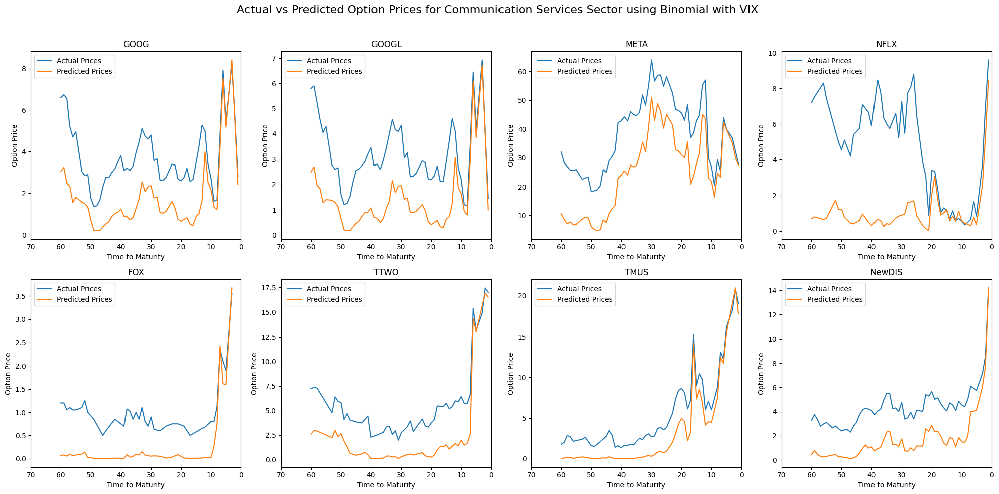

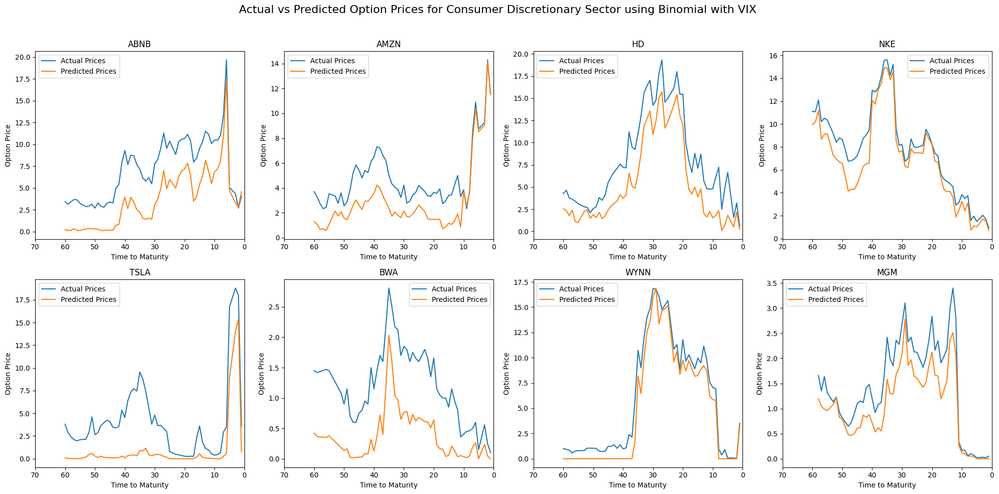

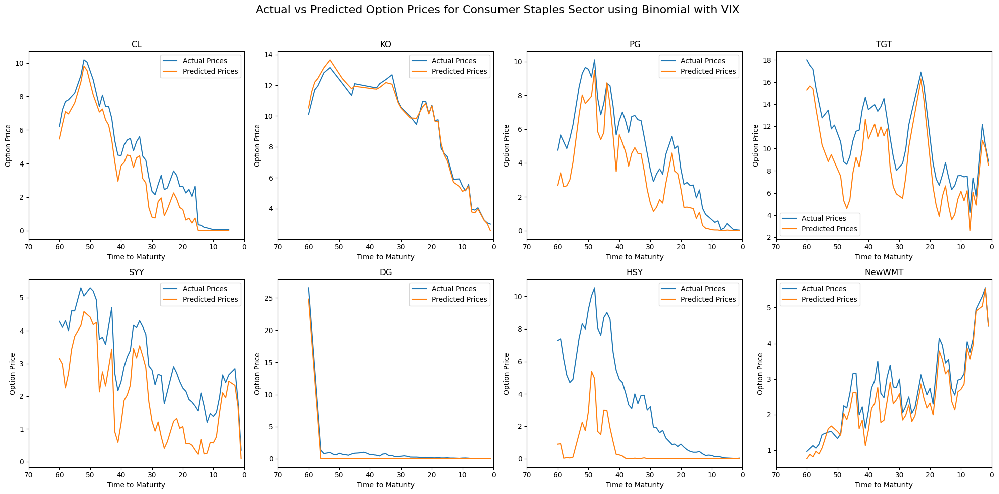

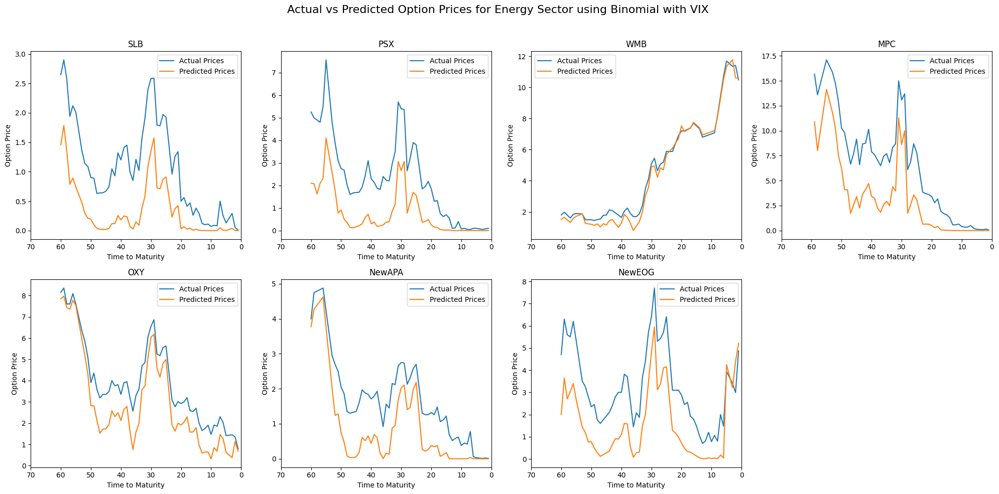

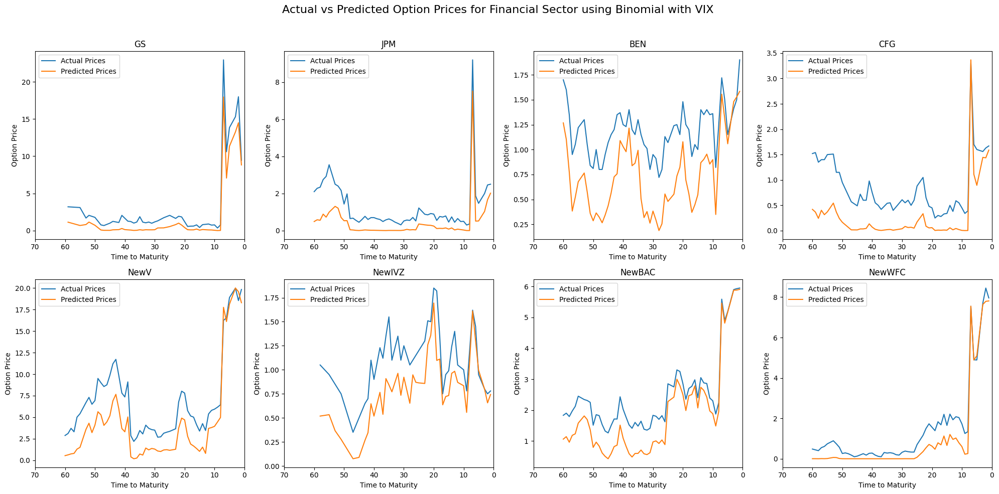

...

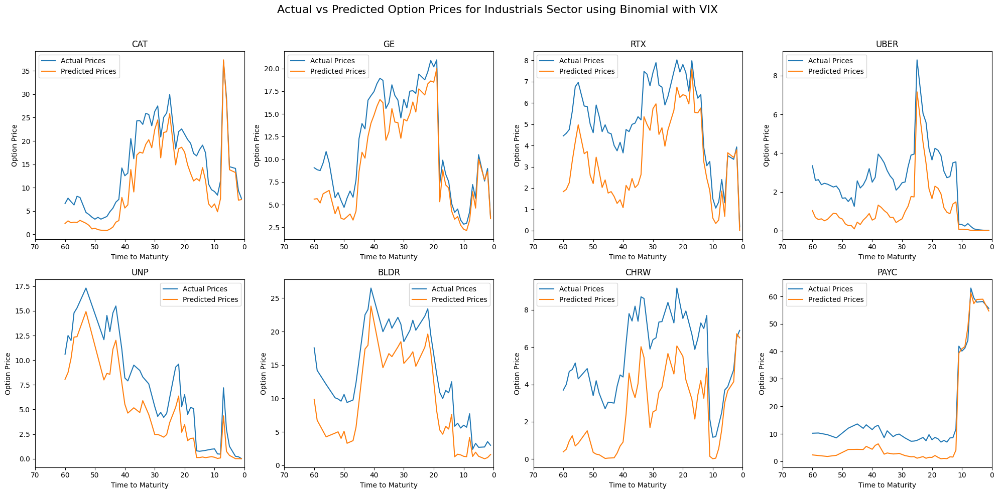

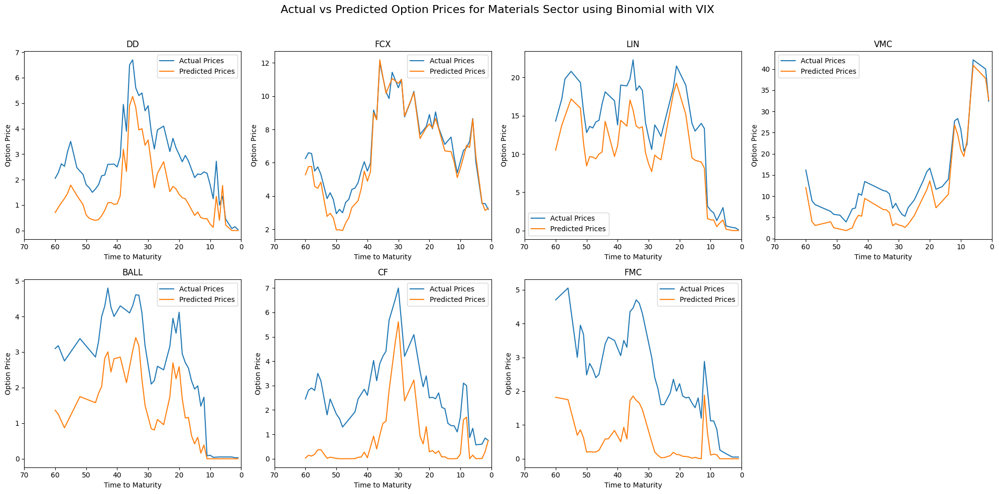

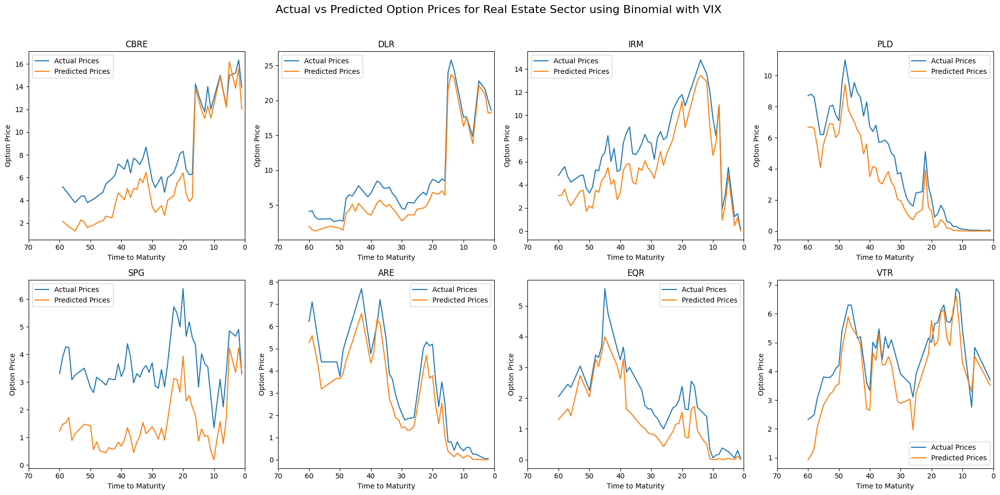

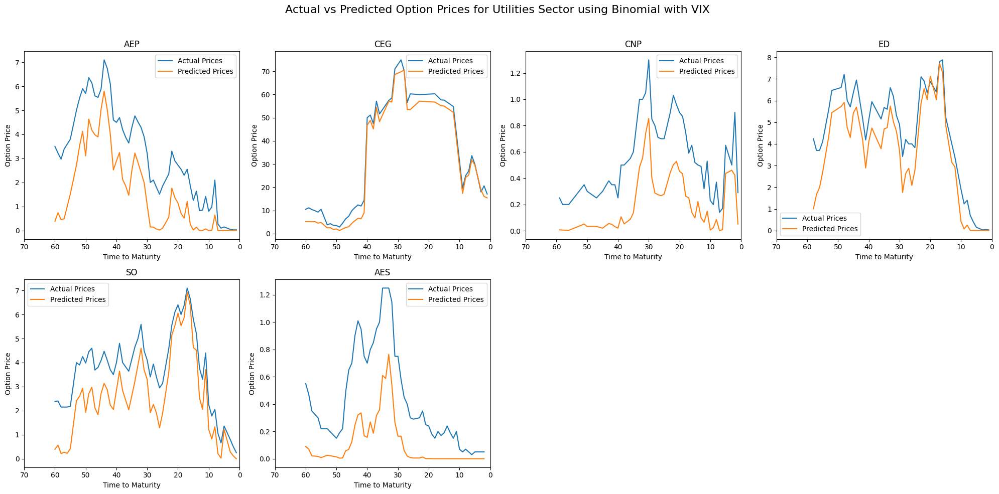

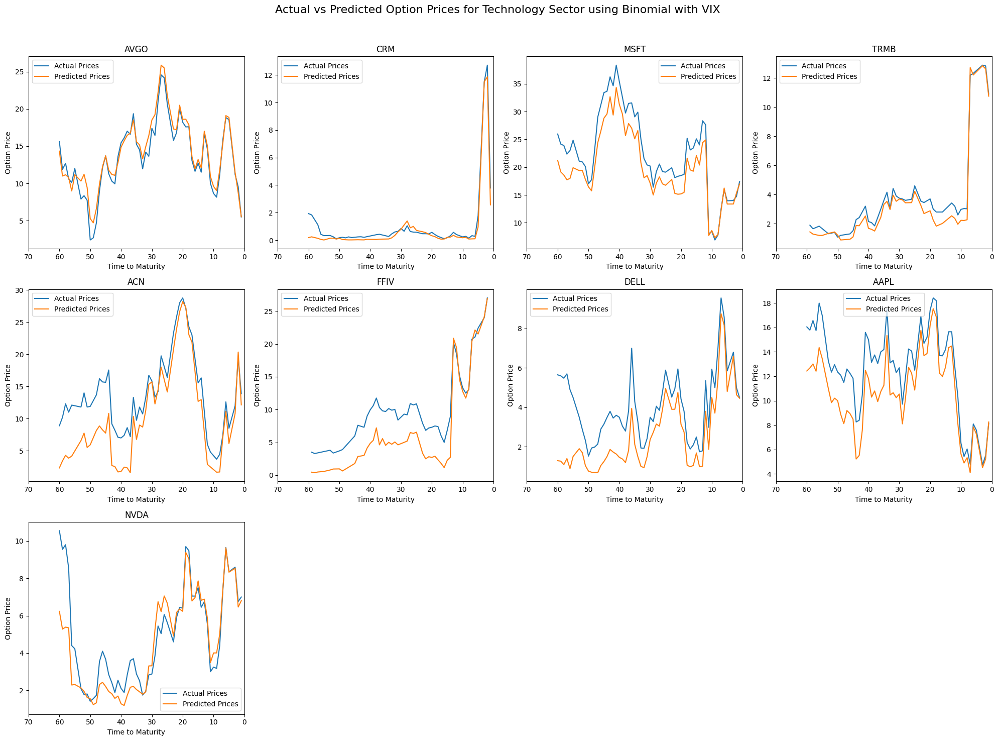

In [ ]:
# Define the Binomial models and generate plots for all sectors
n=20

Binomial_VIX_CommunicationServices = Binomial('Communication Services', df_main_CommunicationServices, df_other_CommunicationServices, BS_VIX_CommunicationServices, 'VIX', n)
plot_actual_vs_predicted('Communication Services', df_main_CommunicationServices, df_other_CommunicationServices, Binomial_VIX_CommunicationServices, 'Binomial_VIX')

Binomial_VIX_ConsumerDiscretionary = Binomial('Consumer Discretionary', df_main_ConsumerDiscretionary, df_other_ConsumerDiscretionary, BS_VIX_ConsumerDiscretionary, 'VIX', n)
plot_actual_vs_predicted('Consumer Discretionary', df_main_ConsumerDiscretionary, df_other_ConsumerDiscretionary, Binomial_VIX_ConsumerDiscretionary, 'Binomial_VIX')

Binomial_VIX_ConsumerStaples = Binomial('Consumer Staples', df_main_ConsumerStaples, df_other_ConsumerStaples, BS_VIX_ConsumerStaples, 'VIX', n)
plot_actual_vs_predicted('Consumer Staples', df_main_ConsumerStaples, df_other_ConsumerStaples, Binomial_VIX_ConsumerStaples, 'Binomial_VIX')

Binomial_VIX_Energy = Binomial('Energy', df_main_Energy, df_other_Energy, BS_VIX_Energy, 'VIX', n)
plot_actual_vs_predicted('Energy', df_main_Energy, df_other_Energy, Binomial_VIX_Energy, 'Binomial_VIX')

Binomial_VIX_Financial = Binomial('Financial', df_main_Financial, df_other_Financial, BS_VIX_Financial, 'VIX', n)
plot_actual_vs_predicted('Financial', df_main_Financial, df_other_Financial, Binomial_VIX_Financial, 'Binomial_VIX')

Binomial_VIX_Healthcare = Binomial('Healthcare', df_main_Healthcare, df_other_Healthcare, BS_VIX_Healthcare, 'VIX', n)
plot_actual_vs_predicted('Healthcare', df_main_Healthcare, df_other_Healthcare, Binomial_VIX_Healthcare, 'Binomial_VIX')

Binomial_VIX_Industrials = Binomial('Industrials', df_main_Industrials, df_other_Industrials, BS_VIX_Industrials, 'VIX', n)
plot_actual_vs_predicted('Industrials', df_main_Industrials, df_other_Industrials, Binomial_VIX_Industrials, 'Binomial_VIX')

Binomial_VIX_Materials = Binomial('Materials', df_main_Materials, df_other_Materials, BS_VIX_Materials, 'VIX', n)
plot_actual_vs_predicted('Materials', df_main_Materials, df_other_Materials, Binomial_VIX_Materials, 'Binomial_VIX')

Binomial_VIX_RealEstate = Binomial('Real Estate', df_main_RealEstate, df_other_RealEstate, BS_VIX_RealEstate, 'VIX', n)
plot_actual_vs_predicted('Real Estate', df_main_RealEstate, df_other_RealEstate, Binomial_VIX_RealEstate, 'Binomial_VIX')

Binomial_VIX_Utilities = Binomial('Utilities', df_main_Utilities, df_other_Utilities, BS_VIX_Utilities, 'VIX', n)
plot_actual_vs_predicted('Utilities', df_main_Utilities, df_other_Utilities, Binomial_VIX_Utilities, 'Binomial_VIX')

Binomial_VIX_Technology = Binomial('Technology', df_main_Technology, df_other_Technology, BS_VIX_Technology, 'VIX', n)
plot_actual_vs_predicted('Technology', df_main_Technology, df_other_Technology, Binomial_VIX_Technology, 'Binomial_VIX')


Saved dataframes to prevent needing to rerun

In [ ]:
Binomial_VIX_CommunicationServices.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_VIX_CommunicationServices.xlsx", index=False)
Binomial_VIX_ConsumerDiscretionary.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_VIX_ConsumerDiscretionary.xlsx", index=False)
Binomial_VIX_ConsumerStaples.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_VIX_ConsumerStaples.xlsx", index=False)
Binomial_VIX_Energy.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_VIX_Energy.xlsx", index=False)
Binomial_VIX_Financial.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_VIX_Financial.xlsx", index=False)
Binomial_VIX_Healthcare.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_VIX_Healthcare.xlsx", index=False)
Binomial_VIX_Industrials.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_VIX_Industrials.xlsx", index=False)
Binomial_VIX_Materials.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_VIX_Materials.xlsx", index=False)
Binomial_VIX_RealEstate.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_VIX_RealEstate.xlsx", index=False)
Binomial_VIX_Technology.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_VIX_Technology.xlsx", index=False)
Binomial_VIX_Utilities.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_VIX_Utilities.xlsx", index=False)

In [ ]:
Binomial_VIX_CommunicationServices=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_VIX_CommunicationServices.xlsx")
Binomial_VIX_ConsumerDiscretionary=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_VIX_ConsumerDiscretionary.xlsx")
Binomial_VIX_ConsumerStaples=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_VIX_ConsumerStaples.xlsx")
Binomial_VIX_Energy=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_VIX_Energy.xlsx")
Binomial_VIX_Financial=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_VIX_Financial.xlsx")
Binomial_VIX_Healthcare=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_VIX_Healthcare.xlsx")
Binomial_VIX_Industrials=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_VIX_Industrials.xlsx")
Binomial_VIX_Materials=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_VIX_Materials.xlsx")
Binomial_VIX_RealEstate=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_VIX_RealEstate.xlsx")
Binomial_VIX_Technology=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_VIX_Technology.xlsx")
Binomial_VIX_Utilities=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_VIX_Utilities.xlsx")


Communication Services
GOOG 0.31171505013477824
GOOGL 0.3396129196776217
META 0.31667325927707174
NFLX 0.47349194397834876
FOX 0.25549157701418834
TTWO 0.2150248644480771
TMUS 0.12260174923578672
NewDIS 0.22952117559607552
Consumer Discretionary
ABNB 0.22308465809969755
AMZN 0.1727930155517005
HD 0.1634420760709504
NKE 0.08985576300474539
TSLA 0.20391841480654166
BWA 0.3241910313486497
WYNN 0.0810694504705671
MGM 0.14256667814813476
Consumer Staples
CL 0.10341690148544094
KO 0.02941356740941592
PG 0.15480078784414042
TGT 0.17777192601734151
SYY 0.23689774864133156
DG 0.02110011981923275
HSY 0.35772616079054775
NewWMT 0.08120844545454409
Energy
SLB 0.28895604725394514
PSX 0.245927775108109
WMB 0.04058356793654647
MPC 0.21957234944659998
OXY 0.1436202733000215
NewAPA 0.2001747843536063
NewEOG 0.2649129221900143
Financial
GS 0.0678052674921721
JPM 0.10646548742088464
BEN 0.41483734043716497
CFG 0.20586680875616473
NewV 0.16103948253479075
NewIVZ 0.23702509779831837
NewBAC 0.14564000897276

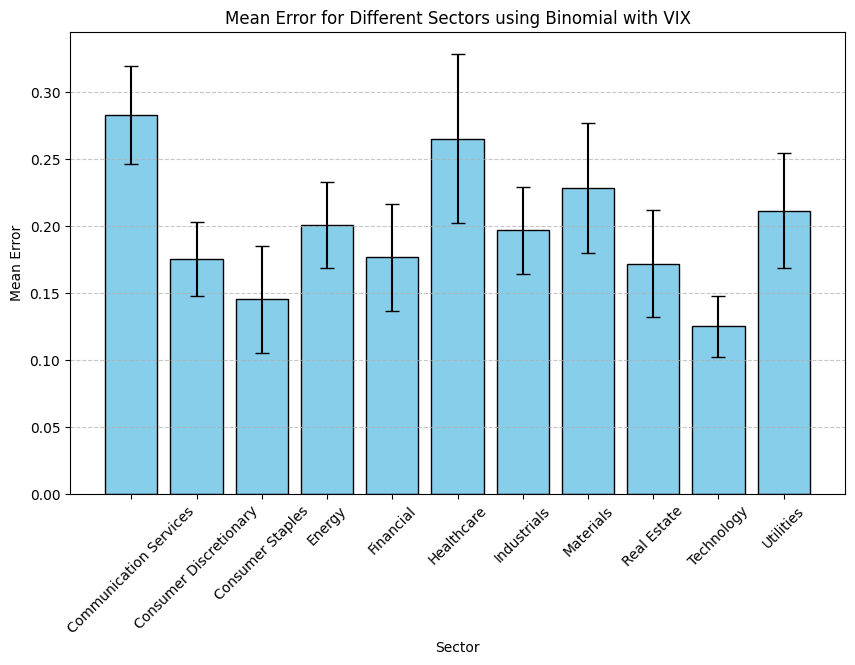

Mean error using Binomial with VIX for sector Communication Services is: 0.283017 ± 0.036697
Mean error using Binomial with VIX for sector Consumer Discretionary is: 0.175115 ± 0.027603
Mean error using Binomial with VIX for sector Consumer Staples is: 0.145292 ± 0.039950
Mean error using Binomial with VIX for sector Energy is: 0.200535 ± 0.032075
Mean error using Binomial with VIX for sector Financial is: 0.176792 ± 0.039958
Mean error using Binomial with VIX for sector Healthcare is: 0.265274 ± 0.063173
Mean error using Binomial with VIX for sector Industrials is: 0.196763 ± 0.032165
Mean error using Binomial with VIX for sector Materials is: 0.228566 ± 0.048413
Mean error using Binomial with VIX for sector Real Estate is: 0.171944 ± 0.039724
Mean error using Binomial with VIX for sector Technology is: 0.125073 ± 0.022790
Mean error using Binomial with VIX for sector Utilities is: 0.211565 ± 0.043037


In [ ]:
Binomial_VIX_rmses_CommunicationServices = RMSE("Communication Services", df_main_CommunicationServices, df_other_CommunicationServices, Binomial_VIX_CommunicationServices, 'Binomial_VIX')
Binomial_VIX_rmses_ConsumerDiscretionary = RMSE("Consumer Discretionary", df_main_ConsumerDiscretionary, df_other_ConsumerDiscretionary, Binomial_VIX_ConsumerDiscretionary, 'Binomial_VIX')
Binomial_VIX_rmses_ConsumerStaples = RMSE("Consumer Staples", df_main_ConsumerStaples, df_other_ConsumerStaples, Binomial_VIX_ConsumerStaples, 'Binomial_VIX')
Binomial_VIX_rmses_Energy = RMSE("Energy", df_main_Energy, df_other_Energy, Binomial_VIX_Energy, 'Binomial_VIX')
Binomial_VIX_rmses_Financial = RMSE("Financial", df_main_Financial, df_other_Financial, Binomial_VIX_Financial, 'Binomial_VIX')
Binomial_VIX_rmses_Healthcare = RMSE("Healthcare", df_main_Healthcare, df_other_Healthcare, Binomial_VIX_Healthcare, 'Binomial_VIX')
Binomial_VIX_rmses_Industrials = RMSE("Industrials", df_main_Industrials, df_other_Industrials, Binomial_VIX_Industrials, 'Binomial_VIX')
Binomial_VIX_rmses_Materials = RMSE("Materials", df_main_Materials, df_other_Materials, Binomial_VIX_Materials, 'Binomial_VIX')
Binomial_VIX_rmses_RealEstate = RMSE("Real Estate", df_main_RealEstate, df_other_RealEstate, Binomial_VIX_RealEstate, 'Binomial_VIX')
Binomial_VIX_rmses_Technology = RMSE("Technology", df_main_Technology, df_other_Technology, Binomial_VIX_Technology, 'Binomial_VIX')
Binomial_VIX_rmses_Utilities = RMSE("Utilities", df_main_Utilities, df_other_Utilities, Binomial_VIX_Utilities, 'Binomial_VIX')

# Organize the RMSE results into a list
Binomial_VIX_rmses_array = [
    Binomial_VIX_rmses_CommunicationServices,
    Binomial_VIX_rmses_ConsumerDiscretionary,
    Binomial_VIX_rmses_ConsumerStaples,
    Binomial_VIX_rmses_Energy,
    Binomial_VIX_rmses_Financial,
    Binomial_VIX_rmses_Healthcare,
    Binomial_VIX_rmses_Industrials,
    Binomial_VIX_rmses_Materials,
    Binomial_VIX_rmses_RealEstate,
    Binomial_VIX_rmses_Technology,
    Binomial_VIX_rmses_Utilities
]

plot_rmses_for_method(Binomial_VIX_rmses_array,sector_list,"Binomial with VIX")

# **Investigating ARCH/GARCH with Binomial Model**

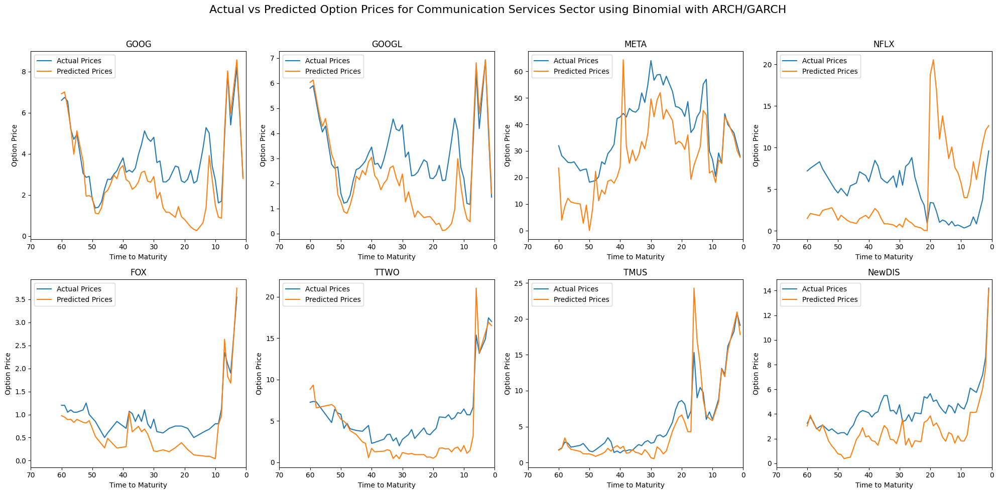

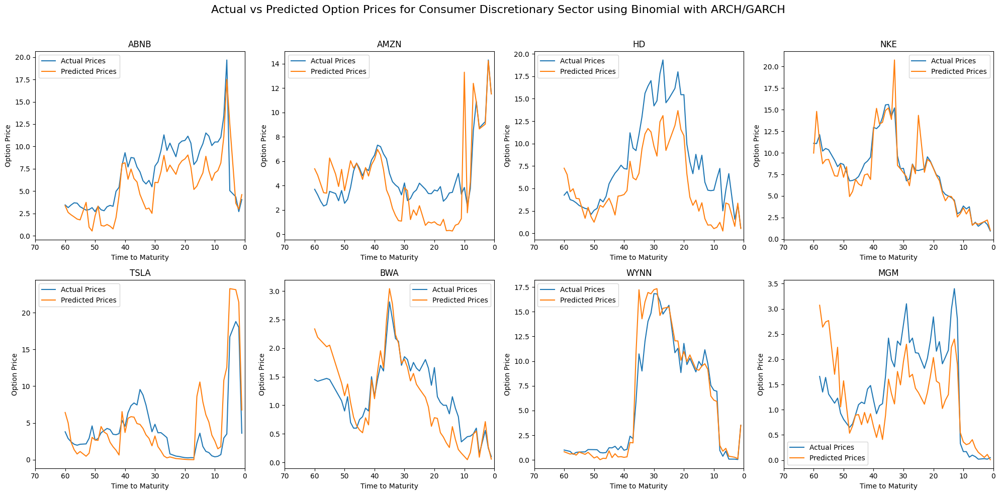

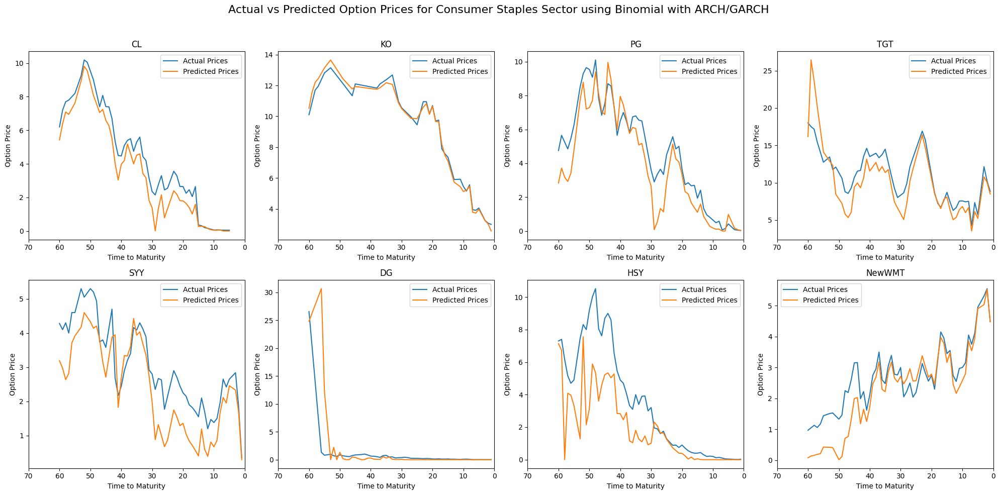

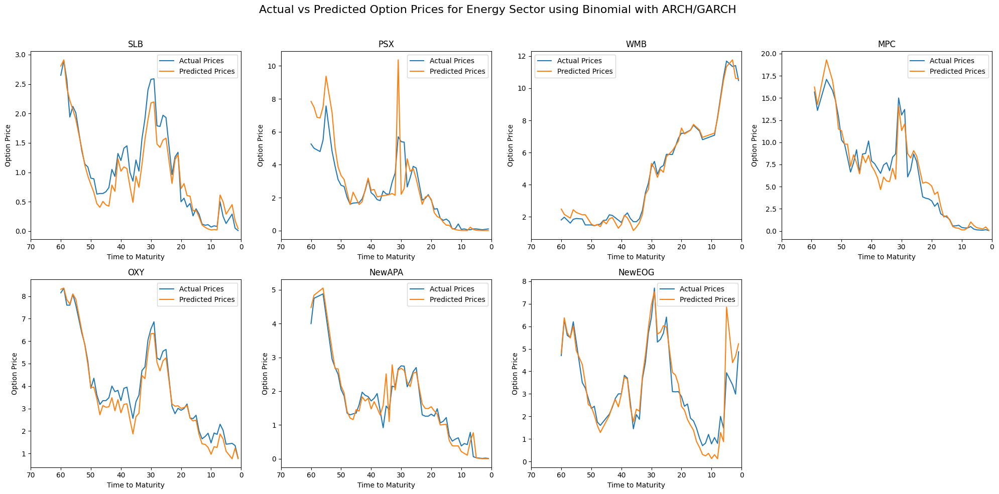

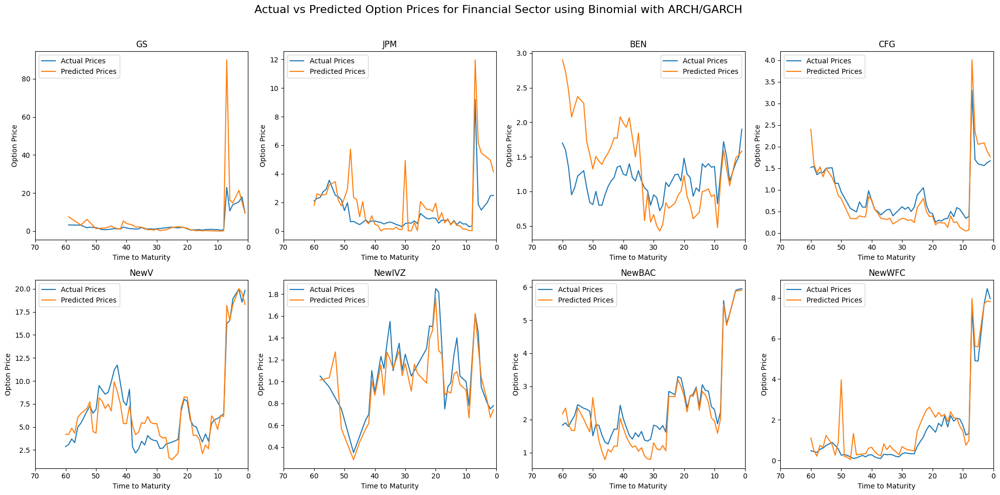

...

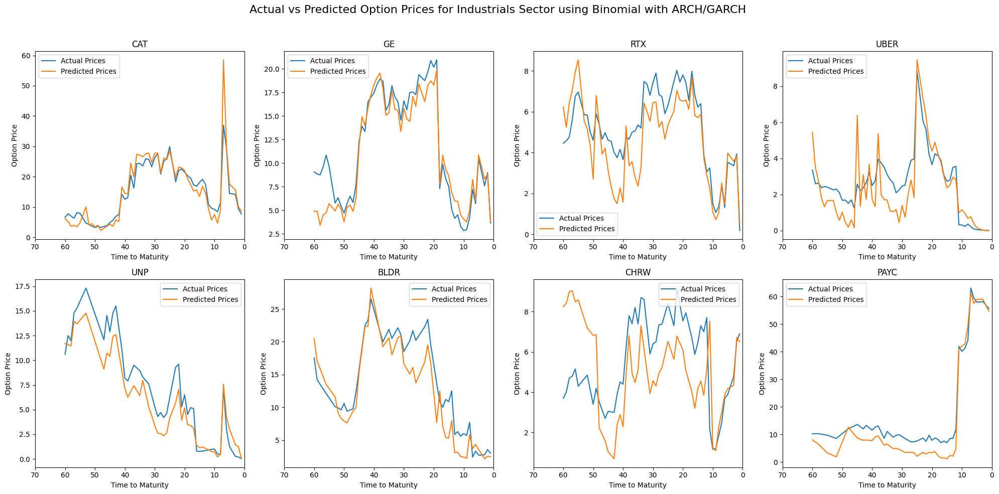

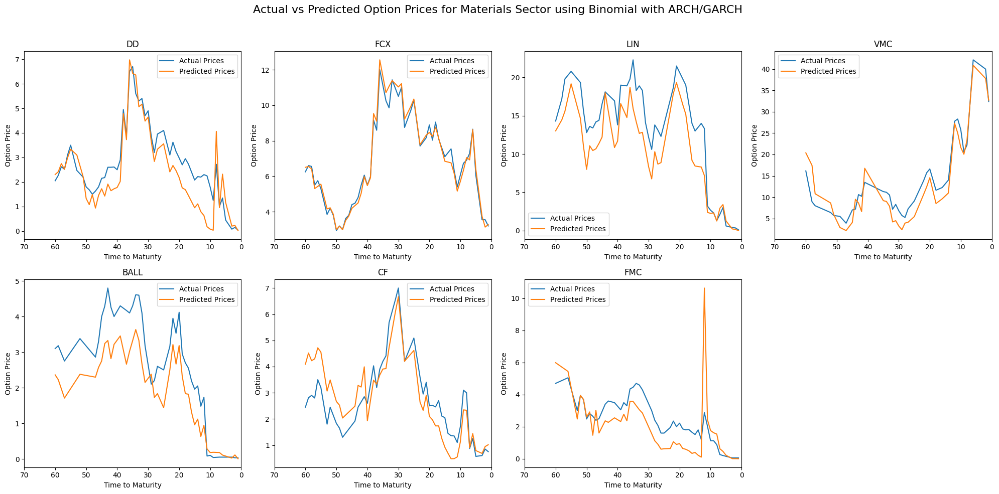

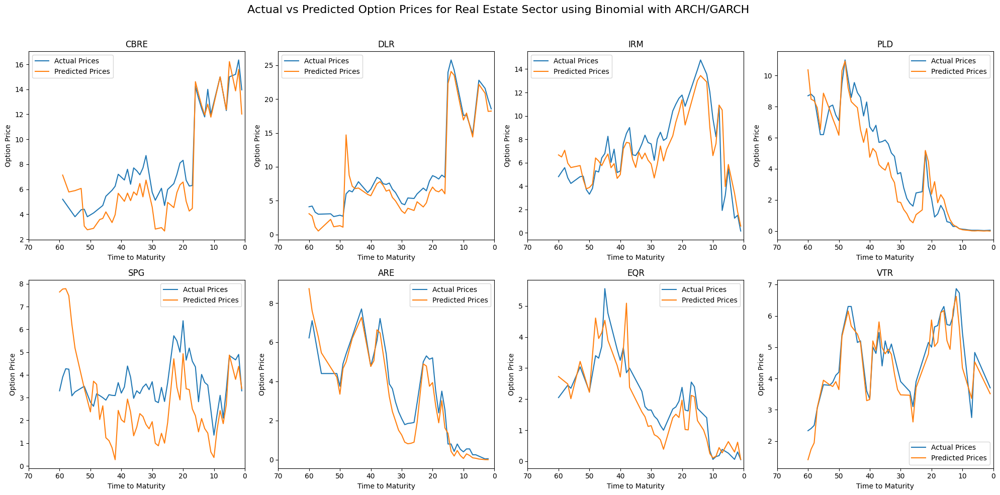

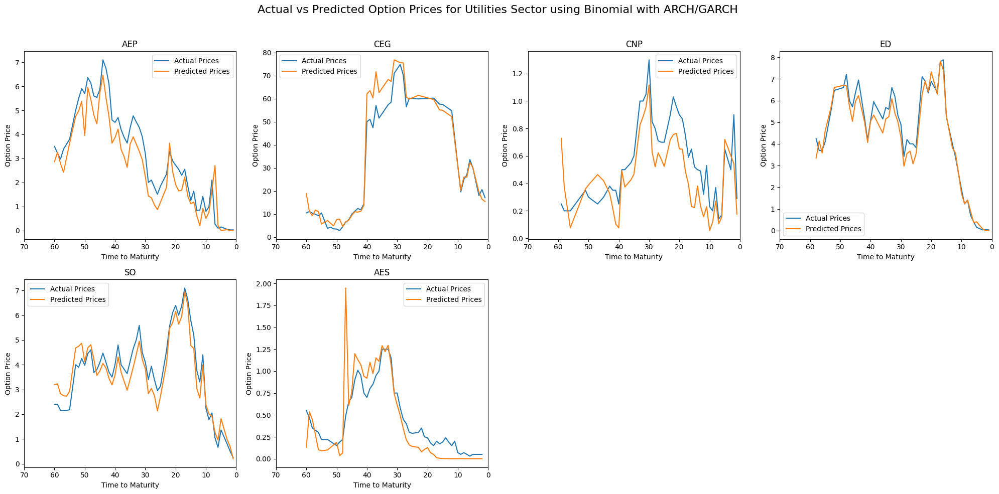

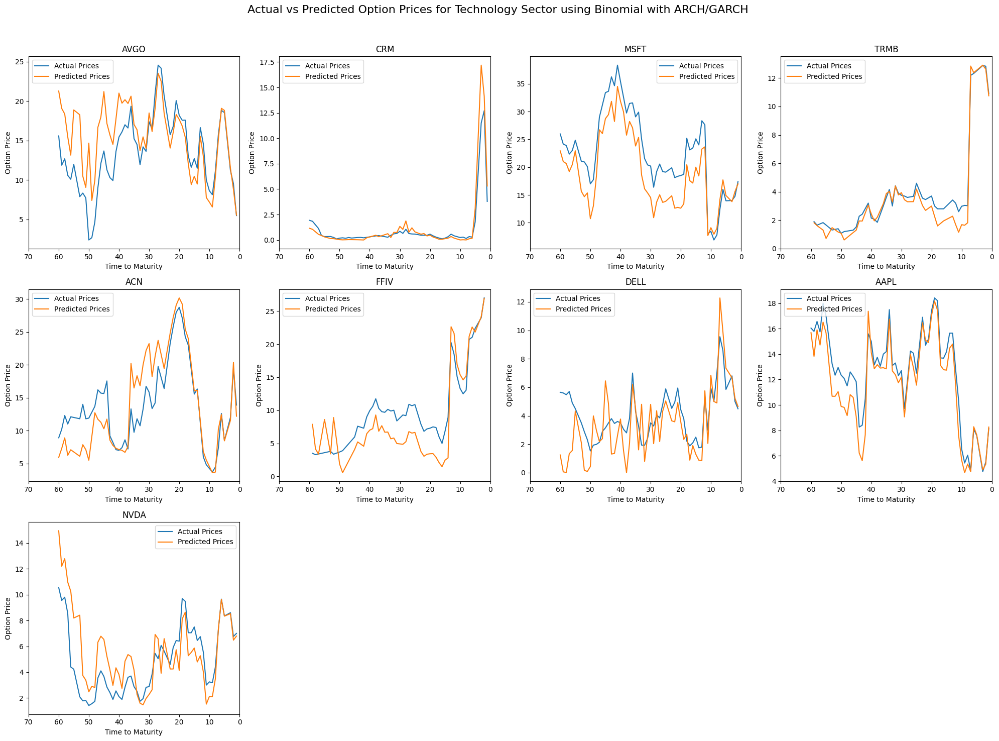

In [ ]:
n = 20

Binomial_ARCH_GARCH_CommunicationServices = Binomial('Communication Services', df_main_CommunicationServices, df_other_CommunicationServices, BS_ARCH_GARCH_CommunicationServices, 'ARCH/GARCH', n)
plot_actual_vs_predicted('Communication Services', df_main_CommunicationServices, df_other_CommunicationServices, Binomial_ARCH_GARCH_CommunicationServices, 'Binomial_ARCH/GARCH')

Binomial_ARCH_GARCH_ConsumerDiscretionary = Binomial('Consumer Discretionary', df_main_ConsumerDiscretionary, df_other_ConsumerDiscretionary, BS_ARCH_GARCH_ConsumerDiscretionary, 'ARCH/GARCH', n)
plot_actual_vs_predicted('Consumer Discretionary', df_main_ConsumerDiscretionary, df_other_ConsumerDiscretionary, Binomial_ARCH_GARCH_ConsumerDiscretionary, 'Binomial_ARCH/GARCH')

Binomial_ARCH_GARCH_ConsumerStaples = Binomial('Consumer Staples', df_main_ConsumerStaples, df_other_ConsumerStaples, BS_ARCH_GARCH_ConsumerStaples, 'ARCH/GARCH', n)
plot_actual_vs_predicted('Consumer Staples', df_main_ConsumerStaples, df_other_ConsumerStaples, Binomial_ARCH_GARCH_ConsumerStaples, 'Binomial_ARCH/GARCH')

Binomial_ARCH_GARCH_Energy = Binomial('Energy', df_main_Energy, df_other_Energy, BS_ARCH_GARCH_Energy, 'ARCH/GARCH', n)
plot_actual_vs_predicted('Energy', df_main_Energy, df_other_Energy, Binomial_ARCH_GARCH_Energy, 'Binomial_ARCH/GARCH')

Binomial_ARCH_GARCH_Financial = Binomial('Financial', df_main_Financial, df_other_Financial, BS_ARCH_GARCH_Financial, 'ARCH/GARCH', n)
plot_actual_vs_predicted('Financial', df_main_Financial, df_other_Financial, Binomial_ARCH_GARCH_Financial, 'Binomial_ARCH/GARCH')

Binomial_ARCH_GARCH_Healthcare = Binomial('Healthcare', df_main_Healthcare, df_other_Healthcare, BS_ARCH_GARCH_Healthcare, 'ARCH/GARCH', n)
plot_actual_vs_predicted('Healthcare', df_main_Healthcare, df_other_Healthcare, Binomial_ARCH_GARCH_Healthcare, 'Binomial_ARCH/GARCH')

Binomial_ARCH_GARCH_Industrials = Binomial('Industrials', df_main_Industrials, df_other_Industrials, BS_ARCH_GARCH_Industrials, 'ARCH/GARCH', n)
plot_actual_vs_predicted('Industrials', df_main_Industrials, df_other_Industrials, Binomial_ARCH_GARCH_Industrials, 'Binomial_ARCH/GARCH')

Binomial_ARCH_GARCH_Materials = Binomial('Materials', df_main_Materials, df_other_Materials, BS_ARCH_GARCH_Materials, 'ARCH/GARCH', n)
plot_actual_vs_predicted('Materials', df_main_Materials, df_other_Materials, Binomial_ARCH_GARCH_Materials, 'Binomial_ARCH/GARCH')

Binomial_ARCH_GARCH_RealEstate = Binomial('Real Estate', df_main_RealEstate, df_other_RealEstate, BS_ARCH_GARCH_RealEstate, 'ARCH/GARCH', n)
plot_actual_vs_predicted('Real Estate', df_main_RealEstate, df_other_RealEstate, Binomial_ARCH_GARCH_RealEstate, 'Binomial_ARCH/GARCH')

Binomial_ARCH_GARCH_Utilities = Binomial('Utilities', df_main_Utilities, df_other_Utilities, BS_ARCH_GARCH_Utilities, 'ARCH/GARCH', n)
plot_actual_vs_predicted('Utilities', df_main_Utilities, df_other_Utilities, Binomial_ARCH_GARCH_Utilities, 'Binomial_ARCH/GARCH')

Binomial_ARCH_GARCH_Technology = Binomial('Technology', df_main_Technology, df_other_Technology, BS_ARCH_GARCH_Technology, 'ARCH/GARCH', n)
plot_actual_vs_predicted('Technology', df_main_Technology, df_other_Technology, Binomial_ARCH_GARCH_Technology, 'Binomial_ARCH/GARCH')


Saved dataframes to prevent needing to rerun

In [ ]:
Binomial_ARCH_GARCH_CommunicationServices.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_ARCH_GARCH_CommunicationServices.xlsx", index=False)
Binomial_ARCH_GARCH_ConsumerDiscretionary.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_ARCH_GARCH_ConsumerDiscretionary.xlsx", index=False)
Binomial_ARCH_GARCH_ConsumerStaples.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_ARCH_GARCH_ConsumerStaples.xlsx", index=False)
Binomial_ARCH_GARCH_Energy.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_ARCH_GARCH_Energy.xlsx", index=False)
Binomial_ARCH_GARCH_Financial.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_ARCH_GARCH_Financial.xlsx", index=False)
Binomial_ARCH_GARCH_Healthcare.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_ARCH_GARCH_Healthcare.xlsx", index=False)
Binomial_ARCH_GARCH_Industrials.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_ARCH_GARCH_Industrials.xlsx", index=False)
Binomial_ARCH_GARCH_Materials.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_ARCH_GARCH_Materials.xlsx", index=False)
Binomial_ARCH_GARCH_RealEstate.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_ARCH_GARCH_RealEstate.xlsx", index=False)
Binomial_ARCH_GARCH_Technology.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_ARCH_GARCH_Technology.xlsx", index=False)
Binomial_ARCH_GARCH_Utilities.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_ARCH_GARCH_Utilities.xlsx", index=False)


In [ ]:
Binomial_ARCH_GARCH_CommunicationServices=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_ARCH_GARCH_CommunicationServices.xlsx")
Binomial_ARCH_GARCH_ConsumerDiscretionary=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_ARCH_GARCH_ConsumerDiscretionary.xlsx")
Binomial_ARCH_GARCH_ConsumerStaples=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_ARCH_GARCH_ConsumerStaples.xlsx")
Binomial_ARCH_GARCH_Energy=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_ARCH_GARCH_Energy.xlsx")
Binomial_ARCH_GARCH_Financial=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_ARCH_GARCH_Financial.xlsx")
Binomial_ARCH_GARCH_Healthcare=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_ARCH_GARCH_Healthcare.xlsx")
Binomial_ARCH_GARCH_Industrials=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_ARCH_GARCH_Industrials.xlsx")
Binomial_ARCH_GARCH_Materials=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_ARCH_GARCH_Materials.xlsx")
Binomial_ARCH_GARCH_RealEstate=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_ARCH_GARCH_RealEstate.xlsx")
Binomial_ARCH_GARCH_Technology=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_ARCH_GARCH_Technology.xlsx")
Binomial_ARCH_GARCH_Utilities=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Binomial_ARCH_GARCH_Utilities.xlsx")


Communication Services
GOOG 0.21048624059647644
GOOGL 0.23644246688604711
META 0.2938687202360584
NFLX 0.7440227964392723
FOX 0.11811886640940628
TTWO 0.1758583833689055
TMUS 0.10909181668902074
NewDIS 0.16201314445583193
Consumer Discretionary
ABNB 0.14310319703423294
AMZN 0.1898199865239624
HD 0.1925310536980903
NKE 0.10328229309442452
TSLA 0.17021062574160162
BWA 0.14576650062110924
WYNN 0.09822444705538484
MGM 0.20419449758952615
Consumer Staples
CL 0.09150624653406214
KO 0.029313696165573885
PG 0.12729276173645468
TGT 0.1776486168988912
SYY 0.17851075150285117
DG 0.1568837302554028
HSY 0.23118454059030902
NewWMT 0.14052779105997118
Energy
SLB 0.07950750663376704
PSX 0.1640880496830873
WMB 0.03048572407288307
MPC 0.06879264308781095
OXY 0.05441541170641113
NewAPA 0.056069568147620236
NewEOG 0.08996189411511445
Financial
GS 0.4447763239565058
JPM 0.1654796443935734
BEN 0.47645482665574196
CFG 0.09296071313553779
NewV 0.08440450837817133
NewIVZ 0.10956098146793873
NewBAC 0.0829053567

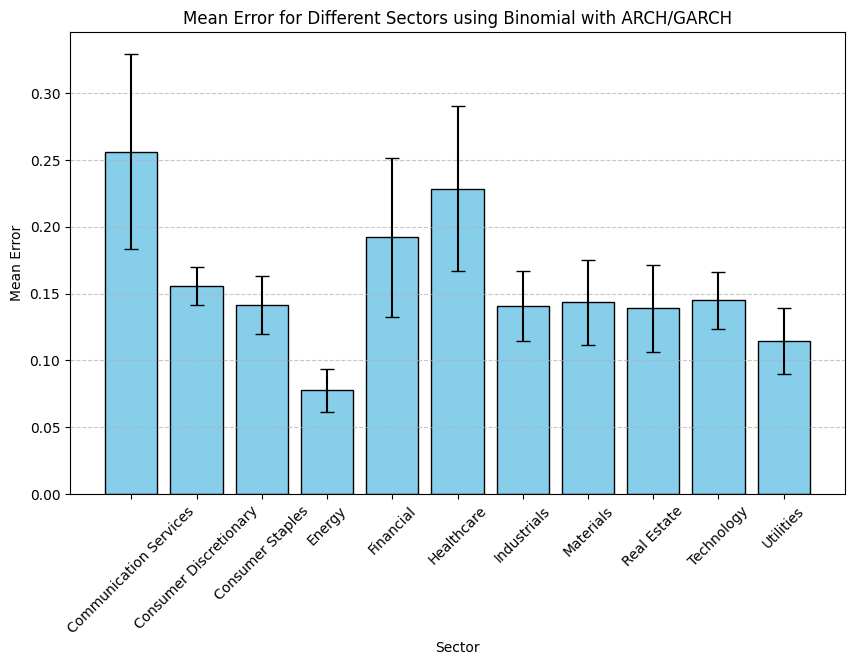

Mean error using Binomial with ARCH/GARCH for sector Communication Services is: 0.256238 ± 0.072936
Mean error using Binomial with ARCH/GARCH for sector Consumer Discretionary is: 0.155892 ± 0.014262
Mean error using Binomial with ARCH/GARCH for sector Consumer Staples is: 0.141609 ± 0.021648
Mean error using Binomial with ARCH/GARCH for sector Energy is: 0.077617 ± 0.016136
Mean error using Binomial with ARCH/GARCH for sector Financial is: 0.192066 ± 0.059484
Mean error using Binomial with ARCH/GARCH for sector Healthcare is: 0.228467 ± 0.061556
Mean error using Binomial with ARCH/GARCH for sector Industrials is: 0.140683 ± 0.025892
Mean error using Binomial with ARCH/GARCH for sector Materials is: 0.143430 ± 0.031709
Mean error using Binomial with ARCH/GARCH for sector Real Estate is: 0.138993 ± 0.032381
Mean error using Binomial with ARCH/GARCH for sector Technology is: 0.145063 ± 0.021313
Mean error using Binomial with ARCH/GARCH for sector Utilities is: 0.114513 ± 0.024824


In [ ]:
Binomial_ARCH_GARCH_rmses_CommunicationServices = RMSE("Communication Services", df_main_CommunicationServices, df_other_CommunicationServices, Binomial_ARCH_GARCH_CommunicationServices, 'Binomial_ARCH/GARCH')
Binomial_ARCH_GARCH_rmses_ConsumerDiscretionary = RMSE("Consumer Discretionary", df_main_ConsumerDiscretionary, df_other_ConsumerDiscretionary, Binomial_ARCH_GARCH_ConsumerDiscretionary, 'Binomial_ARCH/GARCH')
Binomial_ARCH_GARCH_rmses_ConsumerStaples = RMSE("Consumer Staples", df_main_ConsumerStaples, df_other_ConsumerStaples, Binomial_ARCH_GARCH_ConsumerStaples, 'Binomial_ARCH/GARCH')
Binomial_ARCH_GARCH_rmses_Energy = RMSE("Energy", df_main_Energy, df_other_Energy, Binomial_ARCH_GARCH_Energy, 'Binomial_ARCH/GARCH')
Binomial_ARCH_GARCH_rmses_Financial = RMSE("Financial", df_main_Financial, df_other_Financial, Binomial_ARCH_GARCH_Financial, 'Binomial_ARCH/GARCH')
Binomial_ARCH_GARCH_rmses_Healthcare = RMSE("Healthcare", df_main_Healthcare, df_other_Healthcare, Binomial_ARCH_GARCH_Healthcare, 'Binomial_ARCH/GARCH')
Binomial_ARCH_GARCH_rmses_Industrials = RMSE("Industrials", df_main_Industrials, df_other_Industrials, Binomial_ARCH_GARCH_Industrials, 'Binomial_ARCH/GARCH')
Binomial_ARCH_GARCH_rmses_Materials = RMSE("Materials", df_main_Materials, df_other_Materials, Binomial_ARCH_GARCH_Materials, 'Binomial_ARCH/GARCH')
Binomial_ARCH_GARCH_rmses_RealEstate = RMSE("Real Estate", df_main_RealEstate, df_other_RealEstate, Binomial_ARCH_GARCH_RealEstate, 'Binomial_ARCH/GARCH')
Binomial_ARCH_GARCH_rmses_Technology = RMSE("Technology", df_main_Technology, df_other_Technology, Binomial_ARCH_GARCH_Technology, 'Binomial_ARCH/GARCH')
Binomial_ARCH_GARCH_rmses_Utilities = RMSE("Utilities", df_main_Utilities, df_other_Utilities, Binomial_ARCH_GARCH_Utilities, 'Binomial_ARCH/GARCH')

Binomial_ARCH_GARCH_rmses_array = [
    Binomial_ARCH_GARCH_rmses_CommunicationServices,
    Binomial_ARCH_GARCH_rmses_ConsumerDiscretionary,
    Binomial_ARCH_GARCH_rmses_ConsumerStaples,
    Binomial_ARCH_GARCH_rmses_Energy,
    Binomial_ARCH_GARCH_rmses_Financial,
    Binomial_ARCH_GARCH_rmses_Healthcare,
    Binomial_ARCH_GARCH_rmses_Industrials,
    Binomial_ARCH_GARCH_rmses_Materials,
    Binomial_ARCH_GARCH_rmses_RealEstate,
    Binomial_ARCH_GARCH_rmses_Technology,
    Binomial_ARCH_GARCH_rmses_Utilities
]

plot_rmses_for_method(Binomial_ARCH_GARCH_rmses_array, sector_list, "Binomial with ARCH/GARCH")


1
5
20


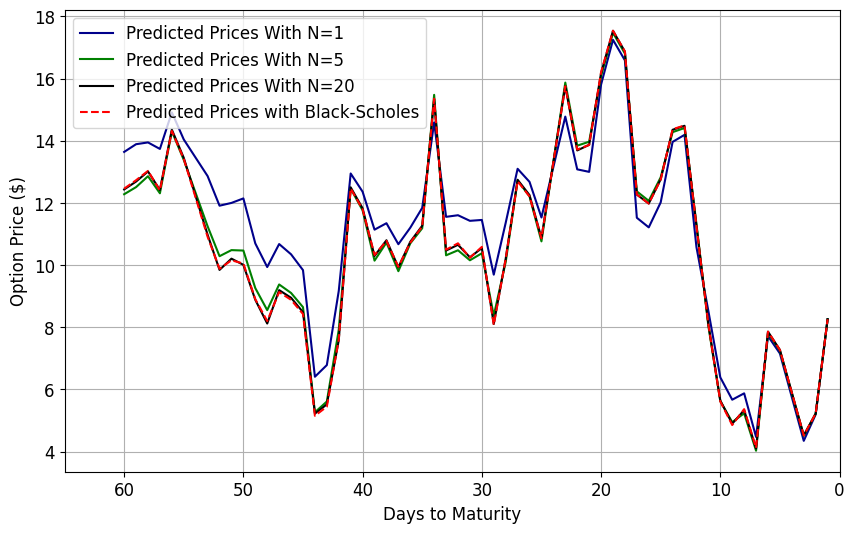

In [ ]:
def Binomial_against_BlackScholes(Sector,main_data,other_data,BS_option_data,method="VIX",number=3):
  #ticker_list=return_tickers(Sector)
  x1=12
  ticker_list=['AAPL']
  filtered_dates = main_data[(main_data['Date'] >= start_date) & (main_data['Date'] <= end_date)]['Date'].tolist()
  #Ns=np.linspace(1, 20, num=number, dtype=int)
  Ns=[1,5,20]
  for ticker in ticker_list:
    days_to_maturity=[]
    BS_prices=[]
    predicted_prices = [[] for _ in range(len(Ns))]
    expiry=other_data.loc[other_data['Ticker'] == ticker, 'Expirations'].values[0]

    for date in filtered_dates:
      tau=np.busday_count(date.date(), pd.Timestamp(expiry).date())
      if pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_stock']).any() or pd.isna(main_data.loc[main_data['Date'] == date, ticker+'_option']).any() or tau<=0:
         continue
      days_to_maturity.append(tau)
      BS_prices.append(BS_option_data.loc[BS_option_data['Date'] == date, ticker+"_"+method+'_option'].values[0])

    for i in range(len(Ns)):
      print(Ns[i])
      BinomialForN=Binomial(Sector,main_data,other_data, BS_option_data,method, Ns[i])
      for date in filtered_dates:
        tau=np.busday_count(date.date(), pd.Timestamp(expiry).date())
        if pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_stock']).any() or pd.isna(main_data.loc[main_data['Date'] == date, ticker+'_option']).any() or tau<=0:
          continue
        predicted_prices[i].append(BinomialForN.loc[BinomialForN['Date'] == date, ticker+'_Binomial_'+method+'_option'].values[0])

    plt.figure(figsize=(10, 6))
    plt.xlabel("Days to Maturity", fontsize=x1)
    plt.ylabel("Option Price ($)", fontsize=x1)
    plt.xticks(fontsize=x1)
    plt.yticks(fontsize=x1)
    # Plot actual prices
    plt.xlim(65,0)

    cs=["darkblue","green","black"]

    for i in range(len(Ns)):
      plt.grid(True)
      plt.plot(days_to_maturity,predicted_prices[i], label='Predicted Prices With N='+str(Ns[i]),color=cs[i])
      #plt.title("Binomial for Different Ns using "+method)
      # Add a legend to differentiate between the two lines

      # Display the plot
    plt.plot(days_to_maturity,BS_prices, label='Predicted Prices with Black-Scholes',linestyle="--",color="red")
    plt.legend(fontsize=x1)
    plt.show()


Binomial_against_BlackScholes('Technology',df_main_Technology,df_other_Technology,BS_VIX_Technology,'VIX',3)

Investigations for when you have time.

In [ ]:
Ns=np.linspace(1, 100, num=99, dtype=int)
errors=[]
for N in Ns:
  Binomial_VIX_Technology=Binomial('Technology',df_main_Technology,df_other_Technology,BS_VIX_Technology,'VIX',N)
  Binomial_VIX_rmses=RMSE("Technology",df_main_Technology,Binomial_VIX_Technology,'Binomial_VIX')
  print(Binomial_VIX_rmses)
  avg_error=0
  for rmse in Binomial_VIX_rmses:
    avg_error+=rmse
  avg_error=avg_error/len(Binomial_VIX_rmses)
  errors.append(avg_error)
print(errors)


Technology
AVGO 0.11791568082927668
CRM 0.04952036288103416
NVDA 0.23336368529644333
MSFT 0.08192519339217967
TRMB 0.02908041141842388
ACN 0.17272083387128226
FFIV 0.14331467921452695
DELL 0.29979512483558163
AAPL 0.12801023747044038
[0.11791568082927668, 0.04952036288103416, 0.23336368529644333, 0.08192519339217967, 0.02908041141842388, 0.17272083387128226, 0.14331467921452695, 0.29979512483558163, 0.12801023747044038]
Technology
AVGO 0.07126429234697951
CRM 0.046957685683845334
NVDA 0.12622295232039624
MSFT 0.10216280975587927
TRMB 0.04210155621890843
ACN 0.17134119626002292
FFIV 0.16681428088894457
DELL 0.22131408551686074
AAPL 0.16707359594569554
[0.07126429234697951, 0.046957685683845334, 0.12622295232039624, 0.10216280975587927, 0.04210155621890843, 0.17134119626002292, 0.16681428088894457, 0.22131408551686074, 0.16707359594569554]
Technology
AVGO 0.05822286010964144
CRM 0.0449934792354374
NVDA 0.15587230038293673
MSFT 0.10048842285840126
TRMB 0.04278897669415359
ACN 0.1762038711

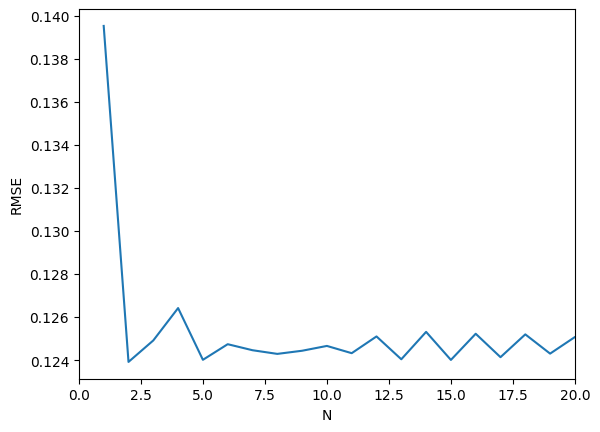

In [ ]:
plt.plot(Ns,errors)
plt.xlabel('N')
plt.ylabel('RMSE')
plt.xlim(0,20)
plt.ylim()
plt.show(0.12,0.13)

# **Monte Carlo Model**

In [ ]:
def MC(Sector,main_data,other_data,sector_volatilities,method,N=10):

  #Initialise data frame
  Sector_option_prices=pd.DataFrame({})
  #Get all tickers for the sector
  ticker_list=return_tickers(Sector)
  #print(ticker_list)
  #Get a list of dates between 2 globally defined dates for which we are looking at
  filtered_dates = main_data[(main_data['Date'] >= start_date) & (main_data['Date'] <= end_date)]['Date'].tolist()
  #Add these dates to our data frame
  Sector_option_prices['Date']=filtered_dates
  #Redefine method
  newmethod='Monte_Carlo'+'_'+method
  #Loop through all the tickers
  for ticker in ticker_list:
    #Initialise some lists where we temporarily store data for a particular company before adding to date frame
    option_prices=[]
    valid_dates=[]
    #volatilities=[]

    #Get strike price of option
    K=other_data.loc[other_data['Ticker'] == ticker, 'Strike'].values[0]
    #Get expiration date of option
    expiry=other_data.loc[other_data['Ticker'] == ticker, 'Expirations'].values[0]
    #Number of days before prediction
    T=1/252

    #Loop through dates from list of dates obtained earlier
    for date in filtered_dates:
      #Get time to expiry and convert to years. Note the use of trading days
      tau= np.busday_count(date.date(), pd.Timestamp(expiry).date())/252

      #Check if either stock or option price is not not available for that day. We will go to next date if this is true.
      if pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_stock']).any() or pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_option']).any() or tau<=0:
        continue


      #Need to look into this more -> Deeping it maybe I don't need an offset because we are using today to evaluate option price today
      valid_dates.append(date+ pd.tseries.offsets.BDay(0))
      dt=T/N
      #Obtain stock price for that day
      S=main_data.loc[main_data['Date'] == date, ticker+'_stock'].values[0]
      #Obtain risk-free rate for that day
      rpercent=main_data.loc[main_data['Date'] == date, 'Rates'].values[0]
      #Change to decimal
      r= rpercent/100
      #Get volatility on date
      sigma=sector_volatilities.loc[sector_volatilities['Date'] == date, ticker+'_'+method].values[0]
      #print("Strike:",K)
      """
      S_old=S

      for i in range(N):
        #print(i)
        Snew=S_old*np.exp((r-(sigma**2)/2)*dt+sigma*np.sqrt(dt)*np.random.normal())
        #Snew=S_old*np.exp((r-(sigma**2)/2)*dt+sigma*np.sqrt(dt)*np.random.lognormal())
        S_old=Snew
      #print(Snew)
      C=np.exp(-r*T)*max(Snew-K,0)
      """
      # Log-normal sampling for N paths
      drift = (r - 0.5 * sigma**2) * tau  # Drift term
      diffusion = sigma * np.sqrt(tau)   # Diffusion term
      Snew_samples = np.random.lognormal(mean=drift, sigma=diffusion, size=N) * S

      # Calculate discounted payoffs and average
      payoffs = np.maximum(Snew_samples - K, 0)  # Option payoff: max(S(T) - K, 0)
      C = np.exp(-r * tau) * np.mean(payoffs)   # Discounted average payoff

      #Add option price to temporary list
      option_prices.append(C)
    #Create temporary data frame with valid dates and evaluated option prices
    df_temp=pd.DataFrame({})
    df_temp['Date']=valid_dates
    df_temp[ticker+'_'+newmethod+'_option']=option_prices
     #Add data to main data frame
    Sector_option_prices=pd.merge(Sector_option_prices,df_temp,on='Date', how='outer')

  return Sector_option_prices









# **Investigating VIX with the Monte Carlo Method**

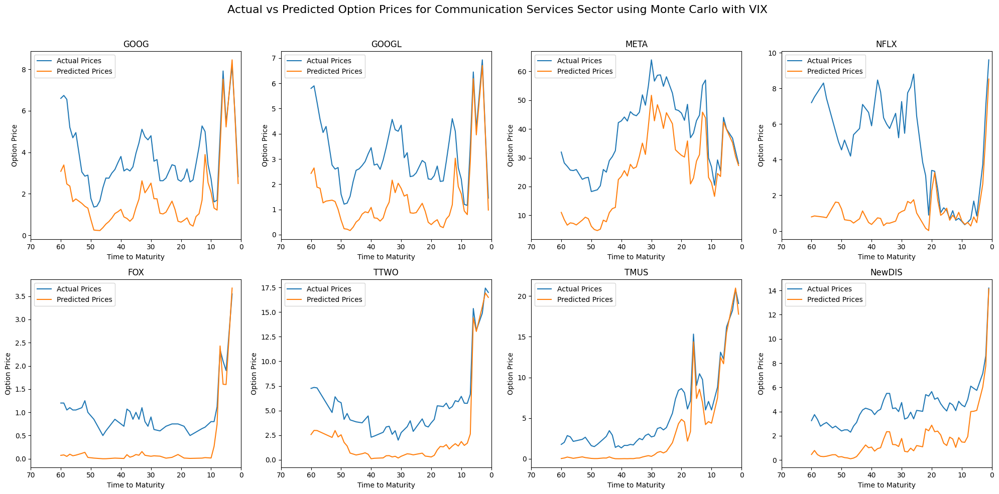

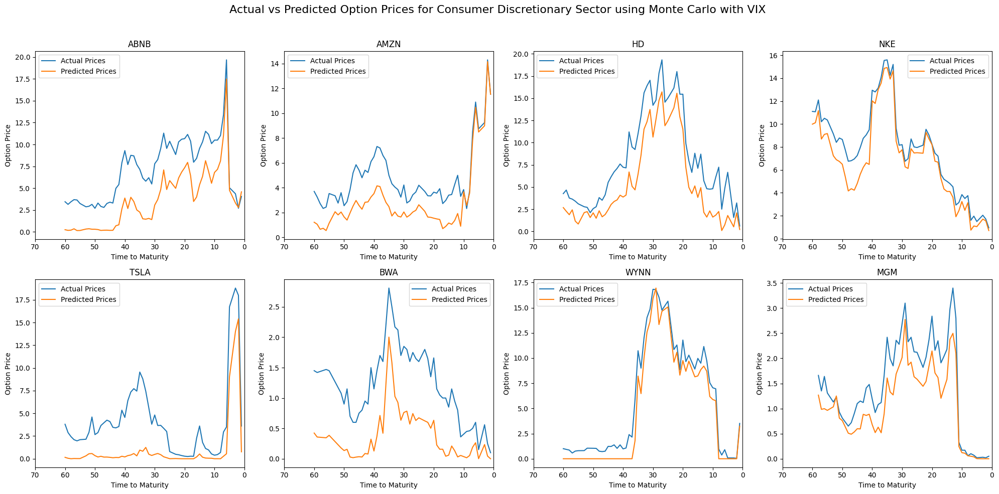

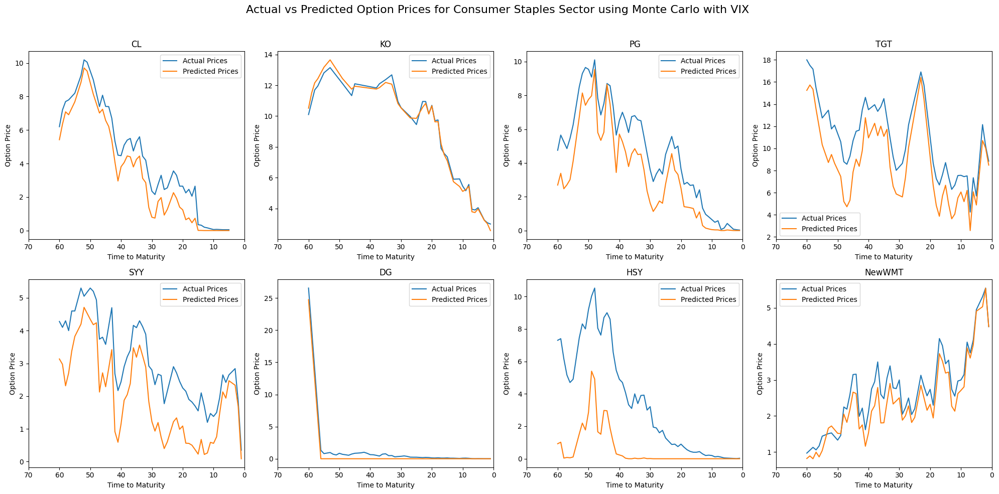

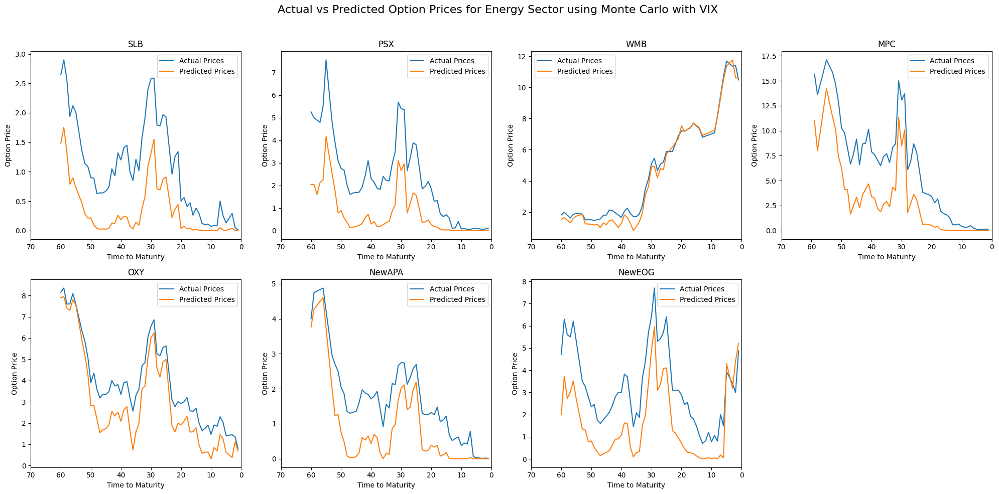

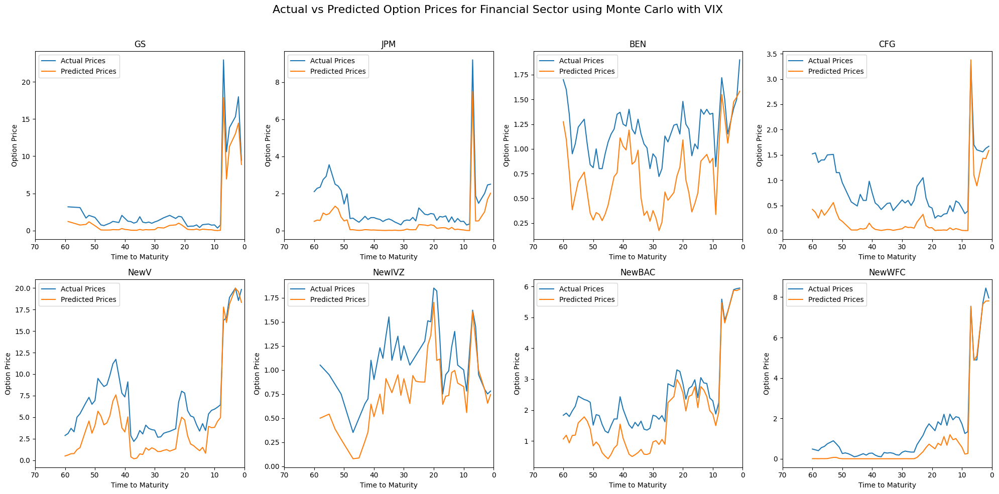

...

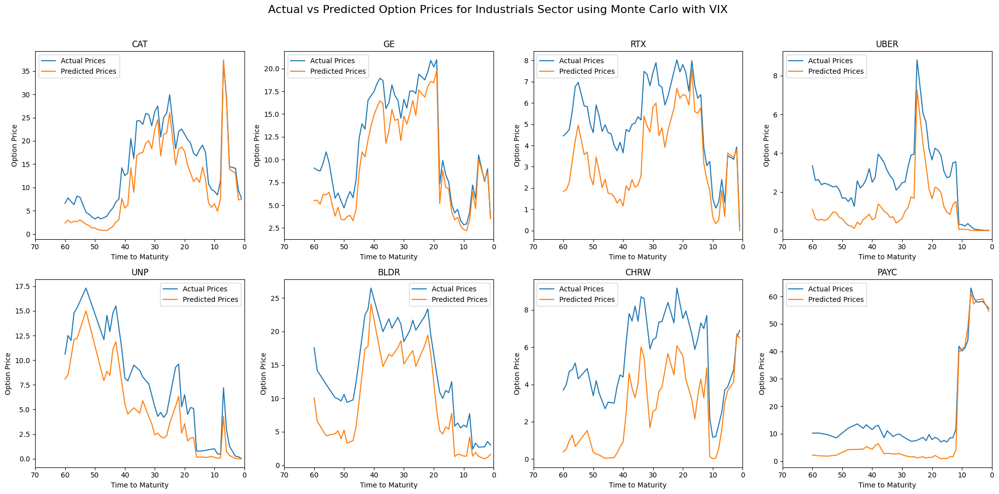

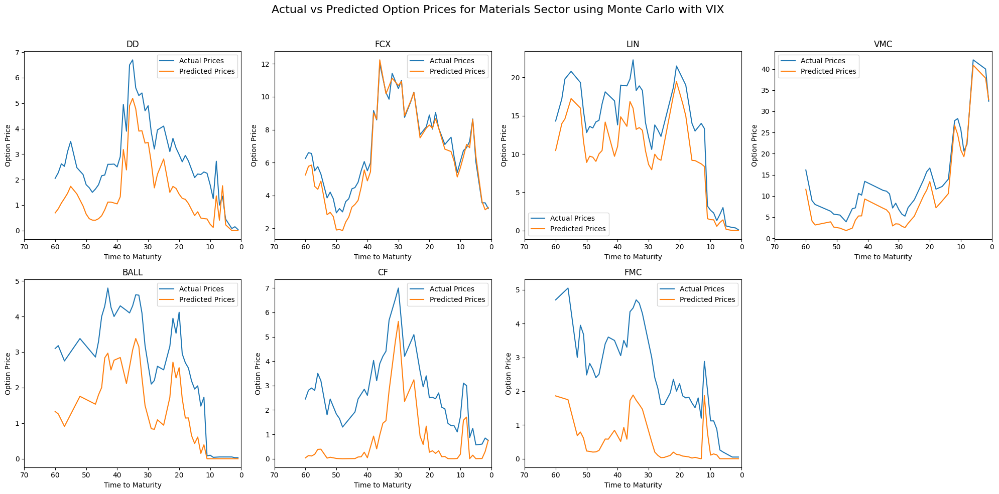

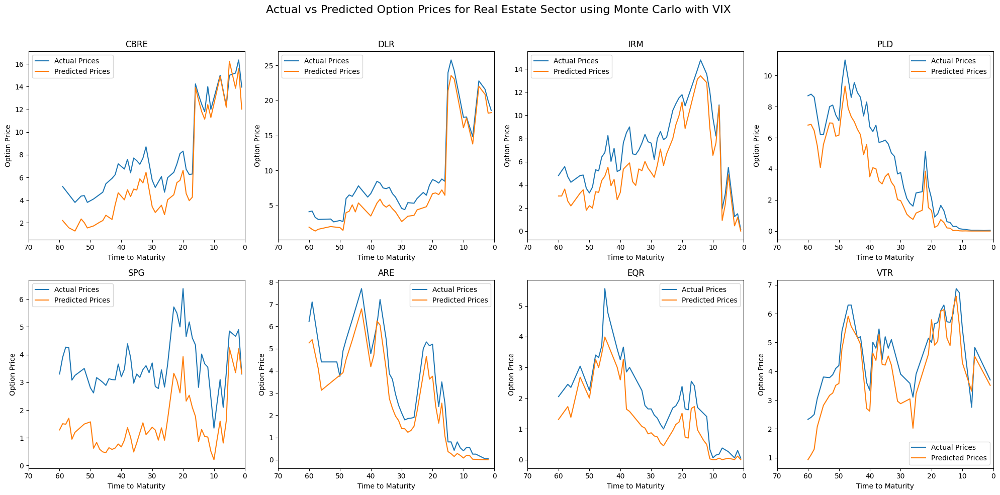

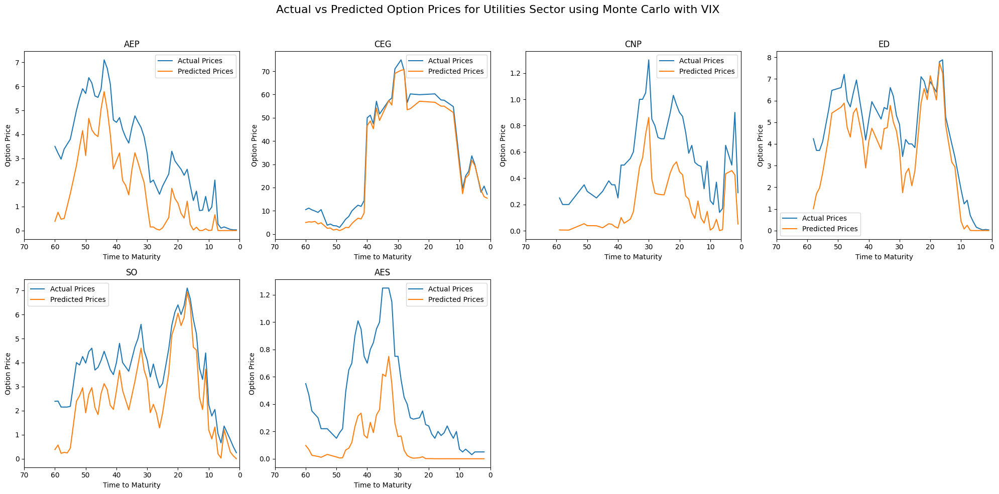

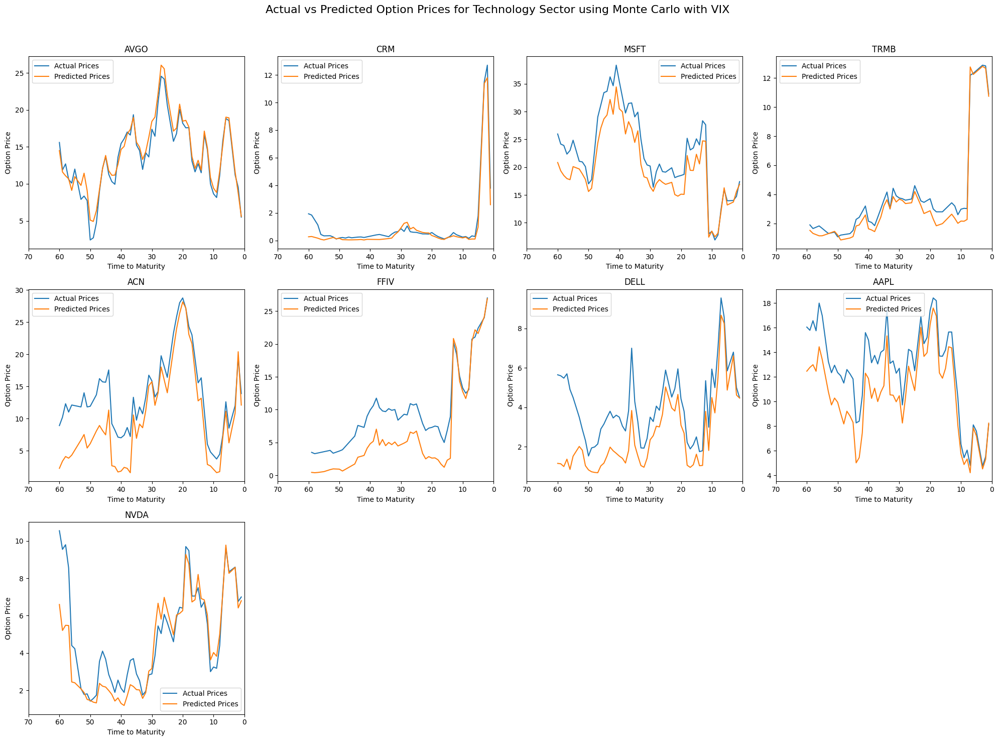

In [ ]:
paths = 5000

MC_VIX_CommunicationServices = MC('Communication Services', df_main_CommunicationServices, df_other_CommunicationServices, BS_VIX_CommunicationServices, 'VIX', paths)
plot_actual_vs_predicted('Communication Services', df_main_CommunicationServices, df_other_CommunicationServices, MC_VIX_CommunicationServices, 'Monte_Carlo_VIX')

MC_VIX_ConsumerDiscretionary = MC('Consumer Discretionary', df_main_ConsumerDiscretionary, df_other_ConsumerDiscretionary, BS_VIX_ConsumerDiscretionary, 'VIX', paths)
plot_actual_vs_predicted('Consumer Discretionary', df_main_ConsumerDiscretionary, df_other_ConsumerDiscretionary, MC_VIX_ConsumerDiscretionary, 'Monte_Carlo_VIX')

MC_VIX_ConsumerStaples = MC('Consumer Staples', df_main_ConsumerStaples, df_other_ConsumerStaples, BS_VIX_ConsumerStaples, 'VIX', paths)
plot_actual_vs_predicted('Consumer Staples', df_main_ConsumerStaples, df_other_ConsumerStaples, MC_VIX_ConsumerStaples, 'Monte_Carlo_VIX')

MC_VIX_Energy = MC('Energy', df_main_Energy, df_other_Energy, BS_VIX_Energy, 'VIX', paths)
plot_actual_vs_predicted('Energy', df_main_Energy, df_other_Energy, MC_VIX_Energy, 'Monte_Carlo_VIX')

MC_VIX_Financial = MC('Financial', df_main_Financial, df_other_Financial, BS_VIX_Financial, 'VIX', paths)
plot_actual_vs_predicted('Financial', df_main_Financial, df_other_Financial, MC_VIX_Financial, 'Monte_Carlo_VIX')

MC_VIX_Healthcare = MC('Healthcare', df_main_Healthcare, df_other_Healthcare, BS_VIX_Healthcare, 'VIX', paths)
plot_actual_vs_predicted('Healthcare', df_main_Healthcare, df_other_Healthcare, MC_VIX_Healthcare, 'Monte_Carlo_VIX')

MC_VIX_Industrials = MC('Industrials', df_main_Industrials, df_other_Industrials, BS_VIX_Industrials, 'VIX', paths)
plot_actual_vs_predicted('Industrials', df_main_Industrials, df_other_Industrials, MC_VIX_Industrials, 'Monte_Carlo_VIX')

MC_VIX_Materials = MC('Materials', df_main_Materials, df_other_Materials, BS_VIX_Materials, 'VIX', paths)
plot_actual_vs_predicted('Materials', df_main_Materials, df_other_Materials, MC_VIX_Materials, 'Monte_Carlo_VIX')

MC_VIX_RealEstate = MC('Real Estate', df_main_RealEstate, df_other_RealEstate, BS_VIX_RealEstate, 'VIX', paths)
plot_actual_vs_predicted('Real Estate', df_main_RealEstate, df_other_RealEstate, MC_VIX_RealEstate, 'Monte_Carlo_VIX')

MC_VIX_Utilities = MC('Utilities', df_main_Utilities, df_other_Utilities, BS_VIX_Utilities, 'VIX', paths)
plot_actual_vs_predicted('Utilities', df_main_Utilities, df_other_Utilities, MC_VIX_Utilities, 'Monte_Carlo_VIX')

MC_VIX_Technology = MC('Technology', df_main_Technology, df_other_Technology, BS_VIX_Technology, 'VIX', paths)
plot_actual_vs_predicted('Technology', df_main_Technology, df_other_Technology, MC_VIX_Technology, 'Monte_Carlo_VIX')


Saved dataframes to prevent needing to rerun

In [ ]:
MC_VIX_CommunicationServices.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_VIX_CommunicationServices.xlsx", index=False)
MC_VIX_ConsumerDiscretionary.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_VIX_ConsumerDiscretionary.xlsx", index=False)
MC_VIX_ConsumerStaples.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_VIX_ConsumerStaples.xlsx", index=False)
MC_VIX_Energy.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_VIX_Energy.xlsx", index=False)
MC_VIX_Financial.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_VIX_Financial.xlsx", index=False)
MC_VIX_Healthcare.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_VIX_Healthcare.xlsx", index=False)
MC_VIX_Industrials.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_VIX_Industrials.xlsx", index=False)
MC_VIX_Materials.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_VIX_Materials.xlsx", index=False)
MC_VIX_RealEstate.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_VIX_RealEstate.xlsx", index=False)
MC_VIX_Utilities.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_VIX_Utilities.xlsx", index=False)
MC_VIX_Technology.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_VIX_Technology.xlsx", index=False)


In [ ]:
MC_VIX_CommunicationServices=MC_VIX_CommunicationServices=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_VIX_CommunicationServices.xlsx")
MC_VIX_ConsumerDiscretionary=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_VIX_ConsumerDiscretionary.xlsx")
MC_VIX_ConsumerStaples=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_VIX_ConsumerStaples.xlsx")
MC_VIX_Energy=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_VIX_Energy.xlsx")
MC_VIX_Financial=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_VIX_Financial.xlsx")
MC_VIX_Healthcare=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_VIX_Healthcare.xlsx")
MC_VIX_Industrials=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_VIX_Industrials.xlsx")
MC_VIX_Materials=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_VIX_Materials.xlsx")
MC_VIX_RealEstate=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_VIX_RealEstate.xlsx")
MC_VIX_Utilities=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_VIX_Utilities.xlsx")
MC_VIX_Technology=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_VIX_Technology.xlsx")


Communication Services
GOOG 0.3109159458031415
GOOGL 0.3409678995815084
META 0.3184009360705831
NFLX 0.4680822985708899
FOX 0.25499456487990724
TTWO 0.2152691151071919
TMUS 0.12243011859065812
NewDIS 0.22918662866535416
Consumer Discretionary
ABNB 0.22346120522929086
AMZN 0.17294469406251928
HD 0.16380938697533481
NKE 0.08999453190333022
TSLA 0.20254569989080462
BWA 0.32447678055223506
WYNN 0.0810931406479258
MGM 0.1413895460119494
Consumer Staples
CL 0.10397533798063871
KO 0.0288451912116415
PG 0.15611400870380723
TGT 0.17783281860663636
SYY 0.23670811110107606
DG 0.02122809281718996
HSY 0.357421612649626
NewWMT 0.08257436965869022
Energy
SLB 0.28961128848789885
PSX 0.24671620076796416
WMB 0.040830489617095435
MPC 0.22016072796774278
OXY 0.1431882426026254
NewAPA 0.2002426850838297
NewEOG 0.2642617000231679
Financial
GS 0.06801524953232871
JPM 0.10585053328080062
BEN 0.41479757882851753
CFG 0.2052412186990878
NewV 0.16085317369946814
NewIVZ 0.23720356844939364
NewBAC 0.145964184140219

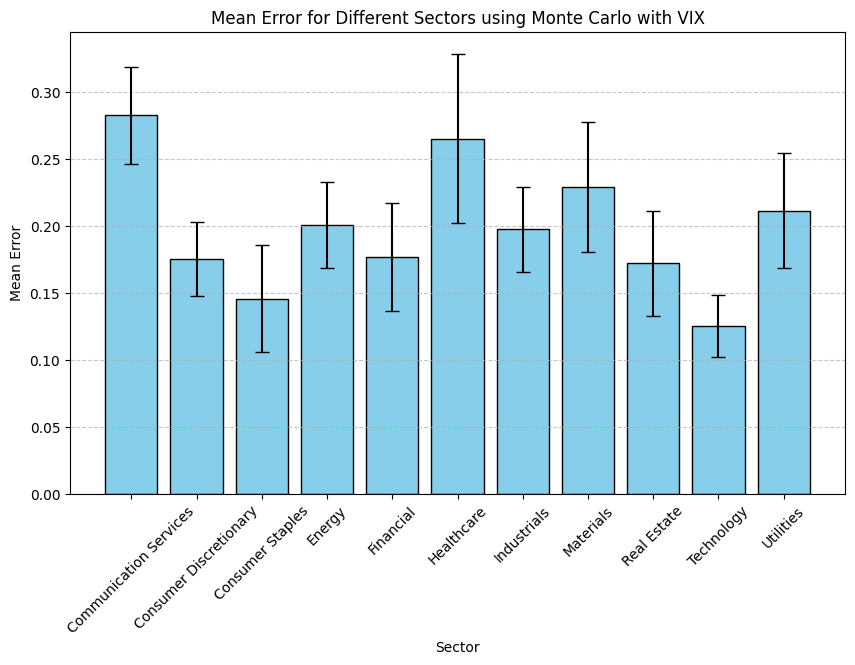

Mean error using Monte Carlo with VIX for sector Communication Services is: 0.282531 ± 0.036277
Mean error using Monte Carlo with VIX for sector Consumer Discretionary is: 0.174964 ± 0.027631
Mean error using Monte Carlo with VIX for sector Consumer Staples is: 0.145587 ± 0.039893
Mean error using Monte Carlo with VIX for sector Energy is: 0.200716 ± 0.032111
Mean error using Monte Carlo with VIX for sector Financial is: 0.176748 ± 0.039938
Mean error using Monte Carlo with VIX for sector Healthcare is: 0.265058 ± 0.063112
Mean error using Monte Carlo with VIX for sector Industrials is: 0.197391 ± 0.031936
Mean error using Monte Carlo with VIX for sector Materials is: 0.228923 ± 0.048301
Mean error using Monte Carlo with VIX for sector Real Estate is: 0.172081 ± 0.039203
Mean error using Monte Carlo with VIX for sector Technology is: 0.125222 ± 0.023094
Mean error using Monte Carlo with VIX for sector Utilities is: 0.211380 ± 0.043038


In [ ]:
# Calculate RMSE for Monte Carlo with VIX model
MC_VIX_rmses_CommunicationServices = RMSE("Communication Services", df_main_CommunicationServices, df_other_CommunicationServices, MC_VIX_CommunicationServices, 'Monte_Carlo_VIX')
MC_VIX_rmses_ConsumerDiscretionary = RMSE("Consumer Discretionary", df_main_ConsumerDiscretionary, df_other_ConsumerDiscretionary, MC_VIX_ConsumerDiscretionary, 'Monte_Carlo_VIX')
MC_VIX_rmses_ConsumerStaples = RMSE("Consumer Staples", df_main_ConsumerStaples, df_other_ConsumerStaples, MC_VIX_ConsumerStaples, 'Monte_Carlo_VIX')
MC_VIX_rmses_Energy = RMSE("Energy", df_main_Energy, df_other_Energy, MC_VIX_Energy, 'Monte_Carlo_VIX')
MC_VIX_rmses_Financial = RMSE("Financial", df_main_Financial, df_other_Financial, MC_VIX_Financial, 'Monte_Carlo_VIX')
MC_VIX_rmses_Healthcare = RMSE("Healthcare", df_main_Healthcare, df_other_Healthcare, MC_VIX_Healthcare, 'Monte_Carlo_VIX')
MC_VIX_rmses_Industrials = RMSE("Industrials", df_main_Industrials, df_other_Industrials, MC_VIX_Industrials, 'Monte_Carlo_VIX')
MC_VIX_rmses_Materials = RMSE("Materials", df_main_Materials, df_other_Materials, MC_VIX_Materials, 'Monte_Carlo_VIX')
MC_VIX_rmses_RealEstate = RMSE("Real Estate", df_main_RealEstate, df_other_RealEstate, MC_VIX_RealEstate, 'Monte_Carlo_VIX')
MC_VIX_rmses_Technology = RMSE("Technology", df_main_Technology, df_other_Technology, MC_VIX_Technology, 'Monte_Carlo_VIX')
MC_VIX_rmses_Utilities = RMSE("Utilities", df_main_Utilities, df_other_Utilities, MC_VIX_Utilities, 'Monte_Carlo_VIX')

# Organize RMSE results into a list
MC_VIX_rmses_array = [
    MC_VIX_rmses_CommunicationServices,
    MC_VIX_rmses_ConsumerDiscretionary,
    MC_VIX_rmses_ConsumerStaples,
    MC_VIX_rmses_Energy,
    MC_VIX_rmses_Financial,
    MC_VIX_rmses_Healthcare,
    MC_VIX_rmses_Industrials,
    MC_VIX_rmses_Materials,
    MC_VIX_rmses_RealEstate,
    MC_VIX_rmses_Technology,
    MC_VIX_rmses_Utilities
]

# Plot RMSE results
plot_rmses_for_method(MC_VIX_rmses_array, sector_list, "Monte Carlo with VIX")


# **Investigating ARCH/GARCH with the Monte Carlo Method**

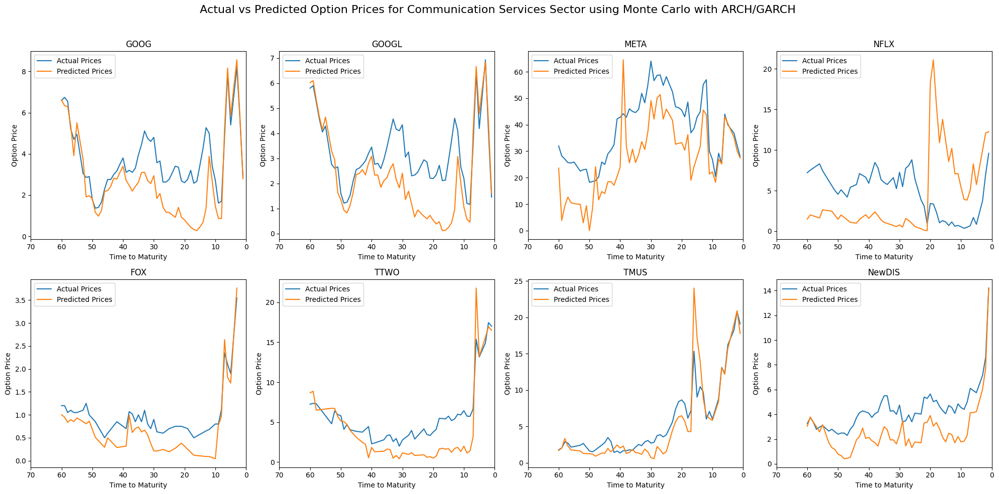

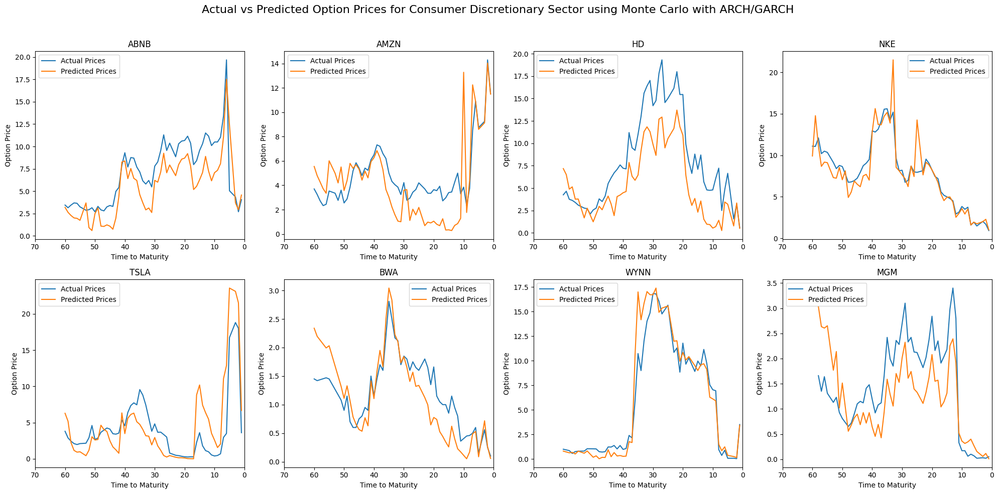

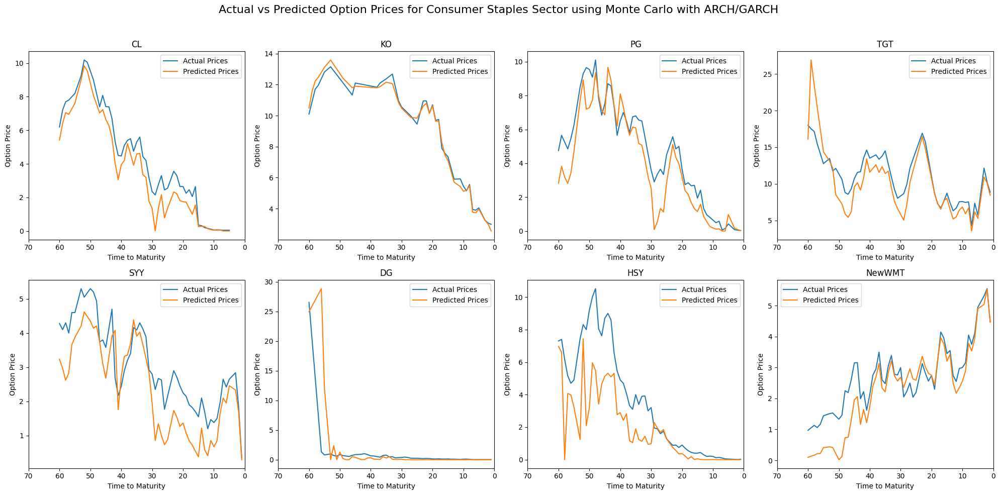

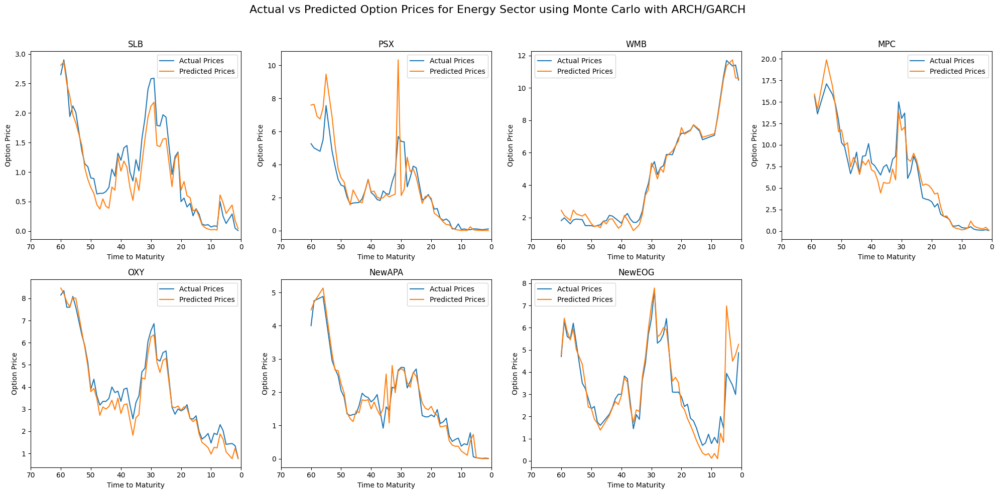

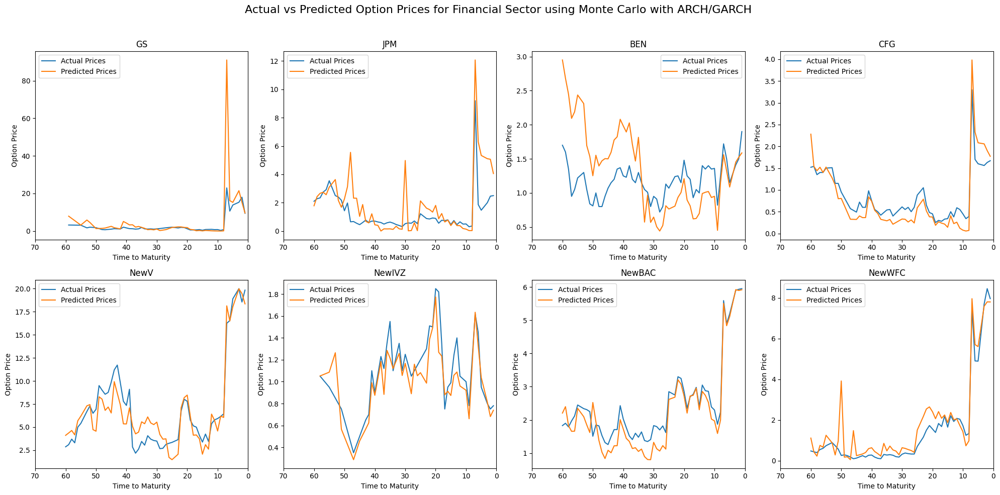

...

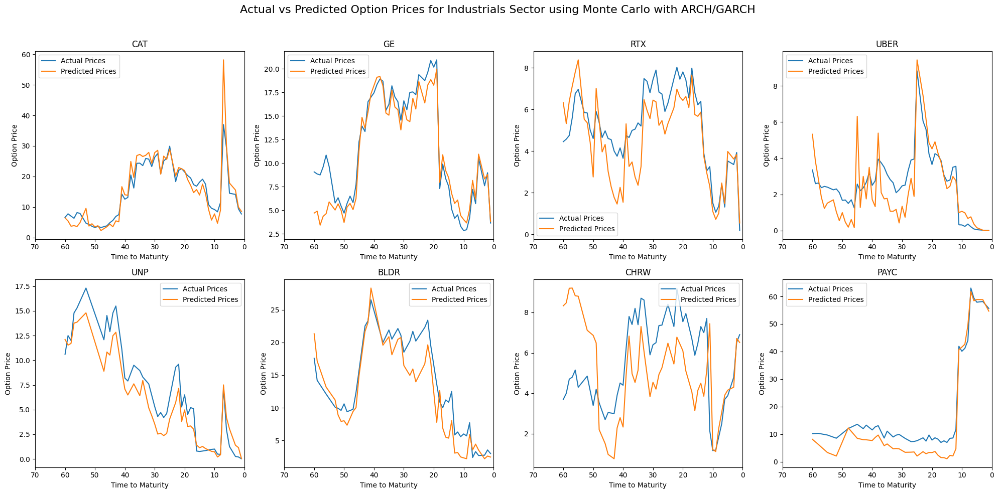

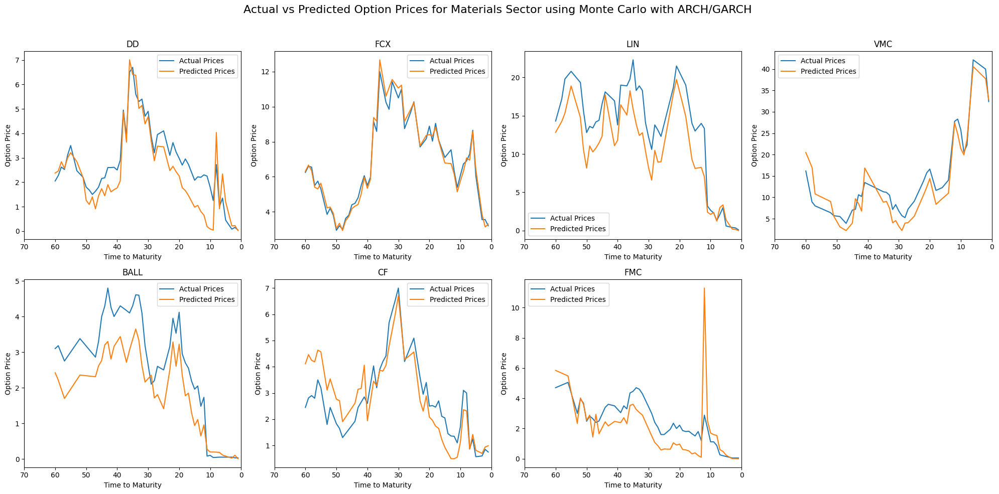

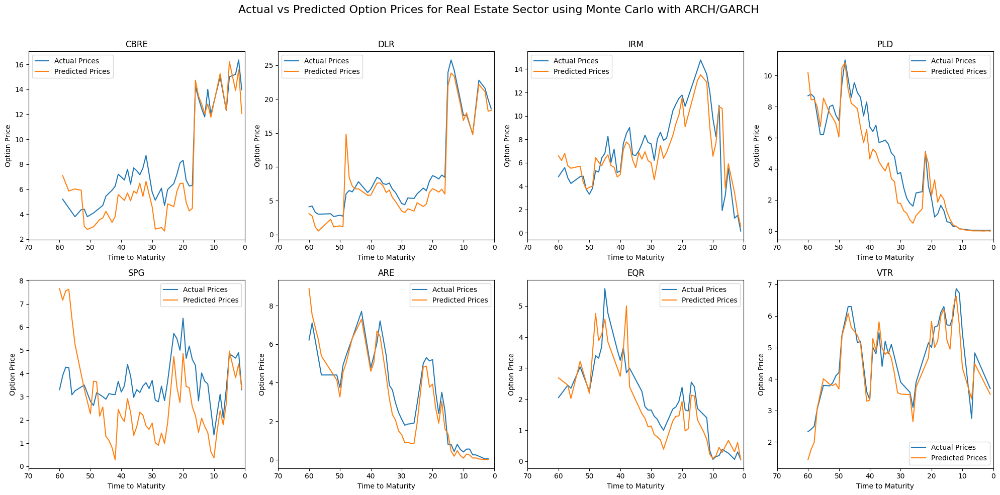

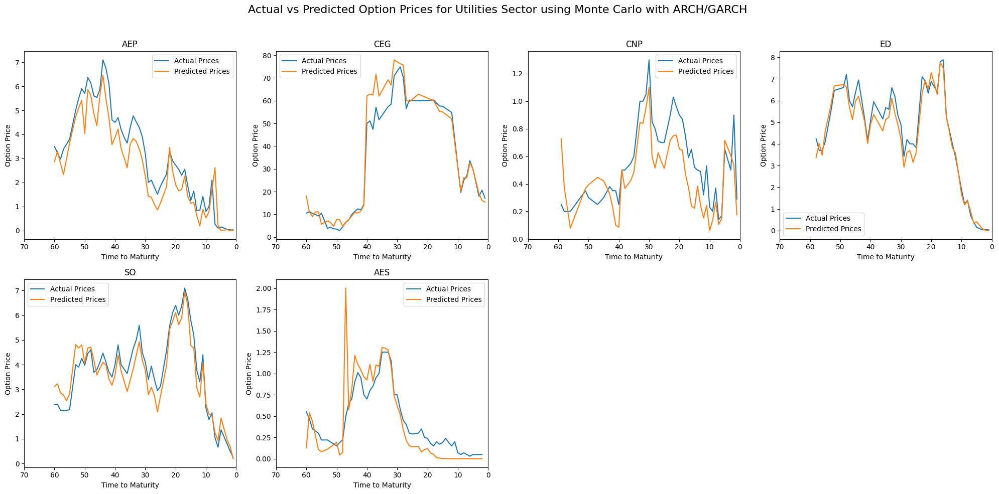

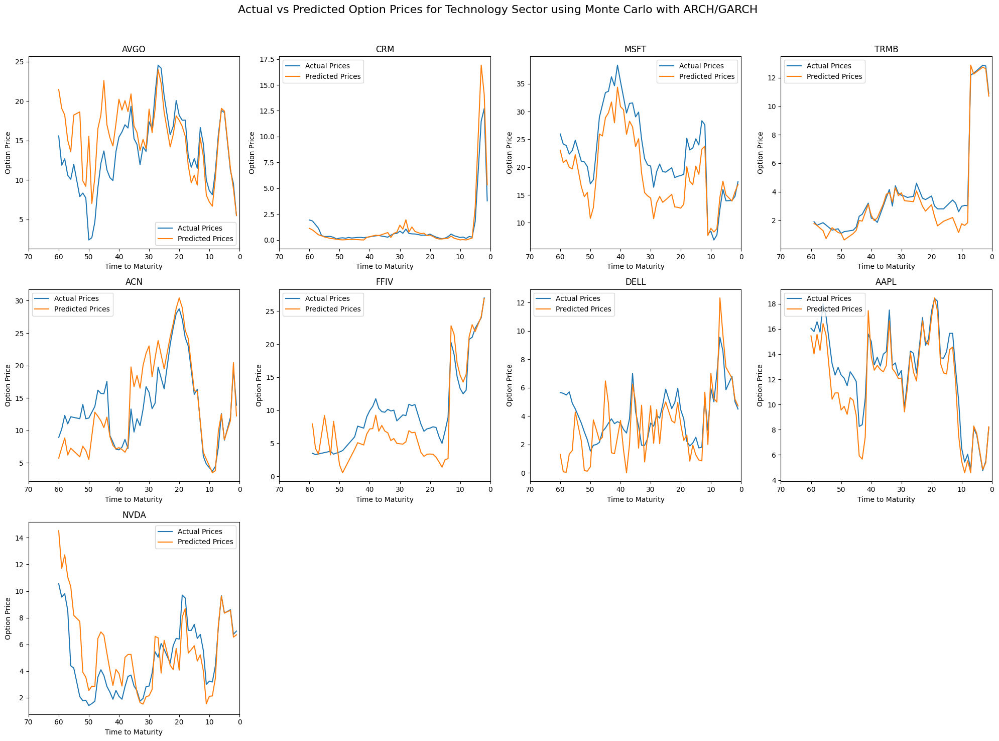

In [ ]:
paths = 5000

MC_ARCH_GARCH_CommunicationServices = MC('Communication Services', df_main_CommunicationServices, df_other_CommunicationServices, BS_ARCH_GARCH_CommunicationServices, 'ARCH/GARCH', paths)
plot_actual_vs_predicted('Communication Services', df_main_CommunicationServices, df_other_CommunicationServices, MC_ARCH_GARCH_CommunicationServices, 'Monte_Carlo_ARCH/GARCH')

MC_ARCH_GARCH_ConsumerDiscretionary = MC('Consumer Discretionary', df_main_ConsumerDiscretionary, df_other_ConsumerDiscretionary, BS_ARCH_GARCH_ConsumerDiscretionary, 'ARCH/GARCH', paths)
plot_actual_vs_predicted('Consumer Discretionary', df_main_ConsumerDiscretionary, df_other_ConsumerDiscretionary, MC_ARCH_GARCH_ConsumerDiscretionary, 'Monte_Carlo_ARCH/GARCH')

MC_ARCH_GARCH_ConsumerStaples = MC('Consumer Staples', df_main_ConsumerStaples, df_other_ConsumerStaples, BS_ARCH_GARCH_ConsumerStaples, 'ARCH/GARCH', paths)
plot_actual_vs_predicted('Consumer Staples', df_main_ConsumerStaples, df_other_ConsumerStaples, MC_ARCH_GARCH_ConsumerStaples, 'Monte_Carlo_ARCH/GARCH')

MC_ARCH_GARCH_Energy = MC('Energy', df_main_Energy, df_other_Energy, BS_ARCH_GARCH_Energy, 'ARCH/GARCH', paths)
plot_actual_vs_predicted('Energy', df_main_Energy, df_other_Energy, MC_ARCH_GARCH_Energy, 'Monte_Carlo_ARCH/GARCH')

MC_ARCH_GARCH_Financial = MC('Financial', df_main_Financial, df_other_Financial, BS_ARCH_GARCH_Financial, 'ARCH/GARCH', paths)
plot_actual_vs_predicted('Financial', df_main_Financial, df_other_Financial, MC_ARCH_GARCH_Financial, 'Monte_Carlo_ARCH/GARCH')

MC_ARCH_GARCH_Healthcare = MC('Healthcare', df_main_Healthcare, df_other_Healthcare, BS_ARCH_GARCH_Healthcare, 'ARCH/GARCH', paths)
plot_actual_vs_predicted('Healthcare', df_main_Healthcare, df_other_Healthcare, MC_ARCH_GARCH_Healthcare, 'Monte_Carlo_ARCH/GARCH')

MC_ARCH_GARCH_Industrials = MC('Industrials', df_main_Industrials, df_other_Industrials, BS_ARCH_GARCH_Industrials, 'ARCH/GARCH', paths)
plot_actual_vs_predicted('Industrials', df_main_Industrials, df_other_Industrials, MC_ARCH_GARCH_Industrials, 'Monte_Carlo_ARCH/GARCH')

MC_ARCH_GARCH_Materials = MC('Materials', df_main_Materials, df_other_Materials, BS_ARCH_GARCH_Materials, 'ARCH/GARCH', paths)
plot_actual_vs_predicted('Materials', df_main_Materials, df_other_Materials, MC_ARCH_GARCH_Materials, 'Monte_Carlo_ARCH/GARCH')

MC_ARCH_GARCH_RealEstate = MC('Real Estate', df_main_RealEstate, df_other_RealEstate, BS_ARCH_GARCH_RealEstate, 'ARCH/GARCH', paths)
plot_actual_vs_predicted('Real Estate', df_main_RealEstate, df_other_RealEstate, MC_ARCH_GARCH_RealEstate, 'Monte_Carlo_ARCH/GARCH')

MC_ARCH_GARCH_Utilities = MC('Utilities', df_main_Utilities, df_other_Utilities, BS_ARCH_GARCH_Utilities, 'ARCH/GARCH', paths)
plot_actual_vs_predicted('Utilities', df_main_Utilities, df_other_Utilities, MC_ARCH_GARCH_Utilities, 'Monte_Carlo_ARCH/GARCH')

MC_ARCH_GARCH_Technology = MC('Technology', df_main_Technology, df_other_Technology, BS_ARCH_GARCH_Technology, 'ARCH/GARCH', paths)
plot_actual_vs_predicted('Technology', df_main_Technology, df_other_Technology, MC_ARCH_GARCH_Technology, 'Monte_Carlo_ARCH/GARCH')


In [ ]:
# MC_ARCH_GARCH DataFrames
MC_ARCH_GARCH_CommunicationServices.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_ARCH_GARCH_CommunicationServices.xlsx", index=False)
MC_ARCH_GARCH_ConsumerDiscretionary.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_ARCH_GARCH_ConsumerDiscretionary.xlsx", index=False)
MC_ARCH_GARCH_ConsumerStaples.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_ARCH_GARCH_ConsumerStaples.xlsx", index=False)
MC_ARCH_GARCH_Energy.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_ARCH_GARCH_Energy.xlsx", index=False)
MC_ARCH_GARCH_Financial.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_ARCH_GARCH_Financial.xlsx", index=False)
MC_ARCH_GARCH_Healthcare.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_ARCH_GARCH_Healthcare.xlsx", index=False)
MC_ARCH_GARCH_Industrials.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_ARCH_GARCH_Industrials.xlsx", index=False)
MC_ARCH_GARCH_Materials.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_ARCH_GARCH_Materials.xlsx", index=False)
MC_ARCH_GARCH_RealEstate.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_ARCH_GARCH_RealEstate.xlsx", index=False)
MC_ARCH_GARCH_Utilities.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_ARCH_GARCH_Utilities.xlsx", index=False)
MC_ARCH_GARCH_Technology.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_ARCH_GARCH_Technology.xlsx", index=False)

In [ ]:
# Load MC_ARCH_GARCH DataFrames
MC_ARCH_GARCH_CommunicationServices = pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_ARCH_GARCH_CommunicationServices.xlsx")
MC_ARCH_GARCH_ConsumerDiscretionary = pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_ARCH_GARCH_ConsumerDiscretionary.xlsx")
MC_ARCH_GARCH_ConsumerStaples = pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_ARCH_GARCH_ConsumerStaples.xlsx")
MC_ARCH_GARCH_Energy = pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_ARCH_GARCH_Energy.xlsx")
MC_ARCH_GARCH_Financial = pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_ARCH_GARCH_Financial.xlsx")
MC_ARCH_GARCH_Healthcare = pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_ARCH_GARCH_Healthcare.xlsx")
MC_ARCH_GARCH_Industrials = pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_ARCH_GARCH_Industrials.xlsx")
MC_ARCH_GARCH_Materials = pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_ARCH_GARCH_Materials.xlsx")
MC_ARCH_GARCH_RealEstate = pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_ARCH_GARCH_RealEstate.xlsx")
MC_ARCH_GARCH_Utilities = pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_ARCH_GARCH_Utilities.xlsx")
MC_ARCH_GARCH_Technology = pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/MC_ARCH_GARCH_Technology.xlsx")

Communication Services
GOOG 0.2121390632689448
GOOGL 0.23405502173565595
META 0.2944902419373641
NFLX 0.7334002285538005
FOX 0.11808609429574257
TTWO 0.1772756840590161
TMUS 0.10851409721923572
NewDIS 0.16292122311969995
Consumer Discretionary
ABNB 0.14194126839633917
AMZN 0.19023283513583594
HD 0.19107974527992835
NKE 0.10713827637927813
TSLA 0.1720001756884965
BWA 0.1451784962564224
WYNN 0.09561225876015307
MGM 0.20071649230162708
Consumer Staples
CL 0.09182994706668347
KO 0.029527121782971226
PG 0.1280935671320811
TGT 0.1794666814151126
SYY 0.179593896879163
DG 0.14820605680365015
HSY 0.23170163518874515
NewWMT 0.1404900975050015
Energy
SLB 0.08210859831518985
PSX 0.16290600249049927
WMB 0.03031912548929477
MPC 0.07080160703346404
OXY 0.05492025059447701
NewAPA 0.0570546909494589
NewEOG 0.09194961886635604
Financial
GS 0.45174179213362464
JPM 0.16548509656983315
BEN 0.4763645729451743
CFG 0.09192795163131047
NewV 0.08499243048164658
NewIVZ 0.11068807866687884
NewBAC 0.08107127492731

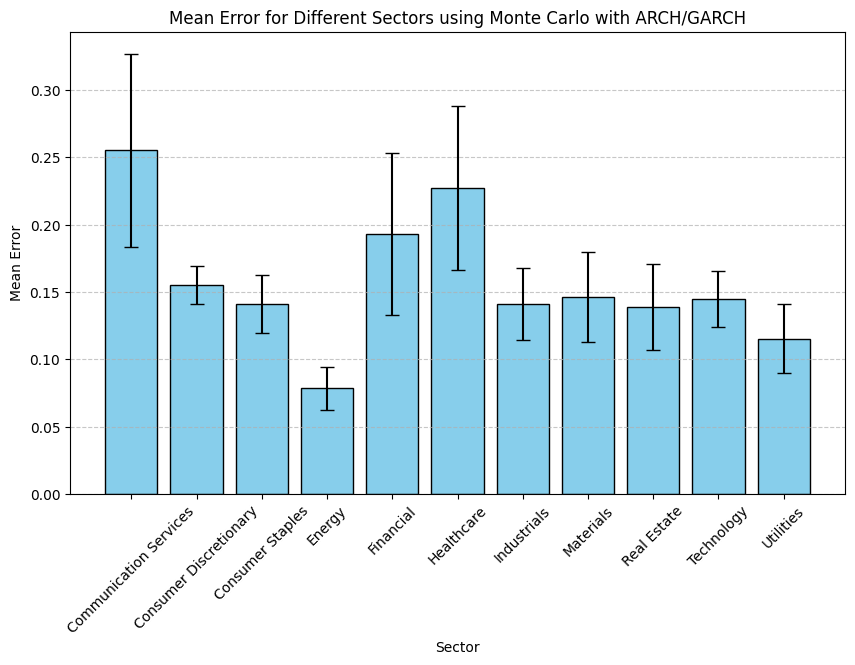

Mean error using Monte Carlo with ARCH/GARCH for sector Communication Services is: 0.255110 ± 0.071642
Mean error using Monte Carlo with ARCH/GARCH for sector Consumer Discretionary is: 0.155487 ± 0.014018
Mean error using Monte Carlo with ARCH/GARCH for sector Consumer Staples is: 0.141114 ± 0.021654
Mean error using Monte Carlo with ARCH/GARCH for sector Energy is: 0.078580 ± 0.015972
Mean error using Monte Carlo with ARCH/GARCH for sector Financial is: 0.192887 ± 0.060025
Mean error using Monte Carlo with ARCH/GARCH for sector Healthcare is: 0.227324 ± 0.060920
Mean error using Monte Carlo with ARCH/GARCH for sector Industrials is: 0.141147 ± 0.026414
Mean error using Monte Carlo with ARCH/GARCH for sector Materials is: 0.146371 ± 0.033349
Mean error using Monte Carlo with ARCH/GARCH for sector Real Estate is: 0.139050 ± 0.031920
Mean error using Monte Carlo with ARCH/GARCH for sector Technology is: 0.145024 ± 0.020946
Mean error using Monte Carlo with ARCH/GARCH for sector Utilitie

In [ ]:
# Calculate RMSE for Monte Carlo with ARCH/GARCH model
MC_ARCH_GARCH_rmses_CommunicationServices = RMSE("Communication Services", df_main_CommunicationServices, df_other_CommunicationServices, MC_ARCH_GARCH_CommunicationServices, 'Monte_Carlo_ARCH/GARCH')
MC_ARCH_GARCH_rmses_ConsumerDiscretionary = RMSE("Consumer Discretionary", df_main_ConsumerDiscretionary, df_other_ConsumerDiscretionary, MC_ARCH_GARCH_ConsumerDiscretionary, 'Monte_Carlo_ARCH/GARCH')
MC_ARCH_GARCH_rmses_ConsumerStaples = RMSE("Consumer Staples", df_main_ConsumerStaples, df_other_ConsumerStaples, MC_ARCH_GARCH_ConsumerStaples, 'Monte_Carlo_ARCH/GARCH')
MC_ARCH_GARCH_rmses_Energy = RMSE("Energy", df_main_Energy, df_other_Energy, MC_ARCH_GARCH_Energy, 'Monte_Carlo_ARCH/GARCH')
MC_ARCH_GARCH_rmses_Financial = RMSE("Financial", df_main_Financial, df_other_Financial, MC_ARCH_GARCH_Financial, 'Monte_Carlo_ARCH/GARCH')
MC_ARCH_GARCH_rmses_Healthcare = RMSE("Healthcare", df_main_Healthcare, df_other_Healthcare, MC_ARCH_GARCH_Healthcare, 'Monte_Carlo_ARCH/GARCH')
MC_ARCH_GARCH_rmses_Industrials = RMSE("Industrials", df_main_Industrials, df_other_Industrials, MC_ARCH_GARCH_Industrials, 'Monte_Carlo_ARCH/GARCH')
MC_ARCH_GARCH_rmses_Materials = RMSE("Materials", df_main_Materials, df_other_Materials, MC_ARCH_GARCH_Materials, 'Monte_Carlo_ARCH/GARCH')
MC_ARCH_GARCH_rmses_RealEstate = RMSE("Real Estate", df_main_RealEstate, df_other_RealEstate, MC_ARCH_GARCH_RealEstate, 'Monte_Carlo_ARCH/GARCH')
MC_ARCH_GARCH_rmses_Technology = RMSE("Technology", df_main_Technology, df_other_Technology, MC_ARCH_GARCH_Technology, 'Monte_Carlo_ARCH/GARCH')
MC_ARCH_GARCH_rmses_Utilities = RMSE("Utilities", df_main_Utilities, df_other_Utilities, MC_ARCH_GARCH_Utilities, 'Monte_Carlo_ARCH/GARCH')

# Organize RMSE results into a list
MC_ARCH_GARCH_rmses_array = [
    MC_ARCH_GARCH_rmses_CommunicationServices,
    MC_ARCH_GARCH_rmses_ConsumerDiscretionary,
    MC_ARCH_GARCH_rmses_ConsumerStaples,
    MC_ARCH_GARCH_rmses_Energy,
    MC_ARCH_GARCH_rmses_Financial,
    MC_ARCH_GARCH_rmses_Healthcare,
    MC_ARCH_GARCH_rmses_Industrials,
    MC_ARCH_GARCH_rmses_Materials,
    MC_ARCH_GARCH_rmses_RealEstate,
    MC_ARCH_GARCH_rmses_Technology,
    MC_ARCH_GARCH_rmses_Utilities
]

# Plot RMSE results
plot_rmses_for_method(MC_ARCH_GARCH_rmses_array, sector_list, "Monte Carlo with ARCH/GARCH")


Investigations for when you have time.

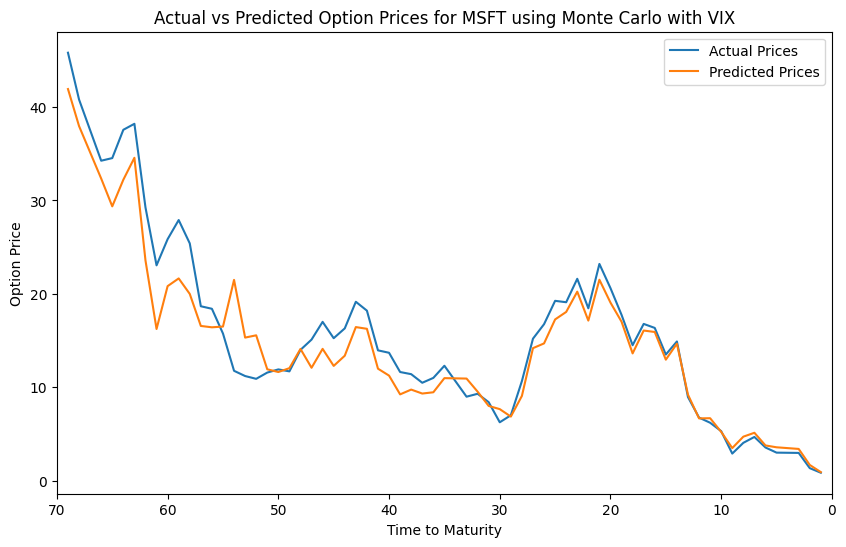

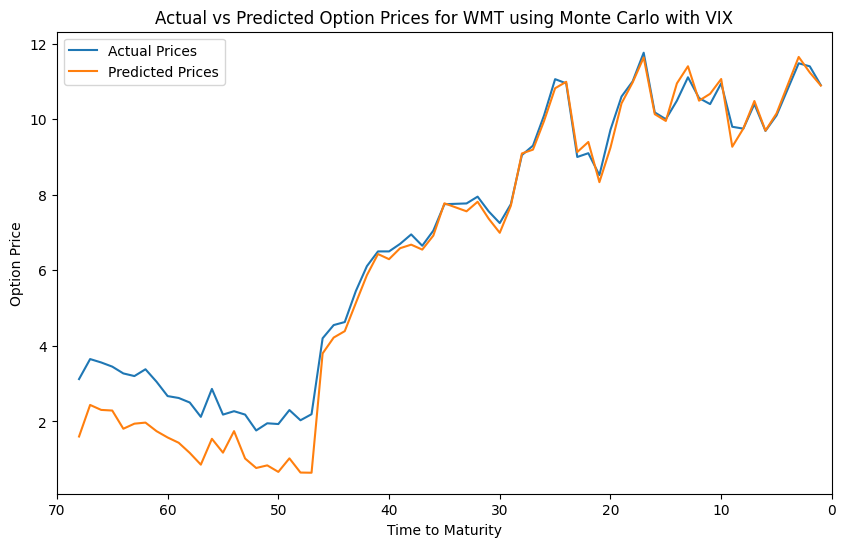

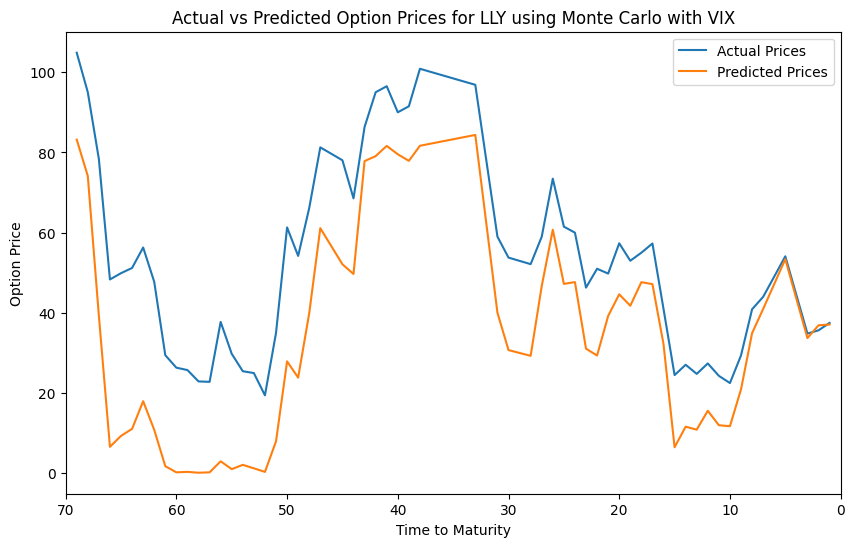

         Date  MSFT_Monte_Carlo_VIX_option  WMT_Monte_Carlo_VIX_option  \
0  2024-07-15                    41.922216                         NaN   
1  2024-07-16                    37.958244                    1.599816   
2  2024-07-17                          NaN                    2.435618   
3  2024-07-18                    32.339234                    2.304056   
4  2024-07-19                    29.364390                    2.287390   
..        ...                          ...                         ...   
63 2024-10-11                     3.571851                   10.153098   
64 2024-10-15                     3.397249                   11.648482   
65 2024-10-16                     1.680916                   11.237311   
66 2024-10-17                     0.915946                   10.890583   
67 2024-10-18                          NaN                         NaN   

    LLY_Monte_Carlo_VIX_option  
0                    83.191132  
1                    74.114465  
2           

In [ ]:
paths=10*3
MC_VIX_Technology=MC('Technology',df_main_Technology,df_other_Technology,BS_VIX_Technology,'VIX',paths)
plot_actual_vs_predicted('Technology',df_main_Technology,df_other_Technology,MC_VIX_Technology,'Monte_Carlo_VIX')
print(MC_VIX_Technology)

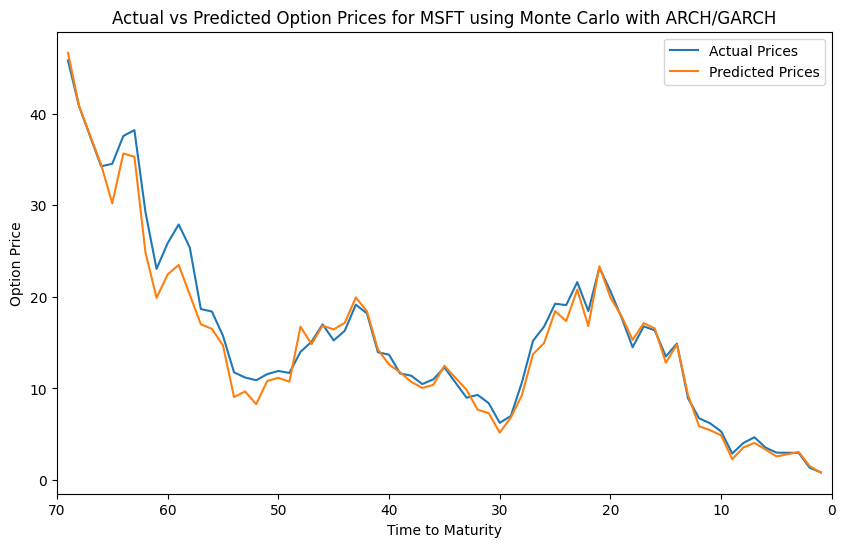

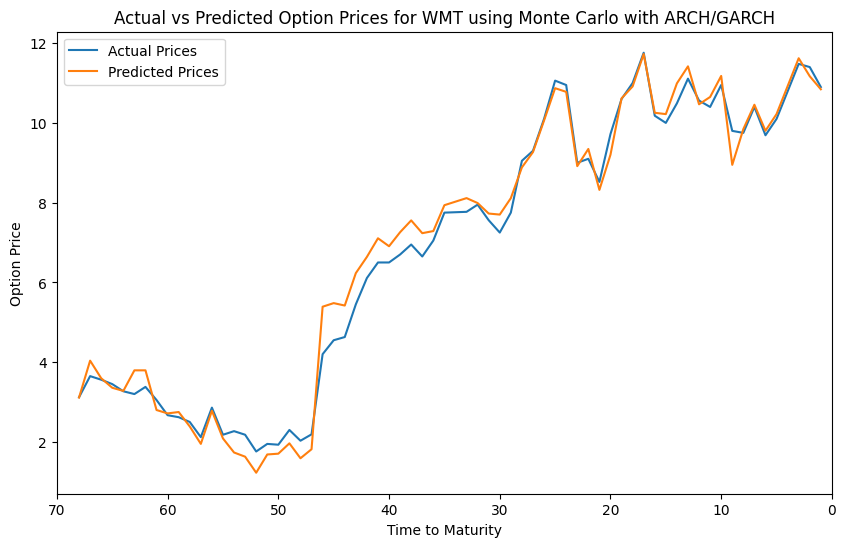

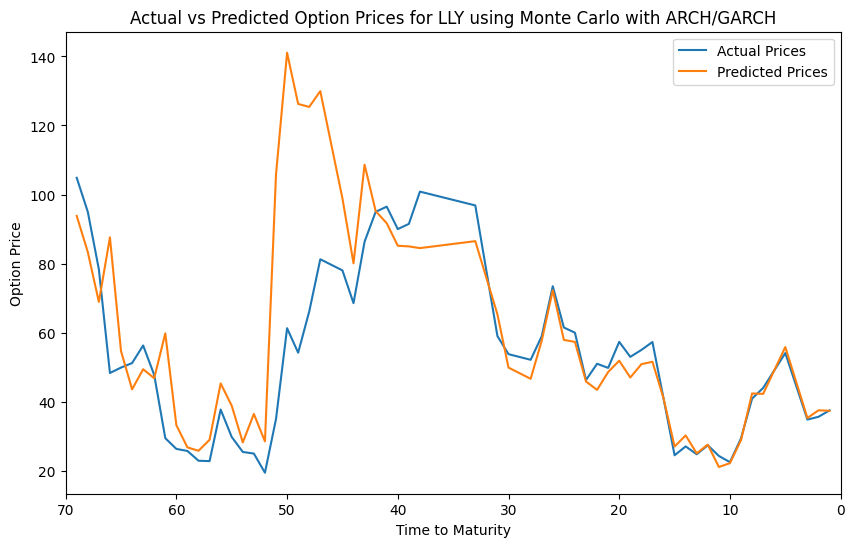

In [ ]:
MC_ARCH_GARCH_Technology=MC('Technology',df_main_Technology,df_other_Technology,BS_ARCH_GARCH_Technology,'ARCH/GARCH',10**3)
plot_actual_vs_predicted('Technology',df_main_Technology,df_other_Technology,MC_ARCH_GARCH_Technology,'Monte_Carlo_ARCH/GARCH')

In [ ]:
#BS_VIX_rmses=RMSE("Technology",df_main_Technology,BS_VIX_Technology,'VIX')
#print(BS_VIX_rmses)
Ns=np.linspace(100, 1000, num=990, dtype=int)
errors=[]
for N in Ns:
  print(N)
  Binomial_ARCH_GARCH_Technology=Binomial('Technology',df_main_Technology,df_other_Technology,BS_ARCH_GARCH_Technology,'ARCH/GARCH',N)
  Binomial_ARCH_GARCH_rmses=RMSE("Technology",df_main_Technology,Binomial_ARCH_GARCH_Technology,'Binomial_ARCH/GARCH')
  #print(Binomial_ARCH_GARCH_rmses)
  avg_error=0
  for rmse in Binomial_ARCH_GARCH_rmses:
    avg_error+=rmse
  avg_error=avg_error/len(Binomial_ARCH_GARCH_rmses)
  errors.append(avg_error)

plt.plot(Ns,errors)
plt.xlabel('N')
plt.ylabel('RMSE')
plt.show()


100


NameError: name 'Binomial' is not defined

Streaming output truncated to the last 5000 lines.
UBER 0.19794936219709908
UNP 0.1614129164743526
BLDR 0.2003549704722111
CHRW 0.39024593401847013
PAYC 0.11277228431031804
Processing N = 7200 for sector Industrials
Industrials
CAT 0.1349541486971279
GE 0.12719082991875227
RTX 0.253464735809362
UBER 0.19809874966879915
UNP 0.16086687116456969
BLDR 0.20074834208269712
CHRW 0.3892614453416038
PAYC 0.11262055850389202
Processing N = 7300 for sector Industrials
Industrials
CAT 0.13532336365901515
GE 0.12653092408872357
RTX 0.25553846283003734
UBER 0.19786878334166652
UNP 0.1601803410704118
BLDR 0.20326972241709323
CHRW 0.38980229994650656
PAYC 0.11283962906006505
Processing N = 7400 for sector Industrials
Industrials
CAT 0.13486724910515285
GE 0.12741412245348588
RTX 0.2542881611760485
UBER 0.19791078019221478
UNP 0.16038325753315516
BLDR 0.19982444572270006
CHRW 0.3897751193294894
PAYC 0.11256176958143715
Processing N = 7500 for sector Industrials
Industrials
CAT 0.13454655165985124
GE 0.

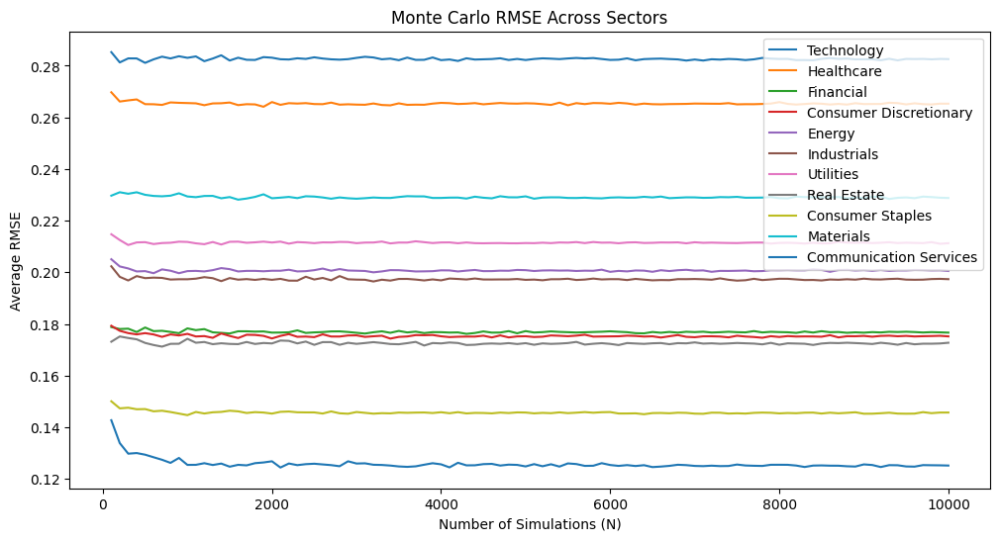

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Define the S&P 500 sector dictionary
sp500_dict = {
    "Technology": ["AAPL", "ACN", "AVGO", "CRM", "DELL", "FFIV", "MSFT", "NVDA", "TRMB"],
    "Healthcare": ["ABBV", "ABT", "CNC", "COR", "ISRG", "LLY", "NewDXCM", "PFE", "UNH"],
    "Financial": ["NewBAC", "BEN", "CFG", "GS", "JPM", "NewIVZ", "NewV", "NewWFC"],
    "Consumer Discretionary": ["AMZN", "ABNB", "BWA", "HD", "MGM", "NKE", "TSLA", "WYNN"],
    "Energy": ["MPC", "NewAPA", "NewEOG", "OXY", "PSX", "SLB", "WMB"],
    "Industrials": ["BLDR", "CAT", "CHRW", "GE", "PAYC", "RTX", "UBER", "UNP"],
    "Utilities": ["CEG", "SO", "ED", "CNP", "AES", "AEP"],
    "Real Estate": ["ARE", "CBRE", "DLR", "EQR", "IRM", "PLD", "SPG", "VTR"],
    "Consumer Staples": ["CL", "DG", "HSY", "KO", "NewWMT", "PG", "SYY", "TGT"],
    "Materials": ["CF", "BALL", "DD", "FCX", "FMC", "LIN", "VMC"],
    "Communication Services": ["GOOG", "FOX", "GOOGL", "META", "NewDIS", "NFLX", "TMUS", "TTWO"]
}

# Define the number of Monte Carlo simulations
Ns = np.linspace(100, 10000, num=100, dtype=int)

# Dictionary to store errors for each sector
sector_errors = {}

# Loop through each sector
for sector in sp500_dict.keys():
    errors = []  # Store RMSE values for this sector
    main_df = globals()[f"df_main_{sector.replace(' ', '')}"]  # Get main DataFrame
    other_df = globals()[f"df_other_{sector.replace(' ', '')}"]  # Get other DataFrame
    BS_VIX_sector = globals()[f"BS_VIX_{sector.replace(' ', '')}"]  # Get Black-Scholes function

    print(f"Processing sector: {sector}")

    for N in Ns:
        print(f"Processing N = {N} for sector {sector}")

        # Run Monte Carlo Simulation
        MC_VIX = MC(sector, main_df, other_df, BS_VIX_sector, 'VIX', N)
        MC_VIX_rmses = RMSE(sector, main_df, MC_VIX, 'Monte_Carlo_VIX')

        # Ensure RMSE values are valid
        if MC_VIX_rmses and len(MC_VIX_rmses) > 0:
            avg_error = sum(MC_VIX_rmses) / len(MC_VIX_rmses)
        else:
            avg_error = 0  # Default to 0 if no valid RMSE values

        errors.append(avg_error)

    sector_errors[sector] = errors  # Store the errors for plotting

# Plot the results for each sector
plt.figure(figsize=(12, 6))
for sector, errors in sector_errors.items():
    plt.plot(Ns, errors, label=sector)

plt.xlabel('Number of Simulations (N)')
plt.ylabel('Average RMSE')
plt.title('Monte Carlo RMSE Across Sectors')
plt.legend()
plt.show()


In [ ]:
import pickle

# Save the sector_errors dictionary
with open("/content/drive/My Drive/MSci Project/Saved Dataframes/sector_errors.pkl", "wb") as f:
    pickle.dump(sector_errors, f)

print("Sector errors dictionary saved successfully!")

Sector errors dictionary saved successfully!


Sector errors dictionary loaded successfully!


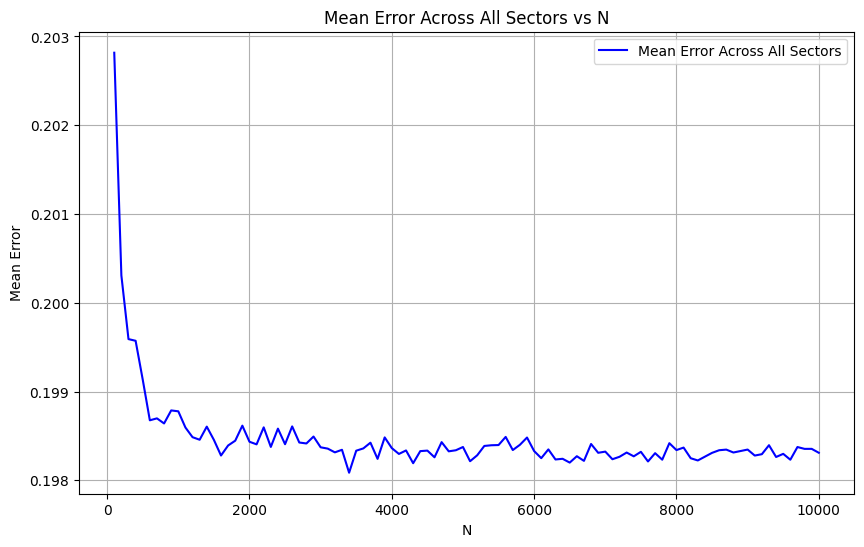

In [ ]:
import pickle
import numpy as np
import matplotlib.pyplot as plt

# Load the saved sector errors dictionary
with open("/content/drive/My Drive/MSci Project/Saved Dataframes/sector_errors.pkl", "rb") as f:
    sector_errors = pickle.load(f)

print("Sector errors dictionary loaded successfully!")
import numpy as np
import matplotlib.pyplot as plt

# Assuming sector_errors dictionary is already loaded and Ns is defined as:
Ns = np.linspace(100, 10000, num=100, dtype=int)

# Initialize a list to store the mean errors across all sectors for each N
mean_errors_all_sectors = []

# Loop through each N value and compute the mean error across all sectors
for i in range(len(Ns)):
    # For each N, calculate the mean error across all sectors
    mean_error_at_N = np.mean([sector_errors[sector][i] for sector in sector_errors])
    mean_errors_all_sectors.append(mean_error_at_N)

# Convert to numpy array for easy plotting
mean_errors_all_sectors = np.array(mean_errors_all_sectors)

# Plot the mean error across all sectors vs N
plt.figure(figsize=(10, 6))
plt.plot(Ns, mean_errors_all_sectors, label='Mean Error Across All Sectors', color='blue')

# Customize the plot
plt.xlabel('N')
plt.ylabel('Mean Error')
plt.title('Mean Error Across All Sectors vs N')
plt.legend()
plt.grid(True)
plt.show()



In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Assuming sector_errors_VIX and sector_errors_ARCH_GARCH dictionaries are loaded
Ns = np.linspace(100, 10000, num=100, dtype=int)

# Initialize lists to store mean errors for each model

# Loop through each N value and compute the mean error for both models
for i in range(len(Ns)):
    mean_error_vix_at_N = np.mean([sector_errors_VIX[sector][i] for sector in sector_errors_VIX])
    mean_error_arch_garch_at_N = np.mean([sector_errors_ARCH_GARCH[sector][i] for sector in sector_errors_ARCH_GARCH])

    mean_errors_VIX.append(mean_error_vix_at_N)
    mean_errors_ARCH_GARCH.append(mean_error_arch_garch_at_N)

# Convert to numpy arrays for easy plotting
mean_errors_VIX = np.array(mean_errors_VIX)
mean_errors_ARCH_GARCH = np.array(mean_errors_ARCH_GARCH)

# Plot the mean errors for both models
plt.figure(figsize=(10, 6))
plt.plot(Ns, mean_errors_VIX, label='Mean Error - VIX', color='blue')
plt.plot(Ns, mean_errors_ARCH_GARCH, label='Mean Error - ARCH/GARCH', color='red')

# Customize the plot
plt.xlabel('N')
plt.ylabel('Mean Error')
plt.title('Mean Error vs N for VIX and ARCH/GARCH')
plt.legend()
plt.grid(True)
plt.show()


SyntaxError: ':' expected after dictionary key (<ipython-input-29-ec8baeb70639>, line 13)

In [ ]:
print(type(sector_errors))  # Check if it's a dictionary
print(sector_errors.keys())  # If it's a dictionary, check its keys
print(sector_errors)  # Print a sample to understand its structure


<class 'dict'>
dict_keys(['Technology', 'Healthcare', 'Financial', 'Consumer Discretionary', 'Energy', 'Industrials', 'Utilities', 'Real Estate', 'Consumer Staples', 'Materials', 'Communication Services'])
{'Technology': [np.float64(0.14276001246412992), np.float64(0.13390137139544797), np.float64(0.12980882180544556), np.float64(0.1300503773408955), np.float64(0.12941726651352697), np.float64(0.12842720679751396), np.float64(0.12744844747950018), np.float64(0.1262455359296408), np.float64(0.1281518781027086), np.float64(0.1254654627621299), np.float64(0.12549291830335285), np.float64(0.1261222341590441), np.float64(0.12542319279209344), np.float64(0.12598252129076512), np.float64(0.12477340081084207), np.float64(0.1254931172957811), np.float64(0.1252816871516168), np.float64(0.12613360778699464), np.float64(0.12640721667412547), np.float64(0.12686614940543592), np.float64(0.12444346202659945), np.float64(0.12600421197862033), np.float64(0.12537177109734074), np.float64(0.1257491009771

Streaming output truncated to the last 5000 lines.
NewWMT 0.0838098114322217
Consumer Staples
CL 0.09175366968692601
KO 0.029794460481565727
PG 0.1282489321368469
TGT 0.1765177907069552
SYY 0.1783136748829939
DG 0.18158047034685784
HSY 0.2320562988726943
NewWMT 0.14027623348097978
Processing N = 2800 for sector Consumer Staples
Consumer Staples
CL 0.10311717519307625
KO 0.028452665264836436
PG 0.15486368934167
TGT 0.1773267680301349
SYY 0.23661706818460257
DG 0.021399835845655208
HSY 0.3576512579799972
NewWMT 0.08285853529526203
Consumer Staples
CL 0.09166585925697222
KO 0.029805786211136193
PG 0.1261060307770895
TGT 0.18057058154493827
SYY 0.1784157935408194
DG 0.14340038661398877
HSY 0.23217034432806427
NewWMT 0.14180452771610014
Processing N = 2900 for sector Consumer Staples
Consumer Staples
CL 0.10343751339958449
KO 0.030227920634563643
PG 0.15520650542713965
TGT 0.17834224071091995
SYY 0.23762678307287347
DG 0.021420190939324124
HSY 0.3574736592094387
NewWMT 0.08417780069898635
C

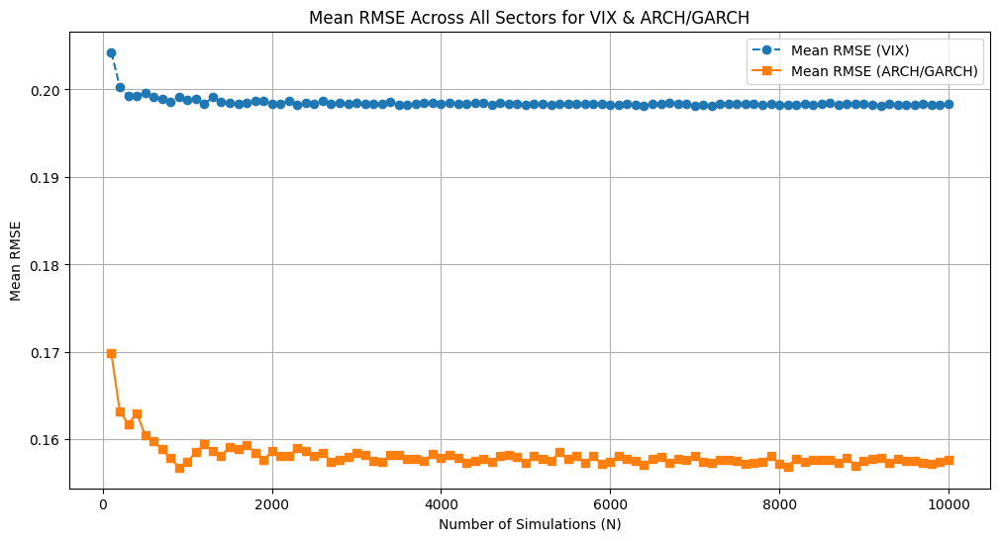

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import pickle  # For saving the dictionary

# Define the S&P 500 sector dictionary
sp500_dict = {
    "Technology": ["AAPL", "ACN", "AVGO", "CRM", "DELL", "FFIV", "MSFT", "NVDA", "TRMB"],
    "Healthcare": ["ABBV", "ABT", "CNC", "COR", "ISRG", "LLY", "NewDXCM", "PFE", "UNH"],
    "Financial": ["NewBAC", "BEN", "CFG", "GS", "JPM", "NewIVZ", "NewV", "NewWFC"],
    "Consumer Discretionary": ["AMZN", "ABNB", "BWA", "HD", "MGM", "NKE", "TSLA", "WYNN"],
    "Energy": ["MPC", "NewAPA", "NewEOG", "OXY", "PSX", "SLB", "WMB"],
    "Industrials": ["BLDR", "CAT", "CHRW", "GE", "PAYC", "RTX", "UBER", "UNP"],
    "Utilities": ["CEG", "SO", "ED", "CNP", "AES", "AEP"],
    "Real Estate": ["ARE", "CBRE", "DLR", "EQR", "IRM", "PLD", "SPG", "VTR"],
    "Consumer Staples": ["CL", "DG", "HSY", "KO", "NewWMT", "PG", "SYY", "TGT"],
    "Materials": ["CF", "BALL", "DD", "FCX", "FMC", "LIN", "VMC"],
    "Communication Services": ["GOOG", "FOX", "GOOGL", "META", "NewDIS", "NFLX", "TMUS", "TTWO"]
}

# Define the number of Monte Carlo simulations
Ns = np.linspace(100, 10000, num=100, dtype=int)

# Dictionary to store errors for each sector
sector_errors = {}

# Loop through each sector
for sector in sp500_dict.keys():
    vix_errors = []  # Store RMSE values for VIX
    arch_garch_errors = []  # Store RMSE values for ARCH/GARCH

    main_df = globals()[f"df_main_{sector.replace(' ', '')}"]  # Get main DataFrame
    other_df = globals()[f"df_other_{sector.replace(' ', '')}"]  # Get other DataFrame
    BS_VIX_sector = globals()[f"BS_VIX_{sector.replace(' ', '')}"]  # Get Black-Scholes function for VIX
    BS_ARCH_GARCH_sector = globals()[f"BS_ARCH_GARCH_{sector.replace(' ', '')}"]  # Get Black-Scholes function for ARCH/GARCH

    print(f"Processing sector: {sector}")

    for N in Ns:
        print(f"Processing N = {N} for sector {sector}")

        # Run Monte Carlo Simulation for VIX
        MC_VIX = MC(sector, main_df, other_df, BS_VIX_sector, 'VIX', N)
        MC_VIX_rmses = RMSE(sector, main_df,other_df, MC_VIX, 'Monte_Carlo_VIX')

        # Compute average RMSE for VIX
        avg_error_vix = np.mean(MC_VIX_rmses) if MC_VIX_rmses else 0
        vix_errors.append(avg_error_vix)

        # Run Monte Carlo Simulation for ARCH/GARCH
        MC_ARCH_GARCH = MC(sector, main_df, other_df, BS_ARCH_GARCH_sector, 'ARCH/GARCH', N)
        MC_ARCH_GARCH_rmses = RMSE(sector, main_df,other_df, MC_ARCH_GARCH, 'Monte_Carlo_ARCH/GARCH')

        # Compute average RMSE for ARCH/GARCH
        avg_error_arch_garch = np.mean(MC_ARCH_GARCH_rmses) if MC_ARCH_GARCH_rmses else 0
        arch_garch_errors.append(avg_error_arch_garch)

    # Store results in the dictionary
    sector_errors[sector] = {"VIX": vix_errors, "ARCH/GARCH": arch_garch_errors}

# Save the sector_errors dictionary
save_path = "/content/drive/My Drive/MSci Project/Saved Dataframes/sector_errors.pkl"
with open(save_path, "wb") as f:
    pickle.dump(sector_errors, f)

print(f"Sector errors dictionary saved successfully at: {save_path}")

# Plot mean RMSE across all sectors
mean_vix_errors = np.mean([sector_errors[s]["VIX"] for s in sector_errors], axis=0)
mean_arch_garch_errors = np.mean([sector_errors[s]["ARCH/GARCH"] for s in sector_errors], axis=0)

plt.figure(figsize=(12, 6))
plt.plot(Ns, mean_vix_errors, label="Mean RMSE (VIX)", linestyle="--", marker="o")
plt.plot(Ns, mean_arch_garch_errors, label="Mean RMSE (ARCH/GARCH)", linestyle="-", marker="s")
plt.xlabel("Number of Simulations (N)")
plt.ylabel("Mean RMSE")
plt.title("Mean RMSE Across All Sectors for VIX & ARCH/GARCH")
plt.legend()
plt.grid(True)
plt.show()


In [ ]:
import pickle

# Save the sector_errors dictionary
with open("/content/drive/My Drive/MSci Project/Saved Dataframes/sector_errors.pkl", "wb") as f:
    pickle.dump(sector_errors, f)

print("Sector errors dictionary saved successfully!")

Sector errors dictionary saved successfully!


In [ ]:
import pickle
with open("/content/drive/My Drive/MSci Project/Saved Dataframes/sector_errors.pkl", "rb") as f:
    sector_errors = pickle.load(f)

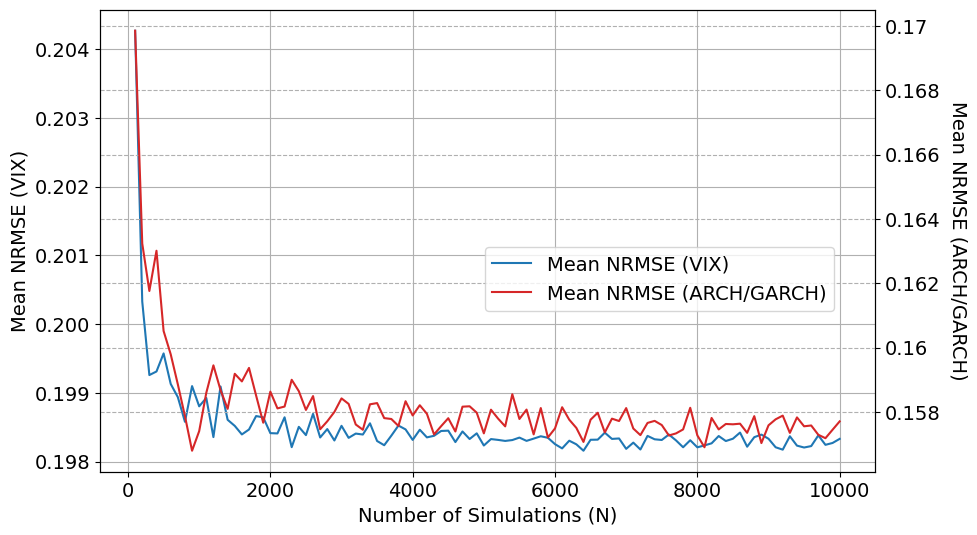

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator, FuncFormatter

# Global variables for font sizes
LEGEND_FONT_SIZE = 14
AXES_LABEL_FONT_SIZE = 14
TITLE_FONT_SIZE = 16
Ns = np.linspace(100, 10000, num=100, dtype=int)
mean_vix_errors = np.mean([sector_errors[s]["VIX"] for s in sector_errors], axis=0)
mean_arch_garch_errors = np.mean([sector_errors[s]["ARCH/GARCH"] for s in sector_errors], axis=0)
# Assuming 'Ns', 'mean_vix_errors', and 'mean_arch_garch_errors' are already defined

# Create a figure and a set of axes
fig, ax1 = plt.subplots(figsize=(10, 6))

# Plot VIX errors on the first y-axis
line_vix, = ax1.plot(Ns, mean_vix_errors, label="Mean NRMSE (VIX)", linestyle="-", color='tab:blue')
ax1.set_xlabel("Number of Simulations (N)", fontsize=AXES_LABEL_FONT_SIZE)
ax1.set_ylabel("Mean NRMSE (VIX)", fontsize=AXES_LABEL_FONT_SIZE)
ax1.tick_params(axis='y', labelsize=AXES_LABEL_FONT_SIZE)
ax1.tick_params(axis='x', labelsize=AXES_LABEL_FONT_SIZE)
# Create a second y-axis that shares the same x-axis
ax2 = ax1.twinx()

# Plot ARCH/GARCH errors on the second y-axis
line_arch_garch, = ax2.plot(Ns, mean_arch_garch_errors, label="Mean NRMSE (ARCH/GARCH)", linestyle="-", color='tab:red')
ax2.set_ylabel("Mean NRMSE (ARCH/GARCH)", fontsize=AXES_LABEL_FONT_SIZE)
ax2.tick_params(axis='y', labelsize=AXES_LABEL_FONT_SIZE)

# Rotate the second y-axis label
ax2.yaxis.set_label_coords(1.12, 0.5)  # Move the label a bit to the right
ax2.get_yaxis().label.set_rotation(270)  # Rotate the label by 90 degrees

def format_sf(x, pos):
    return f"{x:.3g}"  # Change 2 to the desired number of significant figures (e.g., 2)

# Apply the custom formatter to the right y-axis
ax2.yaxis.set_major_formatter(FuncFormatter(format_sf))

# Title and grid
#plt.title("Mean NRMSE Across All Sectors for different Ns", fontsize=TITLE_FONT_SIZE)
ax1.grid(True)
ax2.grid(True,linestyle="--")

# Combine the legends of both axes into one legend
fig.legend([line_vix, line_arch_garch], ['Mean NRMSE (VIX)', 'Mean NRMSE (ARCH/GARCH)'], loc='upper left', bbox_to_anchor=(0.5, 0.5), fontsize=LEGEND_FONT_SIZE)

# Show the plot
plt.show()


# **Black-Scholes vs Binomial vs Monte Carlo**

In [ ]:
array_list=[BS_VIX_rmses_array,BS_ARCH_GARCH_rmses_array,Binomial_VIX_rmses_array,Binomial_ARCH_GARCH_rmses_array,MC_VIX_rmses_array,MC_ARCH_GARCH_rmses_array,Heston_rmses_array]
for array in array_list:
  for rmses in array:
    every_rmse=[]
    for rmse in rmses:
      every_rmse.append(rmse)
  mean=np.mean(every_rmse)
  std=np.std(every_rmse)
  print("Mean error for method "+str(mean)+"±"+str(std))

Mean error for method 0.21142396286462525±0.09610553668529485
Mean error for method 0.1137600268208936±0.054674572725555794
Mean error for method 0.21156491337621816±0.09623457704036768
Mean error for method 0.11451268223292643±0.05550705319150346
Mean error for method 0.21138036981730238±0.09623617410277105
Mean error for method 0.11533414379267264±0.05695823205788182
Mean error for method 0.06510165965069536±0.044862324041512636


In [ ]:
other_list=[df_other_CommunicationServices, df_other_ConsumerDiscretionary,df_other_ConsumerStaples, df_other_Energy,df_other_Financial,df_other_Healthcare, df_other_Industrials, df_other_Materials, df_other_RealEstate, df_other_Technology, df_other_Utilities]
other_list_names=["Communication Services", "Consumer Discretionary", "Consumer Staples", "Energy", "Financial", "Healthcare", "Industrials", "Materials", "Real Estate", "Technology", "Utilities"]

In [ ]:
for i in range(len(other_list)):
  sector=other_list[i]
  sector_name=other_list_names[i]
  ticker_list=return_tickers(sector_name)
  avg=0
  for ticker in ticker_list:
    beta=sector.loc[sector['Ticker'] == ticker, 'Beta'].values[0]
    #print(ticker,beta)
    avg+=beta
  avg=avg/len(ticker_list)
  print("Average beta for "+sector_name+" is "+str(avg))

Average beta for Communication Services is 0.82425
Average beta for Consumer Discretionary is 1.02525
Average beta for Consumer Staples is 0.465125
Average beta for Energy is 0.6827142857142857
Average beta for Financial is 0.756125
Average beta for Healthcare is 0.5951111111111111
Average beta for Industrials is 0.880625
Average beta for Materials is 0.7042857142857143
Average beta for Real Estate is 0.780125
Average beta for Technology is 1.4379999999999997
Average beta for Utilities is 0.6285000000000001


In [ ]:
main_list = [
    df_main_CommunicationServices,
    df_main_ConsumerDiscretionary,
    df_main_ConsumerStaples,
    df_main_Energy,
    df_main_Financial,
    df_main_Healthcare,
    df_main_Industrials,
    df_main_Materials,df_main_RealEstate,df_main_Technology,df_main_Utilities]

In [ ]:
for i in range(len(main_list)):
  main_data=main_list[i]

  other_data=other_list[i]
  sector_name=other_list_names[i]
  ticker_list=return_tickers(sector_name)
  filtered_dates = main_data[(main_data['Date'] >= start_date) & (main_data['Date'] <= end_date)]['Date'].tolist()

  #print(main_data)
  #print(ticker_list)
  #Loop through all the tickers
  for ticker in ticker_list:
    #Get strike price of option
    K=other_data.loc[other_data['Ticker'] == ticker, 'Strike'].values[0]

    #Loop through dates from list of dates obtained earlier
    count=0
    for date in filtered_dates:
      if pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_stock']).any() or pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_option']).any():
        continue
      S=main_data.loc[main_data['Date'] == date, ticker+'_stock'].values[0]
      if S<(K*0.9):
        count+=1
    if count>30:
      print(ticker)



TSLA
DG
GS
NewWFC
CRM
AES


# **Everythind vs**

In [ ]:
array_list=[BS_VIX_rmses_array,BS_ARCH_GARCH_rmses_array,Binomial_VIX_rmses_array,Binomial_ARCH_GARCH_rmses_array,MC_VIX_rmses_array,MC_ARCH_GARCH_rmses_array,Heston_rmses_array,GB_rmses_array,RNN_rmses_array,IRNN_rmses_array,IGB_rmses_array]

count=0
methods=["Black-Scholes with VIX","Black-Scholes with ARCH/GARCH","Binomial with VIX","Binomial with ARCH/GARCH","Monte Carlo with VIX","Monte Carlo with ARCH/GARCH","Heston","GB","RNN","IRNN","IGB"]
for array in array_list:
  #print(array)
  every_rmse=[]
  for rmses in array:
    #print(len(rmses))
    for rmse in rmses:
      every_rmse.append(rmse)
  #print(len(every_rmse))
  mean=np.mean(every_rmse)
  std=np.std(every_rmse)/np.sqrt(len(array_list))
  print("Mean error for",methods[count],"="+str(mean)+"±"+str(std))
  count+=1

Mean error for Black-Scholes with VIX =0.19747162743493754±0.03488578776632812
Mean error for Black-Scholes with ARCH/GARCH =0.16014101929040764±0.03548717973997311
Mean error for Binomial with VIX =0.19741398941820495±0.03493665376218974
Mean error for Binomial with ARCH/GARCH =0.16046527696658489±0.035687446269500066
Mean error for Monte Carlo with VIX =0.1974732057700189±0.034842359868965715
Mean error for Monte Carlo with ARCH/GARCH =0.16065296808482474±0.03548394668338853
Mean error for Heston =0.056747711521259514±0.017514070634981997
Mean error for GB =0.04871193818946696±0.014387103636669339
Mean error for RNN =0.05273248081252663±0.01576463264393174
Mean error for IRNN =0.0504415843693967±0.013933001237743424
Mean error for IGB =0.04373322808273405±0.014192807811256133


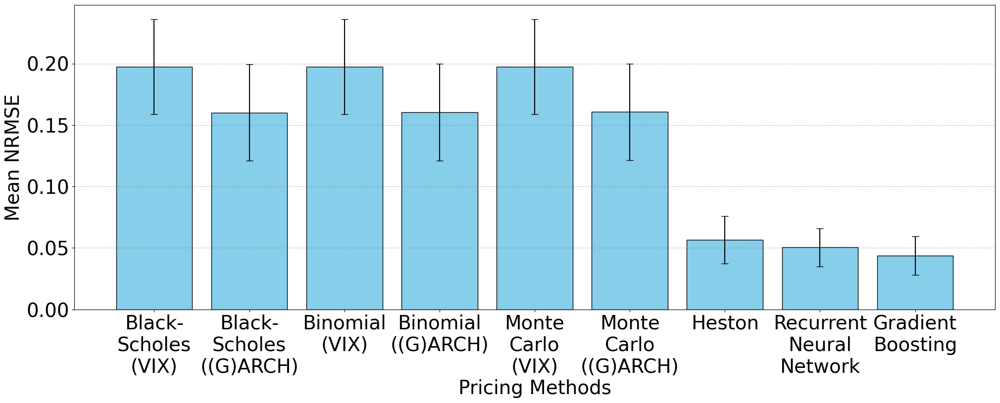

In [ ]:
import textwrap

array_list = [
    BS_VIX_rmses_array, BS_ARCH_GARCH_rmses_array, Binomial_VIX_rmses_array, Binomial_ARCH_GARCH_rmses_array,
    MC_VIX_rmses_array, MC_ARCH_GARCH_rmses_array, Heston_rmses_array, IRNN_rmses_array,IGB_rmses_array
]

methods = [
    "Black-Scholes (VIX)", "Black-Scholes ((G)ARCH)", "Binomial (VIX)", "Binomial ((G)ARCH)",
    "Monte Carlo (VIX)", "Monte Carlo ((G)ARCH)", "Heston",  "Recurrent Neural Network","Gradient Boosting"
]

mean_errors = []
std_devs = []

# Calculate mean and standard deviation for each method
for array in array_list:
    every_rmse = []
    for rmses in array:
        every_rmse.extend(rmses)  # Flatten the nested lists
    mean = np.mean(every_rmse)
    std = np.std(every_rmse)
    mean_errors.append(mean)
    std_devs.append(std)
std_devs=np.array(std_devs)
std_devs=std_devs/np.sqrt(len(array_list))
# Wrap long method names into multiple lines
wrapped_methods = [textwrap.fill(label, width=10) for label in methods]  # Adjust width as needed

# Plot the bar chart
plt.figure(figsize=(24, 8))
plt.bar(wrapped_methods, mean_errors, yerr=std_devs, capsize=5, color='skyblue', edgecolor='black')
x1=28
plt.grid(True, axis='y', color='gray', linestyle='--', alpha=0.5)
plt.xlabel("Pricing Methods", fontsize=x1)
plt.ylabel("Mean NRMSE", fontsize=x1)
#plt.title("Mean NRMSE for Different Option Pricing Methods", fontsize=x1)
plt.xticks(rotation=0, fontsize=x1)  # Keep labels horizontal
plt.yticks(fontsize=x1)
# Show the plot
plt.show()


# **Plots for the Poster/VIVA**

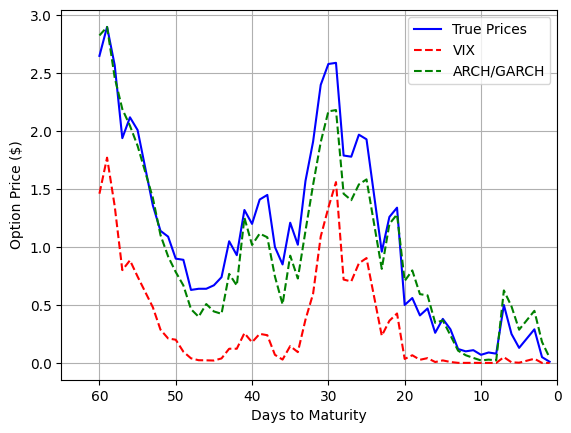

<Figure size 1000x600 with 0 Axes>

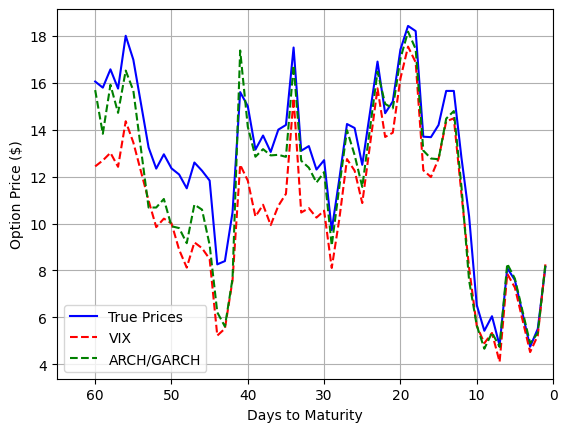

<Figure size 1000x600 with 0 Axes>

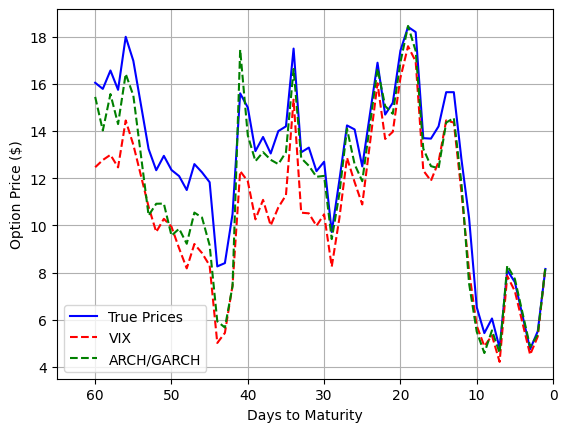

<Figure size 1000x600 with 0 Axes>

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# Global variables for font sizes
TITLE_FONT_SIZE = 10
LABEL_FONT_SIZE = 10
TICK_FONT_SIZE = 10
LEGEND_FONT_SIZE = 10


BS_VIX_array = [BS_VIX_CommunicationServices, BS_VIX_ConsumerDiscretionary, BS_VIX_ConsumerStaples, BS_VIX_Energy, BS_VIX_Financial, BS_VIX_Healthcare, BS_VIX_Industrials, BS_VIX_Materials, BS_VIX_RealEstate, BS_VIX_Technology, BS_VIX_Utilities]
BS_AG_array = [BS_ARCH_GARCH_CommunicationServices, BS_ARCH_GARCH_ConsumerDiscretionary, BS_ARCH_GARCH_ConsumerStaples, BS_ARCH_GARCH_Energy, BS_ARCH_GARCH_Financial, BS_ARCH_GARCH_Healthcare, BS_ARCH_GARCH_Industrials, BS_ARCH_GARCH_Materials, BS_ARCH_GARCH_RealEstate, BS_ARCH_GARCH_Technology, BS_ARCH_GARCH_Utilities]
Binomial_VIX_array = [Binomial_VIX_CommunicationServices, Binomial_VIX_ConsumerDiscretionary, Binomial_VIX_ConsumerStaples, Binomial_VIX_Energy, Binomial_VIX_Financial, Binomial_VIX_Healthcare, Binomial_VIX_Industrials, Binomial_VIX_Materials, Binomial_VIX_RealEstate, Binomial_VIX_Technology, Binomial_VIX_Utilities]
Binomial_AG_array = [Binomial_ARCH_GARCH_CommunicationServices, Binomial_ARCH_GARCH_ConsumerDiscretionary, Binomial_ARCH_GARCH_ConsumerStaples, Binomial_ARCH_GARCH_Energy, Binomial_ARCH_GARCH_Financial, Binomial_ARCH_GARCH_Healthcare, Binomial_ARCH_GARCH_Industrials, Binomial_ARCH_GARCH_Materials, Binomial_ARCH_GARCH_RealEstate, Binomial_ARCH_GARCH_Technology, Binomial_ARCH_GARCH_Utilities]
MC_VIX_array = [MC_VIX_CommunicationServices, MC_VIX_ConsumerDiscretionary, MC_VIX_ConsumerStaples, MC_VIX_Energy, MC_VIX_Financial, MC_VIX_Healthcare, MC_VIX_Industrials, MC_VIX_Materials, MC_VIX_RealEstate, MC_VIX_Technology, MC_VIX_Utilities]
MC_AG_array = [MC_ARCH_GARCH_CommunicationServices, MC_ARCH_GARCH_ConsumerDiscretionary, MC_ARCH_GARCH_ConsumerStaples, MC_ARCH_GARCH_Energy, MC_ARCH_GARCH_Financial, MC_ARCH_GARCH_Healthcare, MC_ARCH_GARCH_Industrials, MC_ARCH_GARCH_Materials, MC_ARCH_GARCH_RealEstate, MC_ARCH_GARCH_Technology, MC_ARCH_GARCH_Utilities]

indexes = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]

def VIX_vs_AG(Sector, ticker, method):
    ticker_list = [ticker]
    index = sector_list.index(Sector)
    i = index
    main_data = main_list[i]
    other_data = other_list[i]
    filtered_dates = main_data[(main_data['Date'] >= start_date) & (main_data['Date'] <= end_date)]['Date'].tolist()

    if method == 'Black Scholes':
        VIX_array = BS_VIX_array[index]
        AG_array = BS_AG_array[index]
        new_method_V = '_VIX_option'
        new_method_AG = '_ARCH/GARCH_option'
    elif method == 'Binomial':
        VIX_array = Binomial_VIX_array[index]
        AG_array = Binomial_AG_array[index]
        new_method_V = '_Binomial_VIX_option'
        new_method_AG = '_Binomial_ARCH/GARCH_option'
        method = 'Binomial (n=20)'
    else:
        VIX_array = MC_VIX_array[index]
        AG_array = MC_AG_array[index]
        new_method_V = '_Monte_Carlo_VIX_option'
        new_method_AG = '_Monte_Carlo_ARCH/GARCH_option'

    for ticker in ticker_list:
        days_to_maturity = []
        VIX_prices = []
        AG_prices = []
        true_prices = []
        expiry = other_data.loc[other_data['Ticker'] == ticker, 'Expirations'].values[0]

        for date in filtered_dates:
            tau = np.busday_count(date.date(), pd.Timestamp(expiry).date())
            if pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_stock']).any() or pd.isna(main_data.loc[main_data['Date'] == date, ticker+'_option']).any() or tau <= 0:
                continue
            days_to_maturity.append(tau)
            VIX_prices.append(VIX_array.loc[VIX_array['Date'] == date, ticker + new_method_V].values[0])
            AG_prices.append(AG_array.loc[AG_array['Date'] == date, ticker + new_method_AG].values[0])
            true_prices.append(main_data.loc[main_data['Date'] == date, ticker + "_option"].values[0])

        plt.grid(True)
        # Plotting with font size adjustments
        plt.plot(days_to_maturity, true_prices, label='True Prices', color='blue')
        plt.plot(days_to_maturity, VIX_prices, label='VIX', color="red", linestyle='dashed')
        plt.plot(days_to_maturity, AG_prices, label='ARCH/GARCH', color="green", linestyle='dashed')


        #plt.title(f"VIX vs ARCH/GARCH vs True Prices using {method} for {ticker}", fontsize=TITLE_FONT_SIZE)
        plt.xlabel('Days to Maturity', fontsize=LABEL_FONT_SIZE)
        plt.ylabel('Option Price ($)', fontsize=LABEL_FONT_SIZE)
        plt.xlim(65, 0)
        # Adjust tick font size
        plt.xticks(fontsize=TICK_FONT_SIZE)
        plt.yticks(fontsize=TICK_FONT_SIZE)

        plt.legend(fontsize=LEGEND_FONT_SIZE)
        plt.figure(figsize=(10, 6))
        plt.show()

# Call the function with desired method and tickers
VIX_vs_AG('Energy', 'SLB', 'Black Scholes')
VIX_vs_AG('Technology', 'AAPL', 'Binomial')
VIX_vs_AG('Technology', 'AAPL', 'Monte Carlo')


**Heston Single Plot**

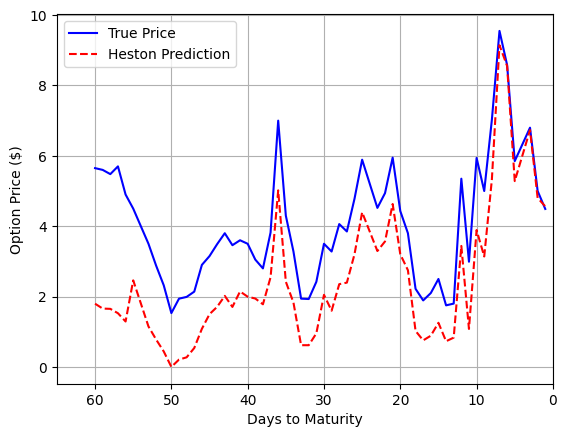

<Figure size 1000x600 with 0 Axes>

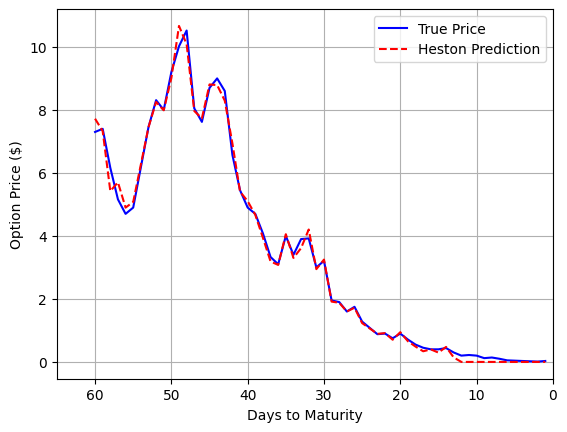

<Figure size 1000x600 with 0 Axes>

In [ ]:
def Heston_Comparison(Sector,ticker,Heston_data):
  ticker_list=[ticker]
  index=sector_list.index(Sector)
  i=index
  main_data=main_list[i]
  other_data=other_list[i]
  filtered_dates = main_data[(main_data['Date'] >= start_date) & (main_data['Date'] <= end_date)]['Date'].tolist()
  #print(VIX_array)
  #print(AG_array)
  for ticker in ticker_list:
    days_to_maturity=[]
    #VIX_prices=[]
    #AG_prices=[]
    true_prices = []
    Heston_prices=[]
    expiry=other_data.loc[other_data['Ticker'] == ticker, 'Expirations'].values[0]

    for date in filtered_dates:
      tau=np.busday_count(date.date(), pd.Timestamp(expiry).date())
      if pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_stock']).any() or pd.isna(main_data.loc[main_data['Date'] == date, ticker+'_option']).any() or tau<=0:
         continue
      days_to_maturity.append(tau)
      #VIX_prices.append(VIX_array.loc[VIX_array['Date'] == date, ticker+new_method_V].values[0])
      #AG_prices.append(AG_array.loc[AG_array['Date'] == date, ticker+new_method_AG].values[0])
      true_prices.append(main_data.loc[main_data['Date'] == date, ticker+"_option"].values[0])
      Heston_prices.append(Heston_data.loc[Heston_data['Date'] == date, ticker+"_Heston_option"].values[0])

    #plt.plot(days_to_maturity, VIX_prices, label='VIX',color="red", linestyle='dashed')
    #plt.plot(days_to_maturity, AG_prices, label='ARCH/GARCH',color="green", linestyle='dashed')
    plt.grid(True)
    plt.plot(days_to_maturity, true_prices,label='True Price', color='blue')#,linestyle="--")
    plt.plot(days_to_maturity, Heston_prices,label='Heston Prediction', color='red',linestyle="--")
    #plt.title("Predicted Prices vs True Prices using Heston for "+ticker)
    plt.xlabel('Days to Maturity',fontsize=10)
    plt.xlim(65,0)
    plt.ylabel('Option Price ($)',fontsize=10)
    plt.legend(fontsize=10)

    plt.figure(figsize=(10, 6))
    plt.show()
Heston_Comparison('Technology','DELL',Heston_Technology)
Heston_Comparison('Consumer Staples','HSY',Heston_ConsumerStaples)

**ML Single Plots**

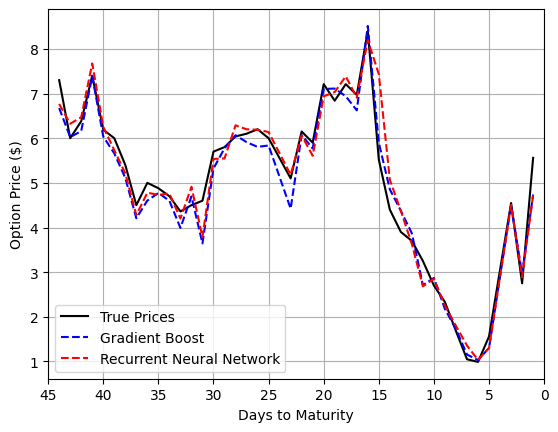

<Figure size 2000x600 with 0 Axes>

In [ ]:
def ML_Comparison(Sector,ticker,GB_data,RNN_data):
  ticker_list=[ticker]
  index=sector_list.index(Sector)
  i=index
  main_data=main_list[i]
  other_data=other_list[i]
  filtered_dates = main_data[(main_data['Date'] >= '2024-09-16') & (main_data['Date'] <= end_date)]['Date'].tolist()
  #print(VIX_array)
  #print(AG_array)
  for ticker in ticker_list:
    days_to_maturity=[]
    #VIX_prices=[]
    #AG_prices=[]
    true_prices = []
    GB_prices=[]
    RNN_prices=[]
    expiry=other_data.loc[other_data['Ticker'] == ticker, 'Expirations'].values[0]

    for date in filtered_dates:
      tau=np.busday_count(date.date(), pd.Timestamp(expiry).date())
      if pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_stock']).any() or pd.isna(main_data.loc[main_data['Date'] == date, ticker+'_option']).any() or tau<=0 or pd.isna(GB_data.loc[GB_data['Date'] == date, ticker+'_ML_option']).any():
         continue
      days_to_maturity.append(tau)
      #VIX_prices.append(VIX_array.loc[VIX_array['Date'] == date, ticker+new_method_V].values[0])
      #AG_prices.append(AG_array.loc[AG_array['Date'] == date, ticker+new_method_AG].values[0])
      true_prices.append(main_data.loc[main_data['Date'] == date, ticker+"_option"].values[0])
      GB_prices.append(GB_data.loc[GB_data['Date'] == date, ticker+"_ML_option"].values[0])
      RNN_prices.append(RNN_data.loc[RNN_data['Date'] == date, ticker+"_ML_option"].values[0])

    #plt.plot(days_to_maturity, VIX_prices, label='VIX',color="red", linestyle='dashed')
    #plt.plot(days_to_maturity, AG_prices, label='ARCH/GARCH',color="green", linestyle='dashed')
    plt.grid(True)
    plt.plot(days_to_maturity, true_prices,label='True Prices', color='black',linestyle="-")
    plt.plot(days_to_maturity, GB_prices,label='Gradient Boost', color='blue',linestyle="--")
    plt.plot(days_to_maturity, RNN_prices,label='Recurrent Neural Network', color='red',linestyle="--")
    #plt.title("Predicted Prices vs True Prices using Machine Learning for "+ticker)
    plt.xlabel('Days to Maturity')
    plt.xlim(45,0)
    plt.ylabel('Option Price ($)')
    plt.legend(loc="best")

    plt.figure(figsize=(20, 6))
    plt.show()
ML_Comparison('Healthcare','NewDXCM',IGB_Healthcare,IRNN_Healthcare)

**Everything Plot**

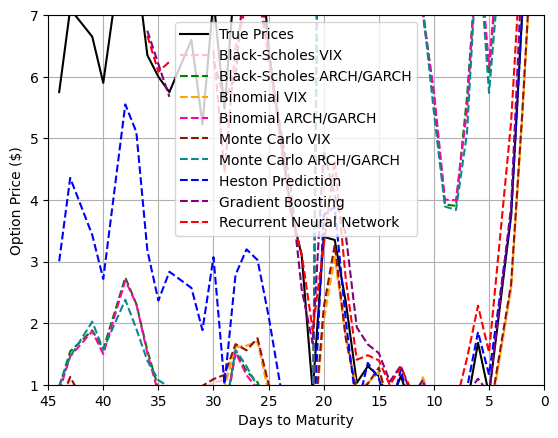

<Figure size 1000x600 with 0 Axes>

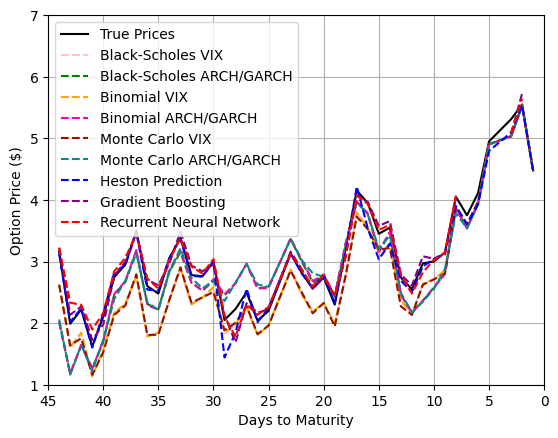

<Figure size 1000x600 with 0 Axes>

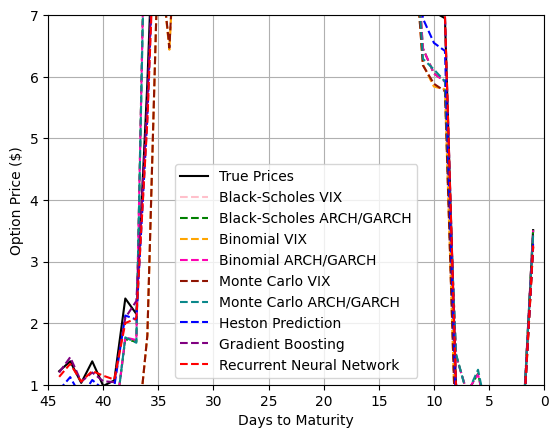

<Figure size 1000x600 with 0 Axes>

In [ ]:
def ML_Comparison(Sector,ticker,BS_VIX_data,BS_AG_data,Binomial_VIX_data,Binomial_AG_data,MC_VIX_data,MC_AG_data,Heston_data,GB_data,RNN_data):
  ticker_list=[ticker]
  index=sector_list.index(Sector)
  i=index
  main_data=main_list[i]
  other_data=other_list[i]
  filtered_dates = main_data[(main_data['Date'] >= '2024-09-16') & (main_data['Date'] <= end_date)]['Date'].tolist()
  #print(VIX_array)
  #print(AG_array)
  for ticker in ticker_list:
    days_to_maturity=[]
    #VIX_prices=[]
    #AG_prices=[]
    true_prices = []
    BS_VIX=[]
    BS_AG=[]
    Binomial_VIX=[]
    Binomial_AG=[]
    MC_VIX=[]
    MC_AG=[]
    Heston_prices=[]
    GB_prices=[]
    RNN_prices=[]
    expiry=other_data.loc[other_data['Ticker'] == ticker, 'Expirations'].values[0]

    for date in filtered_dates:
      tau=np.busday_count(date.date(), pd.Timestamp(expiry).date())
      if pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_stock']).any() or pd.isna(main_data.loc[main_data['Date'] == date, ticker+'_option']).any() or tau<=0: #or pd.isna(GB_data.loc[GB_data['Date'] == date, ticker+'_ML_option']).any():
         continue
      days_to_maturity.append(tau)
      BS_VIX.append(BS_VIX_data.loc[BS_VIX_data['Date'] == date, ticker+"_VIX_option"].values[0])
      BS_AG.append(BS_AG_data.loc[BS_AG_data['Date'] == date, ticker+"_ARCH/GARCH_option"].values[0])
      Binomial_VIX.append(Binomial_VIX_data.loc[Binomial_VIX_data['Date'] == date, ticker+"_Binomial_VIX_option"].values[0])
      Binomial_AG.append(Binomial_AG_data.loc[Binomial_AG_data['Date'] == date, ticker+"_Binomial_ARCH/GARCH_option"].values[0])
      MC_VIX.append(MC_VIX_data.loc[MC_VIX_data['Date'] == date, ticker+"_Monte_Carlo_VIX_option"].values[0])
      MC_AG.append(MC_AG_data.loc[MC_AG_data['Date'] == date, ticker+"_Monte_Carlo_ARCH/GARCH_option"].values[0])
      true_prices.append(main_data.loc[main_data['Date'] == date, ticker+"_option"].values[0])
      Heston_prices.append(Heston_data.loc[Heston_data['Date'] == date, ticker+"_Heston_option"].values[0])
      GB_prices.append(GB_data.loc[GB_data['Date'] == date, ticker+"_ML_option"].values[0])
      RNN_prices.append(RNN_data.loc[RNN_data['Date'] == date, ticker+"_ML_option"].values[0])

    #plt.plot(days_to_maturity, VIX_prices, label='VIX',color="red", linestyle='dashed')
    #plt.plot(days_to_maturity, AG_prices, label='ARCH/GARCH',color="green", linestyle='dashed')
    plt.grid(True)
    plt.plot(days_to_maturity, true_prices,label='True Prices', color='black',linestyle="-")
    plt.plot(days_to_maturity, BS_VIX,label='Black-Scholes VIX', color='pink',linestyle="--")
    plt.plot(days_to_maturity, BS_AG,label='Black-Scholes ARCH/GARCH', color='green',linestyle="--")
    plt.plot(days_to_maturity, Binomial_VIX,label='Binomial VIX', color='orange',linestyle="--")
    plt.plot(days_to_maturity, Binomial_AG,label='Binomial ARCH/GARCH', color="#fe01b1",linestyle="--")
    plt.plot(days_to_maturity, MC_VIX,label='Monte Carlo VIX', color='#8f1402',linestyle="--")
    plt.plot(days_to_maturity, MC_AG,label='Monte Carlo ARCH/GARCH', color='#0a888a',linestyle="--")
    plt.plot(days_to_maturity, Heston_prices,label='Heston Prediction', color='blue',linestyle="--")
    plt.plot(days_to_maturity, GB_prices,label='Gradient Boosting', color='purple',linestyle="--")
    plt.plot(days_to_maturity, RNN_prices,label='Recurrent Neural Network', color='red',linestyle="--")
    #plt.title("Predicted Prices vs True Prices for "+ticker)
    plt.xlabel('Days to Maturity', fontsize=10)
    plt.xlim(45,0)
    plt.ylim(1,7)
    plt.ylabel('Option Price ($)', fontsize=10)
    #plt.legend(loc=(0.005,0.7), fontsize=10, ncol=2)
    plt.legend(loc="best", fontsize=10, ncol=1)
    plt.xticks(fontsize=10)
    plt.yticks(fontsize=10)

    plt.figure(figsize=(10, 6))
    #plt.figure(figsize=(20, 6))
    plt.show()
ML_Comparison('Communication Services','NFLX',BS_VIX_CommunicationServices,BS_ARCH_GARCH_CommunicationServices,Binomial_VIX_CommunicationServices,Binomial_ARCH_GARCH_CommunicationServices,MC_VIX_CommunicationServices,MC_ARCH_GARCH_CommunicationServices,Heston_CommunicationServices,IGB_CommunicationServices,IRNN_CommunicationServices)
ML_Comparison('Consumer Staples','NewWMT',BS_VIX_ConsumerStaples,BS_ARCH_GARCH_ConsumerStaples,Binomial_VIX_ConsumerStaples,Binomial_ARCH_GARCH_ConsumerStaples,MC_VIX_ConsumerStaples,MC_ARCH_GARCH_ConsumerStaples,Heston_ConsumerStaples,IGB_ConsumerStaples,IRNN_ConsumerStaples)
ML_Comparison('Consumer Discretionary','WYNN',BS_VIX_ConsumerDiscretionary,BS_ARCH_GARCH_ConsumerDiscretionary,Binomial_VIX_ConsumerDiscretionary,Binomial_ARCH_GARCH_ConsumerDiscretionary,MC_VIX_ConsumerDiscretionary,MC_ARCH_GARCH_ConsumerDiscretionary,Heston_ConsumerDiscretionary,IGB_ConsumerDiscretionary,IRNN_ConsumerDiscretionary)
#ML_Comparison('Energy','XOM',BS_VIX_Energy,BS_ARCH_GARCH_Energy,Binomial_VIX_Energy,Binomial_ARCH_GARCH_Energy,MC_VIX_Energy,MC_ARCH_GARCH_Energy,Heston_Energy,IGB_Energy,IRNN_Energy)
#ML_Comparison('Financial','JPM',BS_VIX_Financial,BS_ARCH_GARCH_Financial,Binomial_VIX_Financial,Binomial_ARCH_GARCH_Financial,MC_VIX_Financial,MC_ARCH_GARCH_Financial,Heston_Financial,IGB_Financial,IRNN_Financial)
#ML_Comparison('Healthcare,','UNH',BS_VIX_Healthcare,BS_ARCH_GARCH_Healthcare,Binomial_VIX_Healthcare,Binomial_ARCH_GARCH_Healthcare,MC_VIX_Healthcare,MC_ARCH_GARCH_Healthcare,Heston_Healthcare,IGB_Healthcare,IRNN_Healthcare)
#ML_Comparison('Industrials','CAT',BS_VIX_Industrials,BS_ARCH_GARCH_Industrials,Binomial_VIX_Industrials,Binomial_ARCH_GARCH_Industrials,MC_VIX_Industrials,MC_ARCH_GARCH_Industrials,Heston_Industrials,IGB_Industrials,IRNN_Industrials)
#ML_Comparison('Materials','LIN',BS_VIX_Materials,BS_ARCH_GARCH_Materials,Binomial_VIX_Materials,Binomial_ARCH_GARCH_Materials,MC_VIX_Materials,MC_ARCH_GARCH_Materials,Heston_Materials,IGB_Materials,IRNN_Materials)
#ML_Comparison('Real Estate','VTR',BS_VIX_RealEstate,BS_ARCH_GARCH_RealEstate,Binomial_VIX_RealEstate,Binomial_ARCH_GARCH_RealEstate,MC_VIX_RealEstate,MC_ARCH_GARCH_RealEstate,Heston_RealEstate,IGB_RealEstate,IRNN_RealEstate)
#ML_Comparison('Technology','NVDA',BS_VIX_Technology,BS_ARCH_GARCH_Technology,Binomial_VIX_Technology,Binomial_ARCH_GARCH_Technology,MC_VIX_Technology,MC_ARCH_GARCH_Technology,Heston_Technology,IGB_Technology,IRNN_Technology)
#ML_Comparison('Utilities','CNP',BS_VIX_Utilities,BS_ARCH_GARCH_Utilities,Binomial_VIX_Utilities,Binomial_ARCH_GARCH_Utilities,MC_VIX_Utilities,MC_ARCH_GARCH_Utilities,Heston_Utilities,IGB_Utilities,IRNN_Utilities)


**Log-Normal Distributions**

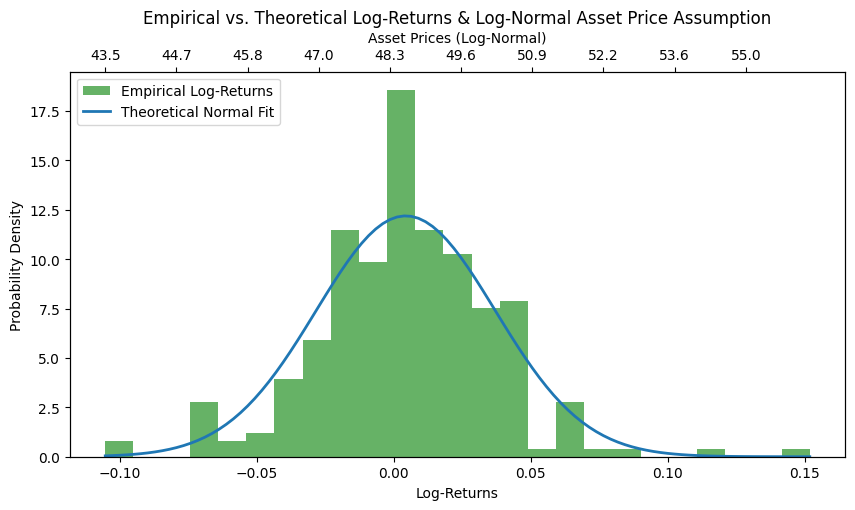

In [ ]:
ticker='NVDA'

# Load stock data (Modify the file path)
df_old= df_main_Technology[['Date',ticker+'_stock']]
df = df_old[[ticker+'_stock']].copy()
# Compute log-returns
df["Log_Returns"] = np.log(df[ticker+"_stock"] / df[ticker+"_stock"].shift(1))

# Drop NaN values
df = df.dropna()

# Estimate parameters from data
mu = df["Log_Returns"].mean()  # Mean of log-returns
sigma = df["Log_Returns"].std()  # Standard deviation (volatility)
S0 = df[ticker+"_stock"].iloc[0]  # Initial stock price

# Generate normal distribution based on historical parameters
log_returns = np.linspace(df["Log_Returns"].min(), df["Log_Returns"].max(), 100)
pdf_values = norm.pdf(log_returns, mu, sigma)

# Convert log-returns to log-normal asset prices
asset_prices = S0 * np.exp(log_returns)

# Plot empirical log-returns vs. normal distribution
fig, ax1 = plt.subplots(figsize=(10, 5))

color = 'tab:blue'
ax1.hist(df["Log_Returns"], bins=25, density=True, alpha=0.6, color="green", label="Empirical Log-Returns")
ax1.plot(log_returns, pdf_values, color=color, lw=2, label="Theoretical Normal Fit")
ax1.set_xlabel("Log-Returns")
ax1.set_ylabel("Probability Density")
ax1.legend(loc="upper left")

# Add secondary x-axis for log-normal price transformation

ax2 = ax1.twiny()
ax2.set_xlim(ax1.get_xlim())  # Match x-axis limits
ax2.set_xticks(log_returns[::10])
ax2.set_xticklabels([f"{p:.1f}" for p in asset_prices[::10]])
ax2.set_xlabel("Asset Prices (Log-Normal)")

plt.title("Empirical vs. Theoretical Log-Returns & Log-Normal Asset Price Assumption")
plt.show()


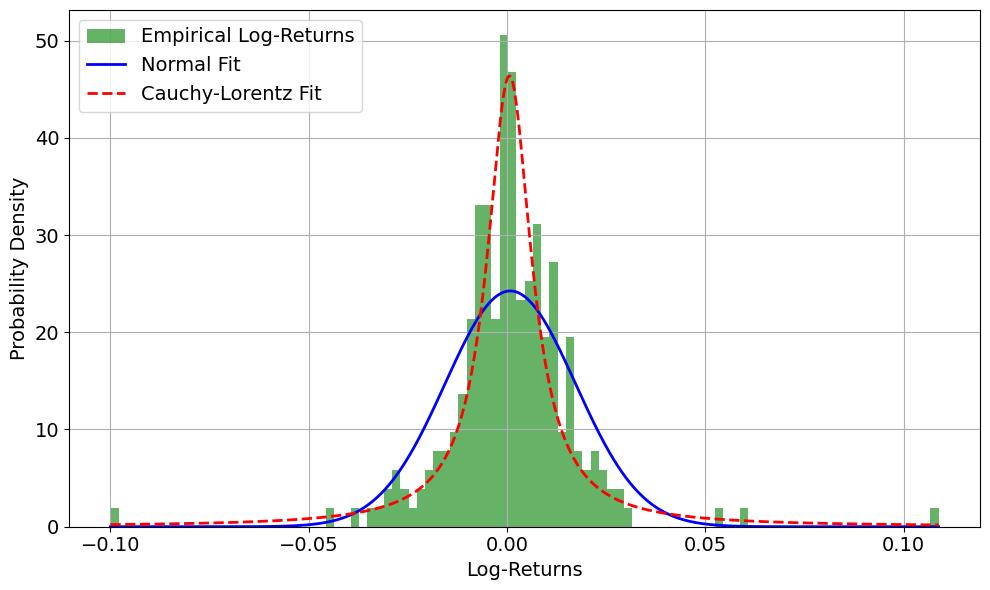

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.stats import norm, cauchy

ticker = 'NewDIS'

# Load stock data
#df_old = df_main_Technology[['Date', ticker + '_stock']]
df_old = df_main_CommunicationServices[['Date', ticker + '_stock']]
df = df_old[[ticker + '_stock']].copy()

# Compute log-returns
df["Log_Returns"] = np.log(df[ticker + "_stock"] / df[ticker + "_stock"].shift(1))
df = df.dropna()

# Fit normal distribution
mu = df["Log_Returns"].mean()
sigma = df["Log_Returns"].std()

# Fit Cauchy distribution
cauchy_loc, cauchy_scale = cauchy.fit(df["Log_Returns"])

# X-axis for PDFs
log_returns = np.linspace(df["Log_Returns"].min(), df["Log_Returns"].max(), 1000)
normal_pdf = norm.pdf(log_returns, mu, sigma)
cauchy_pdf = cauchy.pdf(log_returns, cauchy_loc, cauchy_scale)

# Plot

plt.figure(figsize=(10, 6))
plt.hist(df["Log_Returns"], bins=100, density=True, alpha=0.6, color="green", label="Empirical Log-Returns")
plt.plot(log_returns, normal_pdf, color='blue', lw=2, label="Normal Fit")
plt.plot(log_returns, cauchy_pdf, color='red', lw=2, linestyle='--', label="Cauchy-Lorentz Fit")
fs=14
plt.xlabel("Log-Returns",fontsize=fs)
plt.ylabel("Probability Density",fontsize=fs)
plt.xticks(fontsize=fs)
plt.yticks(fontsize=fs)
#plt.title("Empirical vs. Theoretical Log-Returns (Normal & Cauchy Fits)")
plt.legend(loc="upper left",fontsize=fs)
plt.tight_layout()
plt.grid(True)
plt.show()



<ipython-input-29-d00d0913269e>:14: FutureWarning: The default fill_method='pad' in Series.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.
  df["Daily_Returns"] = df[ticker + "_stock"].pct_change()


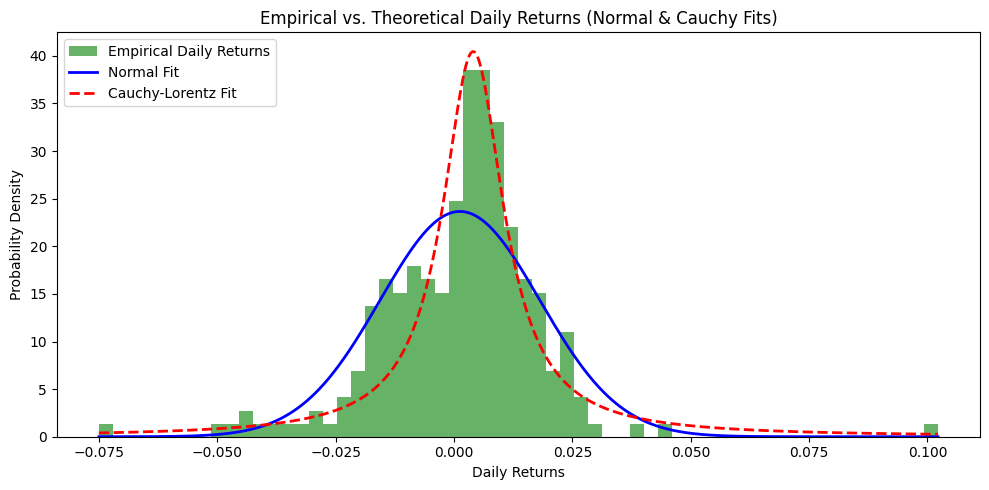

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.stats import norm, cauchy

ticker = 'GOOGL'

# Load stock data (modify as needed)
#df_old = df_main_Technology[['Date', ticker + '_stock']]
df_old = df_main_CommunicationServices[['Date', ticker + '_stock']]#
df = df_old[[ticker + '_stock']].copy()

# Calculate daily returns (percentage change)
df["Daily_Returns"] = df[ticker + "_stock"].pct_change()
df = df.dropna()

# Estimate parameters
mu, sigma = df["Daily_Returns"].mean(), df["Daily_Returns"].std()
cauchy_loc, cauchy_scale = cauchy.fit(df["Daily_Returns"])

# X-axis for PDFs
returns_range = np.linspace(df["Daily_Returns"].min(), df["Daily_Returns"].max(), 1000)

# PDFs
normal_pdf = norm.pdf(returns_range, mu, sigma)
cauchy_pdf = cauchy.pdf(returns_range, cauchy_loc, cauchy_scale)

# Plot
plt.figure(figsize=(10, 5))
plt.hist(df["Daily_Returns"], bins=60, density=True, alpha=0.6, color="green", label="Empirical Daily Returns")
plt.plot(returns_range, normal_pdf, color='blue', lw=2, label="Normal Fit")
plt.plot(returns_range, cauchy_pdf, color='red', lw=2, linestyle='--', label="Cauchy-Lorentz Fit")

plt.xlabel("Daily Returns")
plt.ylabel("Probability Density")
plt.title("Empirical vs. Theoretical Daily Returns (Normal & Cauchy Fits)")
plt.legend(loc="upper left")
plt.tight_layout()
plt.show()


**Binomial Stock Movement:**

Can possibly use one of our actual volatilities

2024-11-15 00:00:00


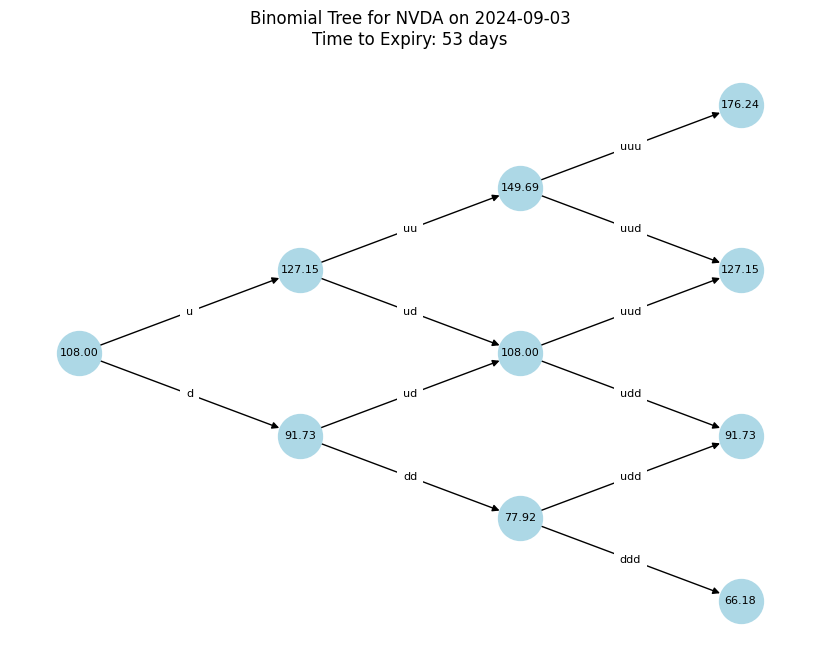

Date: 2024-09-03 | Time to Expiry: 0.29 years


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import networkx as nx
from datetime import datetime

ticker = 'NVDA'
sector = 'Technology'
index = sector_list.index(sector)

# Load stock data
stock_df = main_list[index][['Date', ticker+'_stock']]
rates_df = main_list[index][['Date', 'Rates']]

# Set the fixed expiration date
expiry_date = datetime.strptime("2024-11-15", "%Y-%m-%d")

# Merge stock data with risk-free rate data on Date
merged_df = pd.merge(stock_df, rates_df, on="Date", how="left")

# Compute time to expiry (T) for each row
merged_df["Time to Expiry"] = (expiry_date - merged_df["Date"]).dt.days / 252  # Convert to years

# Remove expired options (if any)
merged_df = merged_df[merged_df["Time to Expiry"] > 0]

# Estimate volatility from log returns
merged_df["Log Returns"] = np.log(merged_df[ticker+'_stock'] / merged_df[ticker+'_stock'].shift(1))
sigma = np.std(merged_df["Log Returns"].dropna()) * np.sqrt(252)  # Annualized volatility

# Number of time steps for the binomial tree
N = 3

# Manually select a row for a specific date (e.g., the first row)
selected_date = merged_df.iloc[180]  # Change this index to pick a different date
print(expiry_date)
days=np.busday_count(selected_date["Date"].date(), expiry_date.date())

# Extract relevant data for the selected date
current_date = selected_date["Date"]
time_to_expiry = selected_date["Time to Expiry"]
risk_free_rate = selected_date["Rates"]
S0 = selected_date[ticker+'_stock']

# Time step per iteration
dt = time_to_expiry / N

# Up and down factors based on volatility
u = np.exp(sigma * np.sqrt(dt))
d = 1 / u

# Build the binomial tree for stock prices
stock_tree = {}
path_labels = {}  # Track the paths in u/d notation

for i in range(N + 1):
    for j in range(i + 1):
        stock_tree[(i, j)] = S0 * (u ** (i - j)) * (d ** j)
        # Generate the up/down path label
        path = 'u' * (i - j) + 'd' * j
        path_labels[(i, j)] = path if path else "S0"

# Create a graph for visualization
G = nx.DiGraph()
pos = {}

# Add nodes to graph
for (i, j), price in stock_tree.items():
    G.add_node((i, j), price=price)
    pos[(i, j)] = (i, -j + i / 2)

# Add edges for the tree structure with up/down factor labels
edge_labels = {}

for i in range(N):
    for j in range(i + 1):
        up_node = (i + 1, j)
        down_node = (i + 1, j + 1)

        G.add_edge((i, j), up_node)
        G.add_edge((i, j), down_node)

        # Assign labels like "u/d", "uu/ud/dd", etc.
        edge_labels[((i, j), up_node)] = path_labels[up_node]
        edge_labels[((i, j), down_node)] = path_labels[down_node]

# Draw the tree
plt.figure(figsize=(8, 6))
nx.draw(G, pos, with_labels=False, node_size=1000, node_color="lightblue", edge_color="black", font_size=8)

# Add stock price labels on each node
node_labels = {node: f"{stock_tree[node]:.2f}" for node in G.nodes()}
nx.draw_networkx_labels(G, pos, node_labels, font_size=8)

# Draw the edge labels horizontally
for ((i, j), neighbor), label in edge_labels.items():
    x1, y1 = pos[(i, j)]
    x2, y2 = pos[neighbor]
    x_mid, y_mid = (x1 + x2) / 2, (y1 + y2) / 2  # Midpoint for label placement
    plt.text(x_mid, y_mid, label, fontsize=8, ha='center', va='center', rotation=0, bbox=dict(facecolor='white', edgecolor='none', alpha=1))

# Title with Ticker, Date, and Expiry Info
plt.title(f"Binomial Tree for {ticker} on {current_date.strftime('%Y-%m-%d')}\n"
          f"Time to Expiry: {days} days")
plt.show()

# Print details for the selected date
print(f"Date: {current_date.strftime('%Y-%m-%d')} | Time to Expiry: {time_to_expiry:.2f} years")







**Monte Carlo Path Price Simulation**

5


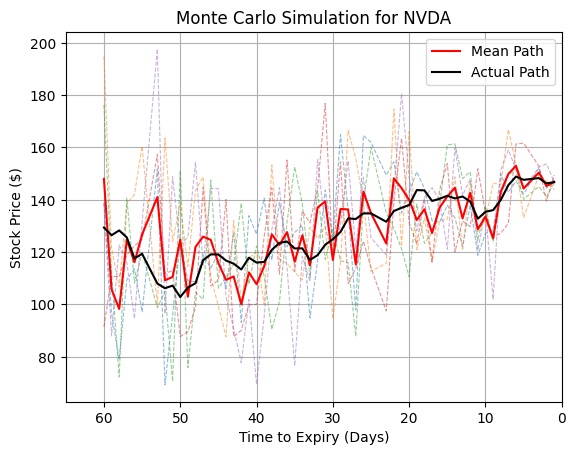

In [ ]:
def MC_paths(Sector,ticker,volatility,N=10):
  empty_arrays = [np.array([]) for _ in range(N)]
  #print(empty_arrays)
  method=volatility
  ticker_list=[ticker]
  index=sector_list.index(Sector)
  i=index
  main_data=main_list[i]
  other_data=other_list[i]
  filtered_dates = main_data[(main_data['Date'] >= start_date) & (main_data['Date'] <= end_date)]['Date'].tolist()
  if volatility=='VIX':
    sector_volatilities=BS_VIX_array[index]
    #newmethod='_VIX_option'
  else:
    sector_volatilities=BS_ARCH_GARCH_array[index]
    #newmethod='_ARCH/GARCH_option'
  #Loop through all the tickers

  for ticker in ticker_list:
    #Initialise some lists where we temporarily store data for a particular company before adding to date frame
    valid_dates=[]
    actual=[]
    #Get strike price of option
    K=other_data.loc[other_data['Ticker'] == ticker, 'Strike'].values[0]
    #Get expiration date of option
    expiry=other_data.loc[other_data['Ticker'] == ticker, 'Expirations'].values[0]
    #Number of days before prediction
    T=1/252

    #Loop through dates from list of dates obtained earlier
    for date in filtered_dates:
      #Get time to expiry and convert to years. Note the use of trading days
      tau= np.busday_count(date.date(), pd.Timestamp(expiry).date())/252

      #Check if either stock or option price is not not available for that day. We will go to next date if this is true.
      if pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_stock']).any() or pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_option']).any() or tau<=0:
        continue

      actual.append(main_data.loc[main_data['Date'] == date, ticker + '_stock'])
      #Need to look into this more -> Deeping it maybe I don't need an offset because we are using today to evaluate option price today
      valid_dates.append(np.busday_count(date.date(), pd.Timestamp(expiry).date()))
      dt=T/N
      #Obtain stock price for that day
      S=main_data.loc[main_data['Date'] == date, ticker+'_stock'].values[0]
      #Obtain risk-free rate for that day
      rpercent=main_data.loc[main_data['Date'] == date, 'Rates'].values[0]
      #Change to decimal
      r= rpercent/100
      #Get volatility on date
      sigma=sector_volatilities.loc[sector_volatilities['Date'] == date, ticker+'_'+method].values[0]
      #print("Strike:",K)
      """
      S_old=S

      for i in range(N):
        #print(i)
        Snew=S_old*np.exp((r-(sigma**2)/2)*dt+sigma*np.sqrt(dt)*np.random.normal())
        #Snew=S_old*np.exp((r-(sigma**2)/2)*dt+sigma*np.sqrt(dt)*np.random.lognormal())
        S_old=Snew
      #print(Snew)
      C=np.exp(-r*T)*max(Snew-K,0)
      """
      # Log-normal sampling for N paths
      drift = (r - 0.5 * sigma**2) * tau  # Drift term
      diffusion = sigma * np.sqrt(tau)   # Diffusion term
      Snew_samples = np.random.lognormal(mean=drift, sigma=diffusion, size=N) * S
      for i in range(len(empty_arrays)):
        empty_arrays[i]=np.append(empty_arrays[i],Snew_samples[i])
    print(len(empty_arrays))
    for array in empty_arrays:
      plt.plot(valid_dates, array, linewidth=0.8,linestyle="--", alpha=0.5)

    mean_path = np.mean(empty_arrays, axis=0)
    plt.plot(valid_dates, mean_path, color='red', linewidth=1.5, label="Mean Path")
    plt.plot(valid_dates, actual, color='black', linewidth=1.5, label="Actual Path")
    plt.xlabel("Time to Expiry (Days)")
    plt.ylabel("Stock Price ($)")
    plt.xlim(65,0)
    plt.title(f"Monte Carlo Simulation for {ticker}")
    plt.legend()
    plt.grid(True)
    plt.show()

MC_paths("Technology","NVDA","VIX",N=5)



**Stochastic Volatility- Normal distribution**

Calibrated Parameters for NVDA: [ 0.1    0.001  0.1    0.01   0.    -1.   ]


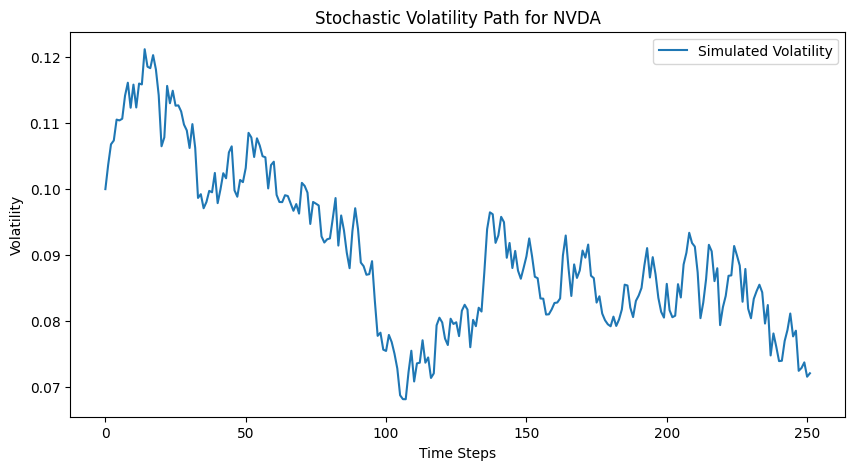

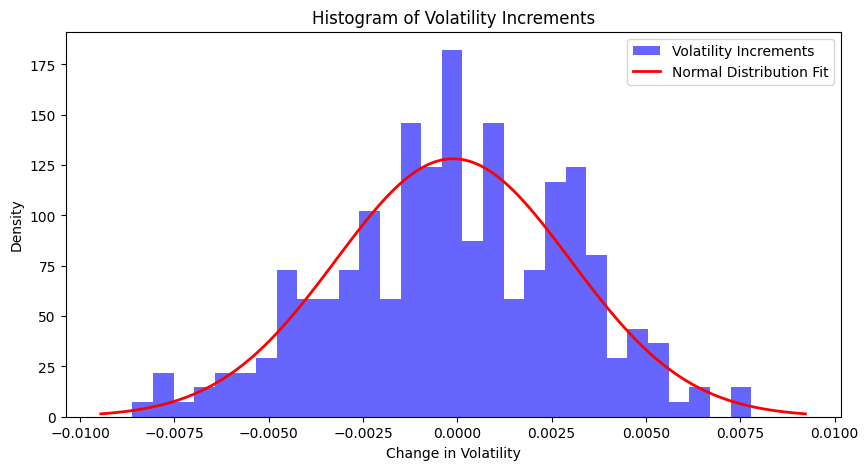

Mean of Increments: -0.00011
Standard Deviation of Increments: 0.00311
Skewness: -0.17810
Kurtosis: -0.25871


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import minimize
import scipy.stats as stats

# Heston model characteristic function and price
def Heston_charfunc(phi, S0, v0, kappa, theta, sigma, rho, lambd, tau, r):
    a = kappa * theta
    b = kappa + lambd
    rspi = rho * sigma * phi * 1j
    d = np.sqrt((rho * sigma * phi * 1j - b)**2 + (phi * 1j + phi**2) * sigma**2)
    g = (b - rspi + d) / (b - rspi - d)
    exp1 = np.exp(r * phi * 1j * tau)
    term2 = S0**(phi * 1j) * ((1 - g * np.exp(d * tau)) / (1 - g))**(-2 * a / sigma**2)
    exp2 = np.exp(a * tau * (b - rspi + d) / sigma**2 + v0 * (b - rspi + d) * ((1 - np.exp(d * tau)) / (1 - g * np.exp(d * tau))) / sigma**2)
    return exp1 * term2 * exp2

def Heston_price_rec(S0, K, v0, kappa, theta, sigma, rho, lambd, tau, r):
    args = (S0, v0, kappa, theta, sigma, rho, lambd, tau, r)
    P, umax, N = 0, 100, 1000
    dphi = umax / N
    for i in range(1, N):
        phi = dphi * (2 * i + 1) / 2
        numerator = np.exp(r * tau) * Heston_charfunc(phi - 1j, *args) - K * Heston_charfunc(phi, *args)
        denominator = 1j * phi * K**(1j * phi)
        P += dphi * numerator / denominator
    return np.real((S0 - K * np.exp(-r * tau)) / 2 + P / np.pi)

# Function to calculate sum of squared errors for calibration
def SqErr(x, S0s, K, ps, tau, rs):
    v0, kappa, theta, sigma, rho, lambd = x
    err = np.sum((ps - Heston_price_rec(S0s, K, v0, kappa, theta, sigma, rho, lambd, tau, rs))**2)
    return err

# Calibrate Heston parameters
def calibrate_heston(S0s, K, ps, tau, rs, x0, bnds):
    result = minimize(SqErr, x0, args=(S0s, K, ps, tau, rs), method='SLSQP', bounds=bnds, tol=1e-3, options={'maxiter': 1e4})
    return result.x  # Return the calibrated parameters (v0, kappa, theta, sigma, rho, lambd)

# Simulate stochastic volatility
def simulate_volatility(S0, v0, kappa, theta, sigma, rho, lambd, tau, r, num_steps=252):
    dt = tau / num_steps
    v = np.zeros(num_steps)
    v[0] = v0
    for i in range(1, num_steps):
        dz = np.random.normal(0, 1)
        dV = kappa * (theta - v[i - 1]) * dt + sigma * np.sqrt(v[i - 1]) * dz
        v[i] = max(v[i - 1] + dV, 0)  # Ensure non-negative volatility
    return v

# Analyze volatility incr  ements
def analyze_volatility_distribution(volatility_path):
    vol_increments = np.diff(volatility_path)

    # Plot histogram of volatility increments
    plt.figure(figsize=(10, 5))
    plt.hist(vol_increments, bins=30, density=True, alpha=0.6, color='b', label="Volatility Increments")

    # Overlay normal distribution
    mu, std = np.mean(vol_increments), np.std(vol_increments)
    x = np.linspace(mu - 3*std, mu + 3*std, 100)
    plt.plot(x, stats.norm.pdf(x, mu, std), 'r', linewidth=2, label="Normal Distribution Fit")

    plt.title('Histogram of Volatility Increments')
    plt.xlabel('Change in Volatility')
    plt.ylabel('Density')
    plt.legend()
    plt.show()

    # Print statistical summary
    print(f"Mean of Increments: {mu:.5f}")
    print(f"Standard Deviation of Increments: {std:.5f}")
    print(f"Skewness: {stats.skew(vol_increments):.5f}")
    print(f"Kurtosis: {stats.kurtosis(vol_increments):.5f}")

# Main function to calibrate Heston model and simulate volatility
def analyze_volatility(ticker, start_date, df_main, df_other, x0, bnds):
    # Filter data before start_date
    df_main = df_main[df_main['Date'] < start_date]
    if df_main.empty:
        print("No data available before the start date!")
        return

    # Make sure required columns exist
    if f'{ticker}_stock' not in df_main.columns or f'{ticker}_option' not in df_main.columns or 'Rates' not in df_main.columns:
        print(f"Missing columns in the data! Expected columns: {f'{ticker}_stock'}, {f'{ticker}_option'}, 'Rates'")
        return

    # Remove rows with missing values
    df_main = df_main[['Date', f'{ticker}_stock', f'{ticker}_option', 'Rates']].dropna()

    # Extract strike price and expiration
    strike_price = df_other[df_other['Ticker'] == ticker]['Strike'].values[0]
    expiry_date = df_other[df_other['Ticker'] == ticker]['Expirations'].values[0]

    # Prepare data
    df_main['tau'] = np.busday_count(df_main['Date'].values.astype('datetime64[D]'), pd.Timestamp(expiry_date).date()) / 252
    S0s = df_main[f'{ticker}_stock'].values
    ps = df_main[f'{ticker}_option'].values
    tau = df_main['tau'].values
    rs = df_main['Rates'].values / 100

    # Ensure data is not empty
    if len(S0s) == 0 or len(ps) == 0 or len(tau) == 0 or len(rs) == 0:
        print("Data arrays are empty after filtering!")
        return

    # Calibrate Heston parameters
    calibrated_params = calibrate_heston(S0s, strike_price, ps, tau, rs, x0, bnds)
    print(f"Calibrated Parameters for {ticker}: {calibrated_params}")

    # Simulate volatility path
    v0, kappa, theta, sigma, rho, lambd = calibrated_params
    volatility_path = simulate_volatility(S0s[0], v0, kappa, theta, sigma, rho, lambd, tau[0], rs[0])

    # Plot the simulated volatility path
    plt.figure(figsize=(10, 5))
    plt.plot(volatility_path, label="Simulated Volatility")
    plt.title(f'Stochastic Volatility Path for {ticker}')
    plt.xlabel('Time Steps')
    plt.ylabel('Volatility')
    plt.legend()
    plt.show()

    # Analyze volatility increments
    analyze_volatility_distribution(volatility_path)

# Define initial guesses and bounds
x0 = [0.1, 3, 0.05, 0.3, -0.8, 0.03]
bnds = [(1e-3, 0.1), (1e-3, 5), (1e-3, 0.1), (1e-2, 1), (-1, 0), (-1, 1)]

# Example usage for a specific ticker and start date
ticker = "NVDA"
start_date = pd.to_datetime("2024-08-23")
analyze_volatility(ticker, start_date, df_main_Technology, df_other_Technology, x0, bnds)



**VIX Movement**

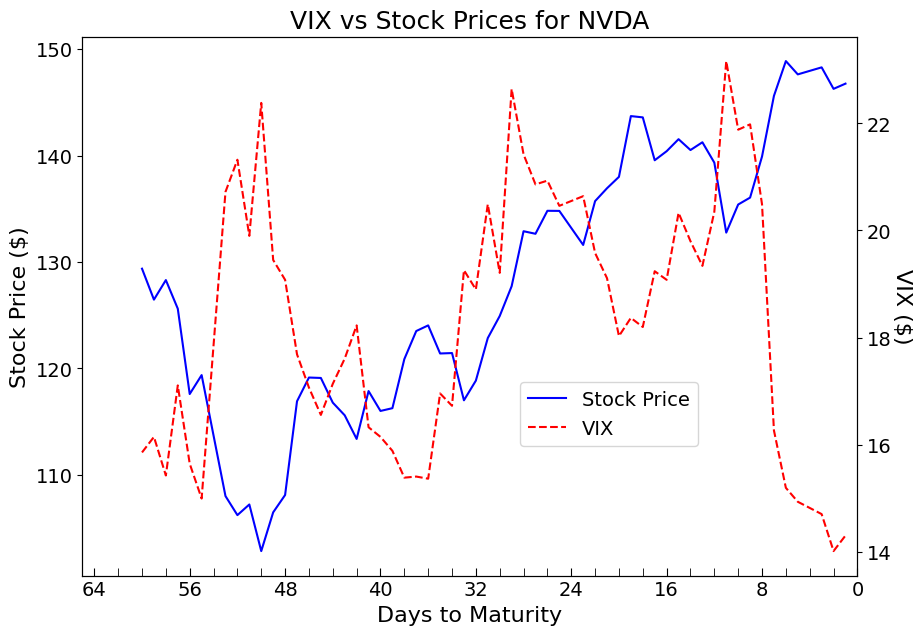

In [ ]:
import matplotlib.ticker as mticker  # Rename ticker to avoid conflicts

def Plot_VIX(Sector, ticker, axis_fontsize=12, label_fontsize=14, title_fontsize=16, legend_fontsize=12):
    ticker_list = [ticker]
    index = sector_list.index(Sector)
    i = index
    main_data = main_list[i]
    other_data = other_list[i]
    filtered_dates = main_data[(main_data['Date'] >= start_date) & (main_data['Date'] <= end_date)]['Date'].tolist()

    for ticker in ticker_list:
        dates = []
        VIX_prices = []
        stock_prices = []
        expiry = other_data.loc[other_data['Ticker'] == ticker, 'Expirations'].values[0]

        for date in filtered_dates:
            tau = np.busday_count(date.date(), pd.Timestamp(expiry).date())
            if pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_stock']).any() or \
               pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_option']).any() or tau <= 0:
                continue
            tau_days = np.busday_count(date.date(), pd.Timestamp(expiry).date())
            dates.append(tau_days)
            VIX_prices.append(main_data.loc[main_data['Date'] == date, "VIX"].values[0])
            stock_prices.append(main_data.loc[main_data['Date'] == date, ticker + "_stock"].values[0])

        # Create figure and axis
        fig, ax1 = plt.subplots(figsize=(10, 7))

        # First y-axis for stock prices
        ax1.plot(dates, stock_prices, label='Stock Price', color='blue')
        ax1.set_xlabel('Days to Maturity', fontsize=label_fontsize)
        ax1.set_ylabel('Stock Price ($)', fontsize=label_fontsize)
        ax1.tick_params(axis='y', labelsize=axis_fontsize)

        # Second y-axis for VIX
        ax2 = ax1.twinx()
        ax2.plot(dates, VIX_prices, label='VIX', color='red', linestyle='dashed')
        ax2.set_ylabel('VIX ($)', fontsize=label_fontsize, rotation=270, labelpad=15)
        ax2.yaxis.set_label_coords(1.07, 0.5)
        ax2.tick_params(axis='y', labelsize=axis_fontsize)

        # Improve x-axis ticks
        ax1.xaxis.set_major_locator(mticker.MaxNLocator(10))  # Approx. 10 major ticks
        ax1.xaxis.set_minor_locator(mticker.AutoMinorLocator())  # Auto minor ticks
        ax1.tick_params(axis='x', which='both', direction='in', length=6, labelsize=axis_fontsize)

        #ax1.grid(True, which='both', linestyle='--', linewidth=0.5)
        #ax2.grid(True, which='both', linestyle='--', linewidth=0.5)

        # Title and legend
        plt.title("VIX vs Stock Prices for " + ticker, fontsize=title_fontsize)
        fig.legend( fontsize=legend_fontsize, bbox_to_anchor=(0.25, -0.1, 0.5, 0.5))
        plt.xlim(65, 0)

        plt.show()

# Example usage with custom font sizes
Plot_VIX('Technology', 'NVDA', axis_fontsize=14, label_fontsize=16, title_fontsize=18, legend_fontsize=14)




**ARCH/GARCH Volatility**

/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009176. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009251. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:309: DataScaleWarn

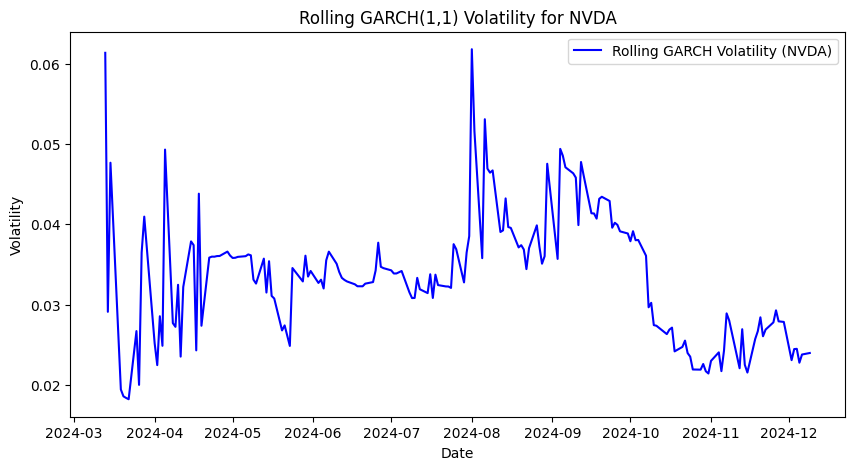

,GARCH_Volatility
Date,
2024-03-13,0.061345
2024-03-14,0.029102
2024-03-15,0.047663
2024-03-18,0.026679
2024-03-19,0.019431
...,...
2024-12-03,0.024464
2024-12-04,0.024493
2024-12-05,0.022767


In [ ]:
from arch import arch_model  # Importing ARCH/GARCH model

def rolling_garch_volatility(df_main, ticker, window=60):
    """
    Computes rolling GARCH(1,1) volatility estimates for a given ticker's stock prices.

    Parameters:
    df_main: DataFrame containing stock prices with Date as index.
    ticker: The stock ticker column to analyze.
    window: Rolling window size (default=60 days).

    Returns:
    DataFrame with rolling GARCH volatility estimates.
    """
    df_main = df_main[['Date', f'{ticker}_stock']].dropna()
    df_main['Date'] = pd.to_datetime(df_main['Date'])
    df_main.set_index('Date', inplace=True)

    # Compute log returns
    df_main['returns'] = np.log(df_main[f'{ticker}_stock'] / df_main[f'{ticker}_stock'].shift(1))
    df_main.dropna(inplace=True)

    rolling_vol = []
    dates = []

    for i in range(window, len(df_main)):
        rolling_data = df_main['returns'].iloc[i - window:i]

        # Fit GARCH(1,1) model
        model = arch_model(rolling_data, vol='Garch', p=1, q=1)
        res = model.fit(disp='off')

        # Predict volatility for next period
        forecast_vol = res.forecast(horizon=1).variance.iloc[-1, 0]
        rolling_vol.append(np.sqrt(forecast_vol))  # Convert variance to standard deviation
        dates.append(df_main.index[i])

    # Store results in DataFrame
    vol_df = pd.DataFrame({'Date': dates, 'GARCH_Volatility': rolling_vol})
    vol_df.set_index('Date', inplace=True)

    # Plot rolling volatility
    plt.figure(figsize=(10, 5))
    plt.plot(vol_df, label=f'Rolling GARCH Volatility ({ticker})', color='b')
    plt.title(f'Rolling GARCH(1,1) Volatility for {ticker}')
    plt.xlabel('Date')
    plt.ylabel('Volatility')
    plt.legend()
    plt.show()

    return vol_df

# Example Usage:
sector_idx = 9  # Example: Technology sector
ticker = "NVDA"
df_main = main_list[sector_idx]  # Get relevant sector data
rolling_garch_volatility(df_main, ticker, window=60)

In [ ]:
def ARCH_GARCH_Flex(ticker,main_data,returns_data,counter,p=1,q=1,training_days=30,sd='2020-03-01',ed='2024-11-15'):
  pq_count=counter
  #Get a list of dates between 2 globally defined dates for which we are looking at
  filtered_dates = main_data[(main_data['Date'] >= sd) & (main_data['Date'] <= ed)]['Date'].tolist()
  print(filtered_dates)
  optimal_pq=[0,0]
  returns=returns_data[ticker+'_returns']
  cleared_returns=returns.dropna()
  dates=[]
  volatilities=[]
  #print(filtered_dates)
  print(p,q)
  if q==0:
    for date in filtered_dates:
      dates.append(date)
      start=date - pd.tseries.offsets.BDay(training_days)
      returns_list=returns_data.loc[(returns_data['Date'] >= start) & (returns_data['Date'] <= date), ticker+'_returns'].tolist()
      am = arch_model(returns_list, mean='Zero', p=p, rescale=False)
      arch_fit = am.fit(disp='off')
      arch_pred = arch_fit.forecast(horizon=1)
      volatilities.append(np.sqrt(arch_pred.variance.values[0,0])*np.sqrt(252))



  else:
    for date in filtered_dates:
      dates.append(date)
      start=date - pd.tseries.offsets.BDay(training_days)
      returns_list=returns_data.loc[(returns_data['Date'] >= start) & (returns_data['Date'] <= date), ticker+'_returns'].tolist()
      #print(returns_data)
      gm = arch_model(returns_list, mean='Zero', p=p,q=q, rescale=False)
      arch_fit = gm.fit(disp='off')
      arch_pred = arch_fit.forecast(horizon=1)
      volatilities.append(np.sqrt(arch_pred.variance.values[0,0])*np.sqrt(252))

  return dates, volatilities




def Plot_ARCH_GARCH(Sector,ticker,main_data,other_data,returns_data,training_days=60,p=1,q=1,sd='2020-03-01',ed='2024-11-15'):
  pq_count=0
  #Initialise data frame
  Sector_option_prices=pd.DataFrame({})

  #index = sector_list.index(Sector)
  #i = index
  #main_data = main_list[i]
  #other_data = other_list[i]
  #returns_data=returns_list[i]

  #Get all tickers for the sector
  ticker_list=[ticker]
  #Get a list of dates between 2 globally defined dates for which we are looking at
  filtered_dates = main_data[(main_data['Date'] >= sd) & (main_data['Date'] <= ed)]['Date'].tolist()
  #Add these dates to our data frame
  Sector_option_prices['Date']=filtered_dates


  #Loop through all the tickers
  for ticker in ticker_list:
    #Initialise some lists where we temporarily store data for a particular company before adding to date frame
    option_prices=[]
    new_dates=[]
    new_volatilities=[]
    valid_dates,volatilities=ARCH_GARCH_Flex(ticker,main_data,returns_data,pq_count,training_days=60,p=p,q=q,sd=sd,ed=ed)
    #print("Here:",valid_dates)
    #Get strike price of option
    K=other_data.loc[other_data['Ticker'] == ticker, 'Strike'].values[0]
    #Get expiration date of option
    expiry=other_data.loc[other_data['Ticker'] == ticker, 'Expirations'].values[0]
    #Get beta value for the company
    beta=other_data.loc[other_data['Ticker'] == ticker, 'Beta'].values[0]

    #Loop through dates from list of dates obtained earlier

    for i in range(len(valid_dates)):
      date=valid_dates[i]
      #Get time to expiry and convert to years. Note the use of trading days
      tau= np.busday_count(date.date(), pd.Timestamp(expiry).date())/252

      #Check if either stock or option price is not not available for that day. We will go to next date if this is true.
      if pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_stock']).any() or tau<=0:
        continue
      new_dates.append(date)
      new_volatilities.append(volatilities[i])
      #Obtain stock price for that day
      #S=main_data.loc[main_data['Date'] == date, ticker+'_stock'].values[0]
      #Obtain risk-free rate for that day
      #rpercent=main_data.loc[main_data['Date'] == date, 'Rates'].values[0]
      #Change to decimal
      #r= rpercent/100
      #Get volatility for date
      #sigma=volatilities[i]

      #Black-Scholes

      #d1=(np.log(S/K)+(r+(sigma**2)/2)*tau)/(sigma*np.sqrt(tau))
      #d2=d1-sigma*np.sqrt(tau)
      #V=S*norm.cdf(d1)-K*np.exp(-r*tau)*norm.cdf(d2)
      #Add option price to temporary list
      #option_prices.append(V)
    #Create temporary data frame with valid dates and evaluated option prices
    df_temp=pd.DataFrame({})
    df_temp['Date']=new_dates
    df_temp[ticker+'_ARCH/GARCH']=new_volatilities

    #Add data to main data frame
    option_prices=pd.merge(Sector_option_prices,df_temp,on='Date', how='outer')
    filtered_dates = main_data[(main_data['Date'] >= sd) & (main_data['Date'] <= ed)]['Date'].tolist()
    days_to_maturity=[]
    predicted_volatilities=[]
    d=[]
    for date in filtered_dates:
        tau_days = np.busday_count(date.date(), pd.Timestamp(expiry).date())
        if pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_stock']).any() or tau_days <= 0:
          continue
        days_to_maturity.append(tau_days)
        d.append(date)
        predicted_volatilities.append(option_prices.loc[option_prices['Date'] == date, ticker + '_ARCH/GARCH'].values[0])
    print(len(days_to_maturity),len(predicted_volatilities),len(d))
    return days_to_maturity,d,predicted_volatilities






In [ ]:
def returns_temp(Sector, main_data):
  ticker_list=['NVDA']
  filtered_dates = main_data['Date'].tolist()
  df_return=pd.DataFrame({})
  df_return['Date']=filtered_dates
  for ticker in ticker_list:
    returns=[]
    for i in range (len(filtered_dates)):
      date=filtered_dates[i]
      previous_date=filtered_dates[i-1]
      if i==0:
          return_val=np.nan
          returns.append(return_val)
          continue
      try:
        current_price=main_data.loc[main_data['Date'] == date, ticker+'_stock'].values[0]
        previous_price=main_data.loc[main_data['Date'] == previous_date, ticker+'_stock'].values[0]
        return_val=((current_price)-(previous_price))/previous_price
      except IndexError:
        return_val=np.nan
      returns.append(return_val)
    df_temp=pd.DataFrame({})
    df_temp['Date']=filtered_dates
    df_temp[ticker+'_returns']=returns
    df_return=pd.merge(df_return,df_temp,on='Date', how='outer')
    df_return=df_return.dropna()
  return df_return

df_main_Tech=df_stockdata = pd.read_excel('/content/drive/My Drive/MSci Project/Technology/NVDA.xlsx','Stock').dropna(how='all').reset_index(drop=True)
df_main_Tech =df_stockdata[['Date','Stock']]
df_main_Tech.columns=['Date','NVDA_stock']
returns_Tech=returns_temp('Technology',df_main_Tech)
#print(returns_Technology)

[Timestamp('2024-11-15 00:00:00'), Timestamp('2024-11-14 00:00:00'), Timestamp('2024-11-13 00:00:00'), Timestamp('2024-11-12 00:00:00'), Timestamp('2024-11-11 00:00:00'), Timestamp('2024-11-08 00:00:00'), Timestamp('2024-11-07 00:00:00'), Timestamp('2024-11-06 00:00:00'), Timestamp('2024-11-05 00:00:00'), Timestamp('2024-11-04 00:00:00'), Timestamp('2024-11-01 00:00:00'), Timestamp('2024-10-31 00:00:00'), Timestamp('2024-10-30 00:00:00'), Timestamp('2024-10-29 00:00:00'), Timestamp('2024-10-28 00:00:00'), Timestamp('2024-10-25 00:00:00'), Timestamp('2024-10-24 00:00:00'), Timestamp('2024-10-23 00:00:00'), Timestamp('2024-10-22 00:00:00'), Timestamp('2024-10-21 00:00:00'), Timestamp('2024-10-18 00:00:00'), Timestamp('2024-10-17 00:00:00'), Timestamp('2024-10-16 00:00:00'), Timestamp('2024-10-15 00:00:00'), Timestamp('2024-10-14 00:00:00'), Timestamp('2024-10-11 00:00:00'), Timestamp('2024-10-10 00:00:00'), Timestamp('2024-10-09 00:00:00'), Timestamp('2024-10-08 00:00:00'), Timestamp('20

/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


1187 1187 1187


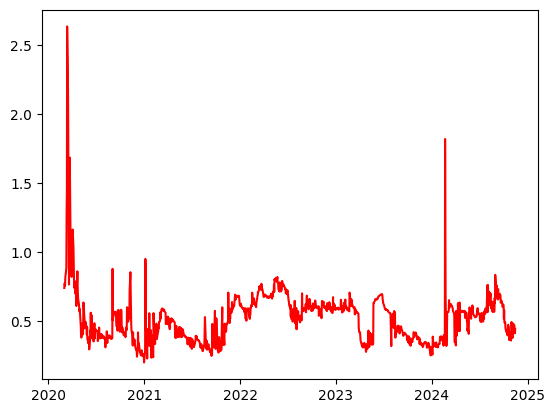

In [ ]:
returns_list=[returns_CommunicationServices,returns_ConsumerDiscretionary,returns_ConsumerStaples,returns_Energy,returns_Financial,returns_Healthcare,returns_Industrials,returns_Materials,returns_RealEstate,returns_Technology,returns_Utilities]
Sector="Technology"
ticker="NVDA"
index = sector_list.index(Sector)
i = index
#main_data = main_list[i]
other_data = other_list[i]
#returns_data=returns_list[i]
#main_data=df_main_Tech
#other_data=df_other_Technology
#returns_data=returns_Tech
ps=[1]
qs=[1]
count=0
alphas=[1,0.9,0.8,0.7,0.6,0.5]
colors=['red','blue','green','black','purple','orange']
#print(returns_data["GOOG_returns"].tolist())
#print(main_data)
for p in ps:
  for q in qs:
    days,dates,voltailities= Plot_ARCH_GARCH(Sector,ticker, main_data,other_data,returns_data,p=p,q=q)#,sd='2024-01-18')
    plt.plot(dates,voltailities,color=colors[count],alpha=alphas[count],linestyle='-')
    count+=1
#plt.xlim(1000,200)
#plt.ylim(0,1)
#plt.show()


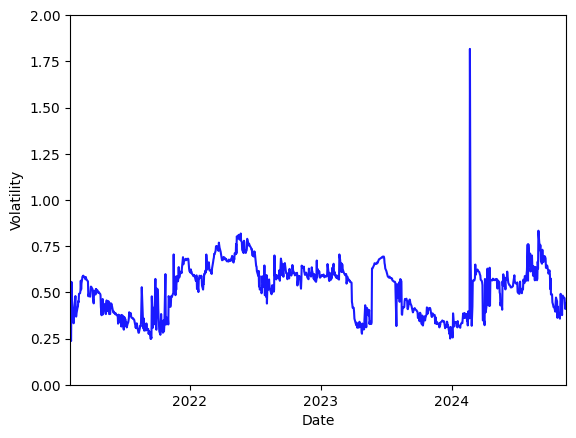

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import pandas as pd  # Ensure datetime handling

# Convert date strings to datetime format
sd = pd.to_datetime('2021-02-01')
ed = pd.to_datetime('2024-11-15')

# Plot the data
plt.plot(dates, voltailities, color=colors[count], alpha=alphas[count], linestyle='-')

# Set x-axis limits
plt.xlim(sd, ed)
plt.ylim(0, 2)

# Format x-axis to show only one tick per year
plt.gca().xaxis.set_major_locator(mdates.YearLocator())  # One tick per year
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y'))  # Show only year

# Labels
plt.ylabel('Volatility')
plt.xlabel('Date')

# Rotate x-axis labels for readability (0° keeps it horizontal)
plt.xticks(rotation=0)

plt.show()




**Payoff Diagrams**

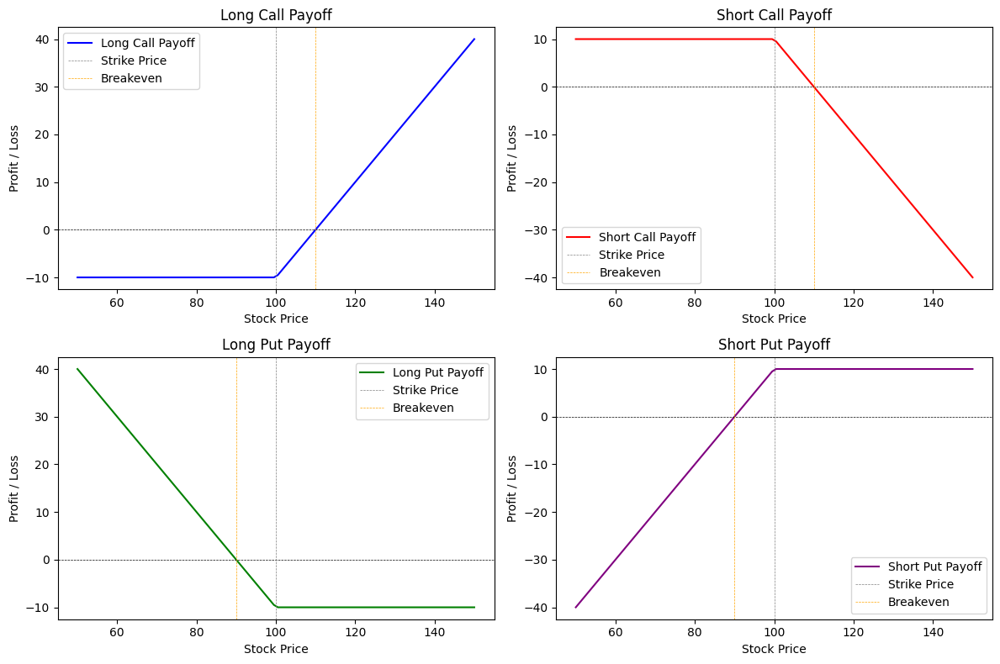

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Define strike price and premium for options
strike_price = 100
premium = 10

# Corrected breakeven prices
breakeven_call = strike_price + premium  # Breakeven for calls
breakeven_put = strike_price - premium   # Breakeven for puts

# Define stock prices
stock_prices = np.linspace(50, 150, 100)

# Payoff functions
def long_call(stock_prices, strike, premium):
    return np.maximum(stock_prices - strike, 0) - premium

def short_call(stock_prices, strike, premium):
    return -long_call(stock_prices, strike, premium)

def long_put(stock_prices, strike, premium):
    return np.maximum(strike - stock_prices, 0) - premium

def short_put(stock_prices, strike, premium):
    return -long_put(stock_prices, strike, premium)

# Compute payoffs
payoff_long_call = long_call(stock_prices, strike_price, premium)
payoff_short_call = short_call(stock_prices, strike_price, premium)
payoff_long_put = long_put(stock_prices, strike_price, premium)
payoff_short_put = short_put(stock_prices, strike_price, premium)

# Create subplots
fig, axs = plt.subplots(2, 2, figsize=(12, 8))

# Plot each strategy with a different color
for ax, payoff, title, color in zip(
    [axs[0, 0], axs[0, 1], axs[1, 0], axs[1, 1]],
    [payoff_long_call, payoff_short_call, payoff_long_put, payoff_short_put],
    ["Long Call Payoff", "Short Call Payoff", "Long Put Payoff", "Short Put Payoff"],
    ['blue', 'red', 'green', 'purple']
):
    ax.plot(stock_prices, payoff, color=color, label=title)
    ax.axhline(0, color='black', linewidth=0.5, linestyle='--')  # Zero profit line
    ax.axvline(strike_price, color='gray', linewidth=0.5, linestyle='--', label='Strike Price')  # Strike price line

    # Use correct breakeven for calls and puts
    breakeven = breakeven_call if "Call" in title else breakeven_put
    ax.axvline(breakeven, color='orange', linewidth=0.5, linestyle='--', label='Breakeven')

    ax.set_title(title)
    ax.set_xlabel("Stock Price")
    ax.set_ylabel("Profit / Loss")
    ax.legend()

# Adjust layout and show plot
plt.tight_layout()
plt.show()


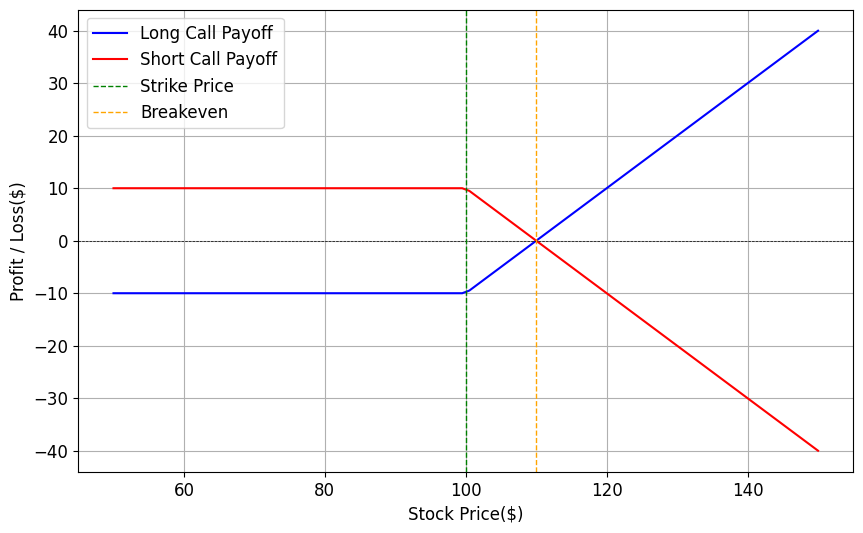

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Define strike price and premium for options
strike_price = 100
premium = 10

# Corrected breakeven prices
breakeven_call = strike_price + premium  # Breakeven for calls

# Define stock prices
stock_prices = np.linspace(50, 150, 100)

# Payoff functions
def long_call(stock_prices, strike, premium):
    return np.maximum(stock_prices - strike, 0) - premium

def short_call(stock_prices, strike, premium):
    return -long_call(stock_prices, strike, premium)

# Compute payoffs
payoff_long_call = long_call(stock_prices, strike_price, premium)
payoff_short_call = short_call(stock_prices, strike_price, premium)

# Create a single plot for both call options

plt.figure(figsize=(10, 6))
plt.plot(stock_prices, payoff_long_call, label="Long Call Payoff", color='blue')
plt.plot(stock_prices, payoff_short_call, label="Short Call Payoff", color='red')

# Add key reference lines
plt.axhline(0, color='black', linewidth=0.5, linestyle='--')# label="Zero Profit Line")  # Zero profit line
plt.axvline(strike_price, color='green', linewidth=1, linestyle='--', label="Strike Price")  # Strike price line
plt.axvline(breakeven_call, color='orange', linewidth=1, linestyle='--', label="Breakeven")  # Breakeven line for calls

# Labels and title
plt.xlabel("Stock Price($)",fontsize=12)
plt.ylabel("Profit / Loss($)",fontsize=12)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
#plt.title("Call Options Payoff")
plt.legend(fontsize=12)
plt.grid()
# Show plot
plt.show()


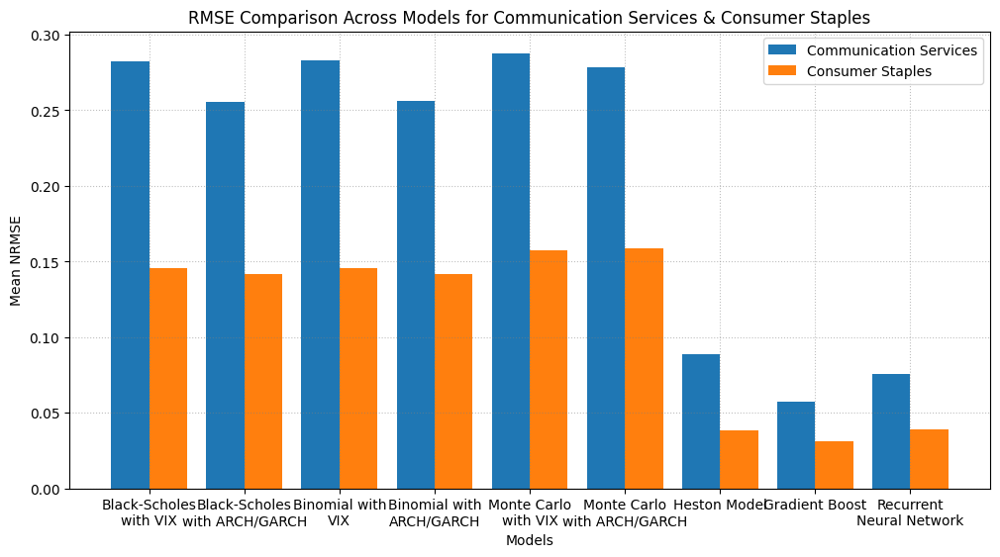

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import textwrap

# Define models
models = [
    "Black-Scholes with VIX", "Black-Scholes with ARCH/GARCH", "Binomial with VIX", "Binomial with ARCH/GARCH",
    "Monte Carlo with VIX", "Monte Carlo with ARCH/GARCH", "Heston Model", "Gradient Boost", "Recurrent Neural Network"
]

# Compute mean and standard deviation for Communication Services
comm_services_means = [
    np.mean(BS_VIX_rmses_CommunicationServices), np.mean(BS_ARCH_GARCH_rmses_CommunicationServices),
    np.mean(Binomial_VIX_rmses_CommunicationServices), np.mean(Binomial_ARCH_GARCH_rmses_CommunicationServices),
    np.mean(MC_VIX_rmses_CommunicationServices), np.mean(MC_ARCH_GARCH_rmses_CommunicationServices),
    np.mean(Heston_rmses_CommunicationServices), np.mean(IGB_rmses_CommunicationServices), np.mean(IRNN_rmses_CommunicationServices)
]

comm_services_std = [
    np.std(BS_VIX_rmses_CommunicationServices), np.std(BS_ARCH_GARCH_rmses_CommunicationServices),
    np.std(Binomial_VIX_rmses_CommunicationServices), np.std(Binomial_ARCH_GARCH_rmses_CommunicationServices),
    np.std(MC_VIX_rmses_CommunicationServices), np.std(MC_ARCH_GARCH_rmses_CommunicationServices),
    np.std(Heston_rmses_CommunicationServices), np.std(IGB_rmses_CommunicationServices), np.std(IRNN_rmses_CommunicationServices)
]

# Compute mean and standard deviation for Consumer Staples
consumer_staples_means = [
    np.mean(BS_VIX_rmses_ConsumerStaples), np.mean(BS_ARCH_GARCH_rmses_ConsumerStaples),
    np.mean(Binomial_VIX_rmses_ConsumerStaples), np.mean(Binomial_ARCH_GARCH_rmses_ConsumerStaples),
    np.mean(MC_VIX_rmses_ConsumerStaples), np.mean(MC_ARCH_GARCH_rmses_ConsumerStaples),
    np.mean(Heston_rmses_ConsumerStaples), np.mean(IGB_rmses_ConsumerStaples), np.mean(IRNN_rmses_ConsumerStaples)
]

consumer_staples_std = [
    np.std(BS_VIX_rmses_ConsumerStaples), np.std(BS_ARCH_GARCH_rmses_ConsumerStaples),
    np.std(Binomial_VIX_rmses_ConsumerStaples), np.std(Binomial_ARCH_GARCH_rmses_ConsumerStaples),
    np.std(MC_VIX_rmses_ConsumerStaples), np.std(MC_ARCH_GARCH_rmses_ConsumerStaples),
    np.std(Heston_rmses_ConsumerStaples), np.std(IGB_rmses_ConsumerStaples), np.std(IRNN_rmses_ConsumerStaples)
]

# Bar width and positions
x = np.arange(len(models))
width = 0.4

# Use default Matplotlib colors (the first two in the cycle)
colors = ['#1f77b4', '#ff7f0e']  # Blue and Orange

# Plot
fig, ax = plt.subplots(figsize=(12, 6))
ax.bar(x - width/2, comm_services_means, width, label="Communication Services", color=colors[0], alpha=1, capsize=5)
ax.bar(x + width/2, consumer_staples_means, width, label="Consumer Staples", color=colors[1], alpha=1, capsize=5)

# Labels and title
ax.set_xlabel("Models")
ax.set_ylabel("Mean NRMSE")
ax.set_title("RMSE Comparison Across Models for Communication Services & Consumer Staples")
ax.set_xticks(x)
ax.set_xticklabels(["\n".join(textwrap.wrap(label, 12)) for label in models], ha="center")
ax.legend()
ax.grid(True, which='both', axis='both', linestyle=':', color='gray', alpha=0.5)  # Adjust style and transparency

# Show plot
plt.show()



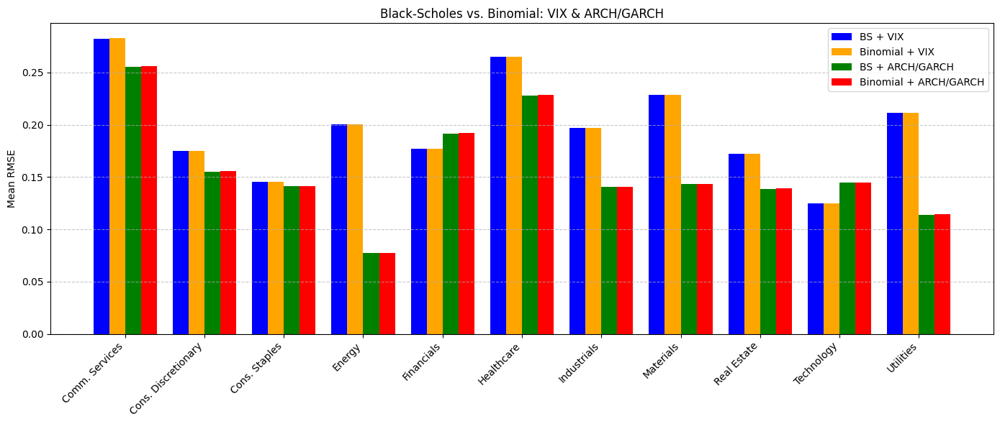

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Function to compute mean RMSE for each sector
def compute_mean_errors(error_arrays):
    return [np.mean(sector_errors) for sector_errors in error_arrays]

# Sector names
sectors = [
    "Comm. Services", "Cons. Discretionary", "Cons. Staples", "Energy",
    "Financials", "Healthcare", "Industrials", "Materials",
    "Real Estate", "Technology", "Utilities"
]

# Compute mean RMSEs for each model
bs_vix_means = compute_mean_errors(BS_VIX_rmses_array)
binomial_vix_means = compute_mean_errors(Binomial_VIX_rmses_array)
bs_arch_garch_means = compute_mean_errors(BS_ARCH_GARCH_rmses_array)
binomial_arch_garch_means = compute_mean_errors(Binomial_ARCH_GARCH_rmses_array)

# Set bar width and x locations
bar_width = 0.2
x = np.arange(len(sectors))

# Create the figure
fig, ax = plt.subplots(figsize=(14, 6))

# Plot all four models side-by-side
ax.bar(x - 1.5 * bar_width, bs_vix_means, bar_width, label='BS + VIX', color='blue', alpha=1)
ax.bar(x - 0.5 * bar_width, binomial_vix_means, bar_width, label='Binomial + VIX', color='orange', alpha=1)
ax.bar(x + 0.5 * bar_width, bs_arch_garch_means, bar_width, label='BS + ARCH/GARCH', color='green', alpha=1)
ax.bar(x + 1.5 * bar_width, binomial_arch_garch_means, bar_width, label='Binomial + ARCH/GARCH', color='red', alpha=1)

# Customizing the plot
ax.set_xticks(x)
ax.set_xticklabels(sectors, rotation=45, ha="right")
ax.set_title('Black-Scholes vs. Binomial: VIX & ARCH/GARCH')
ax.set_ylabel('Mean RMSE')
ax.legend()
ax.grid(axis='y', linestyle='--', alpha=0.7)

plt.tight_layout()
plt.show()



In [ ]:
import numpy as np
from scipy.stats import pearsonr

# Function to compute Mean Absolute Difference (MAD)
def mean_absolute_difference(arr1, arr2):
    differences = np.abs(np.array(arr1) - np.array(arr2))
    mad = np.mean(differences)
    se = np.std(differences, ddof=1) / np.sqrt(len(differences))  # Standard error
    return mad, se

# Compute mean errors for each sector
bs_vix_means = [np.mean(errors) for errors in BS_VIX_rmses_array]
binomial_vix_means = [np.mean(errors) for errors in Binomial_VIX_rmses_array]
mc_vix_means= [np.mean(errors) for errors in MC_VIX_rmses_array]
bs_arch_garch_means = [np.mean(errors) for errors in BS_ARCH_GARCH_rmses_array]
binomial_arch_garch_means = [np.mean(errors) for errors in Binomial_ARCH_GARCH_rmses_array]
mc_arch_garch_means= [np.mean(errors) for errors in MC_ARCH_GARCH_rmses_array]

# Compute MAD and Standard Error
mad_vix, se_vix = mean_absolute_difference(bs_vix_means, binomial_vix_means)
mad_arch_garch, se_arch_garch = mean_absolute_difference(bs_arch_garch_means, binomial_arch_garch_means)
mad_vix2, se_vix2 = mean_absolute_difference(bs_vix_means, mc_vix_means)
mad_arch_garch2, se_arch_garch2 = mean_absolute_difference(bs_arch_garch_means, mc_arch_garch_means)
# Print the results
print("🔹 **VIX-Based Models**")
print(f"   Mean Absolute Difference (MAD): {mad_vix:.4f} ± {se_vix:.4f}")

print("\n🔹 **ARCH/GARCH-Based Models**")
print(f"   Mean Absolute Difference (MAD): {mad_arch_garch:.4f} ± {se_arch_garch:.4f}")


print("\n🔹 **VIX-Based Models**")
print(f"   Mean Absolute Difference (MAD): {mad_vix2:.4f} ± {se_vix2:.4f}")

print("\n🔹 **ARCH/GARCH-Based Models**")
print(f"   Mean Absolute Difference (MAD): {mad_arch_garch2:.4f} ± {se_arch_garch2:.4f}")

🔹 **VIX-Based Models**
   Mean Absolute Difference (MAD): 0.0002 ± 0.0001

🔹 **ARCH/GARCH-Based Models**
   Mean Absolute Difference (MAD): 0.0003 ± 0.0001

🔹 **VIX-Based Models**
   Mean Absolute Difference (MAD): 0.0001 ± 0.0000

🔹 **ARCH/GARCH-Based Models**
   Mean Absolute Difference (MAD): 0.0008 ± 0.0003


In [ ]:
import numpy as np
from scipy.stats import pearsonr

# Function to compute Mean Absolute Difference (MAD) and Standard Error (SE)
def mean_absolute_difference(arr1, arr2):
    differences = np.abs(np.array(arr1) - np.array(arr2))
    mad = np.mean(differences)
    se = np.std(differences, ddof=1) / np.sqrt(len(differences))  # Standard error
    return mad, se

# Compute mean errors for each sector
bs_vix_means = [np.mean(errors) for errors in BS_VIX_rmses_array]
binomial_vix_means = [np.mean(errors) for errors in Binomial_VIX_rmses_array]
mc_vix_means= [np.mean(errors) for errors in MC_VIX_rmses_array]
bs_arch_garch_means = [np.mean(errors) for errors in BS_ARCH_GARCH_rmses_array]
binomial_arch_garch_means = [np.mean(errors) for errors in Binomial_ARCH_GARCH_rmses_array]
mc_arch_garch_means= [np.mean(errors) for errors in MC_ARCH_GARCH_rmses_array]
# Compute MAD and Standard Error
mad_vix, se_vix = mean_absolute_difference(bs_vix_means, binomial_vix_means)
mad_arch_garch, se_arch_garch = mean_absolute_difference(bs_arch_garch_means, binomial_arch_garch_means)

mad_vix2, se_vix2 = mean_absolute_difference(bs_vix_means, mc_vix_means)
mad_arch_garch2, se_arch_garch2 = mean_absolute_difference(bs_arch_garch_means, mc_arch_garch_means)
# Print the results with higher precision
print("🔹 **VIX-Based Models**")
print(f"   Mean Absolute Difference (MAD): {mad_vix:.8f} ± {se_vix:.8f}")

print("\n🔹 **ARCH/GARCH-Based Models**")
print(f"   Mean Absolute Difference (MAD): {mad_arch_garch:.8f} ± {se_arch_garch:.8f}")

print("\n🔹 **VIX-Based Models**")
print(f"   Mean Absolute Difference (MAD): {mad_vix2:.8f} ± {se_vix2:.8f}")

print("\n🔹 **ARCH/GARCH-Based Models**")
print(f"   Mean Absolute Difference (MAD): {mad_arch_garch2:.8f} ± {se_arch_garch2:.8f}")

🔹 **VIX-Based Models**
   Mean Absolute Difference (MAD): 0.00022035 ± 0.00005178

🔹 **ARCH/GARCH-Based Models**
   Mean Absolute Difference (MAD): 0.00034164 ± 0.00008215

🔹 **VIX-Based Models**
   Mean Absolute Difference (MAD): 0.00012980 ± 0.00003131

🔹 **ARCH/GARCH-Based Models**
   Mean Absolute Difference (MAD): 0.00084501 ± 0.00026070


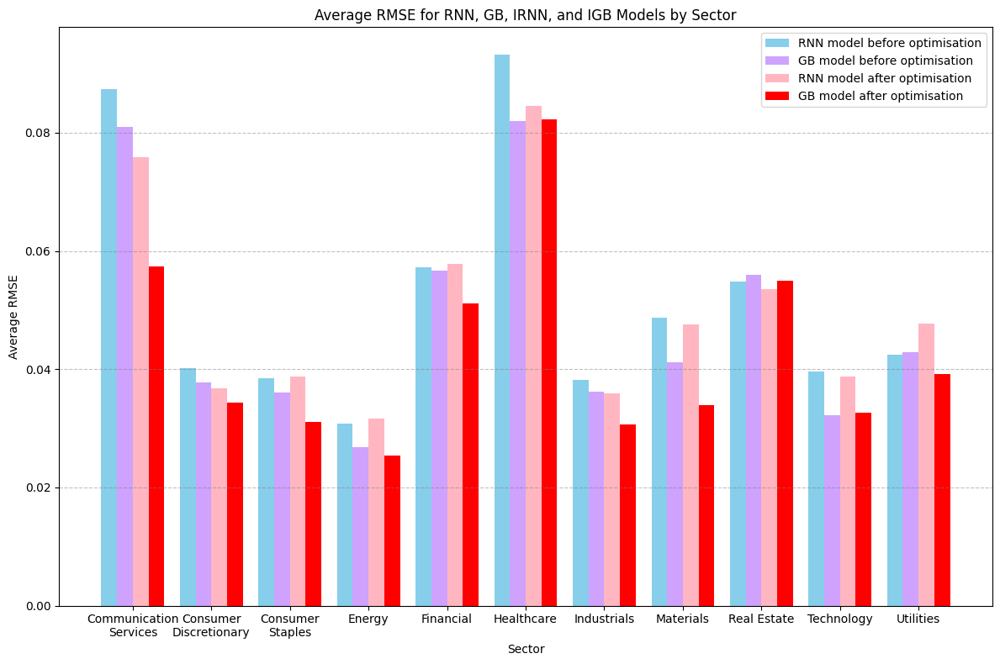

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import textwrap

# RMSE data you provided (replace these with your actual arrays if needed)
RNN_rmses_array = [
    RNN_rmses_CommunicationServices,
    RNN_rmses_ConsumerDiscretionary,
    RNN_rmses_ConsumerStaples,
    RNN_rmses_Energy,
    RNN_rmses_Financial,
    RNN_rmses_Healthcare,
    RNN_rmses_Industrials,
    RNN_rmses_Materials,
    RNN_rmses_RealEstate,
    RNN_rmses_Technology,
    RNN_rmses_Utilities
]

GB_rmses_array = [
    GB_rmses_CommunicationServices,
    GB_rmses_ConsumerDiscretionary,
    GB_rmses_ConsumerStaples,
    GB_rmses_Energy,
    GB_rmses_Financial,
    GB_rmses_Healthcare,
    GB_rmses_Industrials,
    GB_rmses_Materials,
    GB_rmses_RealEstate,
    GB_rmses_Technology,
    GB_rmses_Utilities
]

IRNN_rmses_array = [
    IRNN_rmses_CommunicationServices,
    IRNN_rmses_ConsumerDiscretionary,
    IRNN_rmses_ConsumerStaples,
    IRNN_rmses_Energy,
    IRNN_rmses_Financial,
    IRNN_rmses_Healthcare,
    IRNN_rmses_Industrials,
    IRNN_rmses_Materials,
    IRNN_rmses_RealEstate,
    IRNN_rmses_Technology,
    IRNN_rmses_Utilities
]

IGB_rmses_array = [
    IGB_rmses_CommunicationServices,
    IGB_rmses_ConsumerDiscretionary,
    IGB_rmses_ConsumerStaples,
    IGB_rmses_Energy,
    IGB_rmses_Financial,
    IGB_rmses_Healthcare,
    IGB_rmses_Industrials,
    IGB_rmses_Materials,
    IGB_rmses_RealEstate,
    IGB_rmses_Technology,
    IGB_rmses_Utilities
]

# List of sectors (as given by you)
sectors = [
    'Communication Services', 'Consumer Discretionary', 'Consumer Staples',
    'Energy', 'Financial', 'Healthcare', 'Industrials', 'Materials',
    'Real Estate', 'Technology', 'Utilities'
]

# Function to calculate the average RMSE for each sector
def average_rmses(rmses_array):
    return [np.mean(sector_rmses) for sector_rmses in rmses_array]

# Calculate average RMSE for each model (RNN, GB, IRNN, IGB)
RNN_avg_rmses = average_rmses(RNN_rmses_array)
GB_avg_rmses = average_rmses(GB_rmses_array)
IRNN_avg_rmses = average_rmses(IRNN_rmses_array)
IGB_avg_rmses = average_rmses(IGB_rmses_array)

# Set up the plot
fig, ax = plt.subplots(figsize=(12, 8))

# Bar width and positions
bar_width = 0.2
index = np.arange(len(sectors))

# Plotting the bars for the different models
ax.bar(index, RNN_avg_rmses, bar_width, label='RNN model before optimisation', color='skyblue')
ax.bar(index + bar_width, GB_avg_rmses, bar_width, label='GB model before optimisation', color='#cea2fd')
ax.bar(index + 2 * bar_width, IRNN_avg_rmses, bar_width, label='RNN model after optimisation', color='lightpink')
ax.bar(index + 3 * bar_width, IGB_avg_rmses, bar_width, label='GB model after optimisation', color='red')

# Labeling the plot
ax.set_xlabel('Sector')
ax.set_ylabel('Average RMSE')
ax.set_title('Average RMSE for RNN, GB, IRNN, and IGB Models by Sector')

# Wrap the x-axis sector labels
wrapped_sectors = [textwrap.fill(sector, 15) for sector in sectors]  # Wrap text to 15 characters

# Setting x-axis labels to wrapped sector names
ax.set_xticks(index + 1.5 * bar_width)
ax.set_xticklabels(wrapped_sectors, ha='center')

# Adding grid lines
ax.grid(True, axis='y', color=GRID_COLOR, linestyle=GRID_LINESTYLE, alpha=GRID_ALPHA)
# Adding legend
ax.legend()

# Layout optimization
plt.tight_layout()

# Show the plot
plt.show()



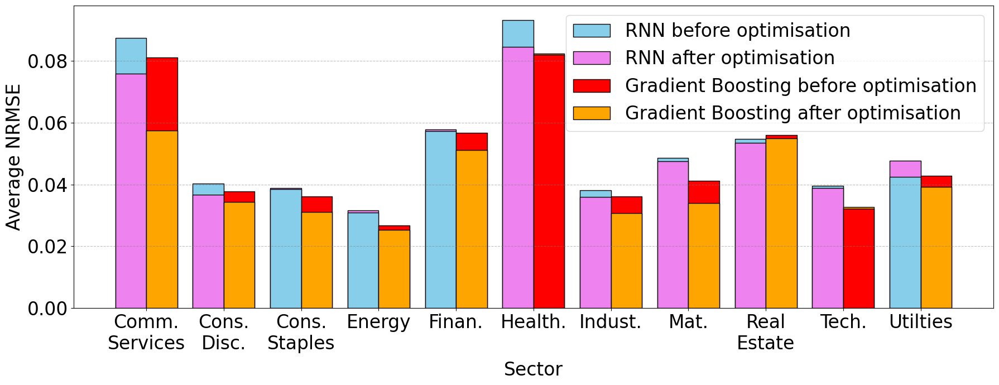

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import textwrap

# Global variables for font sizes and grid
TITLE_FONT_SIZE = 25
x = 23.8
AXIS_LABEL_FONT_SIZE = x
AXIS_TICK_FONT_SIZE = x
LEGEND_FONT_SIZE = x
GRID_COLOR = 'gray'  # Color of grid lines
GRID_LINESTYLE = '--'  # Grid line style
GRID_ALPHA = 0.5  # Transparency of grid lines


sectors = [
    'Communication Services', 'Consumer Discretionary', 'Consumer Staples',
    'Energy', 'Financial', 'Healthcare', 'Industrials', 'Materials',
    'Real Estate', 'Technology', 'Utilities'
]

# Function to calculate the average RMSE for each sector
def average_rmses(rmses_array):
    return [np.mean(sector_rmses) for sector_rmses in rmses_array]

# Calculate average RMSE for each model (RNN, GB, IRNN, IGB)
RNN_avg_rmses = average_rmses(RNN_rmses_array)
GB_avg_rmses = average_rmses(GB_rmses_array)
IRNN_avg_rmses = average_rmses(IRNN_rmses_array)
IGB_avg_rmses = average_rmses(IGB_rmses_array)

# Set up the plot
fig, ax = plt.subplots(figsize=(18, 7))

# Bar width and positions
bar_width = 0.4
index = np.arange(len(sectors))

# Plotting the bars with conditions on whether to put non-optimized or optimized in front
for i in range(len(sectors)):
    # Check if non-optimized (RNN or GB) is better (i.e., lower RMSE) than optimized
    if RNN_avg_rmses[i] > IRNN_avg_rmses[i]:
        # Non-optimized RNN is better, place it in front
        ax.bar(index[i], RNN_avg_rmses[i], bar_width, label='RNN before optimisation' if i == 0 else "", color='skyblue', edgecolor='black')
        ax.bar(index[i], IRNN_avg_rmses[i], bar_width, label='RNN after optimisation' if i == 0 else "", color='violet', edgecolor='black', bottom=0)
    else:
        # Optimized RNN is better, place it in front
        ax.bar(index[i], IRNN_avg_rmses[i], bar_width, label='RNN after optimisation' if i == 0 else "", color='violet', edgecolor='black')
        ax.bar(index[i], RNN_avg_rmses[i], bar_width, label='RNN before optimisation' if i == 0 else "", color='skyblue', edgecolor='black', bottom=0)

    if GB_avg_rmses[i] > IGB_avg_rmses[i]:
        # Non-optimized GB is better, place it in front
        ax.bar(index[i] + bar_width, GB_avg_rmses[i], bar_width, label='Gradient Boosting before optimisation' if i == 0 else "", color='red', edgecolor='black')
        ax.bar(index[i] + bar_width, IGB_avg_rmses[i], bar_width, label='Gradient Boosting after optimisation' if i == 0 else "", color='orange', edgecolor='black', bottom=0)
    else:
        # Optimized GB is better, place it in front
        ax.bar(index[i] + bar_width, IGB_avg_rmses[i], bar_width, label='Gradient Boosting after optimisation' if i == 0 else "", color='orange', edgecolor='black')
        ax.bar(index[i] + bar_width, GB_avg_rmses[i], bar_width, label='Gradient Boosting before optimisation' if i == 0 else "", color='red', edgecolor='black', bottom=0)

# Labeling the plot
ax.set_xlabel('Sector', fontsize=AXIS_LABEL_FONT_SIZE, labelpad=10)
ax.set_ylabel('Average NRMSE', fontsize=AXIS_LABEL_FONT_SIZE)
#ax.set_title('Average NRMSE for RNN and GB Models (Before and After Optimisation) by Sector', fontsize=TITLE_FONT_SIZE)

# Wrap the x-axis sector labels
sectors =["Comm. Services","Cons. Disc.","Cons. Staples","Energy","Finan.","Health.","Indust.","Mat.","Real Estate","Tech.","Utilties"]
wrapped_sectors=[textwrap.fill(sector, 8) for sector in sectors]  # Wrap text to 15 characters

# Setting x-axis labels to wrapped sector names
ax.set_xticks(index + bar_width / 2)
ax.set_xticklabels(wrapped_sectors, ha='center', fontsize=AXIS_TICK_FONT_SIZE)

# Adding legend with customized font size
ax.legend(fontsize=LEGEND_FONT_SIZE)

# Adding grid lines
ax.grid(True, axis='y', color=GRID_COLOR, linestyle=GRID_LINESTYLE, alpha=GRID_ALPHA)

ax.tick_params(axis='y', labelsize=AXIS_TICK_FONT_SIZE)

# Layout optimization
plt.tight_layout()

# Show the plot
plt.show()


**Combined Sector Split NRMSE for VIX and ARCH/GARCH**

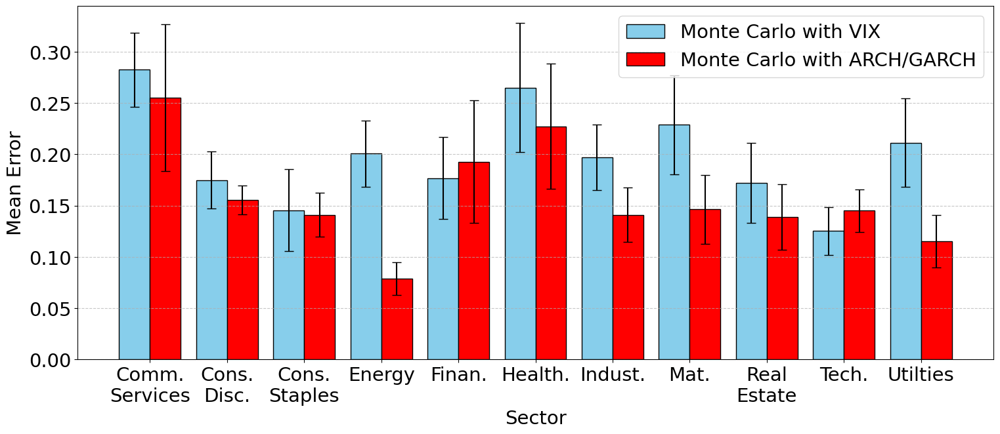

Sector: Comm. Services
BS with VIX: 0.282531 ± 0.036277
BS with ARCH/GARCH: 0.255110 ± 0.071642

Sector: Cons. Disc.
BS with VIX: 0.174964 ± 0.027631
BS with ARCH/GARCH: 0.155487 ± 0.014018

Sector: Cons. Staples
BS with VIX: 0.145587 ± 0.039893
BS with ARCH/GARCH: 0.141114 ± 0.021654

Sector: Energy
BS with VIX: 0.200716 ± 0.032111
BS with ARCH/GARCH: 0.078580 ± 0.015972

Sector: Finan.
BS with VIX: 0.176748 ± 0.039938
BS with ARCH/GARCH: 0.192887 ± 0.060025

Sector: Health.
BS with VIX: 0.265058 ± 0.063112
BS with ARCH/GARCH: 0.227324 ± 0.060920

Sector: Indust.
BS with VIX: 0.197391 ± 0.031936
BS with ARCH/GARCH: 0.141147 ± 0.026414

Sector: Mat.
BS with VIX: 0.228923 ± 0.048301
BS with ARCH/GARCH: 0.146371 ± 0.033349

Sector: Real Estate
BS with VIX: 0.172081 ± 0.039203
BS with ARCH/GARCH: 0.139050 ± 0.031920

Sector: Tech.
BS with VIX: 0.125222 ± 0.023094
BS with ARCH/GARCH: 0.145024 ± 0.020946

Sector: Utilties
BS with VIX: 0.211380 ± 0.043038
BS with ARCH/GARCH: 0.115334 ± 0.025

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def plot_comparison_rmses(bs_vix_errors, bs_ag_errors, sector_list):
    x1=21

    mean_error_vix = [np.mean(errors) for errors in bs_vix_errors]
    std_error_vix = [np.std(errors, ddof=1) / np.sqrt(len(errors)) for errors in bs_vix_errors]

    mean_error_ag = [np.mean(errors) for errors in bs_ag_errors]
    std_error_ag = [np.std(errors, ddof=1) / np.sqrt(len(errors)) for errors in bs_ag_errors]

    x = np.arange(len(sector_list))  # Label locations
    width = 0.4  # Bar width

    plt.figure(figsize=(18, 7))
    plt.bar(x - width/2, mean_error_vix, yerr=std_error_vix, capsize=5, width=width, label='Monte Carlo with VIX', color='skyblue', edgecolor='black')
    plt.bar(x + width/2, mean_error_ag, yerr=std_error_ag, capsize=5, width=width, label='Monte Carlo with ARCH/GARCH', color='red', edgecolor='black')
    sector_list=["Comm. Services","Cons. Disc.","Cons. Staples","Energy","Finan.","Health.","Indust.","Mat.","Real Estate","Tech.","Utilties"]
    plt.xlabel('Sector',fontsize=x1)
    plt.ylabel('Mean Error',fontsize=x1)
    #plt.title('Comparison of Mean Errors for Different Sectors')
    plt.xticks(ticks=x, labels=[label.replace(' ', '\n') for label in sector_list],fontsize=x1)
    plt.yticks(fontsize=x1)
    plt.legend(loc="best", fontsize=x1)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.show()

    # Print Mean Errors
    for i in range(len(sector_list)):
        print(f"Sector: {sector_list[i]}\n"
              f"BS with VIX: {mean_error_vix[i]:.6f} ± {std_error_vix[i]:.6f}\n"
              f"BS with ARCH/GARCH: {mean_error_ag[i]:.6f} ± {std_error_ag[i]:.6f}\n")

# Example Usage:
plot_comparison_rmses(MC_VIX_rmses_array, MC_ARCH_GARCH_rmses_array, sector_list)



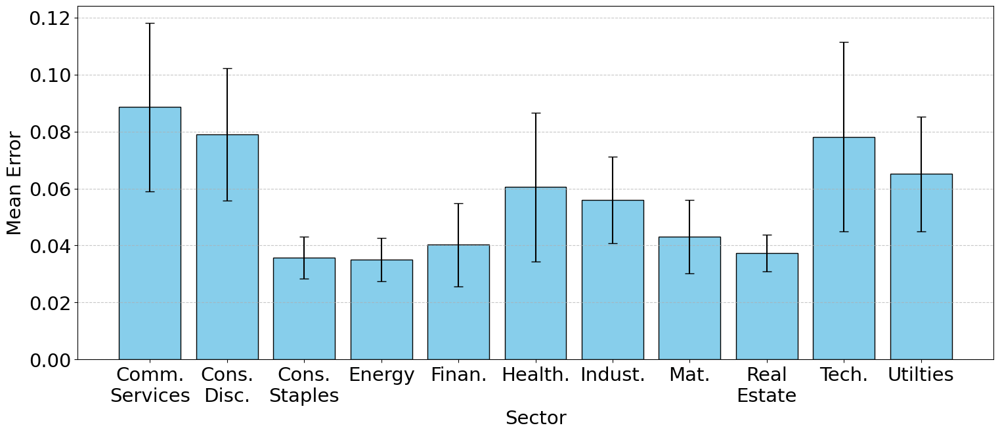

Sector: Comm. Services
BS with VIX: 0.088555 ± 0.029554

Sector: Cons. Disc.
BS with VIX: 0.078975 ± 0.023309

Sector: Cons. Staples
BS with VIX: 0.035723 ± 0.007438

Sector: Energy
BS with VIX: 0.035046 ± 0.007531

Sector: Finan.
BS with VIX: 0.040263 ± 0.014585

Sector: Health.
BS with VIX: 0.060493 ± 0.026053

Sector: Indust.
BS with VIX: 0.055977 ± 0.015267

Sector: Mat.
BS with VIX: 0.043082 ± 0.012941

Sector: Real Estate
BS with VIX: 0.037359 ± 0.006445

Sector: Tech.
BS with VIX: 0.078173 ± 0.033342

Sector: Utilties
BS with VIX: 0.065102 ± 0.020063



In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def plot_rmses(bs_errors, sector_list, method):
    mean_error = [np.mean(errors) for errors in bs_errors]
    std_error = [np.std(errors, ddof=1) / np.sqrt(len(errors)) for errors in bs_errors]

    x = np.arange(len(sector_list))  # Label locations
    width = 0.8  # Bar width
    sector_list=["Comm. Services","Cons. Disc.","Cons. Staples","Energy","Finan.","Health.","Indust.","Mat.","Real Estate","Tech.","Utilties"]
    plt.figure(figsize=(18, 7))
    plt.bar(x, mean_error, yerr=std_error, capsize=5, width=width, label=method, color='skyblue', edgecolor='black')

    plt.xlabel('Sector',fontsize=21)
    plt.ylabel('Mean Error',fontsize=21)
    #plt.title(f'Mean Errors for Different Sectors using {method}')
    plt.xticks(ticks=x, labels=[label.replace(' ', '\n') for label in sector_list],fontsize=21)
    plt.yticks(fontsize=21)
    #plt.legend()
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.show()

    # Print Mean Errors
    for i in range(len(sector_list)):
        print(f"Sector: {sector_list[i]}\n"
              f"{method}: {mean_error[i]:.6f} ± {std_error[i]:.6f}\n")

# Example Usage:
plot_rmses(Heston_rmses_array, sector_list, "BS with VIX")


# **Heston Model**

In [ ]:
def Heston_charfunc(phi, S0, v0, kappa, theta, sigma, rho, lambd, tau, r):
  # constants
    a = kappa*theta
    b = kappa+lambd

    # common terms w.r.t phi
    rspi = rho*sigma*phi*1j

    # define d parameter given phi and b
    d = np.sqrt( (rho*sigma*phi*1j - b)**2 + (phi*1j+phi**2)*sigma**2 )

    # define g parameter given phi, b and d
    g = (b-rspi+d)/(b-rspi-d)

    # calculate characteristic function by components
    exp1 = np.exp(r*phi*1j*tau)
    term2 = S0**(phi*1j) * ( (1-g*np.exp(d*tau))/(1-g) )**(-2*a/sigma**2)
    exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
    #print(exp1,term2,exp2)
    return exp1*term2*exp2

def integrand(phi, S0, v0, kappa, theta, sigma, rho, lambd, tau, r):
    args = (S0, v0, kappa, theta, sigma, rho, lambd, tau, r)
    numerator = np.exp(r*tau)*Heston_charfunc(phi-1j,*args) - K*Heston_charfunc(phi,*args)
    denominator = 1j*phi*K**(1j*phi)
    return numerator/denominator

def Heston_price_rec(S0, K, v0, kappa, theta, sigma, rho, lambd, tau, r):
    args = (S0, v0, kappa, theta, sigma, rho, lambd, tau, r)

    P, umax, N = 0, 100,  1000

    dphi=umax/N #dphi is width
    for i in range(1,N):
        # rectangular integration
        phi = dphi * (2*i + 1)/2 # midpoint to calculate height
        numerator = np.exp(r*tau)*Heston_charfunc(phi-1j,*args) - K * Heston_charfunc(phi,*args)
        denominator = 1j*phi*K**(1j*phi)

        P += dphi * numerator/denominator

    return np.real((S0 - K*np.exp(-r*tau))/2 + P/np.pi)

# This is the calibration function
# heston_price(S0, K, v0, kappa, theta, sigma, rho, lambd, tau, r)
# Parameters are v0, kappa, theta, sigma, rho, lambd

params = {"v0": {"x0": 0.1, "lbub": [1e-3,0.1]},
          "kappa": {"x0": 3, "lbub": [1e-3,5]},
          "theta": {"x0": 0.05, "lbub": [1e-3,0.1]},
          "sigma": {"x0": 0.3, "lbub": [1e-2,1]},
          "rho": {"x0": -0.8, "lbub": [-1,0]},
          "lambd": {"x0": 0.03, "lbub": [-1,1]},
          }
x0 = [param["x0"] for key, param in params.items()]
bnds = [param["lbub"] for key, param in params.items()]



def Heston(Sector,main_data,other_data,training_days=1):
  #Initialise data frame
  Sector_option_prices=pd.DataFrame({})
  #Get all tickers for the sector
  ticker_list=return_tickers(Sector)
  #Get a list of dates between 2 globally defined dates for which we are looking at
  filtered_dates = main_data[(main_data['Date'] >= start_date) & (main_data['Date'] <= end_date)]['Date'].tolist()
  #Add these dates to our data frame
  Sector_option_prices['Date']=filtered_dates
  #print(ticker_list)
  #Loop through all the tickers
  for ticker in ticker_list:
    print(ticker)
    #Initialise some lists where we temporarily store data for a particular company before adding to date frame
    option_prices=[]
    valid_dates=[]
    #Get strike price of option
    K=other_data.loc[other_data['Ticker'] == ticker, 'Strike'].values[0]
    #Get expiration date of option
    expiry=other_data.loc[other_data['Ticker'] == ticker, 'Expirations'].values[0]
    for date in filtered_dates:

      df_fitdata=pd.DataFrame({})
      #Get time to expiry and convert to years. Note the use of trading days
      tau= np.busday_count(date.date(), pd.Timestamp(expiry).date())/252

      #Check if either stock or option price is not not available for that day. We will go to next date if this is true.
      if pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_stock']).any() or pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_option']).any() or tau<=0:
        continue
      valid_dates.append(date)
      #Obtain stock price for that day
      start=date - pd.tseries.offsets.BDay(training_days)
      end=date - pd.tseries.offsets.BDay(1)
      business_dates = pd.bdate_range(start=start, end=date).tolist()
      filtered_df1 = main_data[(main_data['Date'].isin(business_dates))][['Date', ticker + '_stock']]
      filtered_df2 = main_data[(main_data['Date'].isin(business_dates))][['Date', 'Rates']]
      filtered_df3=main_data[(main_data['Date'].isin(business_dates))][['Date', ticker+'_option']]
      df_fitdata=pd.merge(filtered_df1,filtered_df2,on='Date', how='inner')
      df_fitdata=pd.merge(df_fitdata,filtered_df3,on='Date', how='inner')
      df_fitdata=df_fitdata.dropna()

      dates=df_fitdata['Date'].to_numpy(dtype='datetime64[D]')
      taus=np.busday_count(dates, pd.Timestamp(expiry).date())/252
      S0s=df_fitdata[ticker + '_stock'].to_numpy('float')
      rs=df_fitdata['Rates'].to_numpy('float')/100
      ps=df_fitdata[ticker + '_option'].to_numpy('float')
      K=other_data.loc[other_data['Ticker'] == ticker, 'Strike'].values[0]

      def SqErr(x):
          v0, kappa, theta, sigma, rho, lambd = [param for param in x]
          #print("1")
          # Decided to use rectangular integration function in the end
          err = np.sum( (ps-Heston_price_rec(S0s, K, v0, kappa, theta, sigma, rho, lambd, taus, rs))**2 /ps.shape[0] )
          #print("2")
          # Zero penalty term - no good guesses for parameters
          pen = 0 #np.sum( [(x_i-x0_i)**2 for x_i, x0_i in zip(x, x0)] )
          return err + pen

      result = minimize(SqErr, x0, tol = 1e-3, method='SLSQP', options={'maxiter': 1e4 }, bounds=bnds)
      v0, kappa, theta, sigma, rho, lambd = [param for param in result.x]
      #print(v0, kappa, theta, sigma, rho, lambd)
      #print(tau*252)
      rpercent=main_data.loc[main_data['Date'] == date, 'Rates'].values[0]
      r= rpercent/100
      S=main_data.loc[main_data['Date'] == date, ticker+'_stock'].values[0]
      Heston_prices = Heston_price_rec(S, K, v0, kappa, theta, sigma, rho, lambd, tau, r)

      if abs(rho) < 1e-2 and abs(v0 - theta) < 1e-3 and sigma < 1e-2:
        from scipy.stats import norm
        d1 = (np.log(S/K) + (r + 0.5 * theta) * tau) / np.sqrt(theta * tau)
        d2 = d1 - np.sqrt(theta * tau)
        bs_price = S * norm.cdf(d1) - K * np.exp(-r * tau) * norm.cdf(d2)
        diff = abs(Heston_prices - bs_price)
        print(f"Black-Scholes approx: {bs_price:.4f}, Heston: {Heston_prices:.4f}, Diff: {diff:.6f}")

      option_prices.append(Heston_prices)
      df_temp=pd.DataFrame({})
      df_temp['Date']=valid_dates
      df_temp[ticker+'_Heston_option']=option_prices
    Sector_option_prices=pd.merge(Sector_option_prices,df_temp,on='Date', how='outer')
  return Sector_option_prices





In [ ]:
def test_benchop_heston():
    # BENCHOP parameters
    K = 100
    tau = 1.0
    r = 0.0
    v0 = 0.114
    kappa = 2.58
    theta = 0.043
    sigma = 1.0
    rho = -0.36
    lambd = 0.0  # assumption

    # Benchmark cases
    test_cases = [
        {"S": 75,  "expected": 0.908502728459621},
        {"S": 100, "expected": 9.046650119220969},
        {"S": 125, "expected": 28.514786399298796},
    ]

    for case in test_cases:
        price = Heston_price_rec(case["S"], K, v0, kappa, theta, sigma, rho, lambd, tau, r)
        diff = abs(price - case["expected"])
        rel_diff = diff / case["expected"]
        print(f"S = {case['S']:3} | Computed = {price:.10f} | Expected = {case['expected']:.10f} | Abs Diff = {diff:.2e} | Rel Diff = {rel_diff:.2%}")
test_benchop_heston()



S =  75 | Computed = 0.4963993106 | Expected = 0.9085027285 | Abs Diff = 4.12e-01 | Rel Diff = 45.36%
S = 100 | Computed = 8.8386201411 | Expected = 9.0466501192 | Abs Diff = 2.08e-01 | Rel Diff = 2.30%
S = 125 | Computed = 28.1044074617 | Expected = 28.5147863993 | Abs Diff = 4.10e-01 | Rel Diff = 1.44%


In [ ]:
Heston_test=Heston('Technology',df_main_Technology,df_other_Technology)

AVGO


<ipython-input-20-d6d44866d90a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-20-d6d44866d90a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-20-d6d44866d90a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-20-d6d44866d90a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-20-d6d44866d90a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-20-d6d44866d90a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-20-d6d44866d90a>:18: RuntimeWarning: overflow encountered in exp
  exp

CRM


<ipython-input-20-d6d44866d90a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-20-d6d44866d90a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-20-d6d44866d90a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-20-d6d44866d90a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-20-d6d44866d90a>:36: RuntimeWarning: invalid value encountered in multiply
  numerator = np.exp(r*tau)*Heston_charfunc(phi-1j,*args) - K * Heston_charfunc(phi,*args)
<ipython-input-20-d6d44866d90a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-20-d

KeyboardInterrupt: 

In [ ]:
Heston_test.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Heston_Technology.xlsx", index=False)

In [ ]:
Heston_CommunicationServices=Heston('Communication Services',df_main_CommunicationServices,df_other_CommunicationServices)

GOOG


<ipython-input-43-1b4664ef8624>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-43-1b4664ef8624>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-43-1b4664ef8624>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-43-1b4664ef8624>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-43-1b4664ef8624>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-43-1b4664ef8624>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-43-1b4664ef8624>:18: RuntimeWarning: overflow encountered in exp
  exp

GOOGL


<ipython-input-43-1b4664ef8624>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-43-1b4664ef8624>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-43-1b4664ef8624>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-43-1b4664ef8624>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-43-1b4664ef8624>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-43-1b4664ef8624>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-43-1b4664ef8624>:18: RuntimeWarning: overflow encountered in exp
  exp

META


/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:434: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:438: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  g = append(wrapped_grad(x), 0.0)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:434: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:438: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  g = append(wrapped_grad(x), 0.0)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:434: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
/usr/local/lib/python3.11/dist-packages/scip

NFLX


/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:434: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:438: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  g = append(wrapped_grad(x), 0.0)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:434: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:438: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  g = append(wrapped_grad(x), 0.0)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:434: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
/usr/local/lib/python3.11/dist-packages/scip

FOX
TTWO


<ipython-input-43-1b4664ef8624>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-43-1b4664ef8624>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-43-1b4664ef8624>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-43-1b4664ef8624>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-43-1b4664ef8624>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-43-1b4664ef8624>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-43-1b4664ef8624>:18: RuntimeWarning: overflow encountered in exp
  exp

TMUS


<ipython-input-43-1b4664ef8624>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-43-1b4664ef8624>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-43-1b4664ef8624>:36: RuntimeWarning: invalid value encountered in multiply
  numerator = np.exp(r*tau)*Heston_charfunc(phi-1j,*args) - K * Heston_charfunc(phi,*args)
<ipython-input-43-1b4664ef8624>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-43-1b4664ef8624>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:434: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
/usr/local/lib/python3.

NewDIS


<ipython-input-43-1b4664ef8624>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-43-1b4664ef8624>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-43-1b4664ef8624>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-43-1b4664ef8624>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-43-1b4664ef8624>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-43-1b4664ef8624>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-43-1b4664ef8624>:18: RuntimeWarning: overflow encountered in exp
  exp

In [ ]:
Heston_CommunicationServices.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Heston_CommunicationServices.xlsx", index=False)

In [ ]:
Heston_ConsumerDiscretionary=Heston('Consumer Discretionary',df_main_ConsumerDiscretionary,df_other_ConsumerDiscretionary)

ABNB


<ipython-input-10-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-10-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
<ipython-input-10-d5f8d2fba21a>:36: RuntimeWarning: invalid value encountered in multiply
  numerator = np.exp(r*tau)*Heston_charfunc(phi-1j,*args) - K * Heston_charfunc(phi,*args)
<ipython-input-10-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-10-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-10-d5f8d

AMZN


<ipython-input-10-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-10-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-10-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-10-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-10-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-10-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-10-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp

HD


<ipython-input-10-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-10-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-10-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-10-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-10-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-10-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-10-d5f8d2fba21a>:36: RuntimeWarning: invalid value encountered in mult

NKE


<ipython-input-10-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-10-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
<ipython-input-10-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-10-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-10-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input

TSLA


/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
<ipython-input-10-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-10-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-10-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-10-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-10-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input

BWA


<ipython-input-10-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-10-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-10-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-10-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
<ipython-input-10-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input

WYNN


<ipython-input-10-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-10-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-10-d5f8d2fba21a>:36: RuntimeWarning: invalid value encountered in multiply
  numerator = np.exp(r*tau)*Heston_charfunc(phi-1j,*args) - K * Heston_charfunc(phi,*args)
<ipython-input-10-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-10-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-10-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-10-d

MGM


<ipython-input-10-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-10-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
<ipython-input-10-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-10-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-10-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input

In [ ]:
Heston_ConsumerDiscretionary.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Heston_ConsumerDiscretionary.xlsx", index=False)

In [ ]:
Heston_ConsumerStaples=Heston('Consumer Staples',df_main_ConsumerStaples,df_other_ConsumerStaples)

CL


<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5

KO


<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Va

PG


/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:441: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  g = append(wrapped_grad(x), 0.0)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:441: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  g = append(wrapped_grad(x), 0.0)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
/usr/local/lib/python3.11/dist-packages/scip

TGT


<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
<ipython-input-9-d5f8d

SYY


<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.

DG


<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:36: RuntimeWarning: invalid value encountered in multiply
  numerator = np.exp(r*tau)*Heston_charfunc(phi-1j,*args) - K * Heston_charfunc(phi,*args)
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fb

HSY


<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Va

NewWMT


<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.

In [ ]:
Heston_ConsumerStaples.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Heston_ConsumerStaples.xlsx", index=False)

In [ ]:
Heston_Energy=Heston('Energy',df_main_Energy,df_other_Energy)

SLB


<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.

PSX


<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.

WMB


/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:441: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  g = append(wrapped_grad(x), 0.0)


MPC


<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
<ipython-input-9-d5f8d

OXY


<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.

NewAPA


<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
<ipython-input-9-d5f8d

NewEOG


<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:36: RuntimeWarning: invalid value encountered in multiply
  numerator = np.exp(r*tau)*Heston_charfunc(phi-1j,*args) - K * Heston_charfunc(phi,*args)
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fb

In [ ]:
Heston_Energy.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Heston_Energy.xlsx", index=False)

In [ ]:
Heston_Financial=Heston('Financial',df_main_Financial,df_other_Financial)

GS


<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Va

JPM


<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.

BEN
CFG


/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
<ipython-input-9-d5f8d

NewV


<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.

NewWFC


<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5

NewIVZ
NewBAC


In [ ]:
Heston_Financial.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Heston_Financial.xlsx", index=False)

In [ ]:
Heston_Healthcare=Heston('Healthcare',df_main_Healthcare,df_other_Healthcare)

ABBV


<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.

ABT


<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Va

ISRG


<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.

LLY


<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
/usr/local/lib/python3

PFE


<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.

UNH


/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:43

CNC


<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5

COR


/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:36: RuntimeWarning: invalid value encountered in multiply
  numerator = np.exp(r*tau)*Heston_charfunc(phi-1j,*args) - K * Heston_charfunc(phi,*args)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encounte

NewDXCM


/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:441: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  g = append(wrapped_grad(x), 0.0)
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:36: RuntimeWarning: invalid value encountered in multiply
  numerator = np.exp(r*tau)*Heston_charfunc(phi-1j,*args) - K * Heston_charfunc(phi,*args)
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rsp

In [ ]:
Heston_Healthcare.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Heston_Healthcare.xlsx", index=False)

In [ ]:
Heston_Industrials=Heston('Industrials',df_main_Industrials,df_other_Industrials)

CAT


<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5

GE


<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.

RTX


<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Va

UBER


<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.

UNP


/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5

BLDR


/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:441: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  g = append(wrapped_grad(x), 0.0)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:441: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  g = append(wrapped_grad(x), 0.0)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
/usr/local/lib/python3.11/dist-packages/scip

CHRW


<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:441: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  g = append(wrapped_grad(x), 0.0)
<ipython-

PAYC


<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:36: RuntimeWarning: invalid value encountered in multiply
  numerator = np.exp(r*tau)*Heston_charfunc(phi-1j,*args) - K * Heston_charfunc(phi,*args)
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fb

In [ ]:
Heston_Industrials.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Heston_Industrials.xlsx", index=False)

In [ ]:
Heston_Materials=Heston('Materials',df_main_Materials,df_other_Materials)

DD


<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.

FCX
LIN


/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( 

VMC


<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.

BALL


<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.

CF


<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.

FMC


<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-9-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-9-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
<ipython-input-9-d5f8d2fba21a>:36: RuntimeWarning: invalid value encountered in multiply
  numerator = np.exp(r*tau)*Heston_charfunc(phi-1j,*args) - K * Heston_charfunc(phi,*args)
<ipython-input-9-d5f8d2fba21

In [ ]:
Heston_Materials.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Heston_Materials.xlsx", index=False)

In [ ]:
Heston_RealEstate=Heston('Real Estate',df_main_RealEstate,df_other_RealEstate)

CBRE


/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5

DLR


<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.

IRM


<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5

PLD


<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5

SPG


<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.

ARE


<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.

EQR


<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:441: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  g = append(wrapped_grad(x), 0.0)
<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-

VTR


<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.

In [ ]:
Heston_RealEstate.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Heston_RealEstate.xlsx", index=False)

In [ ]:
Heston_Utilities=Heston('Utilities',df_main_Utilities,df_other_Utilities)

AEP


<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-7-d5f8d2fba21a>:36: RuntimeWarning: invalid value encountered in multiply
  numerator = np.exp(r*tau)*Heston_charfunc(phi-1j,*args) - K * Heston_charfunc(phi,*args)
<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5f8d2fb

CEG


<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Va

CNP
ED


<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-7-d5f8d2fba21a>:36: RuntimeWarning: invalid value encountered in multiply
  numerator = np.exp(r*tau)*Heston_charfunc(phi-1j,*args) - K * Heston_charfunc(phi,*args)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
<ipython-input-7-d5f8d2fba21

SO


<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-7-d5f8d2fba21a>:36: RuntimeWarning: invalid value encountered in multiply
  numerator = np.exp(r*tau)*Heston_charfunc(phi-1j,*args) - K * Heston_charfunc(phi,*args)
<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5f8d2fb

AES


/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
<ipython-input-7-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-7-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
/usr/local/lib/python3

In [ ]:
Heston_Utilities.to_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Heston_Utilities.xlsx", index=False)

In [ ]:
Heston_CommunicationServices=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Heston_CommunicationServices.xlsx")
Heston_ConsumerDiscretionary=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Heston_ConsumerDiscretionary.xlsx")
Heston_ConsumerStaples=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Heston_ConsumerStaples.xlsx")
Heston_Energy=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Heston_Energy.xlsx")
Heston_Financial=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Heston_Financial.xlsx")
Heston_Healthcare=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Heston_Healthcare.xlsx")
Heston_Industrials=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Heston_Industrials.xlsx")
Heston_Materials=pd.read_excel  ("/content/drive/My Drive/MSci Project/Saved Dataframes/Heston_Materials.xlsx")
Heston_RealEstate=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Heston_RealEstate.xlsx")
Heston_Technology=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Heston_Technology.xlsx")
Heston_Utilities=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Heston_Utilities.xlsx")
import pandas as pd

# List of all sector dataframes
sectors = [
    ("CommunicationServices", Heston_CommunicationServices),
    ("ConsumerDiscretionary", Heston_ConsumerDiscretionary),
    ("ConsumerStaples", Heston_ConsumerStaples),
    ("Energy", Heston_Energy),
    ("Financial", Heston_Financial),
    ("Healthcare", Heston_Healthcare),
    ("Industrials", Heston_Industrials),
    ("Materials", Heston_Materials),
    ("RealEstate", Heston_RealEstate),
    ("Technology", Heston_Technology),
    ("Utilities", Heston_Utilities)
]

# Apply price floor to all Heston option prices in the sector dataframes
for sector_name, sector_df in sectors:
    # Loop through columns and apply price floor
    for column in sector_df.columns:
        if "Heston_option" in column:  # Identify columns with option prices
            sector_df[column] = sector_df[column].apply(lambda x: max(0, x))  # Apply floor

    # Optionally save the modified dataframe back to Excel or any other format
    sector_df.to_excel(f"/content/drive/My Drive/MSci Project/Saved Dataframes/Heston_{sector_name}_Modified.xlsx", index=False)




In [ ]:
Heston_CommunicationServices=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Heston_CommunicationServices_Modified.xlsx")
Heston_ConsumerDiscretionary=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Heston_ConsumerDiscretionary_Modified.xlsx")
Heston_ConsumerStaples=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Heston_ConsumerStaples_Modified.xlsx")
Heston_Energy=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Heston_Energy_Modified.xlsx")
Heston_Financial=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Heston_Financial_Modified.xlsx")
Heston_Healthcare=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Heston_Healthcare_Modified.xlsx")
Heston_Industrials=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Heston_Industrials_Modified.xlsx")
Heston_Materials=pd.read_excel  ("/content/drive/My Drive/MSci Project/Saved Dataframes/Heston_Materials_Modified.xlsx")
Heston_RealEstate=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Heston_RealEstate_Modified.xlsx")
Heston_Technology=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Heston_Technology_Modified.xlsx")
Heston_Utilities=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/Heston_Utilities_Modified.xlsx")

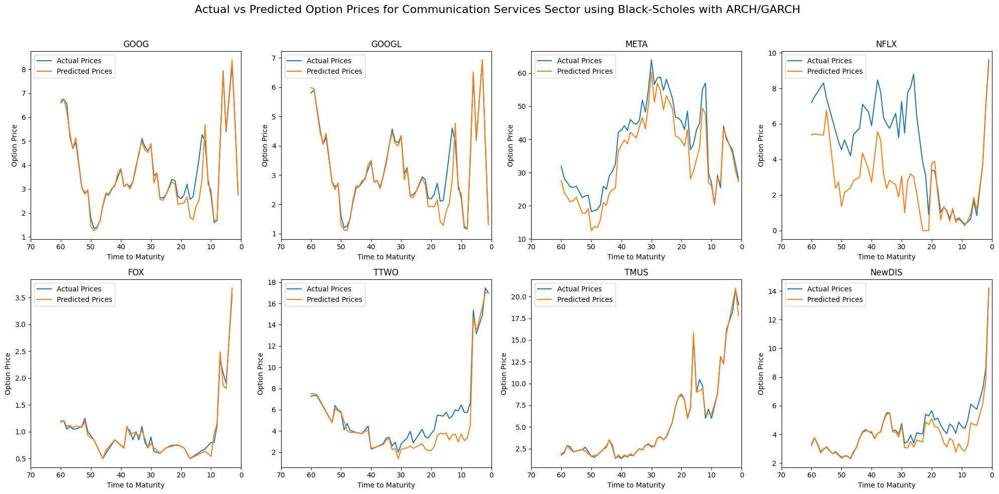

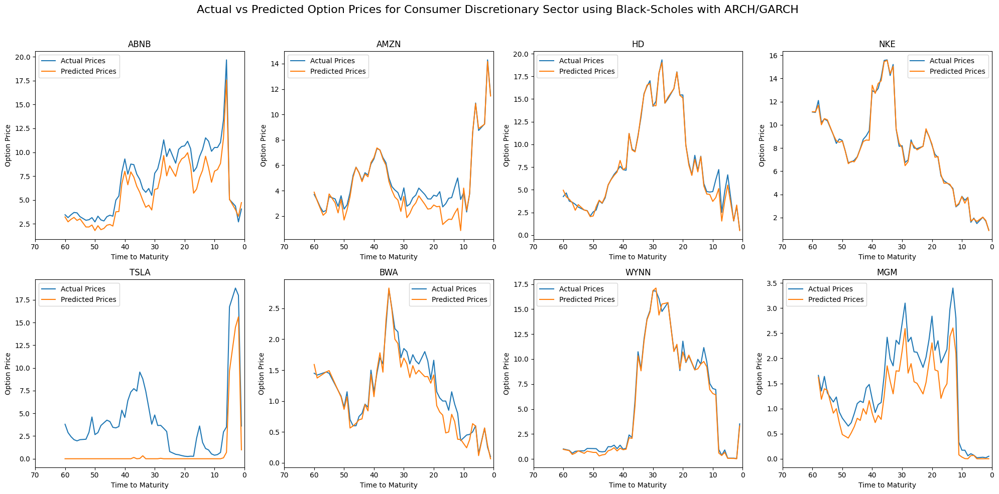

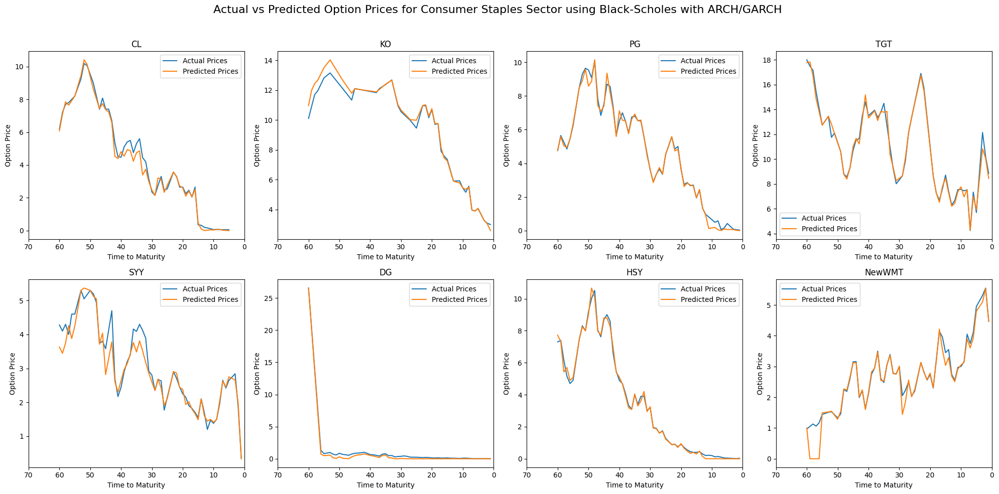

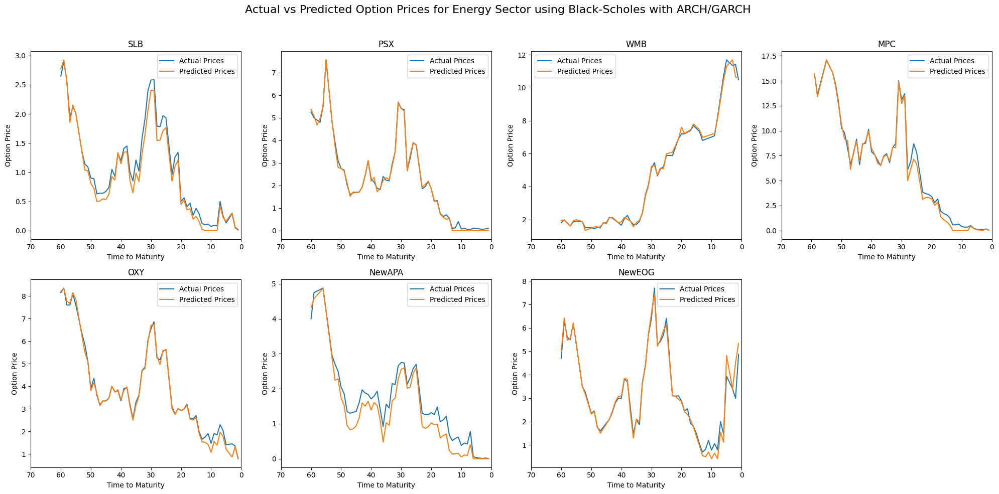

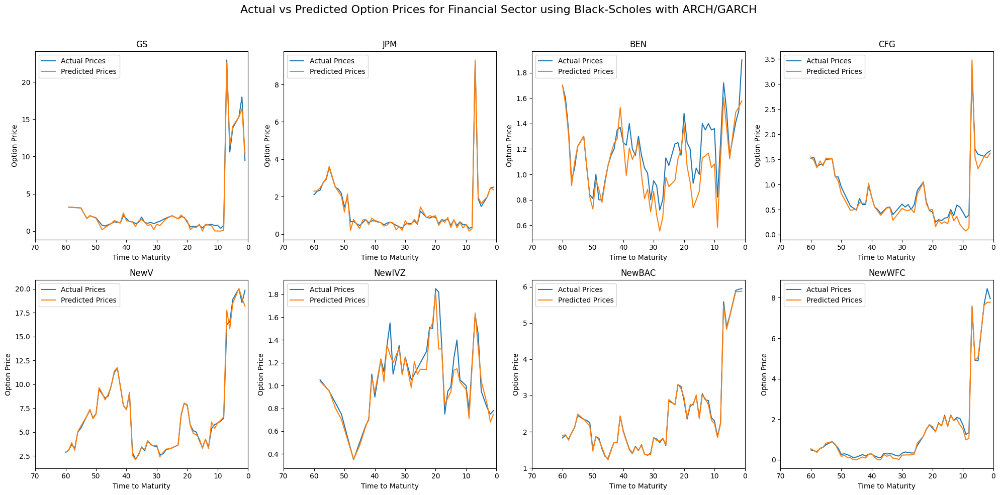

...

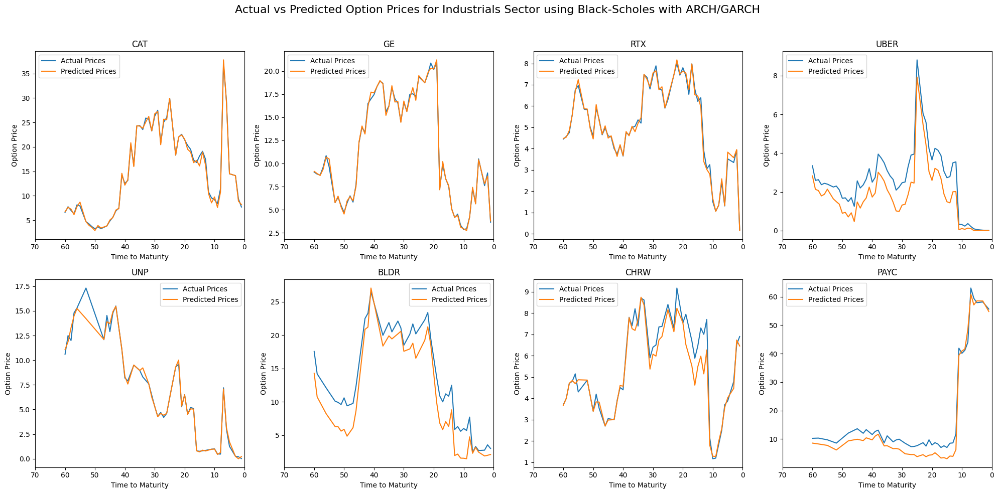

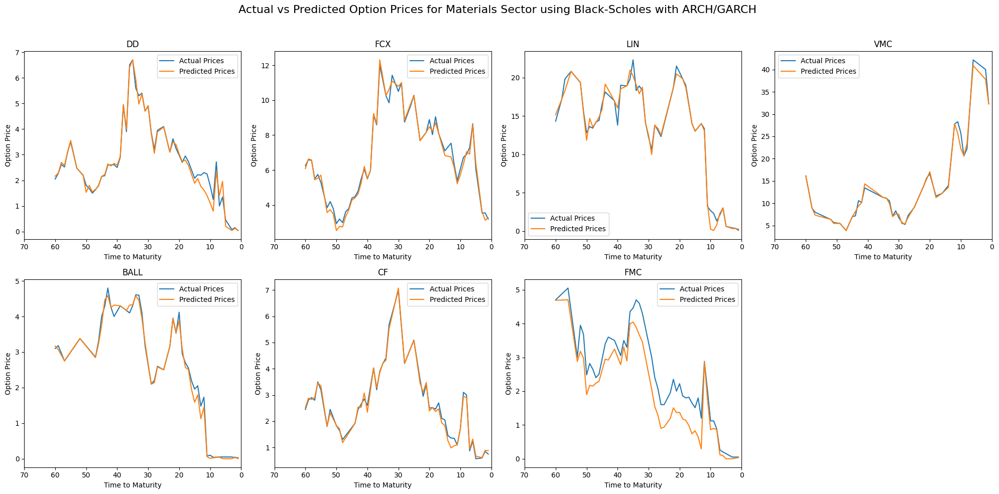

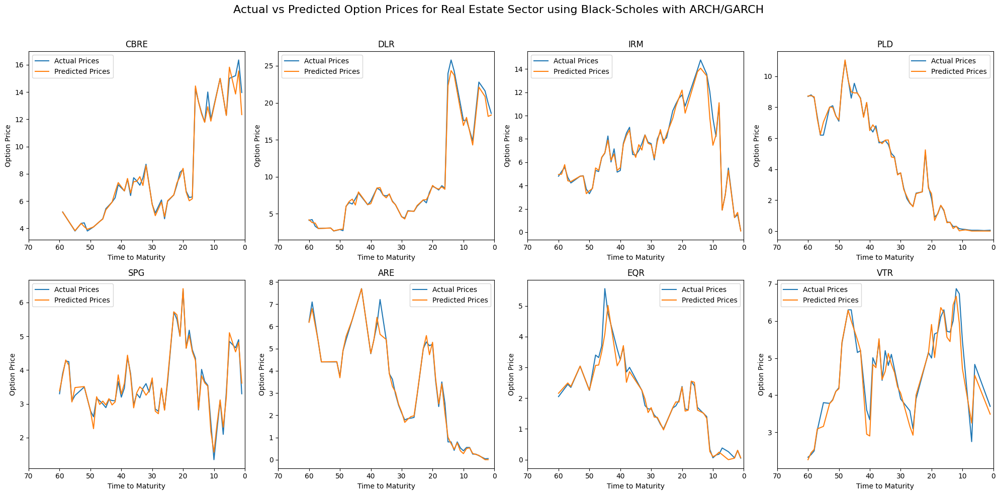

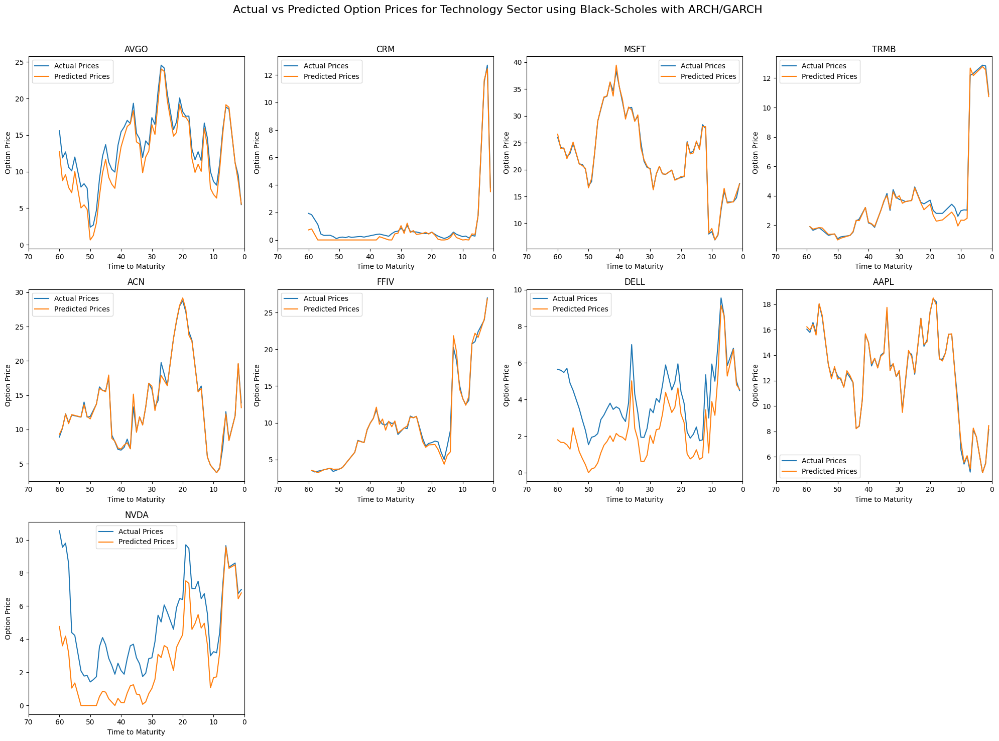

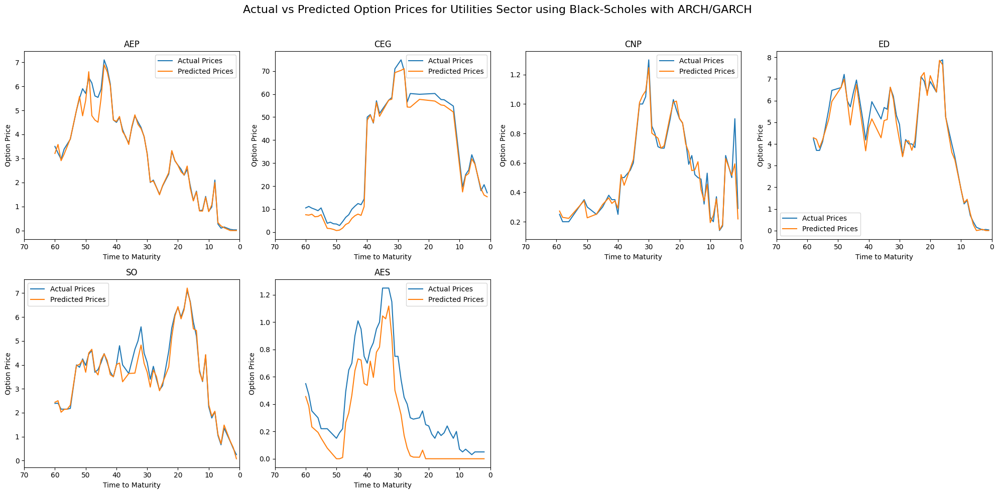

In [ ]:
plot_actual_vs_predicted('Communication Services',df_main_CommunicationServices,df_other_CommunicationServices,Heston_CommunicationServices,'Heston')
plot_actual_vs_predicted('Consumer Discretionary',df_main_ConsumerDiscretionary,df_other_ConsumerDiscretionary,Heston_ConsumerDiscretionary,'Heston')
plot_actual_vs_predicted('Consumer Staples',df_main_ConsumerStaples,df_other_ConsumerStaples,Heston_ConsumerStaples,'Heston')
plot_actual_vs_predicted('Energy',df_main_Energy,df_other_Energy,Heston_Energy,'Heston')
plot_actual_vs_predicted('Financial',df_main_Financial,df_other_Financial,Heston_Financial,'Heston')
plot_actual_vs_predicted('Healthcare',df_main_Healthcare,df_other_Healthcare,Heston_Healthcare,'Heston')
plot_actual_vs_predicted('Industrials',df_main_Industrials,df_other_Industrials,Heston_Industrials,'Heston')
plot_actual_vs_predicted('Materials',df_main_Materials,df_other_Materials,Heston_Materials,'Heston')
plot_actual_vs_predicted('Real Estate',df_main_RealEstate,df_other_RealEstate,Heston_RealEstate,'Heston')
plot_actual_vs_predicted('Technology',df_main_Technology,df_other_Technology,Heston_Technology,'Heston')
plot_actual_vs_predicted('Utilities',df_main_Utilities,df_other_Utilities,Heston_Utilities,'Heston')

Communication Services
GOOG 0.06421392558783245
GOOGL 0.07282701885715484
META 0.10631265993180669
NFLX 0.2831590194628794
FOX 0.027686234194898157
TTWO 0.08103324933012104
TMUS 0.017542113045517886
NewDIS 0.055666238912123134
Consumer Discretionary
ABNB 0.09020850344728701
AMZN 0.06671167379590172
HD 0.02837775309789775
NKE 0.013981064604252795
TSLA 0.21484700987997496
BWA 0.06653978399932539
WYNN 0.026952031198636022
MGM 0.1241793500268041
Consumer Staples
CL 0.03092749811442298
KO 0.036513432643515455
PG 0.0253575123588758
TGT 0.02769048543390028
SYY 0.062465537945596485
DG 0.011228947626246119
HSY 0.019486481495824923
NewWMT 0.07211174107543787
Energy
SLB 0.046544060617134425
PSX 0.015080676513533306
WMB 0.017653240445156596
MPC 0.02781110012897035
OXY 0.023625483232662784
NewAPA 0.07099748977613303
NewEOG 0.04360684200782022
Financial
GS 0.019303714905566732
JPM 0.013966962659962568
BEN 0.12800390888350777
CFG 0.03914889112963458
NewV 0.020106335513006494
NewIVZ 0.0748596345063106

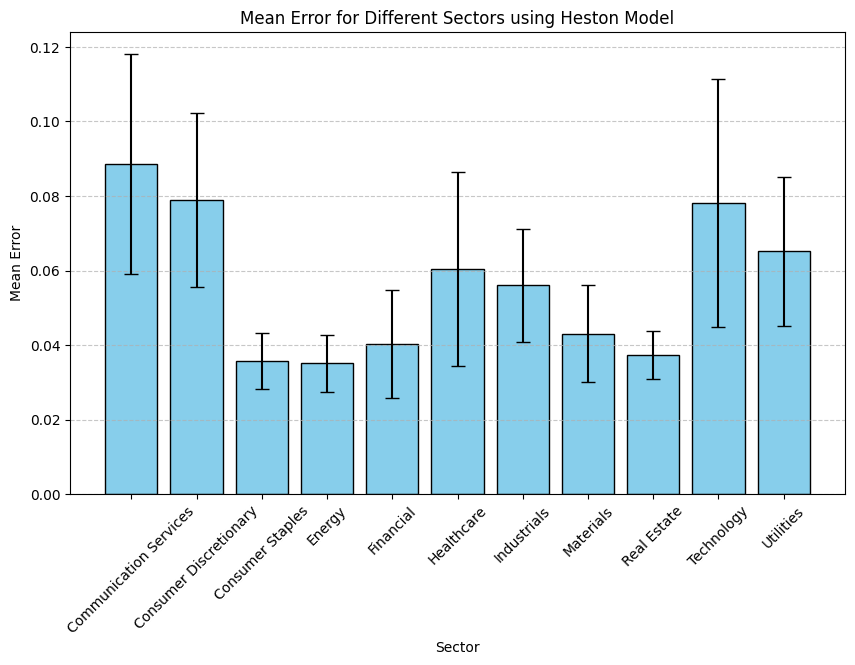

Mean error using Heston Model for sector Communication Services is: 0.088555 ± 0.029554
Mean error using Heston Model for sector Consumer Discretionary is: 0.078975 ± 0.023309
Mean error using Heston Model for sector Consumer Staples is: 0.035723 ± 0.007438
Mean error using Heston Model for sector Energy is: 0.035046 ± 0.007531
Mean error using Heston Model for sector Financial is: 0.040263 ± 0.014585
Mean error using Heston Model for sector Healthcare is: 0.060493 ± 0.026053
Mean error using Heston Model for sector Industrials is: 0.055977 ± 0.015267
Mean error using Heston Model for sector Materials is: 0.043082 ± 0.012941
Mean error using Heston Model for sector Real Estate is: 0.037359 ± 0.006445
Mean error using Heston Model for sector Technology is: 0.078173 ± 0.033342
Mean error using Heston Model for sector Utilities is: 0.065102 ± 0.020063


In [ ]:
# Compute RMSE values for Heston model
Heston_rmses_CommunicationServices = RMSE("Communication Services", df_main_CommunicationServices, df_other_CommunicationServices, Heston_CommunicationServices, 'Heston')
Heston_rmses_ConsumerDiscretionary = RMSE("Consumer Discretionary", df_main_ConsumerDiscretionary, df_other_ConsumerDiscretionary, Heston_ConsumerDiscretionary, 'Heston')
Heston_rmses_ConsumerStaples = RMSE("Consumer Staples", df_main_ConsumerStaples, df_other_ConsumerStaples, Heston_ConsumerStaples, 'Heston')
Heston_rmses_Energy = RMSE("Energy", df_main_Energy, df_other_Energy, Heston_Energy, 'Heston')
Heston_rmses_Financial = RMSE("Financial", df_main_Financial, df_other_Financial, Heston_Financial, 'Heston')
Heston_rmses_Healthcare = RMSE("Healthcare", df_main_Healthcare, df_other_Healthcare, Heston_Healthcare, 'Heston')
Heston_rmses_Industrials = RMSE("Industrials", df_main_Industrials, df_other_Industrials, Heston_Industrials, 'Heston')
Heston_rmses_Materials = RMSE("Materials", df_main_Materials, df_other_Materials, Heston_Materials, 'Heston')
Heston_rmses_RealEstate = RMSE("Real Estate", df_main_RealEstate, df_other_RealEstate, Heston_RealEstate, 'Heston')
Heston_rmses_Technology = RMSE("Technology", df_main_Technology, df_other_Technology, Heston_Technology, 'Heston')
Heston_rmses_Utilities = RMSE("Utilities", df_main_Utilities, df_other_Utilities, Heston_Utilities, 'Heston')

# Organize RMSE results into a list
Heston_rmses_array = [
    Heston_rmses_CommunicationServices,
    Heston_rmses_ConsumerDiscretionary,
    Heston_rmses_ConsumerStaples,
    Heston_rmses_Energy,
    Heston_rmses_Financial,
    Heston_rmses_Healthcare,
    Heston_rmses_Industrials,
    Heston_rmses_Materials,
    Heston_rmses_RealEstate,
    Heston_rmses_Technology,
    Heston_rmses_Utilities
]

# Plot RMSE results
plot_rmses_for_method(Heston_rmses_array, sector_list, "Heston Model")


In [ ]:
print(Heston_rmses_CommunicationServices)


[np.float64(0.06421392558783245), np.float64(0.07282701885715484), np.float64(0.10631265993180669), np.float64(0.28617050238956754), np.float64(0.027686234194898157), np.float64(0.08103324933012104), np.float64(0.017542113045517886), np.float64(0.055666238912123134)]


In [ ]:
BS_VIX_rmses=RMSE("Technology",df_main_Technology,BS_VIX_Technology,'VIX')
avg_error=0
for rmse in BS_VIX_rmses:
    avg_error+=rmse
avg_error_BS_VIX=avg_error/len(BS_VIX_rmses)
Heston2_rmses=RMSE("Technology",df_main_Technology,Heston_test2,'Heston2')
avg_error=0
for rmse in Heston2_rmses:
    avg_error+=rmse
avg_error_Heston2=avg_error/len(Heston2_rmses)
#The overfit one took 30 minutes for 3 companies
Heston_rmses=RMSE("Technology",df_main_Technology,Heston_test,'Heston')
avg_error=0
for rmse in Heston_rmses:
    avg_error+=rmse
avg_error_Heston=avg_error/len(Heston_rmses)
print(avg_error_BS_VIX)
print(avg_error_Heston2)
print(avg_error_Heston)

8.326895237231362
4.457720510519549
1.1139623348429681


# **Machine Learning Manipulation**

In [ ]:
GB_CommunicationServices=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/GB_CommunicationServices.xlsx")
GB_ConsumerDiscretionary=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/GB_ConsumerDiscretionary.xlsx")
GB_ConsumerStaples=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/GB_ConsumerStaples.xlsx")
GB_Energy=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/GB_Energy.xlsx")
GB_Financial=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/GB_Financial.xlsx")
GB_Healthcare=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/GB_Healthcare.xlsx")
GB_Industrials=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/GB_Industrials.xlsx")
GB_Materials=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/GB_Materials.xlsx")
GB_RealEstate=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/GB_RealEstate.xlsx")
GB_Technology=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/GB_Technology.xlsx")
GB_Utilities=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/GB_Utilities.xlsx")

RNN_CommunicationServices=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/RNN_CommunicationServices.xlsx")
RNN_ConsumerDiscretionary=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/RNN_ConsumerDiscretionary.xlsx")
RNN_ConsumerStaples=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/RNN_ConsumerStaples.xlsx")
RNN_Energy=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/RNN_Energy.xlsx")
RNN_Financial=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/RNN_Financial.xlsx")
RNN_Healthcare=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/RNN_Healthcare.xlsx")
RNN_Industrials=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/RNN_Industrials.xlsx")
RNN_Materials=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/RNN_Materials.xlsx")
RNN_RealEstate=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/RNN_RealEstate.xlsx")
RNN_Technology=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/RNN_Technology.xlsx")
RNN_Utilities=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/RNN_Utilities.xlsx")

Communication Services
GOOG 0.0684692936935344
GOOGL 0.06914153678055007
META 0.03183083010498263
NFLX 0.1687102969480818
FOX 0.24632642859450019
TTWO 0.026243674995890157
TMUS 0.02637121870388161
NewDIS 0.01098896412333859
Consumer Discretionary
ABNB 0.04531103317512228
AMZN 0.04298176988074452
HD 0.03601106358813779
NKE 0.021053765532253445
TSLA 0.05264154200931808
BWA 0.04473004051152758
WYNN 0.026536538608420614
MGM 0.03327627075470214
Consumer Staples
CL 0.03152930992488479
KO 0.015739366280181973
PG 0.0327544936408712
TGT 0.056851250632312875
SYY 0.052691504441388676
DG 0.04017222393573717
HSY 0.025704949902731193
NewWMT 0.0333780650075776
Energy
SLB 0.018262263903688306
PSX 0.026558855391535918
WMB 0.03932225694248687
MPC 0.023412587154159135
OXY 0.023060686029236135
NewAPA 0.02653875569518559
NewEOG 0.02999461840850406
Financial
GS 0.039378490655140465
JPM 0.02305276577788658
BEN 0.100111147474542
CFG 0.06492182749408659
NewV 0.035253964917251863
NewIVZ 0.16544741419140024
NewB

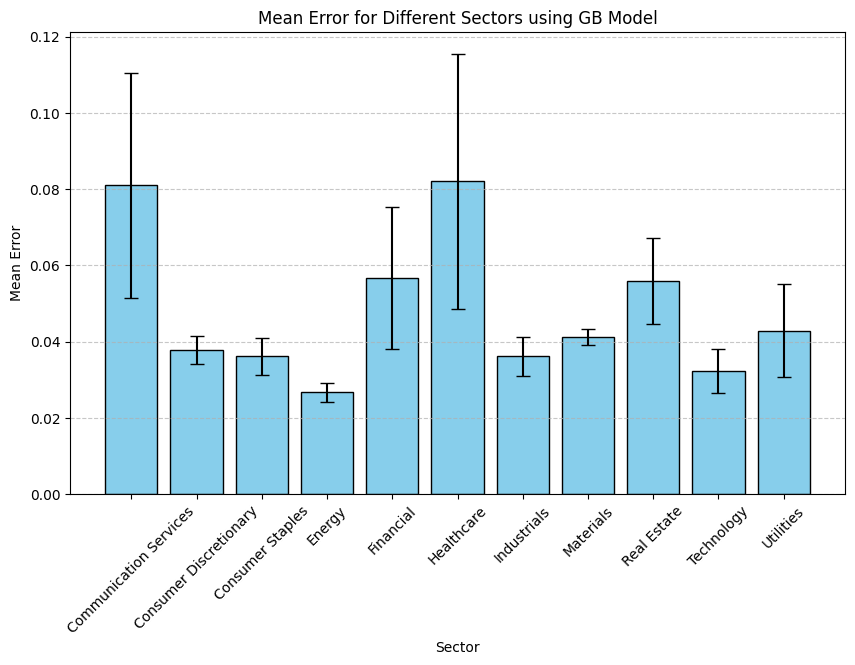

Mean error using GB Model for sector Communication Services is: 0.081010 ± 0.029467
Mean error using GB Model for sector Consumer Discretionary is: 0.037818 ± 0.003738
Mean error using GB Model for sector Consumer Staples is: 0.036103 ± 0.004789
Mean error using GB Model for sector Energy is: 0.026736 ± 0.002514
Mean error using GB Model for sector Financial is: 0.056659 ± 0.018699
Mean error using GB Model for sector Healthcare is: 0.082002 ± 0.033426
Mean error using GB Model for sector Industrials is: 0.036131 ± 0.005150
Mean error using GB Model for sector Materials is: 0.041130 ± 0.002166
Mean error using GB Model for sector Real Estate is: 0.055929 ± 0.011297
Mean error using GB Model for sector Technology is: 0.032227 ± 0.005733
Mean error using GB Model for sector Utilities is: 0.042816 ± 0.012198


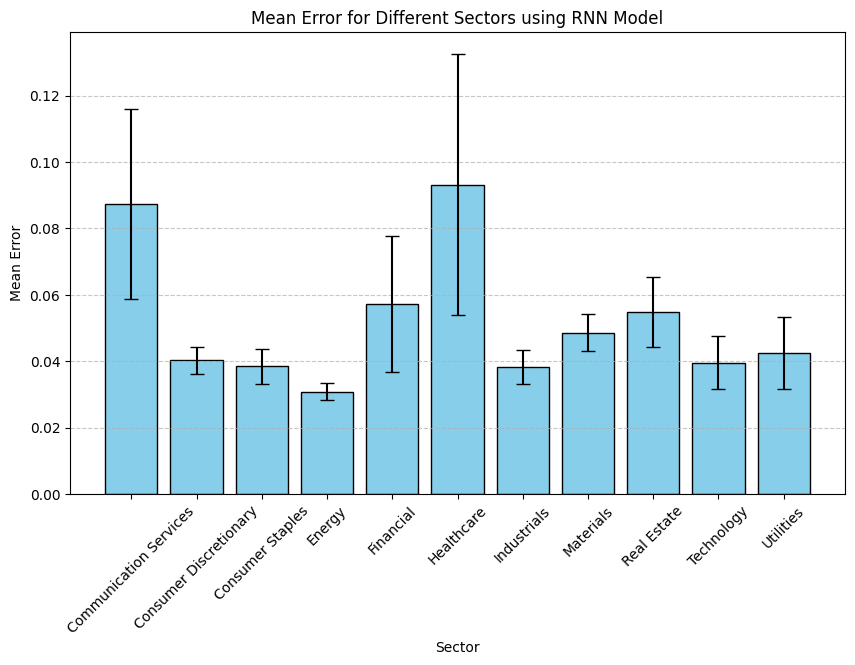

Mean error using RNN Model for sector Communication Services is: 0.087344 ± 0.028634
Mean error using RNN Model for sector Consumer Discretionary is: 0.040230 ± 0.003951
Mean error using RNN Model for sector Consumer Staples is: 0.038423 ± 0.005226
Mean error using RNN Model for sector Energy is: 0.030851 ± 0.002684
Mean error using RNN Model for sector Financial is: 0.057168 ± 0.020397
Mean error using RNN Model for sector Healthcare is: 0.093195 ± 0.039314
Mean error using RNN Model for sector Industrials is: 0.038159 ± 0.005066
Mean error using RNN Model for sector Materials is: 0.048641 ± 0.005594
Mean error using RNN Model for sector Real Estate is: 0.054761 ± 0.010577
Mean error using RNN Model for sector Technology is: 0.039561 ± 0.008002
Mean error using RNN Model for sector Utilities is: 0.042510 ± 0.010836


In [ ]:
GB_rmses_CommunicationServices = RMSE("Communication Services", df_main_CommunicationServices, df_other_CommunicationServices, GB_CommunicationServices, 'ML',sd='2024-09-16')
GB_rmses_ConsumerDiscretionary = RMSE("Consumer Discretionary", df_main_ConsumerDiscretionary, df_other_ConsumerDiscretionary, GB_ConsumerDiscretionary, 'ML',sd='2024-09-16')
GB_rmses_ConsumerStaples = RMSE("Consumer Staples", df_main_ConsumerStaples, df_other_ConsumerStaples, GB_ConsumerStaples, 'ML',sd='2024-09-16')
GB_rmses_Energy = RMSE("Energy", df_main_Energy, df_other_Energy, GB_Energy, 'ML',sd='2024-09-16')
GB_rmses_Financial = RMSE("Financial", df_main_Financial, df_other_Financial, GB_Financial, 'ML',sd='2024-09-16')
GB_rmses_Healthcare = RMSE("Healthcare", df_main_Healthcare, df_other_Healthcare, GB_Healthcare, 'ML',sd='2024-09-16')
GB_rmses_Industrials = RMSE("Industrials", df_main_Industrials, df_other_Industrials, GB_Industrials, 'ML',sd='2024-09-16')
GB_rmses_Materials = RMSE("Materials", df_main_Materials, df_other_Materials, GB_Materials, 'ML',sd='2024-09-16')
GB_rmses_RealEstate = RMSE("Real Estate", df_main_RealEstate, df_other_RealEstate, GB_RealEstate, 'ML',sd='2024-09-16')
GB_rmses_Technology = RMSE("Technology", df_main_Technology, df_other_Technology, GB_Technology, 'ML',sd='2024-09-16')
GB_rmses_Utilities = RMSE("Utilities", df_main_Utilities, df_other_Utilities, GB_Utilities, 'ML',sd='2024-09-16')

# Organize GB RMSE results into a list
GB_rmses_array = [
    GB_rmses_CommunicationServices,
    GB_rmses_ConsumerDiscretionary,
    GB_rmses_ConsumerStaples,
    GB_rmses_Energy,
    GB_rmses_Financial,
    GB_rmses_Healthcare,
    GB_rmses_Industrials,
    GB_rmses_Materials,
    GB_rmses_RealEstate,
    GB_rmses_Technology,
    GB_rmses_Utilities
]

# Compute RMSE values for RNN model
RNN_rmses_CommunicationServices = RMSE("Communication Services", df_main_CommunicationServices, df_other_CommunicationServices, RNN_CommunicationServices, 'ML',sd='2024-09-16')
RNN_rmses_ConsumerDiscretionary = RMSE("Consumer Discretionary", df_main_ConsumerDiscretionary, df_other_ConsumerDiscretionary, RNN_ConsumerDiscretionary, 'ML',sd='2024-09-16')
RNN_rmses_ConsumerStaples = RMSE("Consumer Staples", df_main_ConsumerStaples, df_other_ConsumerStaples, RNN_ConsumerStaples, 'ML',sd='2024-09-16')
RNN_rmses_Energy = RMSE("Energy", df_main_Energy, df_other_Energy, RNN_Energy, 'ML',sd='2024-09-16')
RNN_rmses_Financial = RMSE("Financial", df_main_Financial, df_other_Financial, RNN_Financial, 'ML',sd='2024-09-16')
RNN_rmses_Healthcare = RMSE("Healthcare", df_main_Healthcare, df_other_Healthcare, RNN_Healthcare, 'ML',sd='2024-09-16')
RNN_rmses_Industrials = RMSE("Industrials", df_main_Industrials, df_other_Industrials, RNN_Industrials, 'ML',sd='2024-09-16')
RNN_rmses_Materials = RMSE("Materials", df_main_Materials, df_other_Materials, RNN_Materials, 'ML',sd='2024-09-16')
RNN_rmses_RealEstate = RMSE("Real Estate", df_main_RealEstate, df_other_RealEstate, RNN_RealEstate, 'ML',sd='2024-09-16')
RNN_rmses_Technology = RMSE("Technology", df_main_Technology, df_other_Technology, RNN_Technology, 'ML',sd='2024-09-16')
RNN_rmses_Utilities = RMSE("Utilities", df_main_Utilities, df_other_Utilities, RNN_Utilities, 'ML',sd='2024-09-16')

# Organize RNN RMSE results into a list
RNN_rmses_array = [
    RNN_rmses_CommunicationServices,
    RNN_rmses_ConsumerDiscretionary,
    RNN_rmses_ConsumerStaples,
    RNN_rmses_Energy,
    RNN_rmses_Financial,
    RNN_rmses_Healthcare,
    RNN_rmses_Industrials,
    RNN_rmses_Materials,
    RNN_rmses_RealEstate,
    RNN_rmses_Technology,
    RNN_rmses_Utilities
]

# Plot RMSE results
plot_rmses_for_method(GB_rmses_array, sector_list, "GB Model")
plot_rmses_for_method(RNN_rmses_array, sector_list, "RNN Model")

Communication Services
GOOG 0.07366685631126499
GOOGL 0.07446902333139195
META 0.043415001663728775
NFLX 0.08058832558558988
FOX 0.2540355195362055
TTWO 0.03387842294398031
TMUS 0.02782065273976753
NewDIS 0.018472622220754225
Consumer Discretionary
ABNB 0.04151892187465157
AMZN 0.04862494009862733
HD 0.04021455896789892
NKE 0.02049879418339738
TSLA 0.029066236044532772
BWA 0.046211978064103425
WYNN 0.025736129911669278
MGM 0.04216691716044635
Consumer Staples
CL 0.03352678458151335
KO 0.018465981806070245
PG 0.03915230796307147
TGT 0.059939717743643005
SYY 0.04956809153511281
DG 0.04891787674370284
HSY 0.026968419891392446
NewWMT 0.03375768680602896
Energy
SLB 0.025628734923301182
PSX 0.032725126006592095
WMB 0.037591479887841985
MPC 0.02624883335459155
OXY 0.024875098977583828
NewAPA 0.03711029940209977
NewEOG 0.03724481390907693
Financial
GS 0.037318694296186734
JPM 0.020151324531967132
BEN 0.10342141079851451
CFG 0.06947869670808796
NewV 0.03817749763402488
NewIVZ 0.1642920746068159

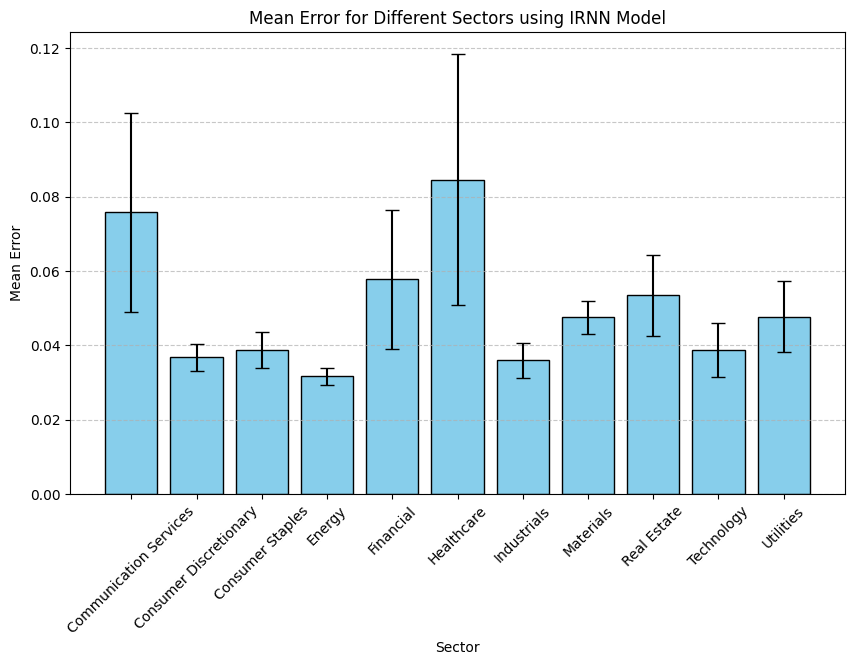

Mean error using IRNN Model for sector Communication Services is: 0.075793 ± 0.026790
Mean error using IRNN Model for sector Consumer Discretionary is: 0.036755 ± 0.003633
Mean error using IRNN Model for sector Consumer Staples is: 0.038787 ± 0.004766
Mean error using IRNN Model for sector Energy is: 0.031632 ± 0.002230
Mean error using IRNN Model for sector Financial is: 0.057735 ± 0.018674
Mean error using IRNN Model for sector Healthcare is: 0.084580 ± 0.033785
Mean error using IRNN Model for sector Industrials is: 0.035929 ± 0.004758
Mean error using IRNN Model for sector Materials is: 0.047522 ± 0.004398
Mean error using IRNN Model for sector Real Estate is: 0.053473 ± 0.010875
Mean error using IRNN Model for sector Technology is: 0.038760 ± 0.007322
Mean error using IRNN Model for sector Utilities is: 0.047677 ± 0.009577


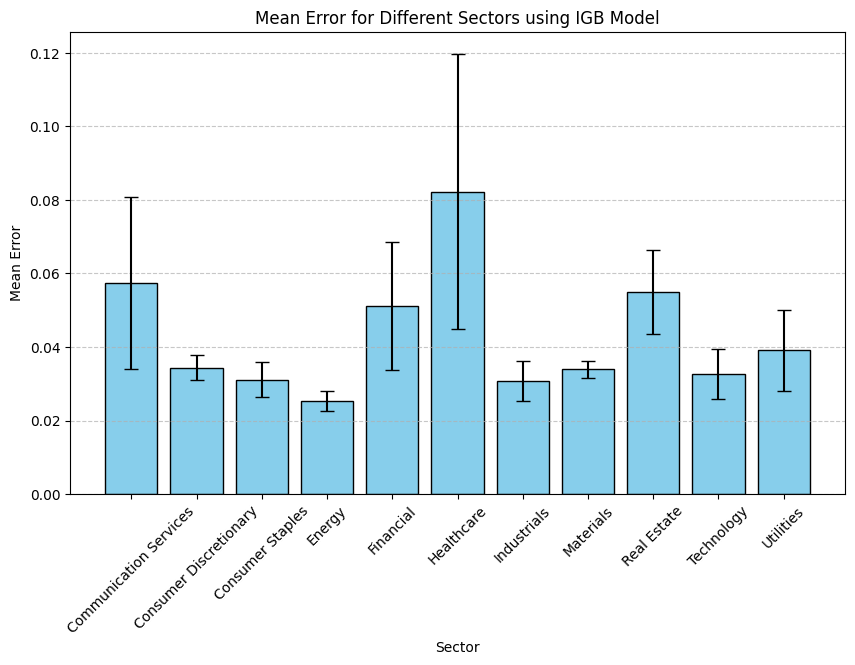

Mean error using IGB Model for sector Communication Services is: 0.057413 ± 0.023271
Mean error using IGB Model for sector Consumer Discretionary is: 0.034411 ± 0.003368
Mean error using IGB Model for sector Consumer Staples is: 0.031118 ± 0.004852
Mean error using IGB Model for sector Energy is: 0.025366 ± 0.002776
Mean error using IGB Model for sector Financial is: 0.051070 ± 0.017388
Mean error using IGB Model for sector Healthcare is: 0.082269 ± 0.037444
Mean error using IGB Model for sector Industrials is: 0.030677 ± 0.005469
Mean error using IGB Model for sector Materials is: 0.033908 ± 0.002239
Mean error using IGB Model for sector Real Estate is: 0.054956 ± 0.011313
Mean error using IGB Model for sector Technology is: 0.032656 ± 0.006908
Mean error using IGB Model for sector Utilities is: 0.039109 ± 0.011086


In [ ]:
IRNN_CommunicationServices=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/IRNN_CommunicationServices.xlsx")
IRNN_ConsumerDiscretionary=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/IRNN_ConsumerDiscretionary.xlsx")
IRNN_ConsumerStaples=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/IRNN_ConsumerStaples.xlsx")
IRNN_Energy=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/IRNN_Energy.xlsx")
IRNN_Financial=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/IRNN_Financial.xlsx")
IRNN_Healthcare=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/IRNN_Healthcare.xlsx")
IRNN_Industrials=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/IRNN_Industrials.xlsx")
IRNN_Materials=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/IRNN_Materials.xlsx")
IRNN_RealEstate=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/IRNN_RealEstate.xlsx")
IRNN_Technology=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/IRNN_Technology.xlsx")
IRNN_Utilities=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/IRNN_Utilities.xlsx")


IGB_CommunicationServices=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/IGB_CommunicationServices.xlsx")
IGB_ConsumerDiscretionary=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/IGB_ConsumerDiscretionary.xlsx")
IGB_ConsumerStaples=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/IGB_ConsumerStaples.xlsx")
IGB_Energy=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/IGB_Energy.xlsx")
IGB_Financial=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/IGB_Financial.xlsx")
IGB_Healthcare=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/IGB_Healthcare.xlsx")
IGB_Industrials=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/IGB_Industrials.xlsx")
IGB_Materials=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/IGB_Materials.xlsx")
IGB_RealEstate=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/IGB_RealEstate.xlsx")
IGB_Technology=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/IGB_Technology.xlsx")
IGB_Utilities=pd.read_excel("/content/drive/My Drive/MSci Project/Saved Dataframes/IGB_Utilities.xlsx")

# Compute RMSE values for IRNN model
IRNN_rmses_CommunicationServices = RMSE("Communication Services", df_main_CommunicationServices, df_other_CommunicationServices, IRNN_CommunicationServices, 'ML', sd='2024-09-16')
IRNN_rmses_ConsumerDiscretionary = RMSE("Consumer Discretionary", df_main_ConsumerDiscretionary, df_other_ConsumerDiscretionary, IRNN_ConsumerDiscretionary, 'ML', sd='2024-09-16')
IRNN_rmses_ConsumerStaples = RMSE("Consumer Staples", df_main_ConsumerStaples, df_other_ConsumerStaples, IRNN_ConsumerStaples, 'ML', sd='2024-09-16')
IRNN_rmses_Energy = RMSE("Energy", df_main_Energy, df_other_Energy, IRNN_Energy, 'ML', sd='2024-09-16')
IRNN_rmses_Financial = RMSE("Financial", df_main_Financial, df_other_Financial, IRNN_Financial, 'ML', sd='2024-09-16')
IRNN_rmses_Healthcare = RMSE("Healthcare", df_main_Healthcare, df_other_Healthcare, IRNN_Healthcare, 'ML', sd='2024-09-16')
IRNN_rmses_Industrials = RMSE("Industrials", df_main_Industrials, df_other_Industrials, IRNN_Industrials, 'ML', sd='2024-09-16')
IRNN_rmses_Materials = RMSE("Materials", df_main_Materials, df_other_Materials, IRNN_Materials, 'ML', sd='2024-09-16')
IRNN_rmses_RealEstate = RMSE("Real Estate", df_main_RealEstate, df_other_RealEstate, IRNN_RealEstate, 'ML', sd='2024-09-16')
IRNN_rmses_Technology = RMSE("Technology", df_main_Technology, df_other_Technology, IRNN_Technology, 'ML', sd='2024-09-16')
IRNN_rmses_Utilities = RMSE("Utilities", df_main_Utilities, df_other_Utilities, IRNN_Utilities, 'ML', sd='2024-09-16')

IGB_rmses_CommunicationServices = RMSE("Communication Services", df_main_CommunicationServices, df_other_CommunicationServices, IGB_CommunicationServices, 'ML', sd='2024-09-16')
IGB_rmses_ConsumerDiscretionary = RMSE("Consumer Discretionary", df_main_ConsumerDiscretionary, df_other_ConsumerDiscretionary, IGB_ConsumerDiscretionary, 'ML', sd='2024-09-16')
IGB_rmses_ConsumerStaples = RMSE("Consumer Staples", df_main_ConsumerStaples, df_other_ConsumerStaples, IGB_ConsumerStaples, 'ML', sd='2024-09-16')
IGB_rmses_Energy = RMSE("Energy", df_main_Energy, df_other_Energy, IGB_Energy, 'ML', sd='2024-09-16')
IGB_rmses_Financial = RMSE("Financial", df_main_Financial, df_other_Financial, IGB_Financial, 'ML', sd='2024-09-16')
IGB_rmses_Healthcare = RMSE("Healthcare", df_main_Healthcare, df_other_Healthcare, IGB_Healthcare, 'ML', sd='2024-09-16')
IGB_rmses_Industrials = RMSE("Industrials", df_main_Industrials, df_other_Industrials, IGB_Industrials, 'ML', sd='2024-09-16')
IGB_rmses_Materials = RMSE("Materials", df_main_Materials, df_other_Materials, IGB_Materials, 'ML', sd='2024-09-16')
IGB_rmses_RealEstate = RMSE("Real Estate", df_main_RealEstate, df_other_RealEstate, IGB_RealEstate, 'ML', sd='2024-09-16')
IGB_rmses_Technology = RMSE("Technology", df_main_Technology, df_other_Technology, IGB_Technology, 'ML', sd='2024-09-16')
IGB_rmses_Utilities = RMSE("Utilities", df_main_Utilities, df_other_Utilities, IGB_Utilities, 'ML', sd='2024-09-16')


# Organize IRNN RMSE results into a list
IRNN_rmses_array = [
    IRNN_rmses_CommunicationServices,
    IRNN_rmses_ConsumerDiscretionary,
    IRNN_rmses_ConsumerStaples,
    IRNN_rmses_Energy,
    IRNN_rmses_Financial,
    IRNN_rmses_Healthcare,
    IRNN_rmses_Industrials,
    IRNN_rmses_Materials,
    IRNN_rmses_RealEstate,
    IRNN_rmses_Technology,
    IRNN_rmses_Utilities
]

IGB_rmses_array = [
    IGB_rmses_CommunicationServices,
    IGB_rmses_ConsumerDiscretionary,
    IGB_rmses_ConsumerStaples,
    IGB_rmses_Energy,
    IGB_rmses_Financial,
    IGB_rmses_Healthcare,
    IGB_rmses_Industrials,
    IGB_rmses_Materials,
    IGB_rmses_RealEstate,
    IGB_rmses_Technology,
    IGB_rmses_Utilities
]

# Plot RMSE results


plot_rmses_for_method(IRNN_rmses_array, sector_list, "IRNN Model")
plot_rmses_for_method(IGB_rmses_array, sector_list, "IGB Model")

**Tests**

This has a bunch of tests used that are no longer needed but might be useful at some point.

          Date    VIX  Rates  AAPL_option  AAPL_stock  AVGO_option  \
17  2023-12-13  12.19  5.384          NaN     197.960          NaN   
18  2023-12-14  12.48  5.381          NaN     198.110          NaN   
19  2023-12-15  12.28  5.385          NaN     197.570          NaN   
20  2023-12-18  12.56  5.387          NaN     195.890          NaN   
21  2023-12-19  12.53  5.371          NaN     196.940          NaN   
..         ...    ...    ...          ...         ...          ...   
263 2024-12-05  13.54  4.446          NaN     243.040          NaN   
264 2024-12-06  12.77  4.398          NaN     242.840          NaN   
265 2024-12-09  14.19  4.399          NaN     244.405          NaN   
266 2024-12-10  14.18  4.380          NaN         NaN          NaN   
267 2024-12-11  13.58  4.364          NaN         NaN          NaN   

     AVGO_stock  CRM_option  CRM_stock  NVDA_option  NVDA_stock  MSFT_option  \
17      108.969         NaN     257.32          NaN     48.0880          NaN   

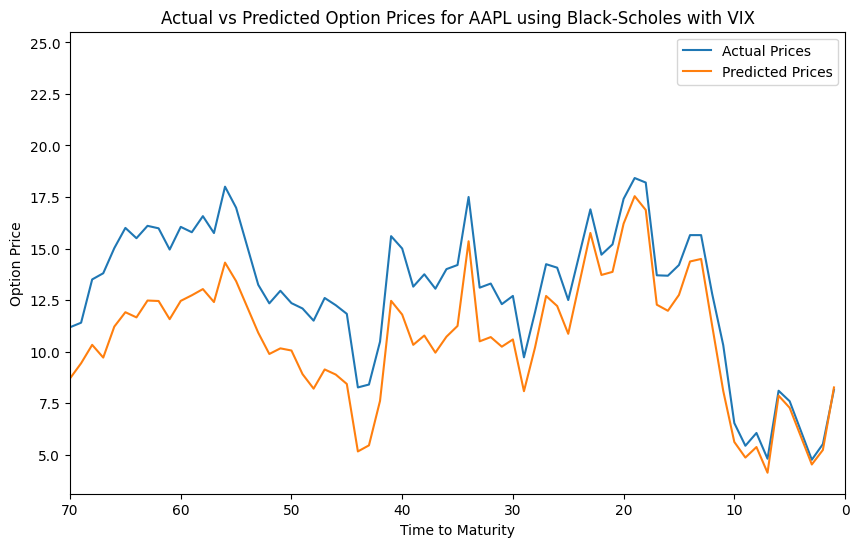

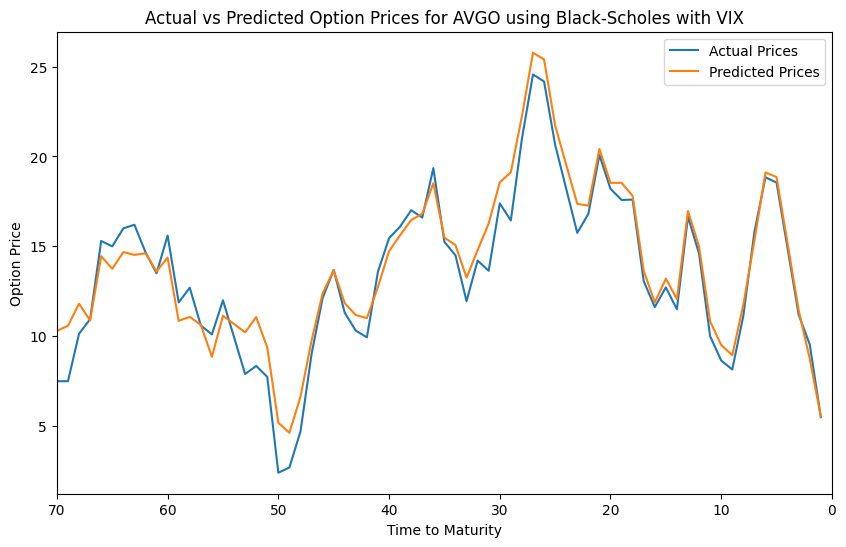

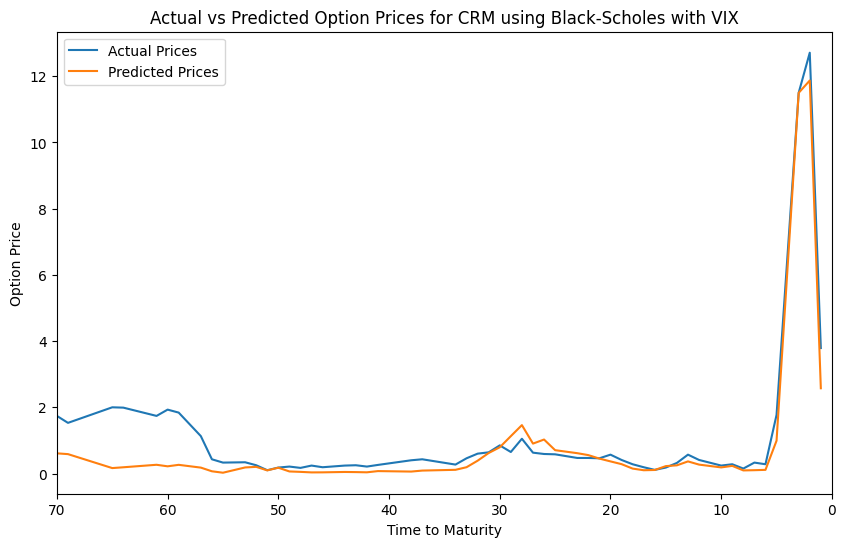

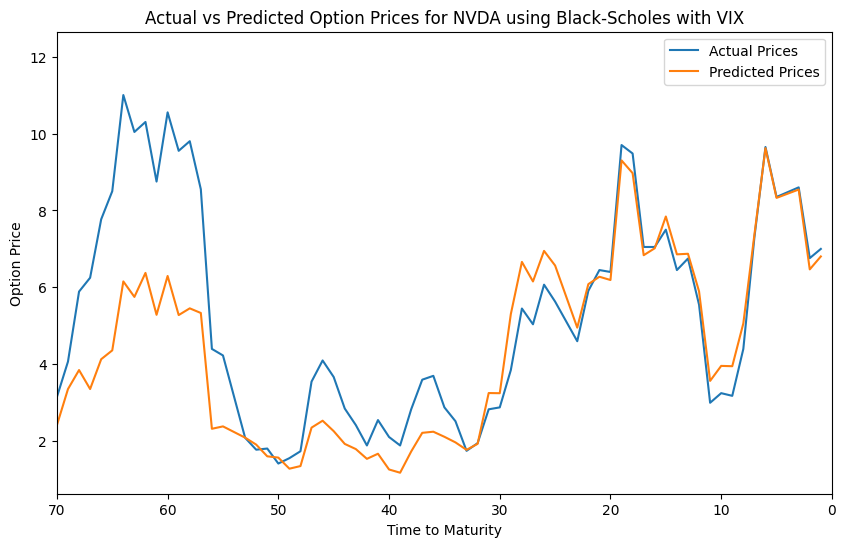

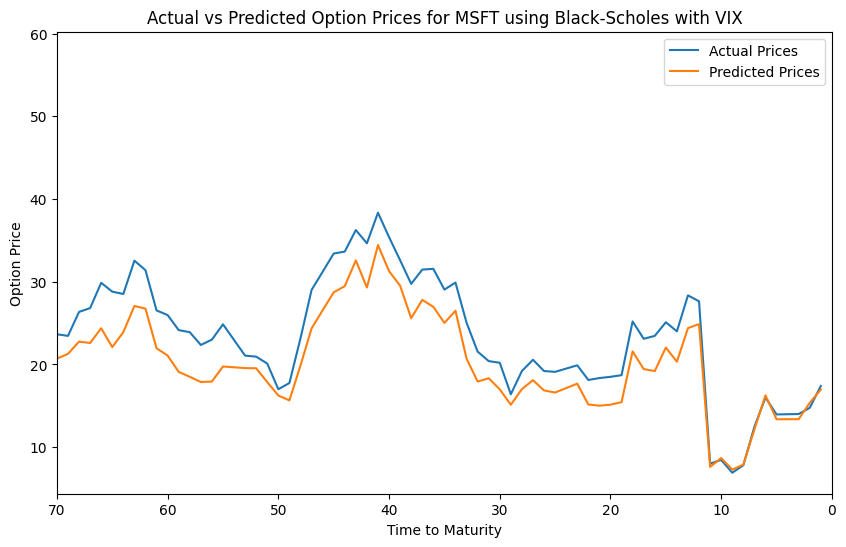

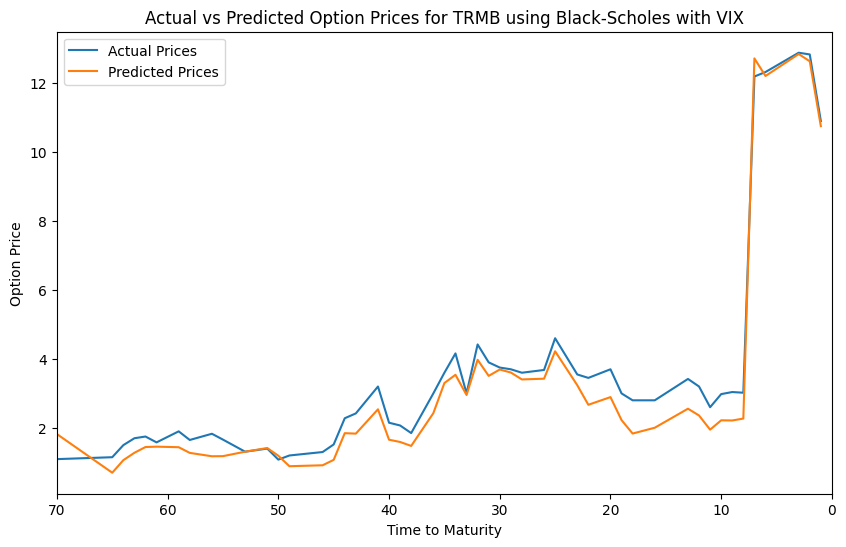

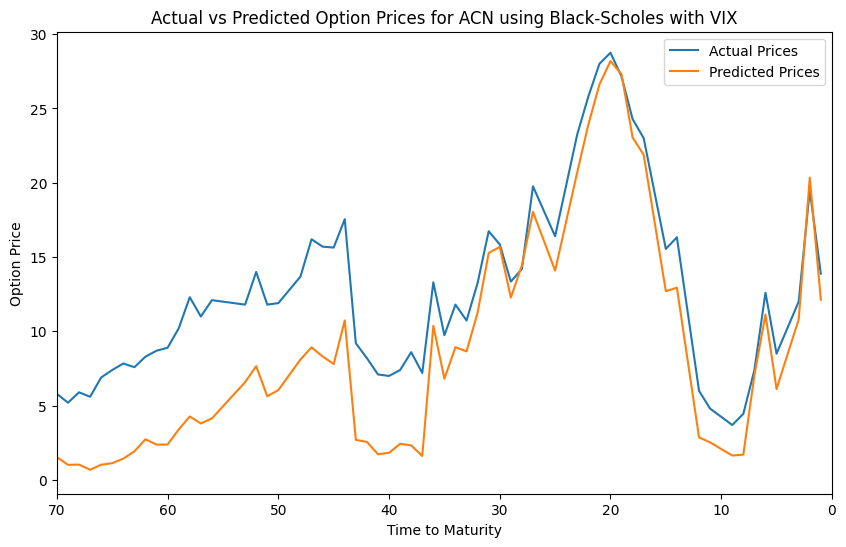

AAPL
Failed to converge for AAPL on 2024-11-14 00:00:00.
AVGO
Failed to converge for AVGO on 2024-11-07 00:00:00.
Failed to converge for AVGO on 2024-11-08 00:00:00.
Failed to converge for AVGO on 2024-11-12 00:00:00.
CRM
NVDA
MSFT
Failed to converge for MSFT on 2024-11-13 00:00:00.
TRMB
Failed to converge for TRMB on 2024-11-06 00:00:00.
ACN
Failed to converge for ACN on 2024-10-21 00:00:00.
Failed to converge for ACN on 2024-11-13 00:00:00.


/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/

         Date  AAPL_implied_vol  AVGO_implied_vol  CRM_implied_vol  \
0  2024-07-15          0.235816               NaN         0.291709   
1  2024-07-16          0.243603          0.331184         0.298425   
2  2024-07-17          0.254999          0.383270              NaN   
3  2024-07-18          0.252820          0.392998              NaN   
4  2024-07-19          0.251844          0.405976              NaN   
..        ...               ...               ...              ...   
82 2024-11-08          0.204889               NaN         0.254255   
83 2024-11-12          0.185918               NaN         0.195301   
84 2024-11-13          0.235550          0.620909         0.379531   
85 2024-11-14               NaN          0.329786         0.343510   
86 2024-11-15               NaN               NaN              NaN   

    NVDA_implied_vol  MSFT_implied_vol  TRMB_implied_vol  ACN_implied_vol  
0           0.515716          0.230677          0.272008         0.222004  
1      

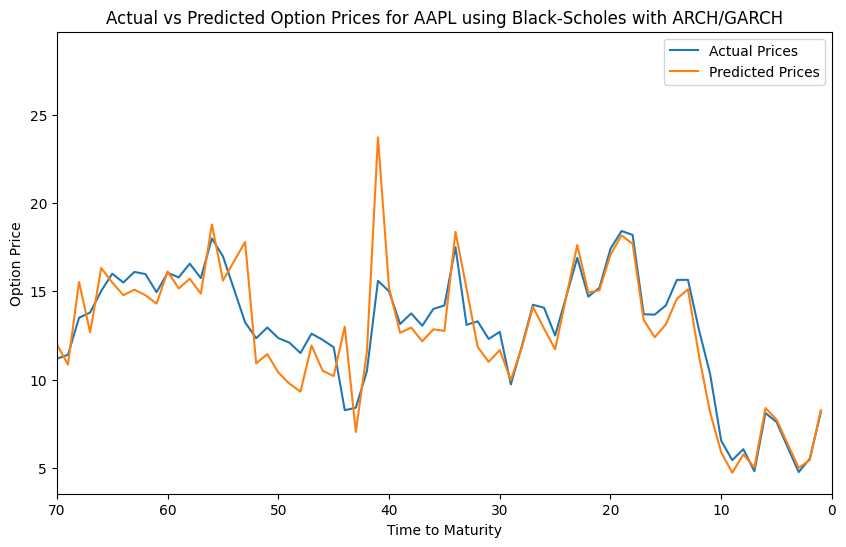

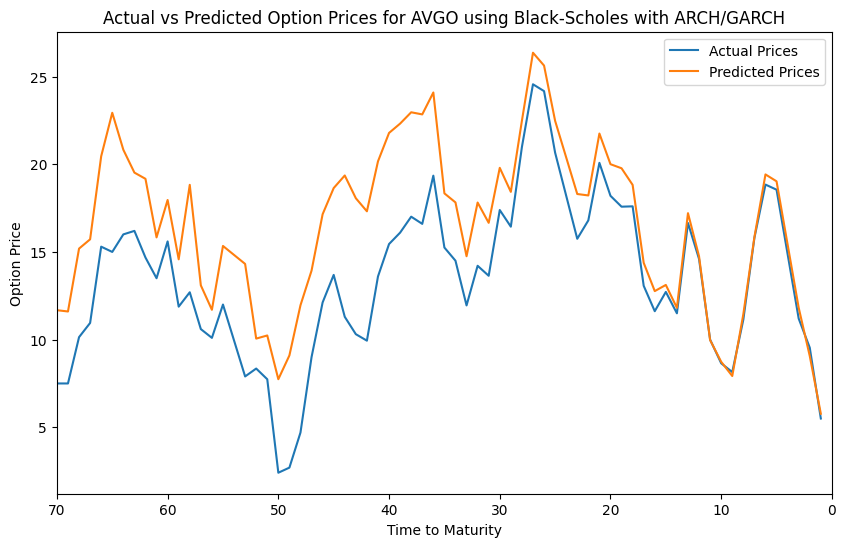

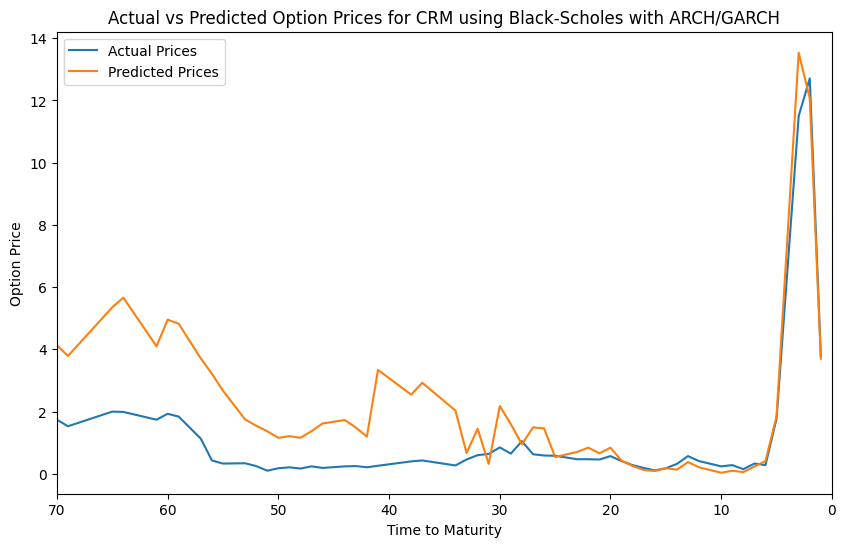

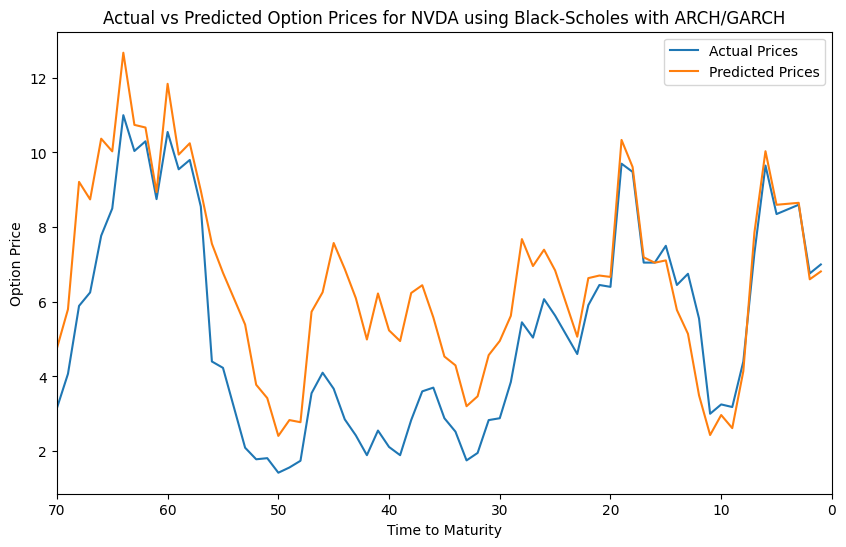

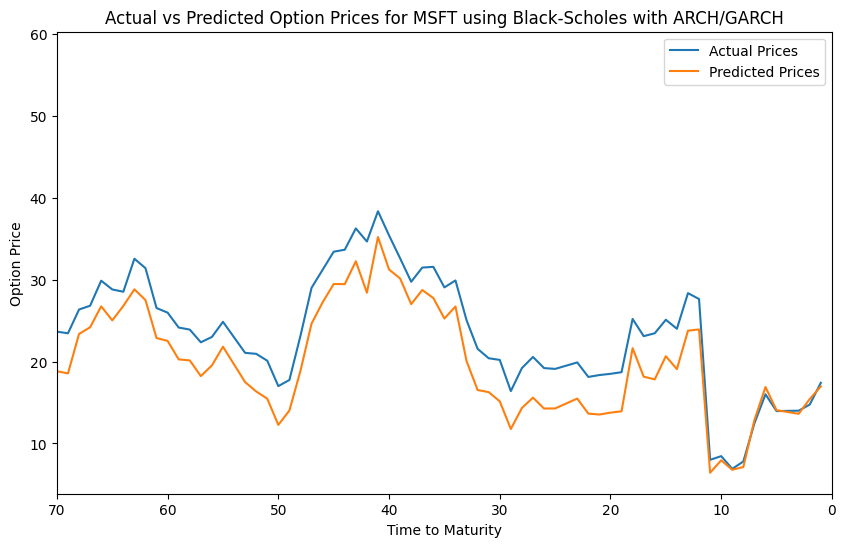

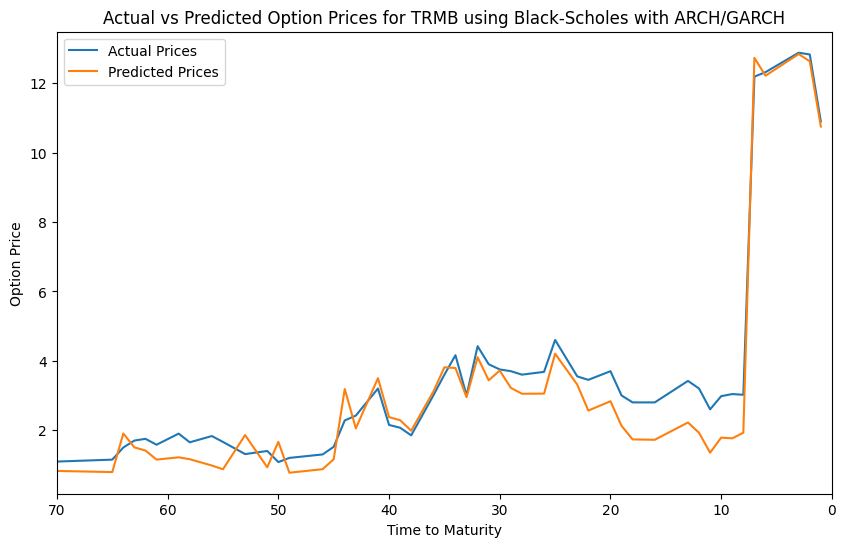

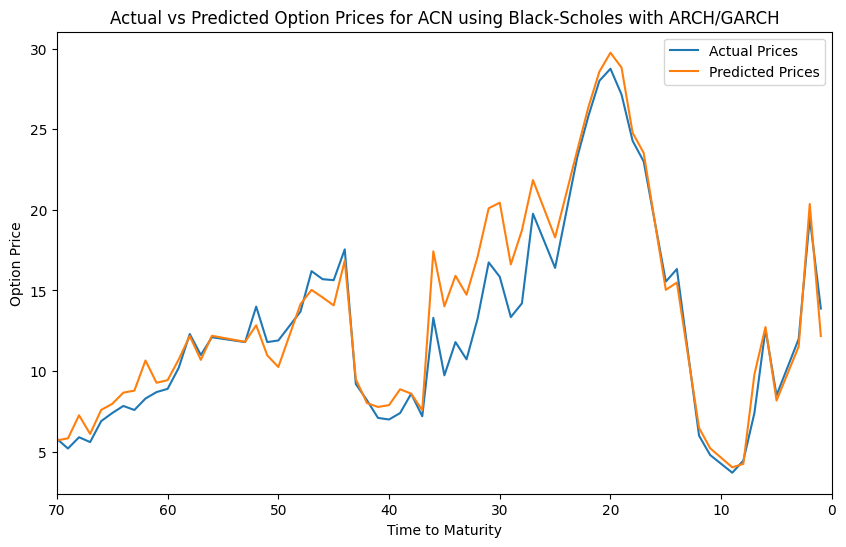

"\ntest=df_price.sort_values(by='Date', ascending=True)\nprint(test)\n\nSome tests to understand how to access data frame.\nTestStock=df_price['MSFT_stock']\nTestRow=df_price.loc[0,'MSFT_option']\nprint(TestStock[0])\nprint(TestRow)\nTestParticular=df_price.loc[df_price['Date'] == '2024-10-07', 'MSFT_stock'].values[0]\nprint(TestParticular)\n"

In [ ]:
df_main_Technology,df_other_Technology=excel_to_df('Technology')
BS_VIX_Technology=Black_Scholes_VIX('Technology',df_main_Technology,df_other_Technology)
returns_Technology=returns('Technology',df_main_Technology)
print(BS_VIX_Technology)


#print(returns_Technology)
#print(df_main_Technology)
plot_actual_vs_predicted('Technology',df_main_Technology,df_other_Technology,BS_VIX_Technology,'VIX')
implied_volatility_Technology=implied_volatility('Technology',df_main_Technology,df_other_Technology)
#plot_implied_vs_predicted_volatilty('Technology',df_main_Technology,df_other_Technology,BS_VIX_Technology,implied_volatility_Technology,'VIX')

#print(BS_ARCH_GARCH_Technology)
print(implied_volatility_Technology)
BS_ARCH_GARCH_Technology=Black_Scholes_ARCH_GARCH('Technology',df_main_Technology,df_other_Technology,returns_Technology)
plot_actual_vs_predicted('Technology',df_main_Technology,df_other_Technology,BS_ARCH_GARCH_Technology,'ARCH/GARCH')
#plot_implied_vs_predicted_volatilty('Technology',df_main_Technology,df_other_Technology,BS_ARCH_GARCH_Technology,implied_volatility_Technology,'ARCH/GARCH')
#print(BS_ARCH_GARCH_Technology)

#BS_options=Black_Scholes(S,K,tau,r,sigma)
"""
test=df_price.sort_values(by='Date', ascending=True)
print(test)

Some tests to understand how to access data frame.
TestStock=df_price['MSFT_stock']
TestRow=df_price.loc[0,'MSFT_option']
print(TestStock[0])
print(TestRow)
TestParticular=df_price.loc[df_price['Date'] == '2024-10-07', 'MSFT_stock'].values[0]
print(TestParticular)
"""


**Extra Fuctions**

These are functions we tried and either do not work properly or don't work as well as their related function above.

Be careful not to confuse them with the better versions above.

In [ ]:

"""
def plot_actual_vs_predicted(Sector,main_data,other_data,option_prices,method):
  ticker_list=return_tickers(Sector)
  filtered_dates = main_data[(main_data['Date'] >= start_date) & (main_data['Date'] <= end_date)]['Date'].tolist()
  for ticker in ticker_list:
    days_to_maturity=[]
    actual_prices=[]
    predicted_prices=[]
    expiry=other_data.loc[other_data['Ticker'] == ticker, 'Expirations'].values[0]
    for date in filtered_dates:
      tau=np.busday_count(date.date(), pd.Timestamp(expiry).date())
      if pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_stock']).any() or pd.isna(main_data.loc[main_data['Date'] == date, ticker+'_option']).any() or pd.isna(option_prices.loc[option_prices['Date']==date,ticker+'_'+method+'_option']).any() or tau<=0:
        continue
      days_to_maturity.append(tau)
      actual_prices.append(main_data.loc[main_data['Date'] == date, ticker+'_option'].values[0])
      predicted_prices.append(option_prices.loc[option_prices['Date'] == date, ticker+'_'+method+'_option'].values[0])
    plt.figure(figsize=(10, 6))

    # Plot actual prices
    plt.plot(days_to_maturity,actual_prices, label='Actual Prices')

    # Plot predicted prices
    plt.plot(days_to_maturity,predicted_prices, label='Predicted Prices')

    # Add labels and title
    plt.xlabel('Time to Maturity')
    plt.ylabel('Option Price')

    if method[0]=='B':
      if method[-1:]=='X':
        newmethod='Binomial with VIX'
      else:
        newmethod='Binomial with ARCH/GARCH'
    elif method[0]=='M':
      if method[-1:]=='X':
        newmethod='Monte Carlo with VIX'
      else:
        newmethod='Monte Carlo with ARCH/GARCH'
    else:
      if method[-1:]=='X':
        newmethod='Black-Scholes with VIX'
      else:
        newmethod='Black-Scholes with ARCH/GARCH'
    plt.title(f'Actual vs Predicted Option Prices for {ticker} using {newmethod}')

    # Add a legend to differentiate between the two lines
    plt.legend()

    #Flip axis
    plt.xlim(70,0)

    # Display the plot
    plt.show()
"""

"""
def plot_implied_vs_predicted_volatilty(Sector,main_data,other_data,option_prices,implied_volatility_data,method):
  ticker_list=return_tickers(Sector)
  filtered_dates = main_data[(main_data['Date'] >= start_date) & (main_data['Date'] <= end_date)]['Date'].tolist()
  for ticker in ticker_list:
    days_to_maturity=[]
    implied_volatilities=[]
    predicted_volatilities=[]
    expiry=other_data.loc[other_data['Ticker'] == ticker, 'Expirations'].values[0]
    for date in filtered_dates:
      tau_days= np.busday_count(date.date(), pd.Timestamp(expiry).date())
      if pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_stock']).any() or pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_option']).any() or pd.isna(option_prices.loc[option_prices['Date']==date,ticker+'_'+method+'_option']).any() or tau_days<=0:
        continue
      days_to_maturity.append(tau_days)
      implied_volatilities.append(implied_volatility_data.loc[implied_volatility_data['Date']==date, ticker+'_implied_vol'].values[0])
      predicted_volatilities.append(option_prices.loc[option_prices['Date'] == date, ticker+'_'+method].values[0])
    plt.figure(figsize=(10, 6))

    # Plot actual prices
    plt.plot(days_to_maturity,implied_volatilities, label='Implied volatility')

    # Plot predicted prices
    plt.plot(days_to_maturity,predicted_volatilities, label='Volatility as predicted by'+method)

    # Add labels and title
    plt.xlabel('Time to Maturity')
    plt.ylabel('Volatility')
    plt.title(f'Implied vs Predicted Volatility {ticker} using {method}')

    # Add a legend to differentiate between the two lines
    plt.legend()

    #Flip axis
    plt.xlim(70,0)

    # Display the plot
    plt.show()
"""

"\ndef plot_implied_vs_predicted_volatilty(Sector,main_data,other_data,option_prices,implied_volatility_data,method):\n  ticker_list=return_tickers(Sector)\n  filtered_dates = main_data[(main_data['Date'] >= start_date) & (main_data['Date'] <= end_date)]['Date'].tolist()\n  for ticker in ticker_list:\n    days_to_maturity=[]\n    implied_volatilities=[]\n    predicted_volatilities=[]\n    expiry=other_data.loc[other_data['Ticker'] == ticker, 'Expirations'].values[0]\n    for date in filtered_dates:\n      tau_days= np.busday_count(date.date(), pd.Timestamp(expiry).date())\n      if pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_stock']).any() or pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_option']).any() or pd.isna(option_prices.loc[option_prices['Date']==date,ticker+'_'+method+'_option']).any() or tau_days<=0:\n        continue\n      days_to_maturity.append(tau_days)\n      implied_volatilities.append(implied_volatility_data.loc[implied_volatility_data['D

In [ ]:
def MC2(Sector,main_data,other_data,sector_volatilities,method,N=10):

  #Initialise data frame
  Sector_option_prices=pd.DataFrame({})
  #Get all tickers for the sector
  ticker_list=return_tickers(Sector)
  #print(ticker_list)
  #Get a list of dates between 2 globally defined dates for which we are looking at
  filtered_dates = main_data[(main_data['Date'] >= start_date) & (main_data['Date'] <= end_date)]['Date'].tolist()
  #Add these dates to our data frame
  Sector_option_prices['Date']=filtered_dates
  #Redefine method
  newmethod='Monte_Carlo'+'_'+method
  #Loop through all the tickers
  for ticker in ticker_list:
    #Initialise some lists where we temporarily store data for a particular company before adding to date frame
    option_prices=[]
    valid_dates=[]
    #volatilities=[]

    #Get strike price of option
    K=other_data.loc[other_data['Ticker'] == ticker, 'Strike'].values[0]
    #Get expiration date of option
    expiry=other_data.loc[other_data['Ticker'] == ticker, 'Expirations'].values[0]
    #Number of days before prediction
    T=1/252

    #Loop through dates from list of dates obtained earlier
    for date in filtered_dates:
      #Get time to expiry and convert to years. Note the use of trading days
      tau= np.busday_count(date.date(), pd.Timestamp(expiry).date())/252

      #Check if either stock or option price is not not available for that day. We will go to next date if this is true.
      if pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_stock']).any() or pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_option']).any() or tau<=0:
        continue


      #Need to look into this more -> Deeping it maybe I don't need an offset because we are using today to evaluate option price today
      valid_dates.append(date+ pd.tseries.offsets.BDay(0))
      dt=T/N
      #Obtain stock price for that day
      S=main_data.loc[main_data['Date'] == date, ticker+'_stock'].values[0]
      #Obtain risk-free rate for that day
      rpercent=main_data.loc[main_data['Date'] == date, 'Rates'].values[0]
      #Change to decimal
      r= rpercent/100
      #Get volatility on date
      sigma=sector_volatilities.loc[sector_volatilities['Date'] == date, ticker+'_'+method].values[0]
      #print("Strike:",K)

      S_old=S

      for i in range(N):
        #print(i)
        Snew=S_old*np.exp((r-(sigma**2)/2)*dt+sigma*np.sqrt(dt)*np.random.normal())
        #Snew=S_old*np.exp((r-(sigma**2)/2)*dt+sigma*np.sqrt(dt)*np.random.lognormal())
        S_old=Snew
      #print(Snew)
      C=np.exp(-r*T)*max(Snew-K,0)
      """
      # Log-normal sampling for N paths
      drift = (r - 0.5 * sigma**2) * tau  # Drift term
      diffusion = sigma * np.sqrt(tau)   # Diffusion term
      Snew_samples = np.random.lognormal(mean=drift, sigma=diffusion, size=N) * S

      # Calculate discounted payoffs and average
      payoffs = np.maximum(Snew_samples - K, 0)  # Option payoff: max(S(T) - K, 0)

      C = np.exp(-r * tau) * np.mean(payoffs)   # Discounted average payoff
      """
      #Add option price to temporary list
      option_prices.append(C)
    #Create temporary data frame with valid dates and evaluated option prices
    df_temp=pd.DataFrame({})
    df_temp['Date']=valid_dates
    df_temp[ticker+'_'+newmethod+'_option']=option_prices
     #Add data to main data frame
    Sector_option_prices=pd.merge(Sector_option_prices,df_temp,on='Date', how='outer')

  return Sector_option_prices

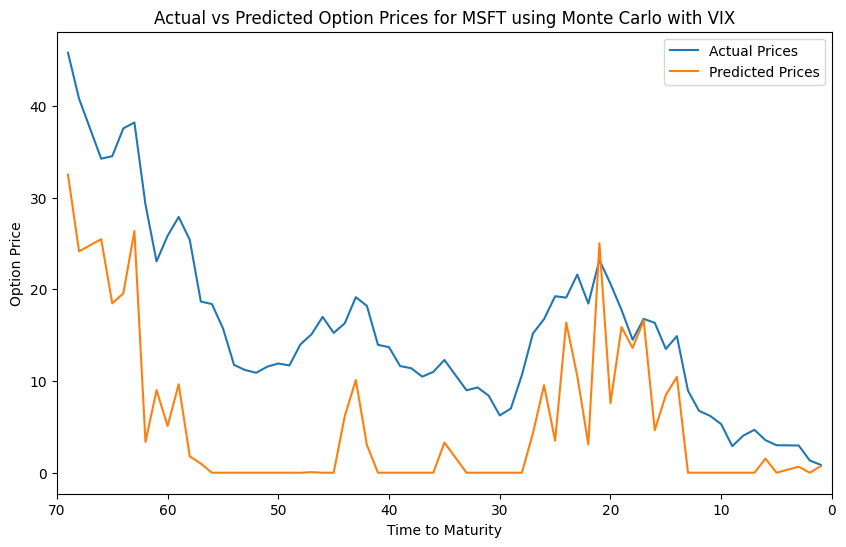

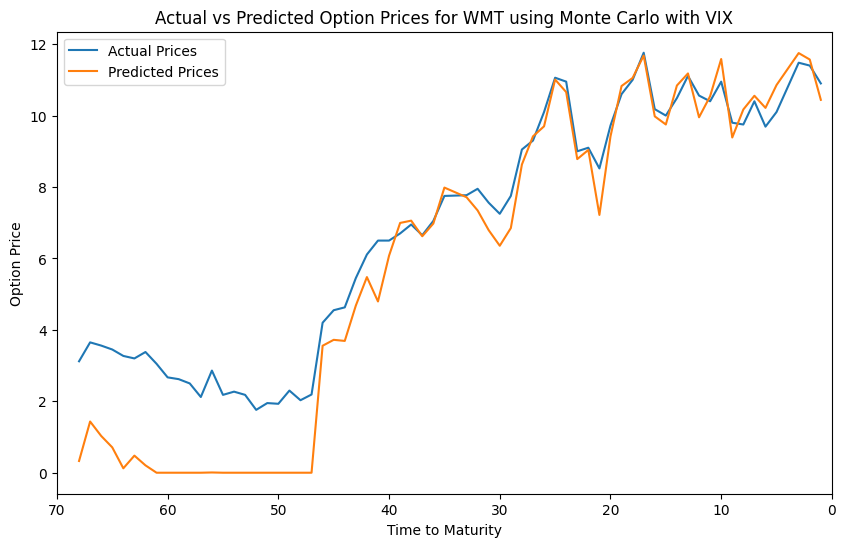

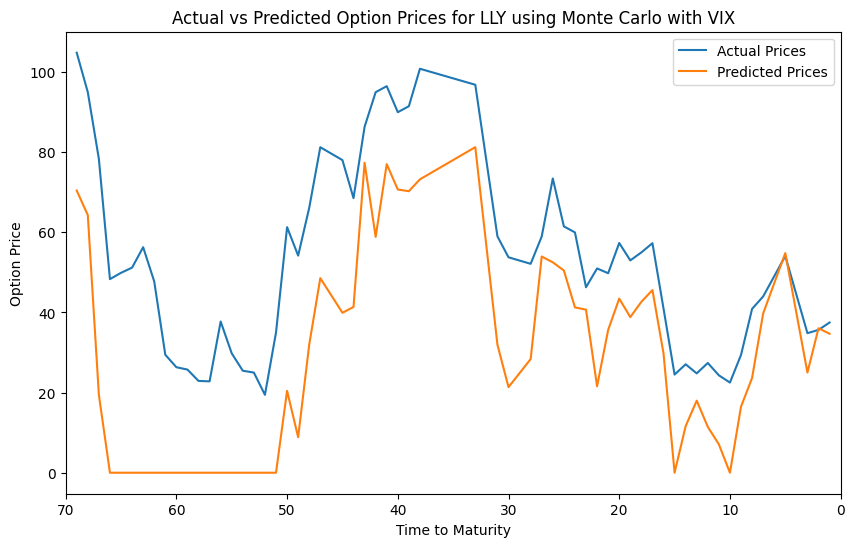

         Date  MSFT_Monte_Carlo_VIX_option  WMT_Monte_Carlo_VIX_option  \
0  2024-07-15                    32.513164                         NaN   
1  2024-07-16                    24.144621                    0.328601   
2  2024-07-17                          NaN                    1.433512   
3  2024-07-18                    25.472470                    1.029596   
4  2024-07-19                    18.472986                    0.709906   
..        ...                          ...                         ...   
63 2024-10-11                     0.000000                   10.855777   
64 2024-10-15                     0.662909                   11.749783   
65 2024-10-16                     0.000000                   11.569592   
66 2024-10-17                     0.722223                   10.440607   
67 2024-10-18                          NaN                         NaN   

    LLY_Monte_Carlo_VIX_option  
0                    70.436812  
1                    64.320579  
2           

In [ ]:
MC2_VIX_Technology=MC2('Technology',df_main_Technology,df_other_Technology,BS_VIX_Technology,'VIX',10**3)
plot_actual_vs_predicted('Technology',df_main_Technology,df_other_Technology,MC2_VIX_Technology,'Monte_Carlo_VIX')
print(MC2_VIX_Technology)

In [ ]:
def Heston_charfunc(phi, S0, v0, kappa, theta, sigma, rho, lambd, tau, r):
  # constants
    a = kappa*theta
    b = kappa+lambd

    # common terms w.r.t phi
    rspi = rho*sigma*phi*1j

    # define d parameter given phi and b
    d = np.sqrt( (rho*sigma*phi*1j - b)**2 + (phi*1j+phi**2)*sigma**2 )

    # define g parameter given phi, b and d
    g = (b-rspi+d)/(b-rspi-d)

    # calculate characteristic function by components
    exp1 = np.exp(r*phi*1j*tau)
    term2 = S0**(phi*1j) * ( (1-g*np.exp(d*tau))/(1-g) )**(-2*a/sigma**2)
    exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
    #print(exp1,term2,exp2)
    return exp1*term2*exp2

def integrand(phi, S0, v0, kappa, theta, sigma, rho, lambd, tau, r):
    args = (S0, v0, kappa, theta, sigma, rho, lambd, tau, r)
    numerator = np.exp(r*tau)*Heston_charfunc(phi-1j,*args) - K*Heston_charfunc(phi,*args)
    denominator = 1j*phi*K**(1j*phi)
    return numerator/denominator

def Heston_price_rec(S0, K, v0, kappa, theta, sigma, rho, lambd, tau, r):
    args = (S0, v0, kappa, theta, sigma, rho, lambd, tau, r)

    P, umax, N = 0, 100, 1000
    dphi=umax/N #dphi is width
    for i in range(1,N):
        # rectangular integration
        phi = dphi * (2*i + 1)/2 # midpoint to calculate height
        numerator = np.exp(r*tau)*Heston_charfunc(phi-1j,*args) - K * Heston_charfunc(phi,*args)
        denominator = 1j*phi*K**(1j*phi)

        P += dphi * numerator/denominator

    return np.real((S0 - K*np.exp(-r*tau))/2 + P/np.pi)

# This is the calibration function
# heston_price(S0, K, v0, kappa, theta, sigma, rho, lambd, tau, r)
# Parameters are v0, kappa, theta, sigma, rho, lambd

params = {"v0": {"x0": 0.1, "lbub": [1e-3,0.1]},
          "kappa": {"x0": 3, "lbub": [1e-3,5]},
          "theta": {"x0": 0.05, "lbub": [1e-3,0.1]},
          "sigma": {"x0": 0.3, "lbub": [1e-2,1]},
          "rho": {"x0": -0.8, "lbub": [-1,0]},
          "lambd": {"x0": 0.03, "lbub": [-1,1]},
          }
x0 = [param["x0"] for key, param in params.items()]
bnds = [param["lbub"] for key, param in params.items()]



def Heston2(Sector,main_data,other_data,training_days=1):
  #Initialise data frame
  Sector_option_prices=pd.DataFrame({})
  #Get all tickers for the sector
  ticker_list=return_tickers(Sector)
  #Get a list of dates between 2 globally defined dates for which we are looking at
  filtered_dates = main_data[(main_data['Date'] >= start_date) & (main_data['Date'] <= end_date)]['Date'].tolist()
  #Add these dates to our data frame
  Sector_option_prices['Date']=filtered_dates
  #print(ticker_list)
  #Loop through all the tickers
  date=filtered_dates[0]
  start=date - pd.tseries.offsets.BDay(training_days)
  business_dates = pd.bdate_range(start=start, end=date).tolist()
  for ticker in ticker_list:
    filtered_df1 = main_data[(main_data['Date'].isin(business_dates))][['Date', ticker + '_stock']]
    filtered_df2 = main_data[(main_data['Date'].isin(business_dates))][['Date', 'Rates']]
    filtered_df3=main_data[(main_data['Date'].isin(business_dates))][['Date', ticker+'_option']]
    df_fitdata=pd.merge(filtered_df1,filtered_df2,on='Date', how='inner')
    df_fitdata=pd.merge(df_fitdata,filtered_df3,on='Date', how='inner')
    df_fitdata=df_fitdata.dropna()

    #Get expiration date of option
    expiry=other_data.loc[other_data['Ticker'] == ticker, 'Expirations'].values[0]

    dates=df_fitdata['Date'].to_numpy(dtype='datetime64[D]')
    taus=np.busday_count(dates, pd.Timestamp(expiry).date())/252
    S0s=df_fitdata[ticker + '_stock'].to_numpy('float')
    rs=df_fitdata['Rates'].to_numpy('float')/100
    ps=df_fitdata[ticker + '_option'].to_numpy('float')
    K=other_data.loc[other_data['Ticker'] == ticker, 'Strike'].values[0]

    def SqErr(x):
        v0, kappa, theta, sigma, rho, lambd = [param for param in x]
            #print("1")
            # Decided to use rectangular integration function in the end
        err = np.sum( (ps-Heston_price_rec(S0s, K, v0, kappa, theta, sigma, rho, lambd, taus, rs))**2 /ps.shape[0] )
            #print("2")
            # Zero penalty term - no good guesses for parameters
        pen = 0 #np.sum( [(x_i-x0_i)**2 for x_i, x0_i in zip(x, x0)] )
        return err + pen

    result = minimize(SqErr, x0, tol = 1e-3, method='SLSQP', options={'maxiter': 1e4 }, bounds=bnds)
    v0, kappa, theta, sigma, rho, lambd = [param for param in result.x]

    #Initialise some lists where we temporarily store data for a particular company before adding to date frame
    option_prices=[]
    valid_dates=[]
    #Get strike price of option
    K=other_data.loc[other_data['Ticker'] == ticker, 'Strike'].values[0]

    for date in filtered_dates:

      df_fitdata=pd.DataFrame({})
      #Get time to expiry and convert to years. Note the use of trading days
      tau= np.busday_count(date.date(), pd.Timestamp(expiry).date())/252

      #Check if either stock or option price is not not available for that day. We will go to next date if this is true.
      if pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_stock']).any() or pd.isna(main_data.loc[main_data['Date'] == date, ticker + '_option']).any() or tau<=0:
        continue
      valid_dates.append(date)
      #Obtain stock price for that day

      print(v0, kappa, theta, sigma, rho, lambd)
      print(tau*252)
      rpercent=main_data.loc[main_data['Date'] == date, 'Rates'].values[0]
      r= rpercent/100
      S=main_data.loc[main_data['Date'] == date, ticker+'_stock'].values[0]
      Heston_prices = Heston_price_rec(S, K, v0, kappa, theta, sigma, rho, lambd, tau, r)
      option_prices.append(Heston_prices)
      df_temp=pd.DataFrame({})
      df_temp['Date']=valid_dates
      df_temp[ticker+'_Heston2_option']=option_prices
    Sector_option_prices=pd.merge(Sector_option_prices,df_temp,on='Date', how='outer')
  return Sector_option_prices

In [ ]:
Heston_test2=Heston2('Technology',df_main_Technology,df_other_Technology)
print(Heston_test)

0.034383861259563255 3.5327366480581013 0.0010000000000000668 0.9999999999999984 -0.9999999999999991 0.3575585284007722
69.0
0.034383861259563255 3.5327366480581013 0.0010000000000000668 0.9999999999999984 -0.9999999999999991 0.3575585284007722
68.0
0.034383861259563255 3.5327366480581013 0.0010000000000000668 0.9999999999999984 -0.9999999999999991 0.3575585284007722
66.0
0.034383861259563255 3.5327366480581013 0.0010000000000000668 0.9999999999999984 -0.9999999999999991 0.3575585284007722
65.0
0.034383861259563255 3.5327366480581013 0.0010000000000000668 0.9999999999999984 -0.9999999999999991 0.3575585284007722
64.0
0.034383861259563255 3.5327366480581013 0.0010000000000000668 0.9999999999999984 -0.9999999999999991 0.3575585284007722
63.0
0.034383861259563255 3.5327366480581013 0.0010000000000000668 0.9999999999999984 -0.9999999999999991 0.3575585284007722
62.0
0.034383861259563255 3.5327366480581013 0.0010000000000000668 0.9999999999999984 -0.9999999999999991 0.3575585284007722
61.0


<ipython-input-20-7ad946f0919c>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-20-7ad946f0919c>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
/usr/local/lib/python3.10/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)


0.1 4.999999999994515 0.014405195962104999 0.025636177542335825 -0.17105073756594288 -0.1735601056256938
69.0
0.1 4.999999999994515 0.014405195962104999 0.025636177542335825 -0.17105073756594288 -0.1735601056256938
68.0
0.1 4.999999999994515 0.014405195962104999 0.025636177542335825 -0.17105073756594288 -0.1735601056256938
67.0
0.1 4.999999999994515 0.014405195962104999 0.025636177542335825 -0.17105073756594288 -0.1735601056256938
66.0
0.1 4.999999999994515 0.014405195962104999 0.025636177542335825 -0.17105073756594288 -0.1735601056256938
65.0
0.1 4.999999999994515 0.014405195962104999 0.025636177542335825 -0.17105073756594288 -0.1735601056256938
64.0
0.1 4.999999999994515 0.014405195962104999 0.025636177542335825 -0.17105073756594288 -0.1735601056256938
63.0
0.1 4.999999999994515 0.014405195962104999 0.025636177542335825 -0.17105073756594288 -0.1735601056256938
62.0
0.1 4.999999999994515 0.014405195962104999 0.025636177542335825 -0.17105073756594288 -0.1735601056256938
61.0
0.1 4.9999

In [ ]:
Heston_test2=Heston('Technology',df_main_Technology,df_other_Technology)

AVGO


<ipython-input-55-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-55-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-55-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-55-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-55-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-55-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-55-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp

CRM


<ipython-input-55-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-55-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-55-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-55-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-55-d5f8d2fba21a>:36: RuntimeWarning: invalid value encountered in multiply
  numerator = np.exp(r*tau)*Heston_charfunc(phi-1j,*args) - K * Heston_charfunc(phi,*args)
<ipython-input-55-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-55-d

NVDA


<ipython-input-55-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-55-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-55-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-55-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-55-d5f8d2fba21a>:36: RuntimeWarning: invalid value encountered in multiply
  numerator = np.exp(r*tau)*Heston_charfunc(phi-1j,*args) - K * Heston_charfunc(phi,*args)
<ipython-input-55-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-55-d

MSFT


<ipython-input-55-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-55-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
<ipython-input-55-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-55-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
/usr/local/lib/pyt

TRMB


<ipython-input-55-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-55-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
<ipython-input-55-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-55-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-55-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input

ACN


/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
/usr/local/lib/python3.11/dist-packages/scipy/optimize/_slsqp_py.py:437: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
<ipython-input-55-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)*( (1-np.exp(d*tau))/(1-g*np.exp(d*tau)) )/sigma**2)
<ipython-input-55-d5f8d2fba21a>:20: RuntimeWarning: invalid value encountered in multiply
  return exp1*term2*exp2
<ipython-input-55-d5f8d2fba21a>:18: RuntimeWarning: overflow encountered in exp
  exp2 = np.exp(a*tau*(b-rspi+d)/sigma**2 + v0*(b-rspi+d)

KeyboardInterrupt: 

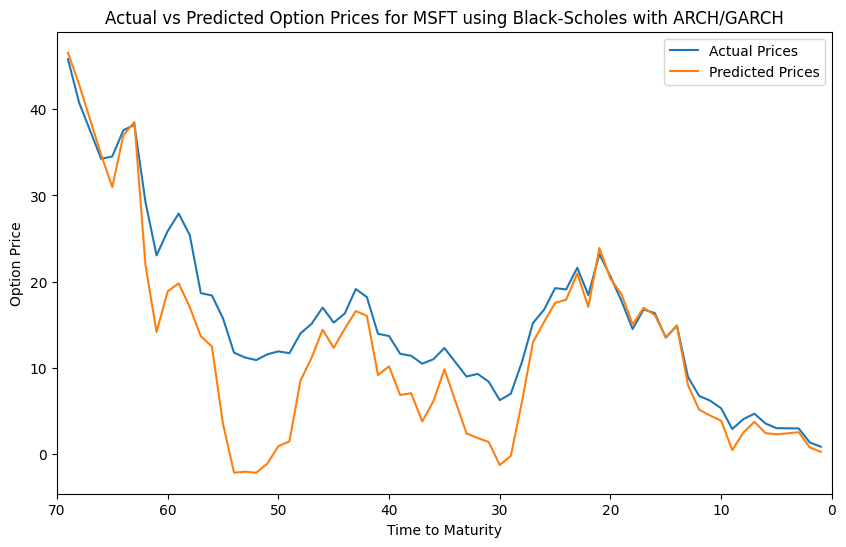

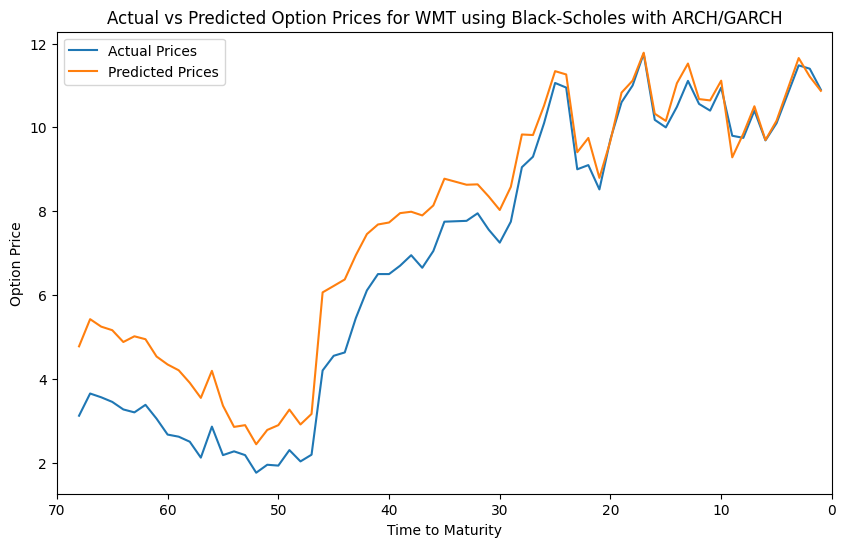

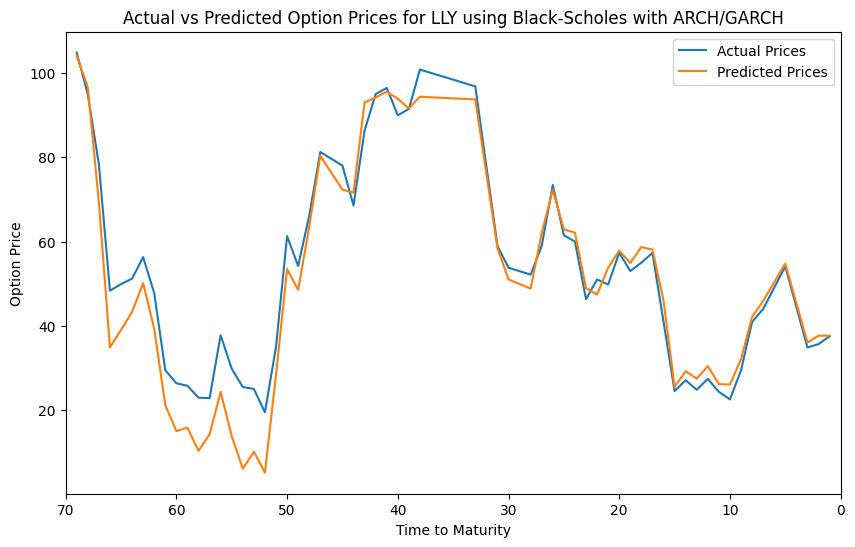

In [ ]:
plot_actual_vs_predicted('Technology',df_main_Technology,df_other_Technology,Heston_test2,'Heston')

**Lennox - Optuna ML**

In [ ]:
import optuna
import xgboost as xgb
from sklearn.metrics import mean_squared_error, mean_absolute_error, root_mean_squared_error
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt

# Load data (assuming you have this step done already)
df =Industrials_Dataframe  # Replace with actual data

# Preprocess the data
X, y, scaler = preprocess_data(df)

# Split the data into training (80%) and testing (20%) sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Objective function for Optuna optimization
def objective(trial):
    # Define the hyperparameters you want to optimize
    learning_rate = trial.suggest_loguniform('learning_rate', 0.001, 0.3)  # Log-uniform distribution
    max_depth = trial.suggest_int('max_depth', 3, 12)  # Integer values for tree depth
    n_estimators = trial.suggest_int('n_estimators', 100, 1000)  # Number of boosting rounds (trees)
    subsample = trial.suggest_uniform('subsample', 0.5, 1.0)  # Fraction of samples
    colsample_bytree = trial.suggest_uniform('colsample_bytree', 0.5, 1.0)  # Fraction of features for each tree
    reg_alpha = trial.suggest_loguniform('reg_alpha', 1e-5, 1.0)  # L1 regularization
    reg_lambda = trial.suggest_loguniform('reg_lambda', 1e-5, 1.0)  # L2 regularization

    # Build the model with the trial's suggested hyperparameters
    model_xgb = xgb.XGBRegressor(
        learning_rate=learning_rate,
        max_depth=max_depth,
        n_estimators=n_estimators,
        subsample=subsample,
        colsample_bytree=colsample_bytree,
        reg_alpha=reg_alpha,
        reg_lambda=reg_lambda,
        random_state=42,
        eval_metric="rmse"
    )

    # Fit the model
    model_xgb.fit(X_train, y_train, eval_set=[(X_test, y_test)], verbose=False)

    # Predict and calculate RMSE
    y_pred = model_xgb.predict(X_test)
    rmse = mean_squared_error(y_test, y_pred)

    # Return the RMSE as the optimization objective (lower is better)
    return rmse

# Create the Optuna study
study = optuna.create_study(direction="minimize")  # Minimize RMSE
study.optimize(objective, n_trials=50)  # Number of trials to run

# Get the best hyperparameters
best_params = study.best_params
print("Best hyperparameters:", best_params)

# Train the final model using the best hyperparameters
model_xgb_final = xgb.XGBRegressor(
    **best_params,
    random_state=42,
    eval_metric="rmse"
)
model_xgb_final.fit(X_train, y_train, eval_set=[(X_test, y_test)], verbose=True)

# Make predictions with the final model
y_pred_final = model_xgb_final.predict(X_test)

# Calculate performance metrics
test_rmse = mean_squared_error(y_test, y_pred_final)
test_mae = mean_absolute_error(y_test, y_pred_final)
print(f"Test RMSE: {test_rmse:.4f}, Test MAE: {test_mae:.4f}")

# Save the trained model
model_xgb_final.save_model('xgboost_implied_volatility_model_optuna.json')
print("Model saved as 'xgboost_implied_volatility_model_optuna.json'")

# Optional: Plot training history
results = model_xgb_final.evals_result()
plt.plot(results['validation_0']['rmse'], label='Validation RMSE')
plt.title('XGBoost Training History')
plt.xlabel('Boosting Rounds')
plt.ylabel('RMSE')
plt.legend()
plt.show()